In [1]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix, f1_score, roc_curve, recall_score, balanced_accuracy_score, auc, precision_score,precision_recall_curve
import matplotlib.pyplot as plt
import os
import random
import pandas as pd
from tqdm import tqdm
from CUBS_Dataset import read_cubs_images
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.utils import class_weight
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import GridSearchCV
# from scikeras.wrappers import KerasClassifier
# from imblearn.over_sampling import ADASYN
from Dataset import read_dataset
from scipy import stats
from collections import Counter
from matplotlib.ticker import FuncFormatter
# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
# os.environ["CUDA_VISIBLE_DEVICES"] = ""
# import os
# import numpy as np
# os.environ['TF_DETERMINISTIC_OPS'] = '1'
# # os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
# # os.environ['TF_FORCE_GPU_ALLOW_GROWTH']='cuda_malloc_async'
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Input, Dropout, Lambda, GlobalMaxPooling2D, Flatten
# from tensorflow.keras.metrics import Precision, Recall, AUC
# from keras.backend import clear_session
# from keras.regularizers import l2
# from keras.callbacks import  EarlyStopping, ReduceLROnPlateau #Callback, 
# # from PIL import Image
# # import numpy as np
# from sklearn.model_selection import train_test_split, StratifiedKFold
# import keras.applications
# # from keras import Sequential
# # from keras.models import Model, load_model
# # from keras.layers import GlobalMaxPooling2D, Dense, Rescaling, Input, Dropout, Lambda, RandomCrop, RandomFlip, RandomTranslation, RandomRotation, RandomZoom, TimeDistributed, Maximum
# # from keras.regularizers import l2
# # from keras.backend import clear_session
# from sklearn.utils.class_weight import compute_class_weight
# from tensorflow.keras.optimizers import Adam
# import tensorflow as tf
# # from keras.metrics import AUC, PrecisionAtRecall, SensitivityAtSpecificity, SpecificityAtSensitivity, Metric
# # from Dataset import read_dataset
# # from scikeras.wrappers import KerasClassifier
# from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix, f1_score #make_scorer, 
# # from tensorflow.image import grayscale_to_rgb
# # import itertools
# # from sklearn.model_selection import StratifiedKFold
# # import ast
# import matplotlib.pyplot as plt
# import random
# from numpy.random import seed, randint
# from utils import MinMax #grid_search, create_model, simple_kfold
# from tensorflow.keras.utils import set_random_seed
# from keras.losses import BinaryFocalCrossentropy
# import seaborn as sns
# # from tensorflow.keras import mixed_precision

2024-10-30 19:31:59.964943: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-30 19:32:01.501989: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-30 19:32:01.502039: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-30 19:32:01.674019: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-30 19:32:02.192523: I tensorflow/core/platform/cpu_feature_guar

In [2]:
os.environ['TF_DETERMINISTIC_OPS'] = '1'
# os.environ["CUDA_VISIBLE_DEVICES"]="1"
tf.config.experimental.enable_op_determinism()
kseed=0
np.random.seed(kseed)
random.seed(kseed)
tf.random.set_seed(kseed)
tf.keras.utils.set_random_seed(kseed)
tqdm.pandas()
print('GPU name: ', tf.config.experimental.list_physical_devices('GPU'))

GPU name:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


2024-10-30 19:32:20.005242: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-10-30 19:32:21.758071: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-10-30 19:32:21.762434: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [3]:
cubs = pd.read_csv(os.path.join('CUBS', 'ClinicalDatabase-CUBS.csv'), sep=';')
cubs.drop('Sex', axis=1, inplace=True)
cubs.rename({'Unnamed: 0': 'hospital', 'Sex.1': 'Sex'}, axis=1, inplace=True)
cubs.hospital = cubs.hospital.ffill()
cubs[['BMI', 'Glucose', 'Tchol', 'HDL', 'LDL', 'Trigl', 'Creat', 'Apoa1', 'ApoB']] = cubs[['BMI', 'Glucose', 'Tchol', 'HDL', 'LDL', 'Trigl', 'Creat', 'Apoa1', 'ApoB']].map(lambda x: float(x.replace(',', '.')) if type(x)==str else x, na_action='ignore')

cubs = cubs[cubs['Base CVE'].notna() & cubs['FUPEvents'].notna()]
cubs['risk'] = ((cubs['Base CVE']==1) | (cubs['FUPEvents']==1))*1
cubs.loc[(cubs['Base CVE']==0) & (cubs['FUPEvents']==1), 'risk'] = (cubs[(cubs['Base CVE']==0) & (cubs['FUPEvents']==1)].TimetoEvent<=3)*1
cubs['image'] = cubs.progress_apply(read_cubs_images, axis=1)
cubs.drop('image', axis=1)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 689/689 [00:15<00:00, 43.89it/s]


,hospital,Patient ID,age,Sex,CVD Symptoms,packyears,smoking,Hypertension,Diabetes,BMI,...,HDL,LDL,Trigl,Creat,Apoa1,ApoB,Base CVE,FUPEvents,TimetoEvent,risk
0,Nicolaides - Cyprus,clin_0001,65.0,1.0,1,30,1.0,0.0,0.0,33.0,...,26.0,96.0,125.0,0.98,1.13,0.88,0.0,0.0,6.0,0
1,Nicolaides - Cyprus,clin_0002,59.0,0.0,0,0,0.0,0.0,0.0,30.0,...,62.0,207.0,94.0,0.89,1.86,1.41,0.0,0.0,14.0,0
2,Nicolaides - Cyprus,clin_0003,66.0,1.0,0,40,1.0,1.0,0.0,33.9,...,47.0,175.0,166.0,1.17,1.45,1.60,0.0,1.0,10.0,0
3,Nicolaides - Cyprus,clin_0004,65.0,0.0,0,0,0.0,1.0,0.0,27.2,...,32.0,114.0,276.0,0.79,1.13,0.99,0.0,0.0,14.0,0
4,Nicolaides - Cyprus,clin_0005,68.0,1.0,0,60,1.0,0.0,0.0,24.9,...,53.0,164.0,191.0,0.78,1.53,1.50,0.0,0.0,14.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
689,Nicolaides - Cyprus,clin_0690,48.0,0.0,0,0,0.0,0.0,0.0,22.9,...,64.0,117.0,63.0,0.72,1.58,0.91,0.0,0.0,11.0,0
690,Nicolaides - Cyprus,clin_0691,53.0,1.0,0,0,0.0,0.0,0.0,28.4,...,50.0,126.0,123.0,0.95,1.47,1.02,0.0,0.0,11.0,0
691,Nicolaides - Cyprus,clin_0692,45.0,0.0,0,"6,25",1.0,0.0,0.0,24.4,...,49.0,173.0,170.0,0.82,1.51,1.46,0.0,0.0,11.0,0
692,Nicolaides - Cyprus,clin_0693,41.0,0.0,0,0,0.0,0.0,0.0,23.1,...,58.0,126.0,72.0,0.75,1.50,0.98,0.0,0.0,11.0,0


In [4]:
# Prepare the image data and labels
X = np.stack(cubs.image.values)
# X = X.reshape(-1, X.shape[2], X.shape[3], X.shape[4])

y = cubs.risk.values
# y = np.repeat(y, 2)

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, stratify=y)
X_train_ind, X_test_ind, y_train, y_test = train_test_split(np.arange(len(X)), y, test_size=0.4, stratify=y)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y)

# X_valid, X_test, y_valid, y_test = train_test_split(X_test, y_test, test_size=0.5, stratify=y_test)
# X_valid_ind, X_test_ind, y_valid, y_test = train_test_split(X_test_ind, y_test, test_size=0.5, stratify=y_test)
X_test_ind, X_valid_ind, y_test, y_valid = train_test_split(X_test_ind, y_test, test_size=0.5, stratify=y_test)

# X_train = X[X_train_ind]
# X_train = X_train.reshape(-1, X_train.shape[2], X_train.shape[3], X_train.shape[4])
# y_train = np.repeat(y_train, 2)

# X_valid = X[X_valid_ind]
# X_valid = X_valid.reshape(-1, X_valid.shape[2], X_valid.shape[3], X_valid.shape[4])
# y_valid = np.repeat(y_valid, 2)

# X_test = X[X_test_ind]
# X_test = X_test.reshape(-1, X_test.shape[2], X_test.shape[3], X_test.shape[4])
# y_test = np.repeat(y_test, 2)

X = X.reshape(-1, X.shape[2], X.shape[3], X.shape[4])
y = np.repeat(y, 2)

temp = np.zeros(2*len(X_train_ind))
temp[::2, ...]=X_train_ind*2
temp[1::2, ...]=X_train_ind*2+1
X_train_ind = temp.astype(int)

temp = np.zeros(2*len(X_valid_ind))
temp[::2, ...]=X_valid_ind*2
temp[1::2, ...]=X_valid_ind*2+1
X_valid_ind = temp.astype(int)

temp = np.zeros(2*len(X_test_ind))
temp[::2, ...]=X_test_ind*2
temp[1::2, ...]=X_test_ind*2+1
X_test_ind = temp.astype(int)

X_train = X[X_train_ind]
y_train = np.repeat(y_train, 2)

X_valid = X[X_valid_ind]
y_valid = np.repeat(y_valid, 2)

X_test = X[X_test_ind]
y_test = np.repeat(y_test, 2)

print(np.mean(y_train), np.mean(y_valid), np.mean(y_test))
# print(np.mean(y_train), np.mean(y_test))

0.1694915254237288 0.17391304347826086 0.16666666666666666


In [5]:
carotid_list = read_dataset()

# from tqdm import tqdm
# for i in tqdm(carotid_list):
#     i.video = i.crop_plaque()

carotid_df = pd.DataFrame.from_records([i.__dict__ for i in carotid_list])
carotid_df = carotid_df[~carotid_df.risk.isna()]

q = carotid_df[(carotid_df.lastframe - carotid_df.frame1 + 1)!=carotid_df.x_wp.apply(len)]
print(pd.concat([q[['frame1', 'lastframe']], q.x_wp.apply(len), q.video.apply(lambda x: x.shape)], axis=1))

for i in carotid_list:
    i.x_wp = i.x_wp[:i.lastframe - i.frame1 + 1]
    i.y_wp = i.y_wp[:i.lastframe - i.frame1 + 1]

carotid_df = pd.DataFrame.from_records([i.__dict__ for i in carotid_list])
print('Initial Dataframe:')
print(carotid_df.risk.value_counts(dropna=False))

carotid_df = carotid_df[~carotid_df.risk.isna()]
print('\nAfter droping unlabeled:')
print(carotid_df.risk.value_counts(dropna=False))

q = carotid_df[(carotid_df.lastframe - carotid_df.frame1 + 1)!=carotid_df.x_wp.apply(len)]
print(pd.concat([q[['frame1', 'lastframe']], q.x_wp.apply(len), q.video.apply(lambda x: x.shape)], axis=1))

def select_random_frame(x):
    return np.repeat(x[np.random.randint(x.shape[0])][..., np.newaxis], 3, axis=-1)

carotid_df['image'] = carotid_df.video.apply(select_random_frame)

# temp_df = carotid_df.drop_duplicates('patientID')[['patientID', 'risk']]

# train, test = train_test_split(temp_df, test_size=0.2, random_state=kseed)

# train, valid = train_test_split(train, test_size=0.25, random_state=kseed)

# train, valid, test = carotid_df[carotid_df.patientID.isin(train.patientID)], carotid_df[carotid_df.patientID.isin(valid.patientID)], carotid_df[carotid_df.patientID.isin(test.patientID)], 


# X_train = np.stack(train.image.values)
# y_train = train.risk.values

# X_valid = np.stack(valid.image.values)
# y_valid = valid.risk.values

# X_test = np.stack(test.image.values)
# y_test = test.risk.values

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 96/96 [02:33<00:00,  1.60s/it]

    frame1  lastframe  x_wp            video
4        1         69   321   (69, 434, 532)
10     169        232   266  (321, 434, 532)
11     160        256   102  (256, 434, 532)
16      45        100   102  (100, 434, 532)
17       1         63   333   (63, 434, 532)
18       1         79   321   (79, 434, 532)
23     115        172   321  (172, 434, 532)
25       1        171   333  (171, 434, 532)
30      45        142   333  (142, 434, 532)
34       1         75   321   (75, 434, 532)
48       1         89   333   (89, 434, 532)
54       1         91   102   (91, 434, 532)
59      54        110   102  (176, 434, 532)
60     108        321   321  (321, 434, 532)
69       1         71   321   (71, 434, 532)
71       1         96   321   (96, 434, 532)
76      78        120   321  (159, 434, 532)
87       1         89   321   (89, 434, 532)
92     100        170   102  (247, 434, 532)
Initial Dataframe:
risk
1.0    67
0.0    20
NaN     9
Name: count, dtype: int64

After droping unlab

In [6]:
# def create_model(pooling='max', lr=0.001):
    # tf.keras.backend.clear_session()

    # i = tf.keras.layers.Input([464, 618, 3], dtype="uint8")
    # x = tf.keras.layers.Lambda(lambda x: tf.cast(x, "float32"))(i)
    # preprocess_input = tf.keras.applications.inception_v3.preprocess_input(x)

    # #load a specified pre-trained model
    # pretrained_model = tf.keras.applications.InceptionV3(include_top=False, pooling=pooling, weights='imagenet', input_tensor=preprocess_input)
    # #freeze the weights of the pre-trained layers
    # for layer in pretrained_model.layers:
    #     layer.trainable = False
    # #add the pre-trained model and custom classifier to the new model
    # x=pretrained_model.output
    # x = tf.keras.layers.Dense(1024, activation='relu')(x)

    # mean = tf.keras.layers.Dense(1, name='mean')(x)  # One neuron for mean
    # std_dev = tf.keras.layers.Dense(1, name='std', activation='softplus')(x)  # One neuron for std_dev

    # samp = GaussianSample()([mean, std_dev])
    # out = tf.keras.activations.sigmoid(samp)
    # model = tf.keras.models.Model(i, outputs=out)
    # model.summary()
    # model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
    #               loss='binary_crossentropy',
    #               # loss='CategoricalCrossentropy',
    #               metrics=['accuracy',
    #                        tf.keras.metrics.Precision(name='precision'),
    #                        tf.keras.metrics.Recall(name='recall'),
    #                        tf.keras.metrics.AUC(name='auc'),
    #                        tf.keras.metrics.AUC(curve='PR', name='auprc')]
    #               )
    # return model

class GaussianSample(tf.keras.layers.Layer):
    def call(self, inputs, training):
        z_mean, z_log_var = inputs
        if training:
            batch = tf.shape(z_mean)[0]
            dim = tf.shape(z_mean)[1]
            epsilon = tf.random.normal(shape=(batch, dim))
            return z_mean + tf.exp(0.5 * z_log_var) * epsilon
        else:
            return z_mean


def create_uncertainty_model(model):
    tf.keras.backend.clear_session()

    for layer in model.layers:
        layer.trainable = False
    
    mean = model.get_layer('tf.nn.softmax').output[:, 1:]
    std_dev = tf.keras.layers.Dense(1, name='std', activation='softplus')(model.get_layer('dense').output)
    # std_dev = tf.keras.layers.Dense(1, name='std', activation='relu')(model.get_layer('dense').output)

    samp = GaussianSample()([mean, std_dev])
    # out = tf.keras.activations.sigmoid(samp)
    model = tf.keras.models.Model(model.input, outputs=samp)
    model.summary()
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='binary_crossentropy',
                  # loss='CategoricalCrossentropy',
                  metrics=['accuracy',
                           tf.keras.metrics.Precision(name='precision'),
                           tf.keras.metrics.Recall(name='recall'),
                           tf.keras.metrics.AUC(name='auc'),
                           tf.keras.metrics.AUC(curve='PR', name='auprc')]
                  )
    return model

    # i = tf.keras.layers.Input([2048], dtype="float32")
    # x = tf.keras.layers.Dense(512, activation='relu')(i)

    # mean = tf.keras.layers.Dense(1, name='mean', activation='sigmoid')(x)  # One neuron for mean
    # std_dev = tf.keras.layers.Dense(1, name='std', activation='softplus')(x)  # One neuron for std_dev
    # # std_dev = tf.keras.layers.Dense(1, name='std', activation='relu')(x)  # One neuron for std_dev

    # samp = GaussianSample()([mean, std_dev])
    # # out = tf.keras.activations.sigmoid(samp)
    # model = tf.keras.models.Model(i, outputs=samp)
    # model.summary()
    # model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    #               loss='binary_crossentropy',
    #               # loss='CategoricalCrossentropy',
    #               metrics=['accuracy',
    #                        tf.keras.metrics.Precision(name='precision'),
    #                        tf.keras.metrics.Recall(name='recall'),
    #                        tf.keras.metrics.AUC(name='auc'),
    #                        tf.keras.metrics.AUC(curve='PR', name='auprc')]
    #               )
    # return model


def create_dropout_model(neurons, dropout_rate, lr, kreg, breg, model=None, summary=True):
    tf.keras.backend.clear_session()

    i = tf.keras.layers.Input([2048], dtype="float32")
    x = i
    for n in neurons:
        x = tf.keras.layers.Dropout(dropout_rate)(x)
        x = tf.keras.layers.Dense(n, activation='relu', kernel_regularizer=kreg,
                                  bias_regularizer=breg)(x)
    x = tf.keras.layers.Dropout(dropout_rate)(x)
    x = tf.keras.layers.Dense(2, kernel_regularizer=kreg, bias_regularizer=breg)(x)
    out = tf.keras.activations.softmax(x)
    target_model = tf.keras.models.Model(i, outputs=out)


    if model:
        target_model.set_weights(model.get_weights())
    if summary:
        target_model.summary()
    target_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
                         loss='CategoricalCrossentropy',
                         metrics=['accuracy',
                                  tf.keras.metrics.Precision(name='precision'),
                                  tf.keras.metrics.Recall(name='recall'),
                                  tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], name='auc'),
                                  tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], curve='PR', name='auprc')]
                        )
    return target_model

def create_model(pooling='max', lr=0.001):
    """
    This function creates a ResNet50 model.

    Parameters:
    pooling (str): the type of global pooling to be applied, default is 'max'
    lr (float): learning rate, default is 0.001

    Returns:
    model (tf.keras.models.Model): the compiled model
    """
    tf.keras.backend.clear_session()

    i = tf.keras.layers.Input([464, 618, 3], dtype="uint8")
    x = tf.keras.layers.Lambda(lambda x: tf.cast(x, "float32"))(i)
    preprocess_input = tf.keras.applications.inception_v3.preprocess_input(x)

    #load a specified pre-trained model
    pretrained_model = tf.keras.applications.InceptionV3(include_top=False, pooling=pooling, weights='imagenet', input_tensor=preprocess_input)
    #freeze the weights of the pre-trained layers
    for layer in pretrained_model.layers:
        layer.trainable = False
    #add the pre-trained model and custom classifier to the new model
    x = pretrained_model.output
    # x = tf.keras.layers.Dropout(0.4)(x)
    x = tf.keras.layers.Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3))(x)
    # x = tf.keras.layers.Dropout(0.4)(x)
    # x = tf.keras.layers.Dense(256, activation='relu', kernel_regularizer=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3))(x)
    out = tf.keras.layers.Dense(2, activation='softmax', kernel_regularizer=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3))(x)
    model = tf.keras.models.Model(i, outputs=out)
    model.summary()
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
                  loss='CategoricalCrossentropy',
                  metrics=['accuracy',
                           tf.keras.metrics.Precision(name='precision'),
                           tf.keras.metrics.Recall(name='recall'),
                           tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], name='auc'),
                           tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], curve='PR', name='auprc')]
                  )
    return model


def create_feature_extractor(pooling='max', lr=0.001):
    """
    This function creates a ResNet50 model.

    Parameters:
    pooling (str): the type of global pooling to be applied, default is 'max'
    lr (float): learning rate, default is 0.001

    Returns:
    model (tf.keras.models.Model): the compiled model
    """
    tf.keras.backend.clear_session()

    i = tf.keras.layers.Input([None, None, 3], dtype="uint8")
    x = tf.keras.layers.Lambda(lambda x: tf.cast(x, "float32"))(i)
    preprocess_input = tf.keras.applications.inception_v3.preprocess_input(x)

    #load a specified pre-trained model
    pretrained_model = tf.keras.applications.InceptionV3(include_top=False, pooling=pooling, weights='imagenet', input_tensor=preprocess_input)
    #freeze the weights of the pre-trained layers
    for layer in pretrained_model.layers:
        layer.trainable = False
    #add the pre-trained model and custom classifier to the new model
    x = pretrained_model.output
    model = tf.keras.models.Model(i, outputs=pretrained_model.output)
    # model.summary()
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
                  loss='CategoricalCrossentropy',
                  metrics=['accuracy',
                           tf.keras.metrics.Precision(name='precision'),
                           tf.keras.metrics.Recall(name='recall'),
                           tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], name='auc'),
                           tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], curve='PR', name='auprc')]
                  )
    return model


def create_model(neurons, dropout_rate, lr, kreg, breg):
    """
    This function creates a ResNet50 model.

    Parameters:
    pooling (str): the type of global pooling to be applied, default is 'max'
    lr (float): learning rate, default is 0.001

    Returns:
    model (tf.keras.models.Model): the compiled model
    """
    tf.keras.backend.clear_session()

    i = tf.keras.layers.Input([2048], dtype="float32")
    x = i
    for n in neurons:
        x = tf.keras.layers.Dense(n, activation='relu', kernel_regularizer=kreg,
                                  bias_regularizer=breg)(x)
        if dropout_rate:
            x = tf.keras.layers.Dropout(dropout_rate)(x)
    x = tf.keras.layers.Dense(2, kernel_regularizer=kreg, bias_regularizer=breg)(x)
    out = tf.keras.activations.softmax(x)
    model = tf.keras.models.Model(i, outputs=out)
    model.summary()
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
                  loss='CategoricalCrossentropy',
                  metrics=['accuracy',
                           tf.keras.metrics.Precision(name='precision'),
                           tf.keras.metrics.Recall(name='recall'),
                           tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], name='auc'),
                           tf.keras.metrics.AUC(multi_label=True, num_labels=2, label_weights=[0, 1], curve='PR', name='auprc')]
                  )
    return model

In [7]:
feature_extractor = create_feature_extractor()
X_train=feature_extractor.predict(X_train)
X_valid=feature_extractor.predict(X_valid)
X_test=feature_extractor.predict(X_test)
X_attikon = feature_extractor.predict(np.stack(carotid_df.image.values))

# adasyn = ADASYN(n_neighbors=5, random_state=42)
# X_train, y_train = adasyn.fit_resample(X_train, y_train)

y_train_one = tf.keras.utils.to_categorical(y_train)
y_val_one = tf.keras.utils.to_categorical(y_valid)

model = create_model(neurons=[1024, 256], dropout_rate=0.1, lr=0.001, kreg=tf.keras.regularizers.L1L2(l1=1e-4, l2=1e-3), breg=None)
class_weights = {i: j for i, j in enumerate(class_weight.compute_class_weight(class_weight="balanced", classes=np.unique(y_train), y=y_train))}
history = model.fit(X_train, y_train_one, epochs=200, validation_data=(X_valid, y_val_one),
                    class_weight=class_weights,
                    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_auc',
                                                                mode='max',
                                                                patience=50,
                                                                verbose=1,
                                                                restore_best_weights=True)]
                    )


2024-10-30 19:35:12.682927: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-10-30 19:35:12.690355: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-10-30 19:35:12.694060: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

3/3 [==============================] - 1s 214ms/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 2048)]            0         
                                                                 
 dense (Dense)               (None, 1024)              2098176   
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_1 (Dense)             (None, 256)               262400    
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 2)                 514       
                                                                 
 tf.nn.s

2024-10-30 19:35:36.645900: I external/local_xla/xla/service/service.cc:168] XLA service 0x7ccb6d624aa0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-10-30 19:35:36.645915: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2024-10-30 19:35:36.736147: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1730309737.127501    4958 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


26/26 [==============================] - 5s 21ms/step - loss: 12.1897 - accuracy: 0.4770 - precision: 0.4770 - recall: 0.4770 - auc: 0.4833 - auprc: 0.1583 - val_loss: 6.4236 - val_accuracy: 0.8261 - val_precision: 0.8261 - val_recall: 0.8261 - val_auc: 0.5455 - val_auprc: 0.1948
Epoch 2/200
26/26 [==============================] - 0s 4ms/step - loss: 6.4565 - accuracy: 0.5182 - precision: 0.5182 - recall: 0.5182 - auc: 0.5107 - auprc: 0.1703 - val_loss: 6.2727 - val_accuracy: 0.1739 - val_precision: 0.1739 - val_recall: 0.1739 - val_auc: 0.4534 - val_auprc: 0.1607
Epoch 3/200
26/26 [==============================] - 0s 4ms/step - loss: 5.8136 - accuracy: 0.4843 - precision: 0.4843 - recall: 0.4843 - auc: 0.4855 - auprc: 0.1631 - val_loss: 6.1815 - val_accuracy: 0.1739 - val_precision: 0.1739 - val_recall: 0.1739 - val_auc: 0.5002 - val_auprc: 0.1703
Epoch 4/200
26/26 [==============================] - 0s 4ms/step - loss: 5.4196 - accuracy: 0.5169 - precision: 0.5169 - recall: 0.5169 -

In [8]:
# dropout 0.05
# even more (2,2) regularization, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 0s 1ms/step
Confusion Matrix:
[[224   6]
 [ 42   4]]
Accuracy:  0.8260869565217391
Sensitivity:  0.08695652173913043
Specificity:  0.9739130434782609
Balanced accuracy:  0.5304347826086957
ROC AUC:  0.48837429111531194
F1 Score:  0.14285714285714285
AUC under Precision-Recall Curve: 0.1863


In [8]:
# model = create_feature_extractor()
# X_train=model.predict(X_train)
# X_valid=model.predict(X_valid)
# X_test=model.predict(X_test)

# # adasyn = ADASYN(n_neighbors=5, random_state=42)
# # X_train, y_train = adasyn.fit_resample(X_train, y_train)

# y_train_one = tf.keras.utils.to_categorical(y_train)
# y_val_one = tf.keras.utils.to_categorical(y_valid)

# model = create_dropout_model(neurons=[512], dropout_rate=0.05, lr=0.001, kreg=tf.keras.regularizers.L1L2(l1=1e-2, l2=1e-2), breg=None)
# class_weights = {i: j for i, j in enumerate(class_weight.compute_class_weight(class_weight="balanced", classes=np.unique(y_train), y=y_train))}
# history = model.fit(X_train, y_train_one, epochs=200, validation_data=(X_valid, y_val_one),
#                     class_weight=class_weights,
#                     callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_auc',
#                                                                 mode='max',
#                                                                 patience=50,
#                                                                 verbose=1,
#                                                                 restore_best_weights=True)]
#                     )


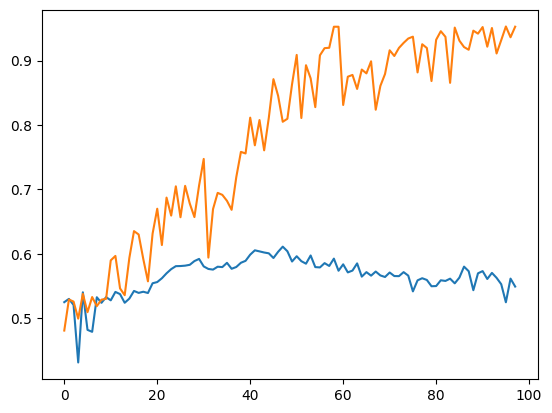

In [9]:
plt.plot(history.history['val_auc'])
plt.plot(history.history['auc'])

In [10]:
# dropout 0.05
# even more (2,2) regularization, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 0s 3ms/step
Confusion Matrix:
[[142  88]
 [ 16  30]]
Accuracy:  0.6231884057971014
Sensitivity:  0.6521739130434783
Specificity:  0.6173913043478261
Balanced accuracy:  0.6347826086956522
ROC AUC:  0.6844045368620038
F1 Score:  0.36585365853658536
AUC under Precision-Recall Curve: 0.3131


In [11]:
# dropout 0.05
# even more (2,2) regularization, 512
# class weight

y_pred_attikon = model.predict(X_attikon)

# _, _, thresholds = roc_curve(carotid_df.risk.values, y_pred_attikon[:, 1])
# acc = [balanced_accuracy_score(carotid_df.risk.values, (y_pred_attikon[:, 1] > thrs) * 1) for thrs in thresholds]

# thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels_attikon = (y_pred_attikon[:,1] > 0.5) * 1

# Calculate metrics
accuracy = accuracy_score(carotid_df.risk.values, y_pred_labels_attikon)
roc_auc = roc_auc_score(carotid_df.risk.values, y_pred_attikon[:, 1])
f1 = f1_score(carotid_df.risk.values, y_pred_labels_attikon)
confusion = confusion_matrix(carotid_df.risk.values, y_pred_labels_attikon)
recall = recall_score(carotid_df.risk.values, y_pred_labels_attikon)
specificity = recall_score(carotid_df.risk.values, y_pred_labels_attikon, pos_label=0)
balanced_accuracy = balanced_accuracy_score(carotid_df.risk.values, y_pred_labels_attikon)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(carotid_df.risk.values, y_pred_attikon[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

3/3 [==============================] - 0s 4ms/step
Confusion Matrix:
[[ 2 18]
 [24 43]]
Accuracy:  0.5172413793103449
Sensitivity:  0.6417910447761194
Specificity:  0.1
Balanced accuracy:  0.3708955223880597
ROC AUC:  0.3037313432835821
F1 Score:  0.671875
AUC under Precision-Recall Curve: 0.6577


In [12]:
pred_cor = dict()
pred_mis = dict()
pred_cor_attikon = dict()
pred_mis_attikon = dict()
for j in tqdm(range(10, 500, 10)):
    pred = np.zeros((len(X_test) + len(X_attikon), j))
    # model = create_dropout_model(neurons=[1024, 256], dropout_rate=(0.05 + dr*0.05), lr=0.001, kreg=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3), breg=None, model=model, summary=False)
    for i in range(j):
        pred[:,i] = model(np.vstack([X_test, X_attikon]), training=True).numpy()[:, 1]
    
    pred, pred_attikon = pred[:-len(carotid_df)], pred[-len(carotid_df):]
    # pred = pred.std(axis=1)/(pred.std(axis=1).max())
    pred_cor[j] = pred[(y_test==y_pred_labels), :]
    pred_mis[j] = pred[(y_test!=y_pred_labels), :]
    
    # pred_attikon = pred_attikon.std(axis=1)/(pred_attikon.std(axis=1).max())
    pred_cor_attikon[j] = pred_attikon[(carotid_df.risk.values==y_pred_labels_attikon), :]
    pred_mis_attikon[j] = pred_attikon[(carotid_df.risk.values!=y_pred_labels_attikon), :]

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [03:04<00:00,  3.78s/it]


In [13]:
def standard_deviation(arr):
  """
  This function calculates the standard deviation of a 1D array.

  Args:
      arr: A 1D numpy array.

  Returns:
      The standard deviation of the array, or np.nan if the array is empty.
  """
  if len(arr) == 0:
    return np.nan
  return np.std(arr)

def variation_ratio_labels(arr):
    """
    Compute the variation ratio of a 1D array.
    
    Parameters:
    data (array-like): Input array.
    
    Returns:
    float: Variation ratio of the input array.
    """
    if len(arr) == 0:
        raise ValueError("Input array must not be empty.")
    
    mode, count = stats.mode((arr>0.5)*1)
    total_count = len(arr)
    
    vr = 1 - (count / total_count)
    return vr

def variation_ratio_preds_100(arr):
    """
    Compute the variation ratio of a 1D array.
    
    Parameters:
    data (array-like): Input array.
    
    Returns:
    float: Variation ratio of the input array.
    """
    if len(arr) == 0:
        raise ValueError("Input array must not be empty.")

    temp = Counter((np.asarray(arr)*100).astype(int))
    total = sum(temp.values())
    for i, j in temp.items():
        temp[i] = j/total
    
    arr = np.array(list(temp.values()))
    mode, count = stats.mode(arr)
    total_count = len(arr)
    
    vr = 1 - (count / total_count)
    return vr

def variation_ratio_preds_10(arr):
    """
    Compute the variation ratio of a 1D array.
    
    Parameters:
    data (array-like): Input array.
    
    Returns:
    float: Variation ratio of the input array.
    """
    if len(arr) == 0:
        raise ValueError("Input array must not be empty.")

    temp = Counter((np.asarray(arr)*10).astype(int))
    total = sum(temp.values())
    for i, j in temp.items():
        temp[i] = j/total
    
    arr = np.array(list(temp.values()))
    mode, count = stats.mode(arr)
    total_count = len(arr)
    
    vr = 1 - (count / total_count)
    return vr

def predictive_entropy_original(arr):
    """
    Calculate the predictive entropy of a probability distribution.
    
    Parameters:
    arr (1D array-like): An array representing a probability distribution.
    
    Returns:
    float: The predictive entropy of the distribution.
    """
    # Ensure the probabilities are a numpy array
    arr = np.asarray(arr)

    arr = np.array([1 - arr.mean(), arr.mean()])
    
    # Check if the probabilities sum to 1, if not normalize them
    if not np.isclose(np.sum(arr), 1.0):
        arr = arr / np.sum(arr)
    
    # Calculate the entropy
    entropy = -np.sum(arr * np.log(arr + 1e-10))  # Adding epsilon to avoid log(0)
    
    return entropy

def predictive_entropy_100(arr):
    """
    Calculate the predictive entropy of a probability distribution.
    
    Parameters:
    arr (1D array-like): An array representing a probability distribution.
    
    Returns:
    float: The predictive entropy of the distribution.
    """
    # Ensure the probabilities are a numpy array

    temp = Counter((np.asarray(arr)*100).astype(int))
    total = sum(temp.values())
    for i, j in temp.items():
        temp[i] = j/total
    
    probs = np.array(list(temp.values()))
    
    # Check if the probabilities sum to 1, if not normalize them
    if not np.isclose(np.sum(probs), 1.0):
        probs = probs / np.sum(probs)
    
    # Calculate the entropy
    entropy = -np.sum(probs * np.log(probs + 1e-10))  # Adding epsilon to avoid log(0)
    
    return entropy

def predictive_entropy_10(arr):
    """
    Calculate the predictive entropy of a probability distribution.
    
    Parameters:
    arr (1D array-like): An array representing a probability distribution.
    
    Returns:
    float: The predictive entropy of the distribution.
    """
    # Ensure the probabilities are a numpy array

    temp = Counter((np.asarray(arr)*10).astype(int))
    total = sum(temp.values())
    for i, j in temp.items():
        temp[i] = j/total
    
    probs = np.array(list(temp.values()))
    
    # Check if the probabilities sum to 1, if not normalize them
    if not np.isclose(np.sum(probs), 1.0):
        probs = probs / np.sum(probs)
    
    # Calculate the entropy
    entropy = -np.sum(probs * np.log(probs + 1e-10))  # Adding epsilon to avoid log(0)
    
    return entropy

def mi(arr):
    return predictive_entropy_original(arr) - ((arr * np.log(arr + 1e-10)) + ((1-arr) * np.log((1-arr) + 1e-10))).mean()

def total_variance(arr):
    """
    Calculate the total variance of the values in a 1D array.
    
    Parameters:
    arr (numpy.ndarray): A 1D array of numerical values.
    
    Returns:
    float: The total variance of the array values.
    """
    # Convert input to numpy array if it's not already
    arr = np.asarray(arr)
    
    # Compute the mean of the array
    mean = np.mean(arr)
    
    # Compute the squared differences from the mean
    squared_diffs = (arr - mean) ** 2
    
    # Compute the total variance
    total_variance = np.sum(squared_diffs) / len(arr)
    
    return total_variance

def margin(arr):
    return ((2*arr-1) if arr.mean()>0.5 else (1-2*arr)).mean()

In [14]:
def find_optimal_threshold(y_true, y_pred_prob, metric_fn, **kwargs):
    """
    Find the optimal threshold for a given metric function.

    Parameters:
    y_true (array-like): True binary labels.
    y_pred_prob (array-like): Probability predictions for the positive class.
    metric_fn (function): A function that calculates the metric given true and predicted labels.

    Returns:
    float: The optimal threshold.
    float: The maximum metric value.
    """
    _, _, thresholds = roc_curve(y_true, y_pred_prob)
    acc = [metric_fn(y_true, (y_pred_prob > thrs) * 1, **kwargs) for thrs in thresholds]
    opt_met, opt_thr = max(zip(acc, thresholds), key=lambda x: x[0])

    return round(opt_met, 3), round(opt_thr, 3)

def evaluate(y_true, y_pred_prob):
    """
    Evaluate the performance of a binary classification model.
    
    Parameters:
    y_true (array-like): True binary labels.
    y_pred_prob (array-like): Probability predictions for the positive class.
    threshold (float, optional): Threshold to convert probabilities to binary predictions. Default is 0.5.
    
    Returns:
    dict: A dictionary containing various evaluation metrics.
    """
    
    
    # Calculate evaluation metrics
    accuracy = find_optimal_threshold(y_true, y_pred_prob, accuracy_score)
    precision = find_optimal_threshold(y_true, y_pred_prob, precision_score, zero_division=0)
    recall = find_optimal_threshold(y_true, y_pred_prob, recall_score, zero_division=0)
    f1 = find_optimal_threshold(y_true, y_pred_prob, f1_score, zero_division=0)
    auc = round(roc_auc_score(y_true, y_pred_prob), 3)
    
    # Specificity (True Negative Rate)
    specificity = find_optimal_threshold(y_true, y_pred_prob, recall_score, pos_label=0, zero_division=0)
    
    # Youden's Index (Sensitivity + Specificity - 1)
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_prob)
    youdens_index = (round(np.max(tpr - fpr), 3), round(thresholds[np.argmax(tpr - fpr)], 3))
    youdens_index_ = find_optimal_threshold(y_true, y_pred_prob, lambda x,y: (recall_score(x,y) + recall_score(x,y,pos_label=0) -1))
    
    # F1 Score for the negative class
    precision_neg = find_optimal_threshold(y_true, y_pred_prob, precision_score, pos_label=0, zero_division=0)
    recall_neg = find_optimal_threshold(y_true, y_pred_prob, recall_score, pos_label=0, zero_division=0)
    f1_neg = find_optimal_threshold(y_true, y_pred_prob, f1_score, pos_label=0, zero_division=0)
    
    # Create a dictionary to store the results
    results = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'auc': auc,
        'specificity': specificity,
        'youdens': youdens_index,
        'youdens_': youdens_index_,
        'precision_neg': precision_neg,
        'recall_neg': recall_neg,
        'f1_score_neg': f1_neg
    }
    
    return results

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


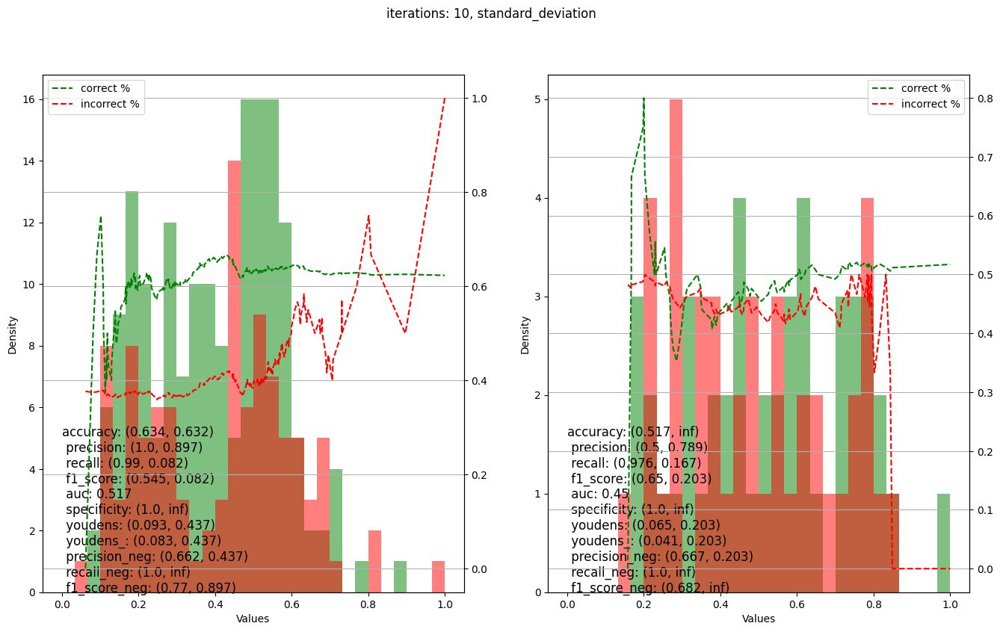

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


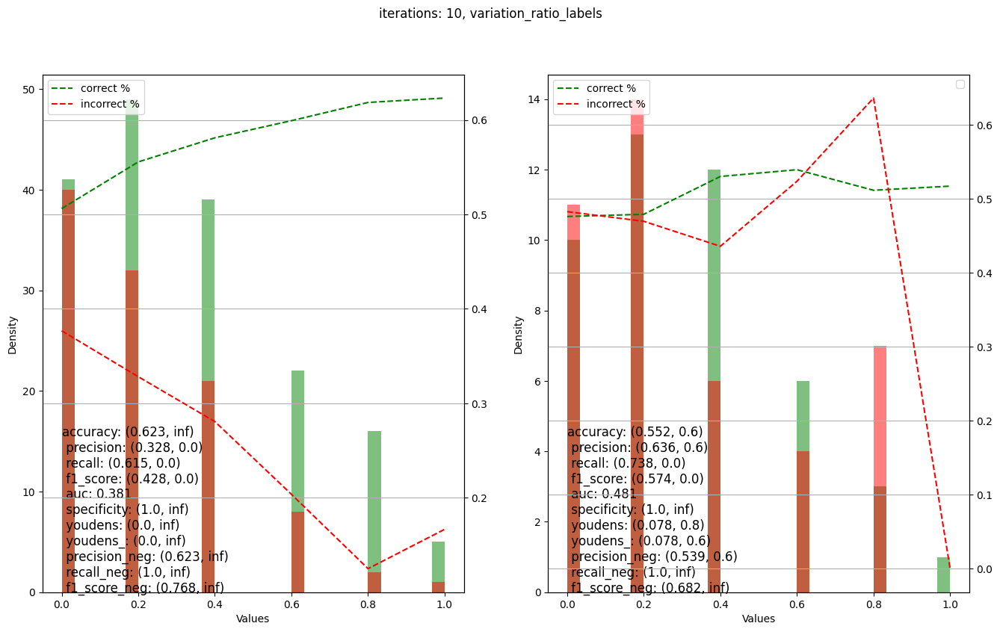

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


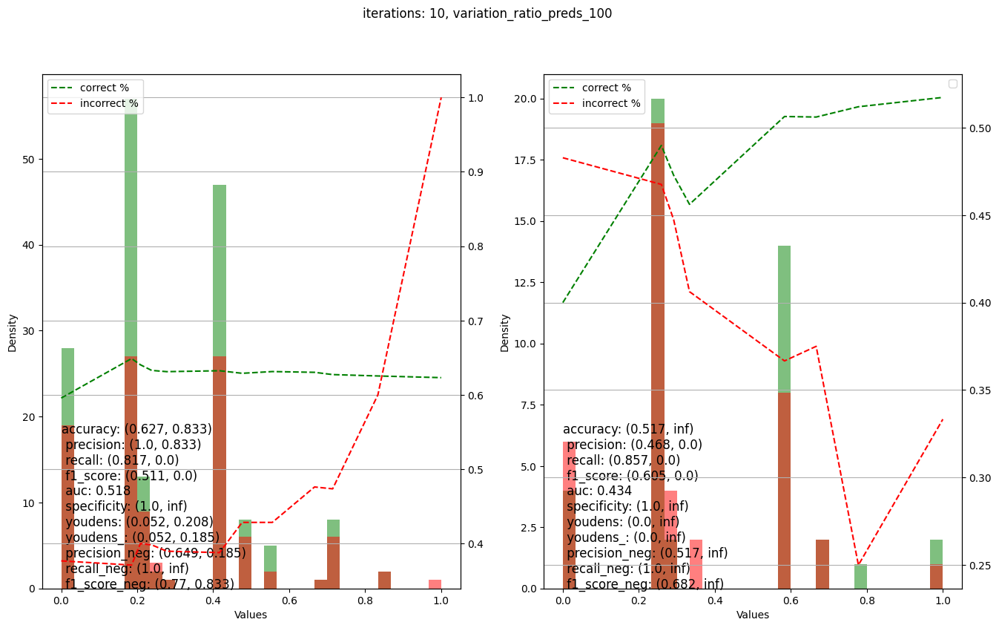

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


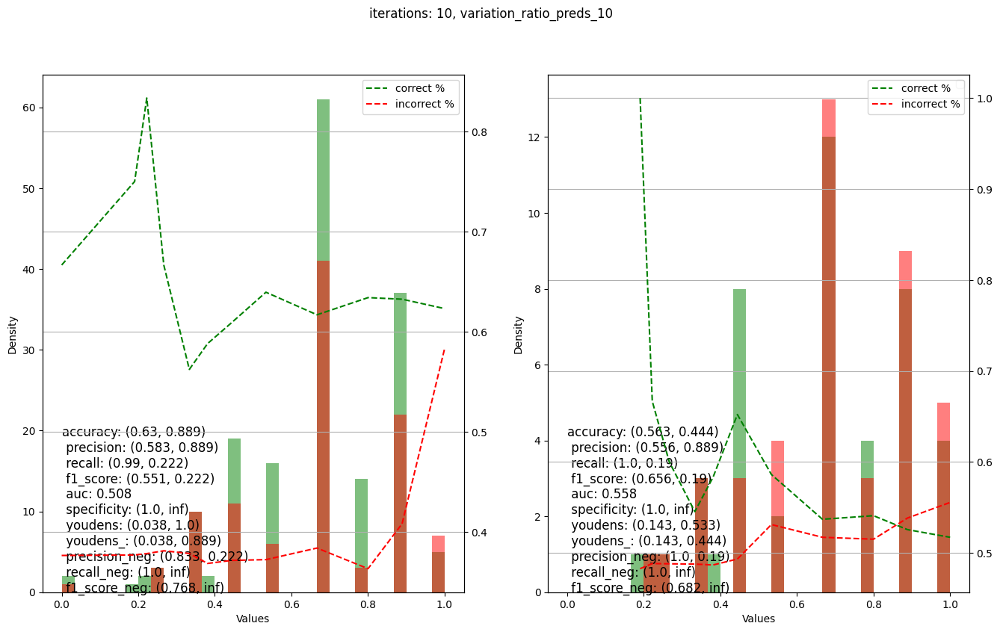

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


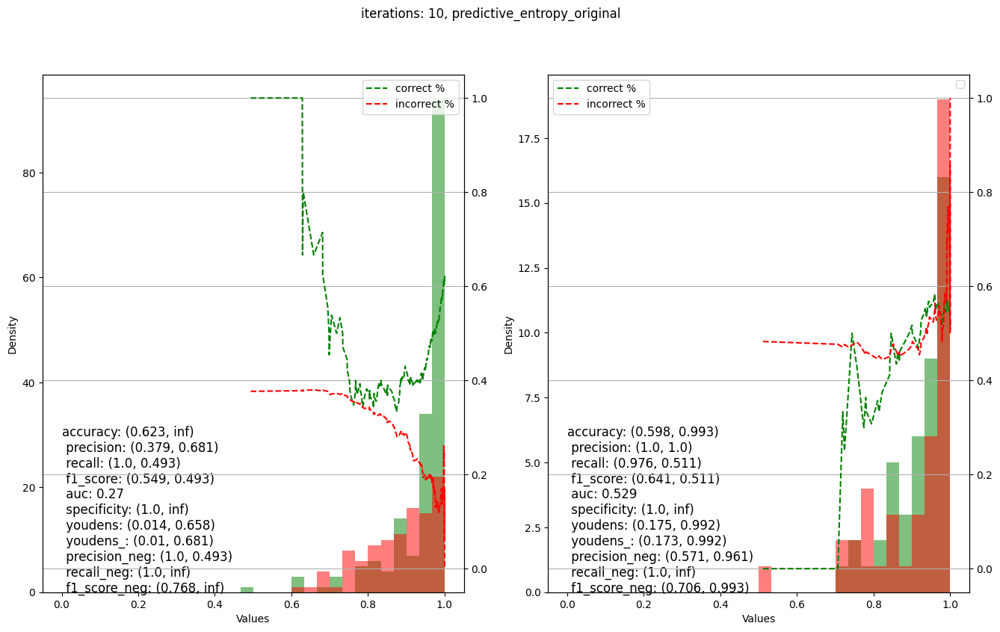

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


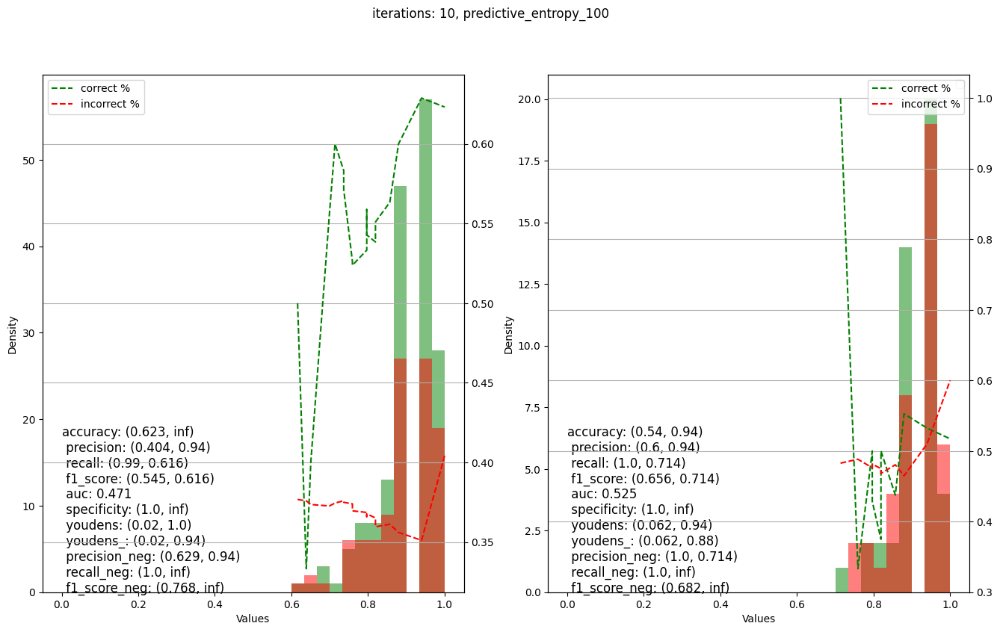

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


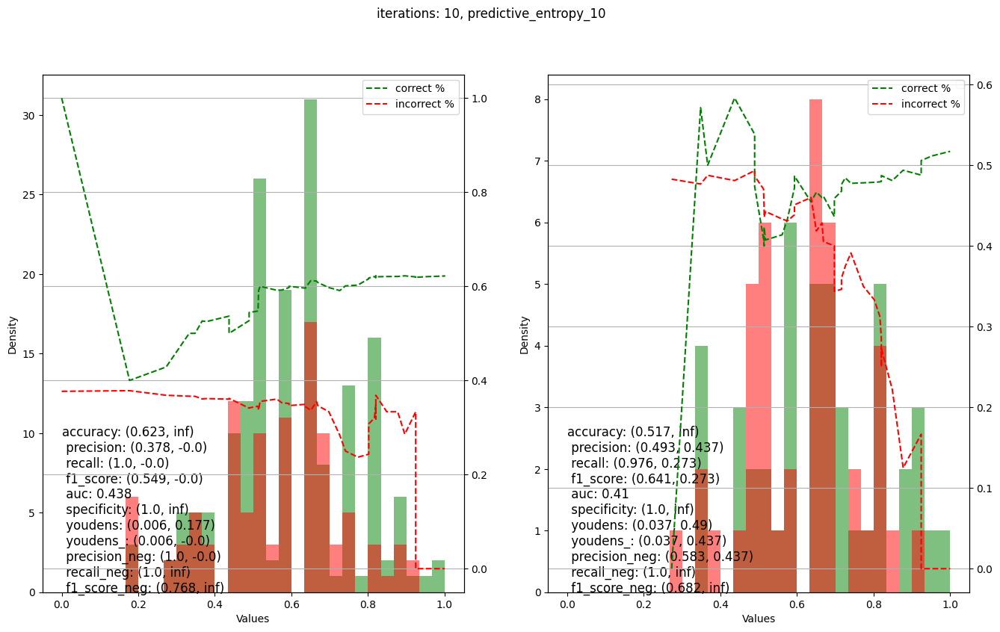

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


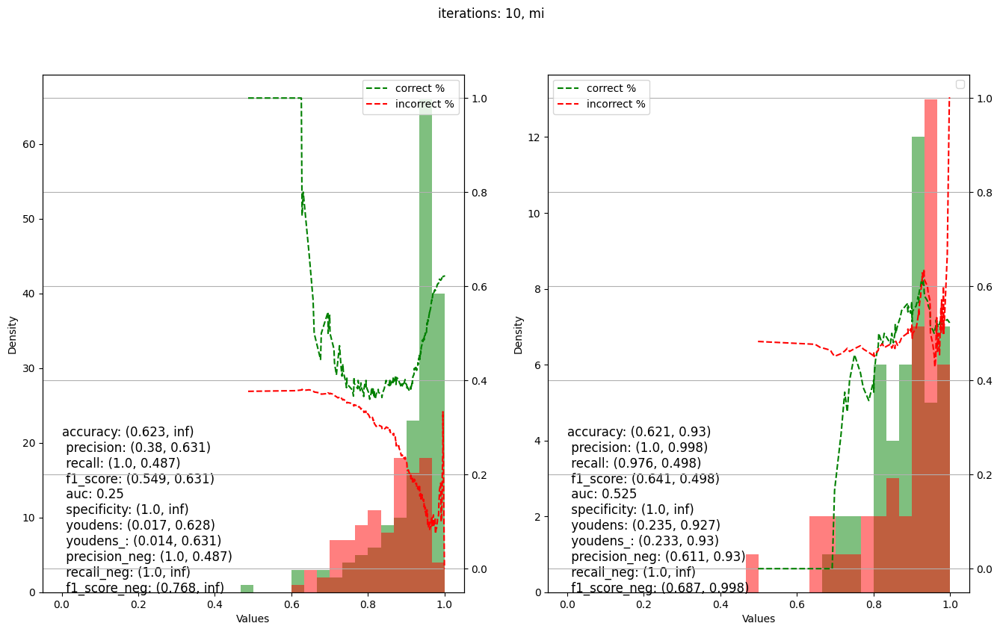

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


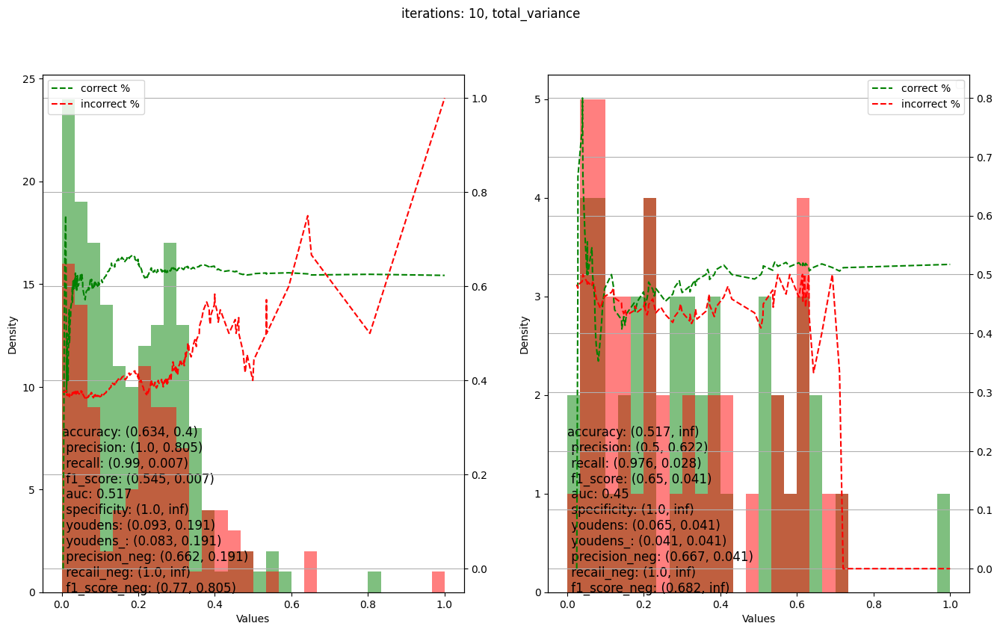

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


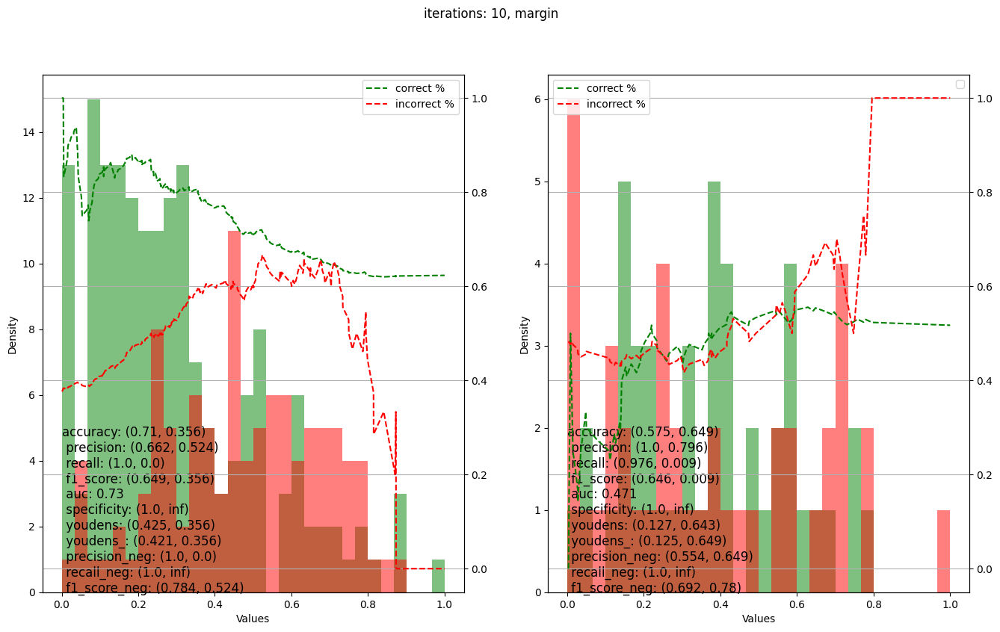

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


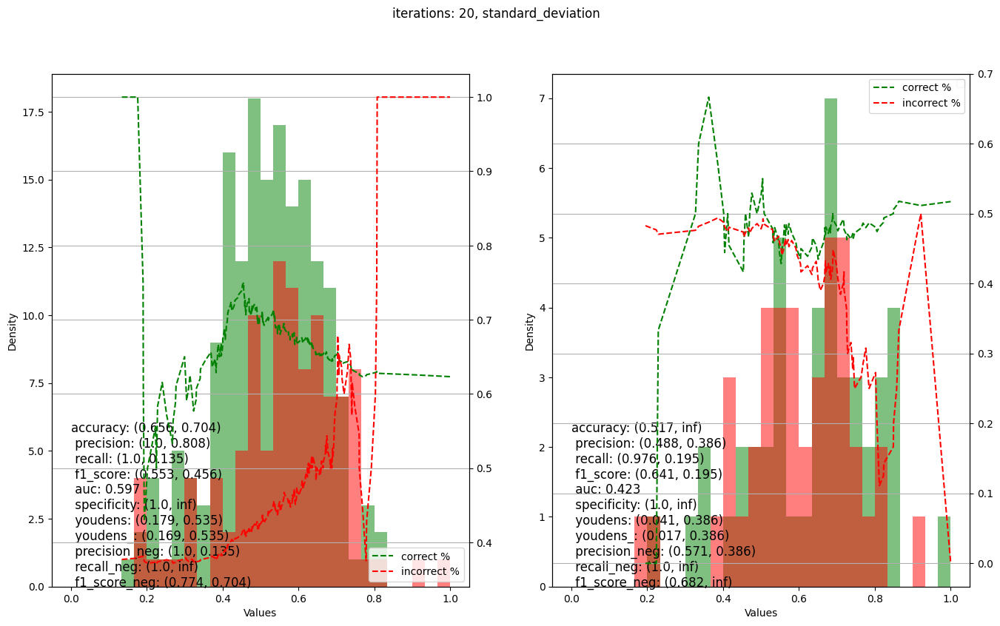

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


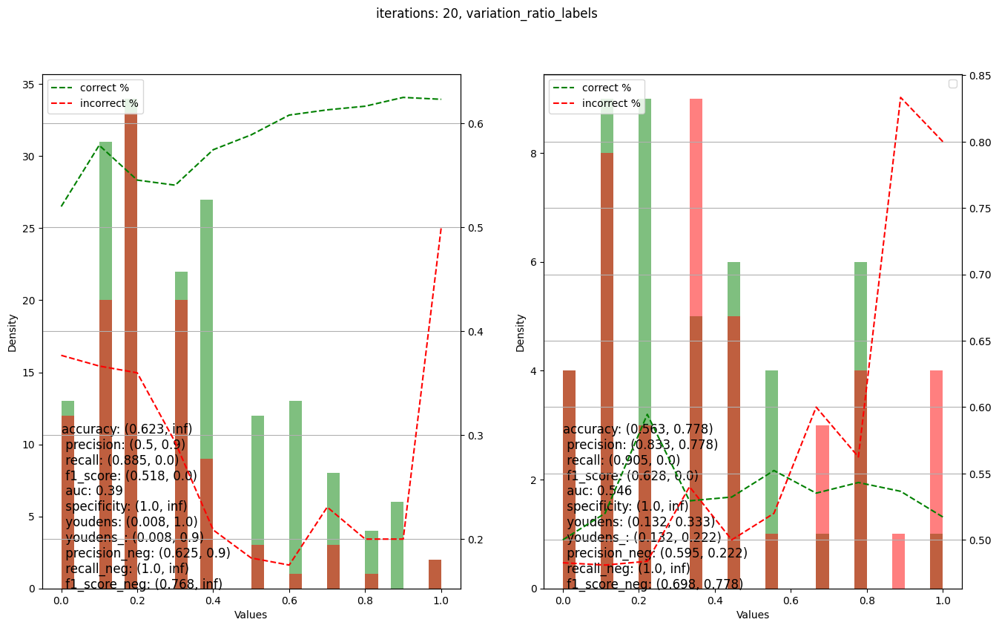

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


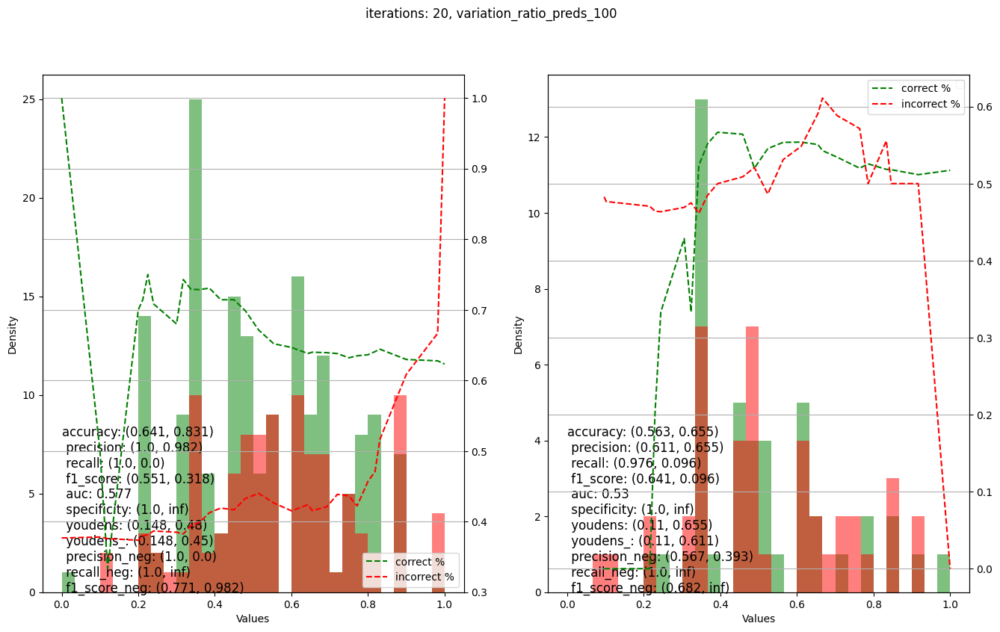

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


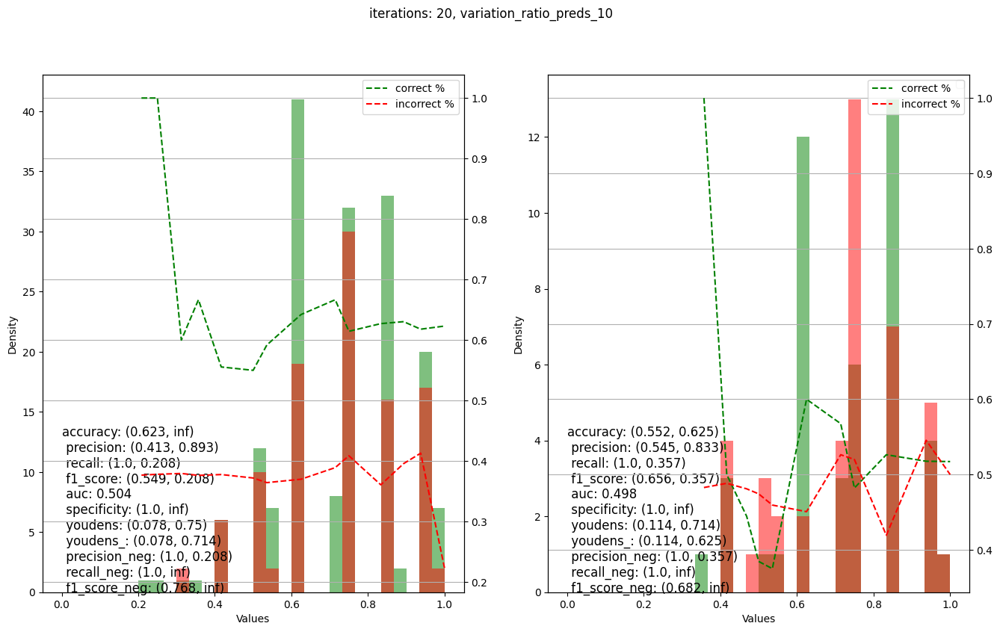

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


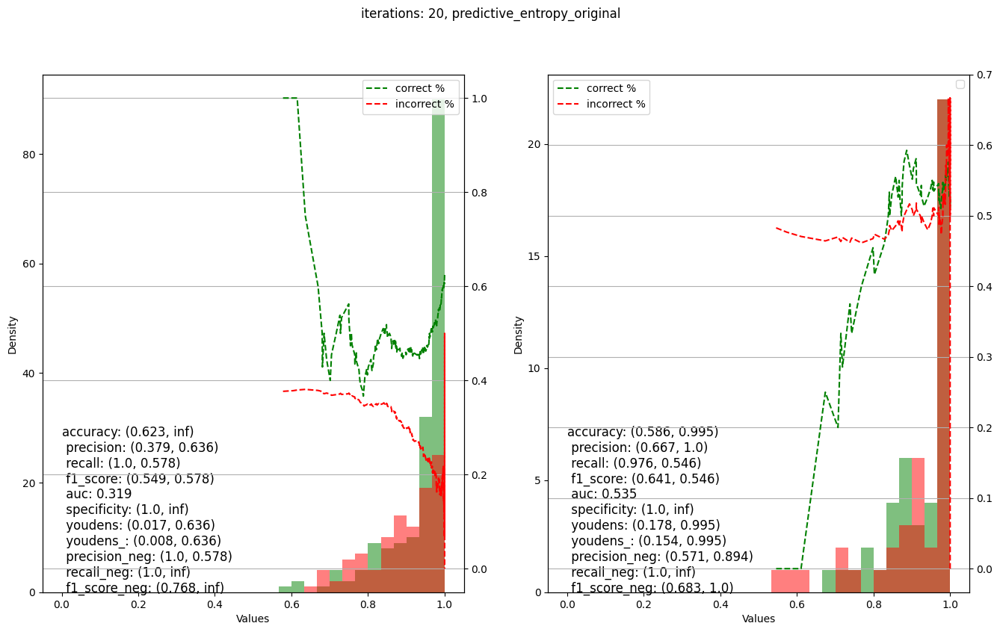

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


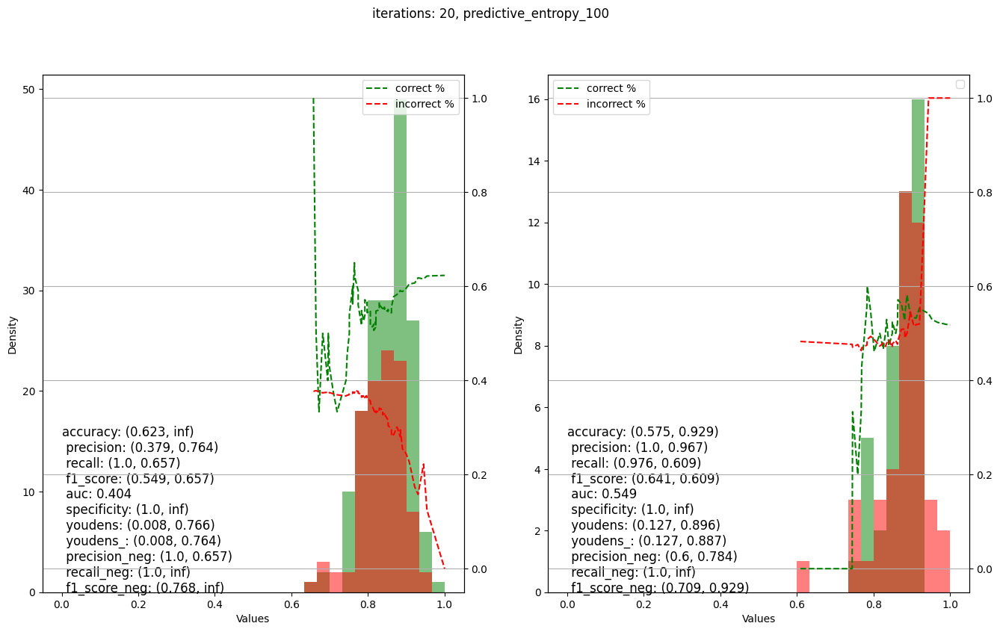

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


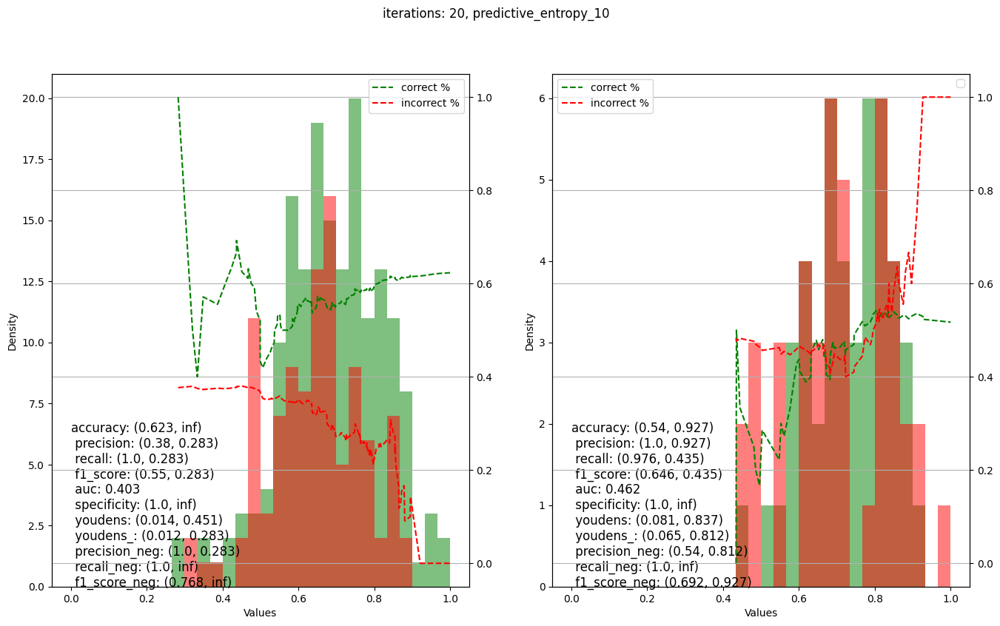

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


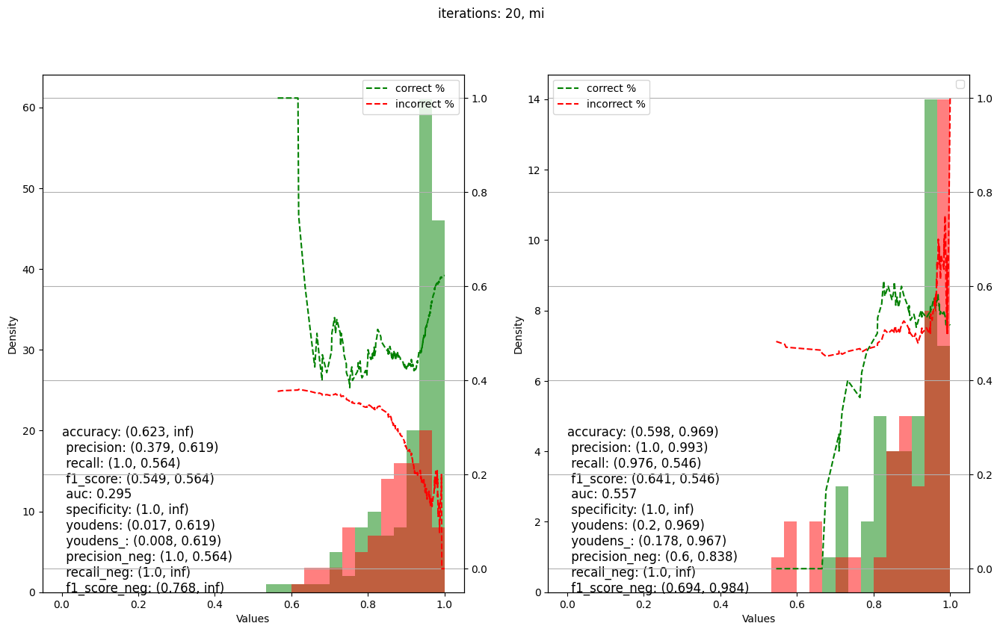

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


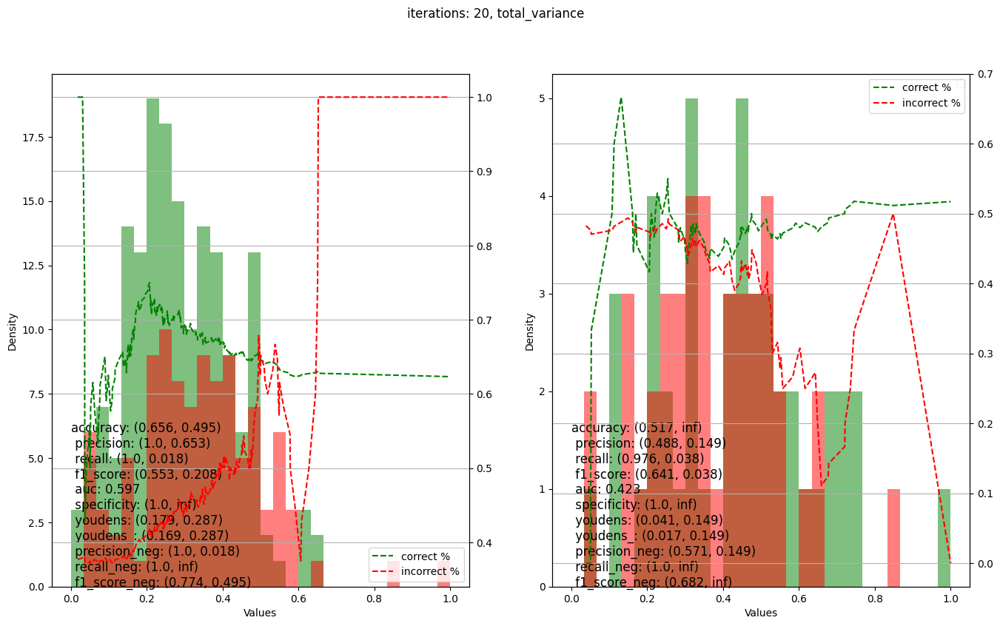

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


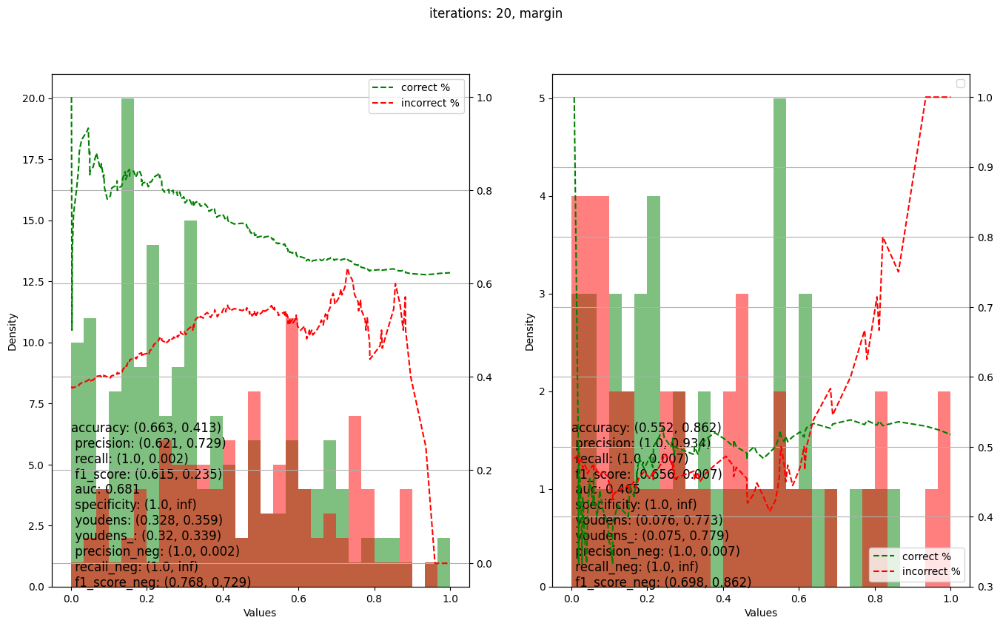

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


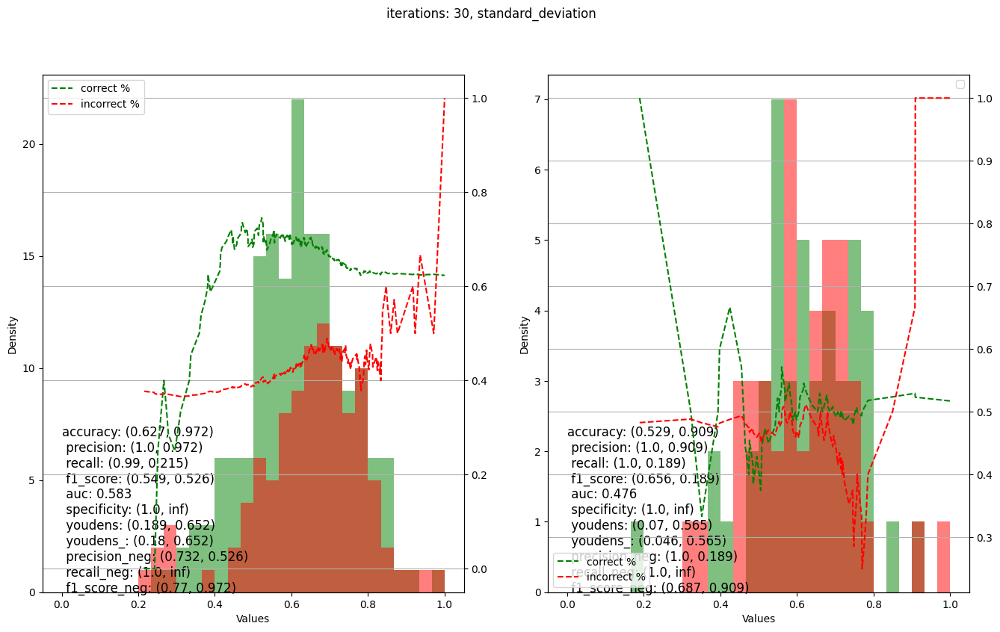

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


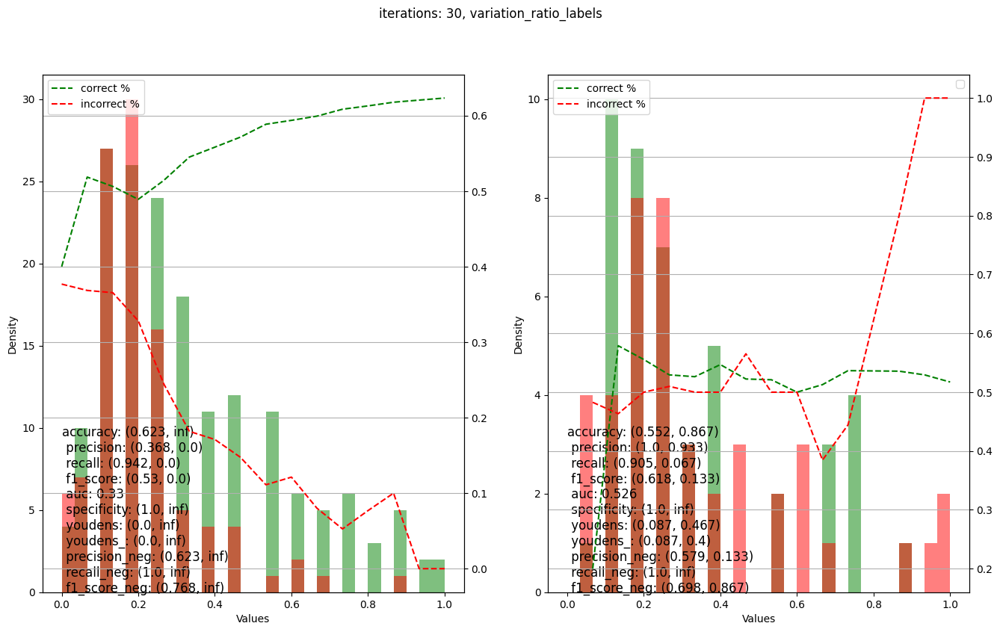

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


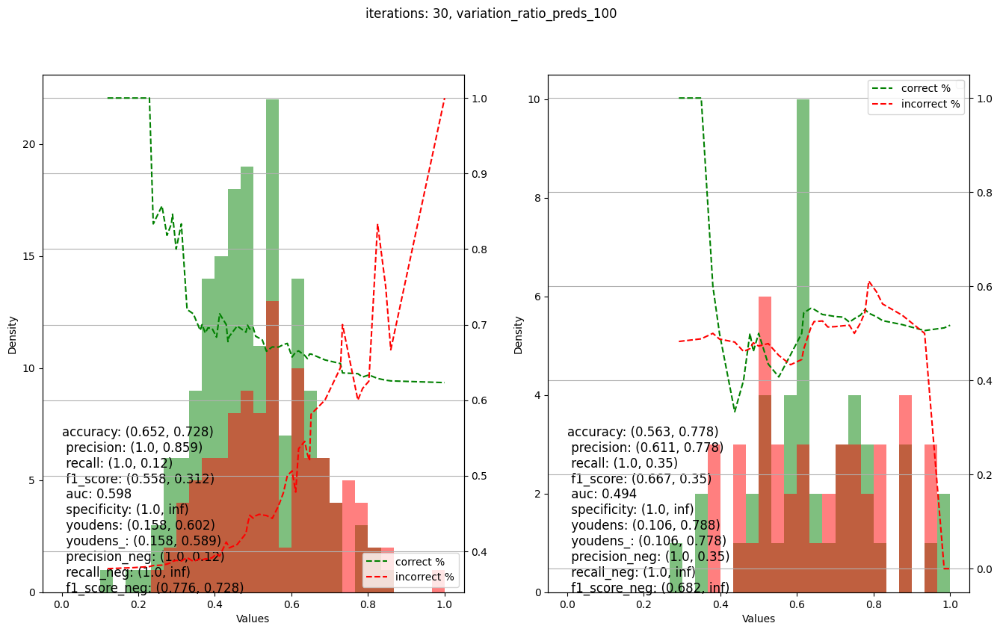

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


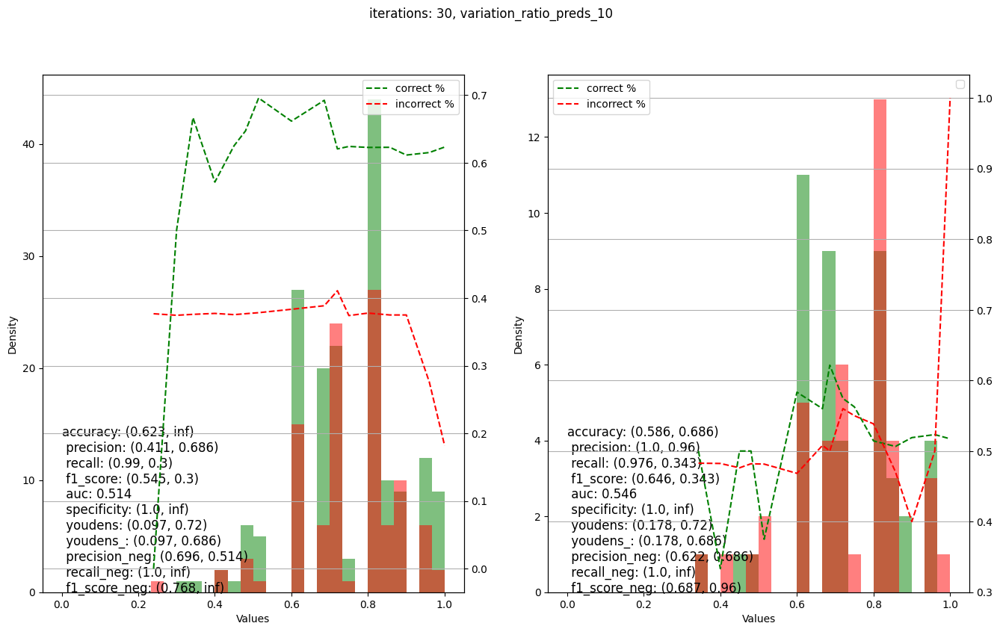

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


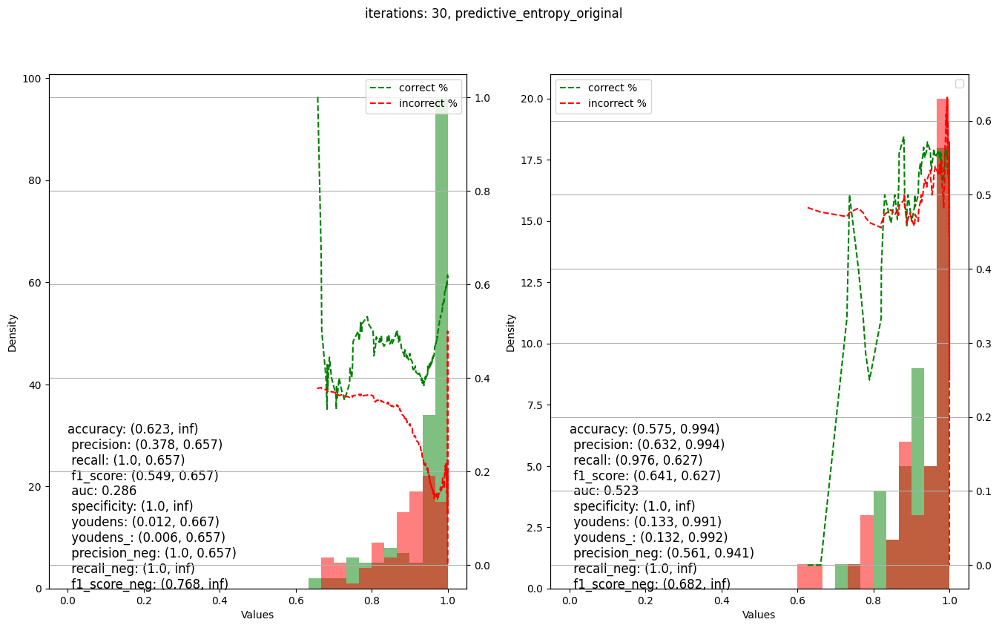

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


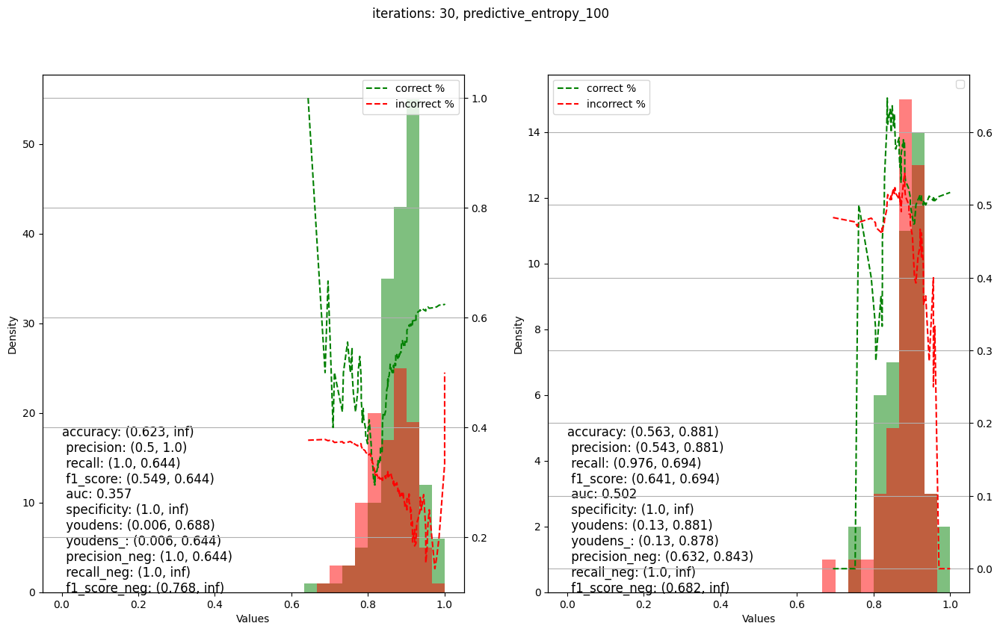

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


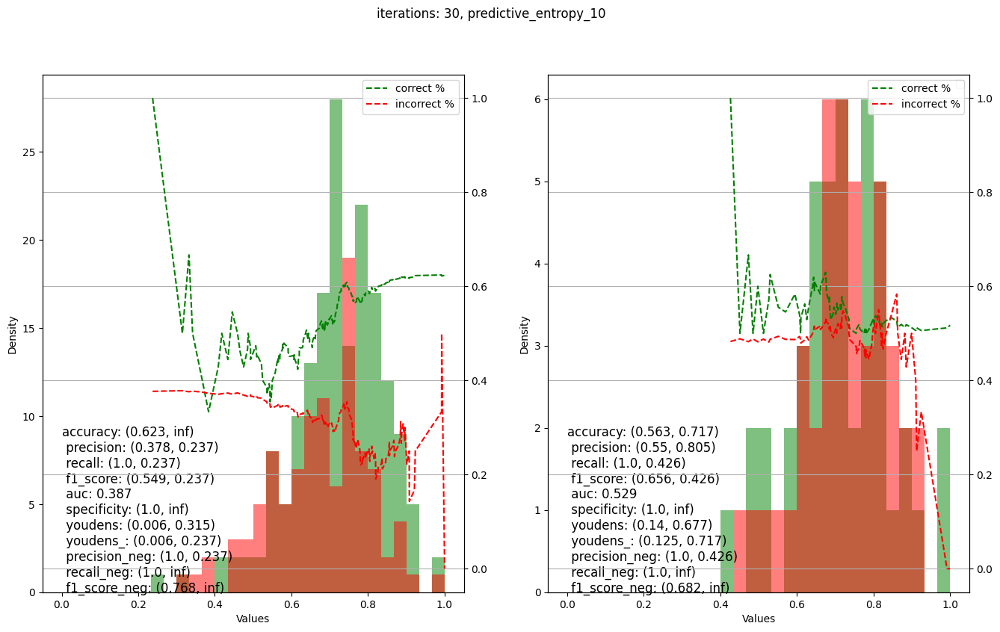

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


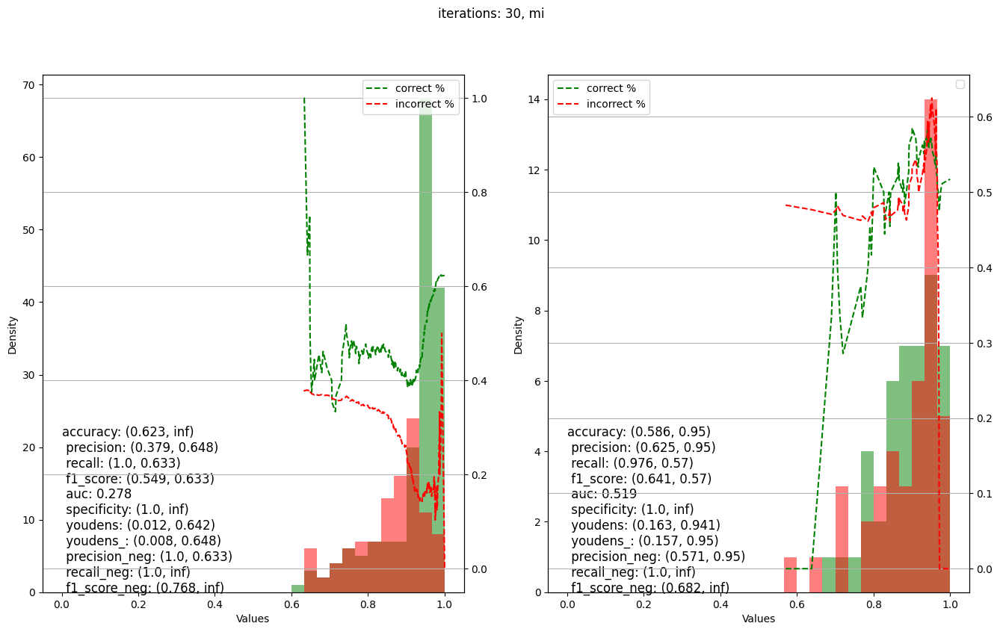

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


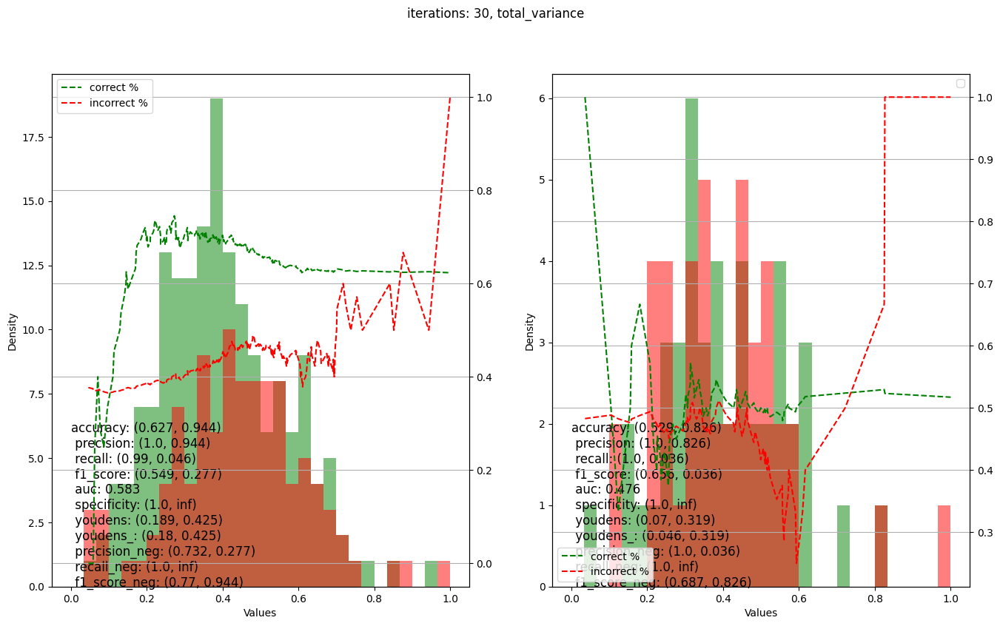

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


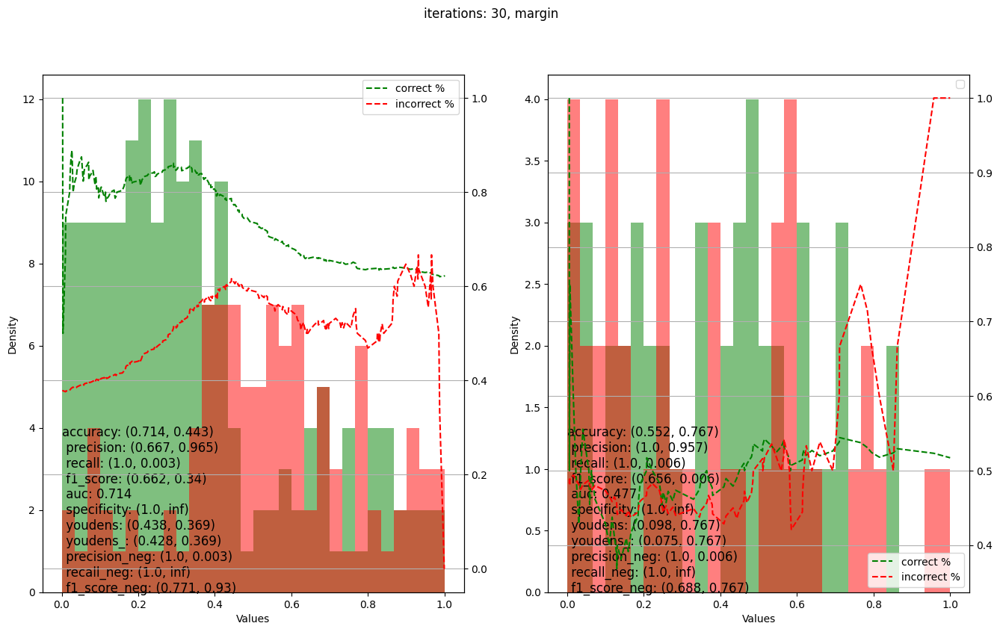

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


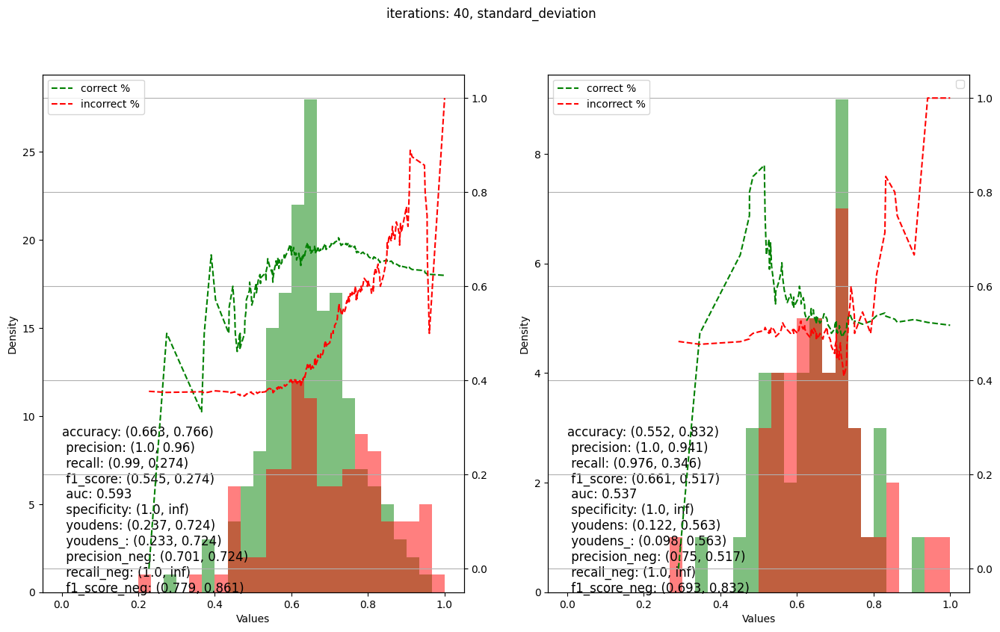

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


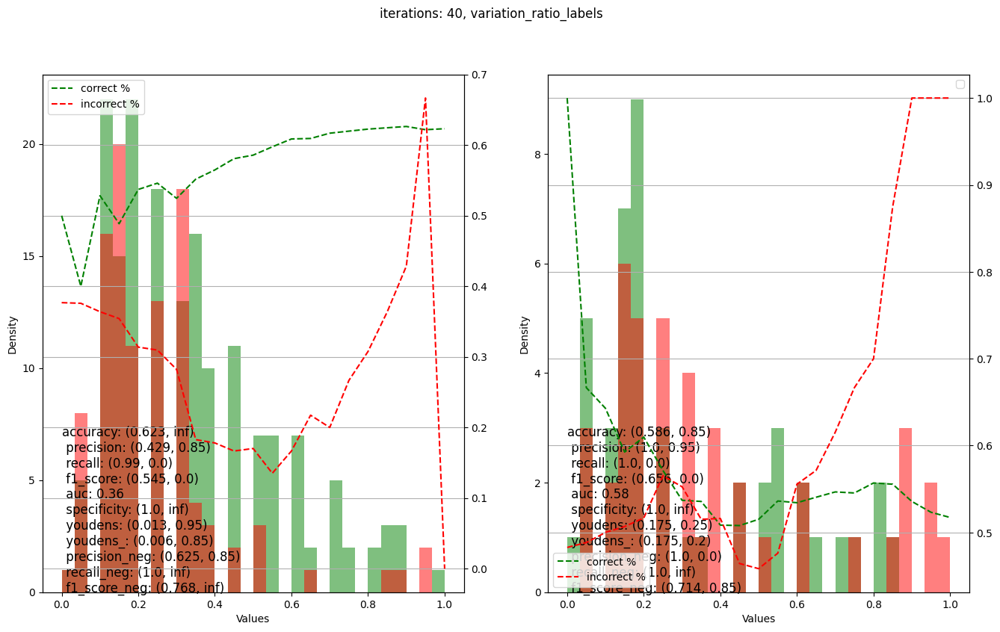

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


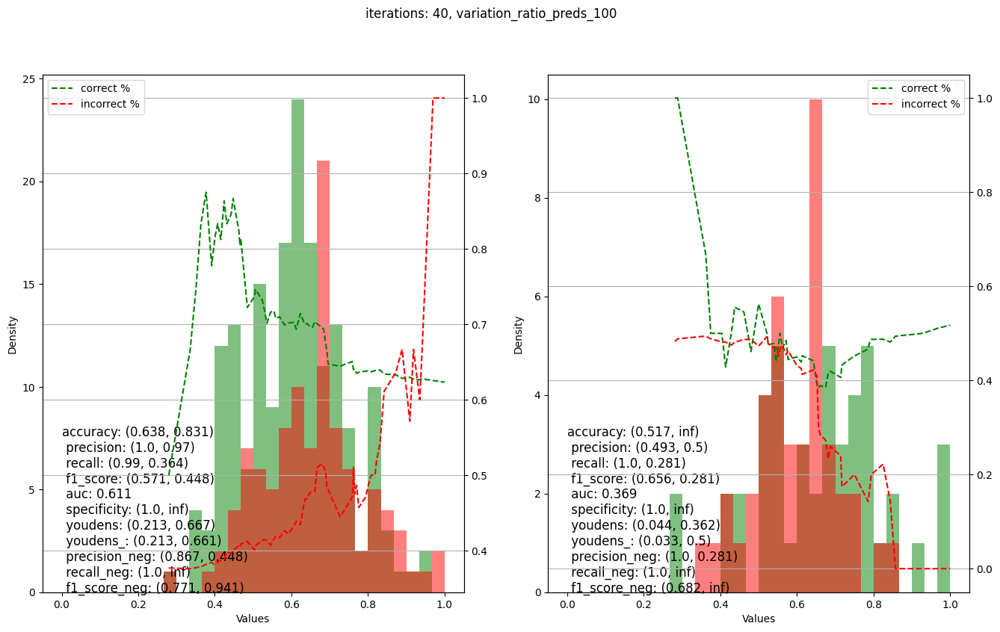

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


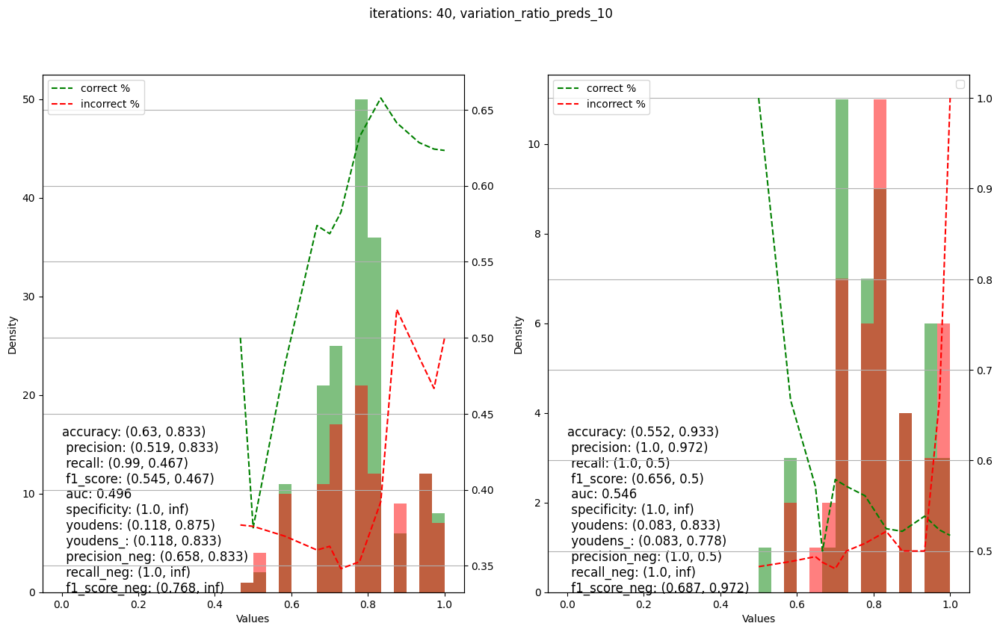

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


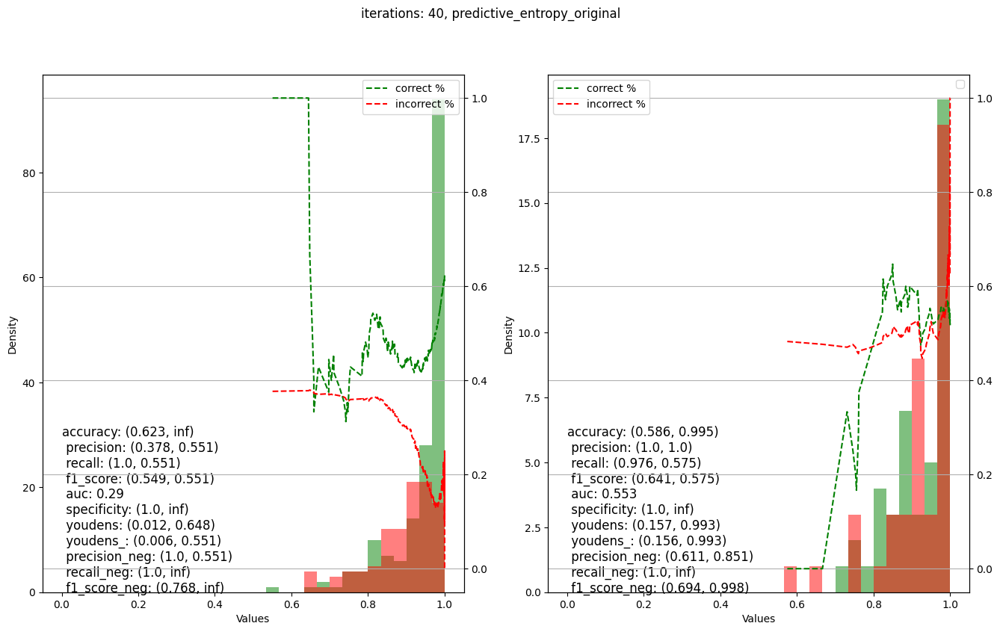

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


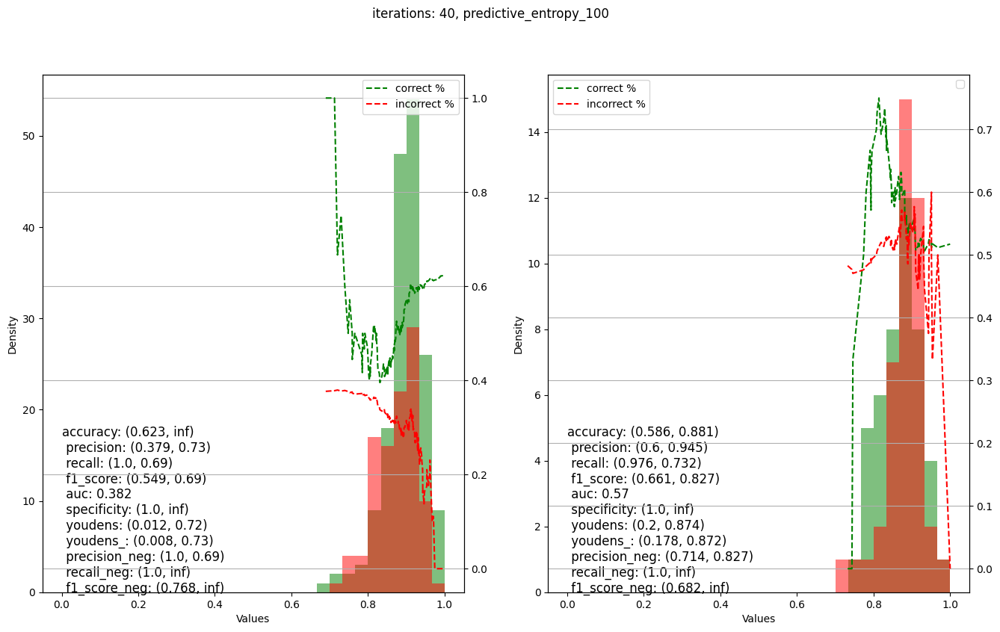

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


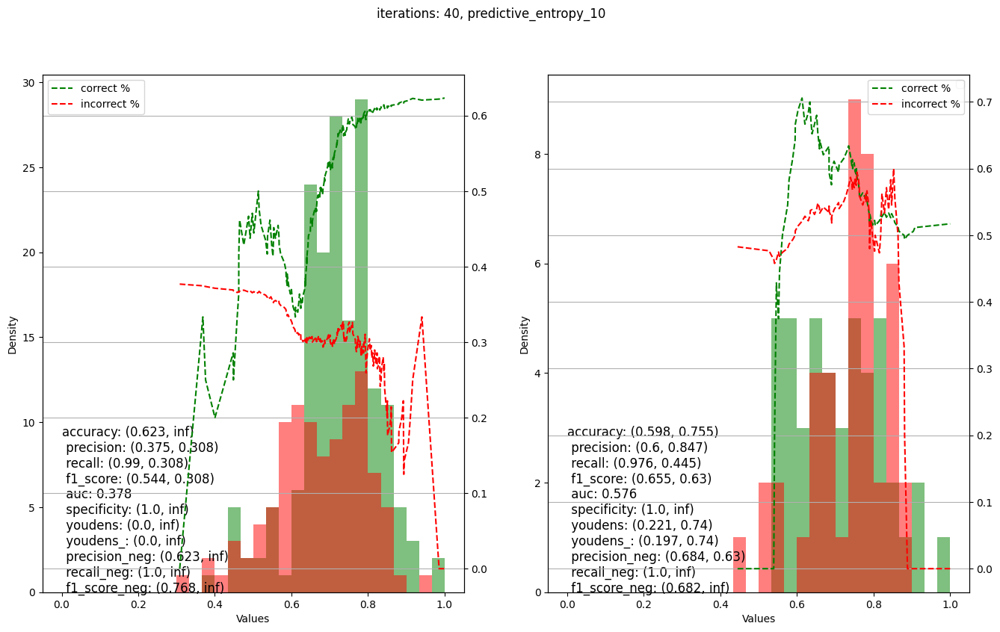

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


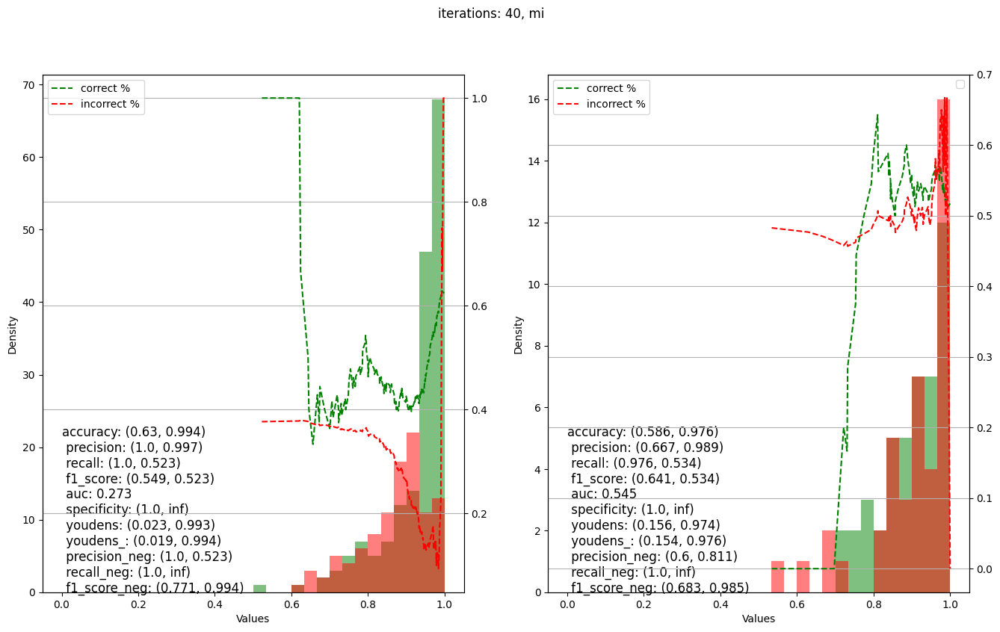

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


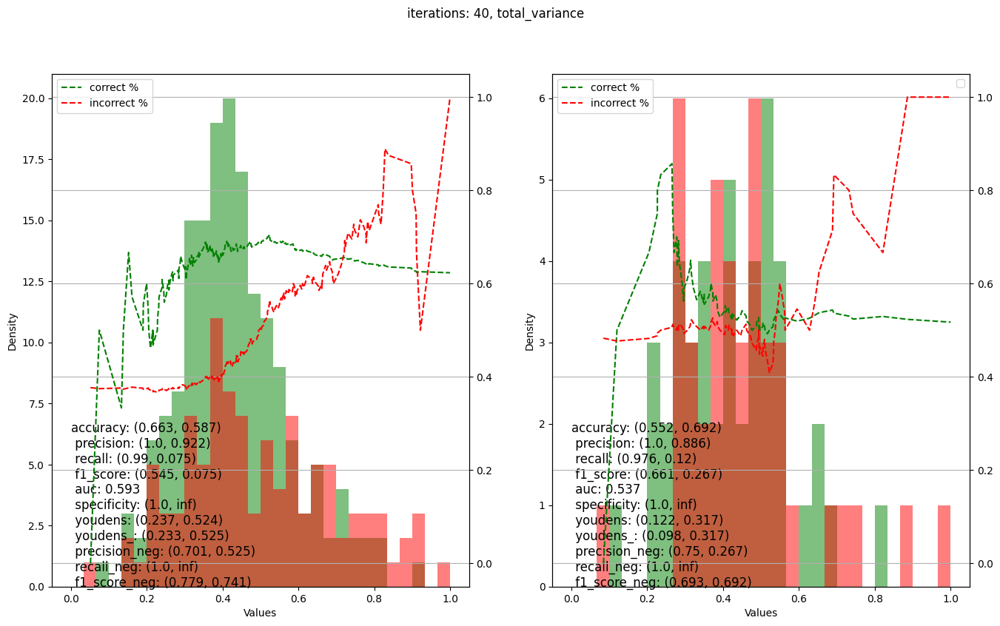

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


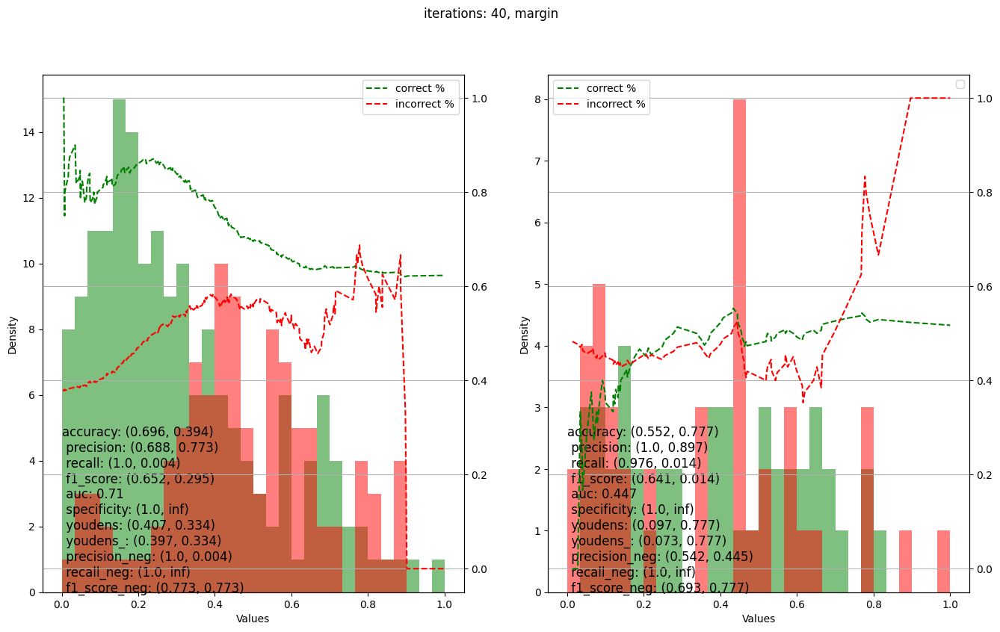

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


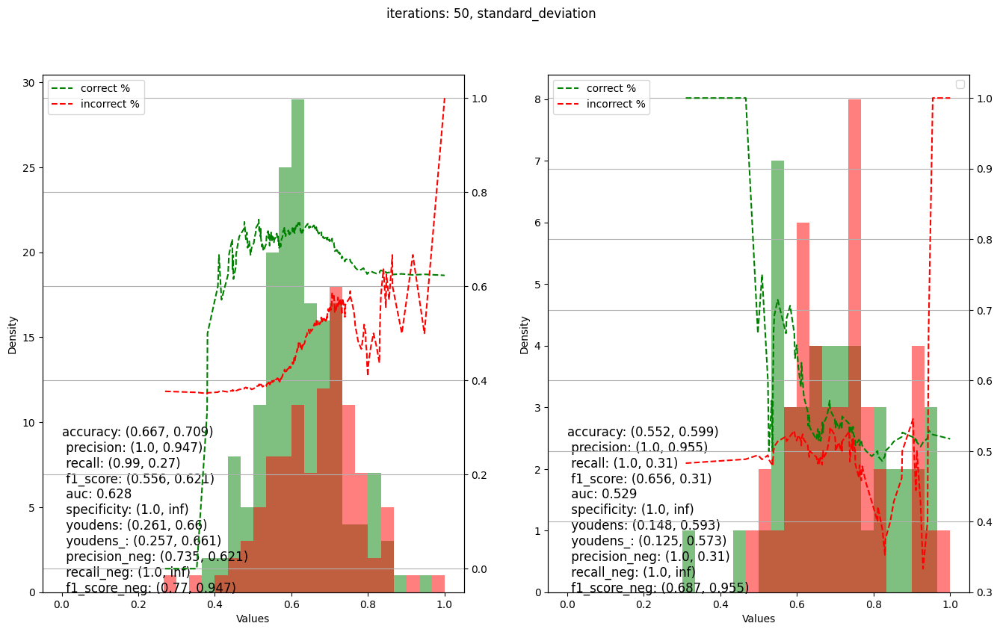

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


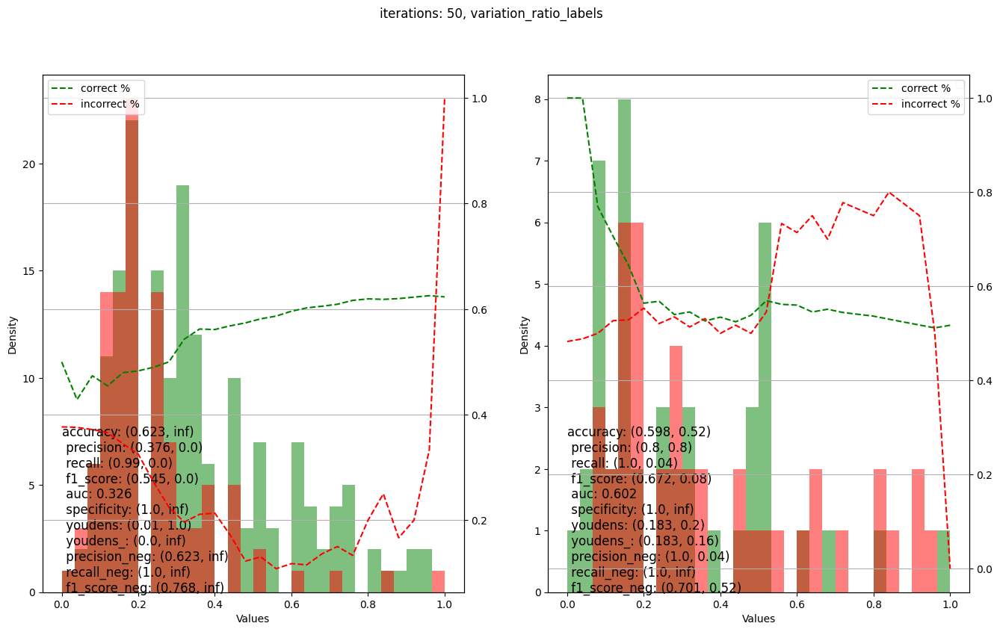

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


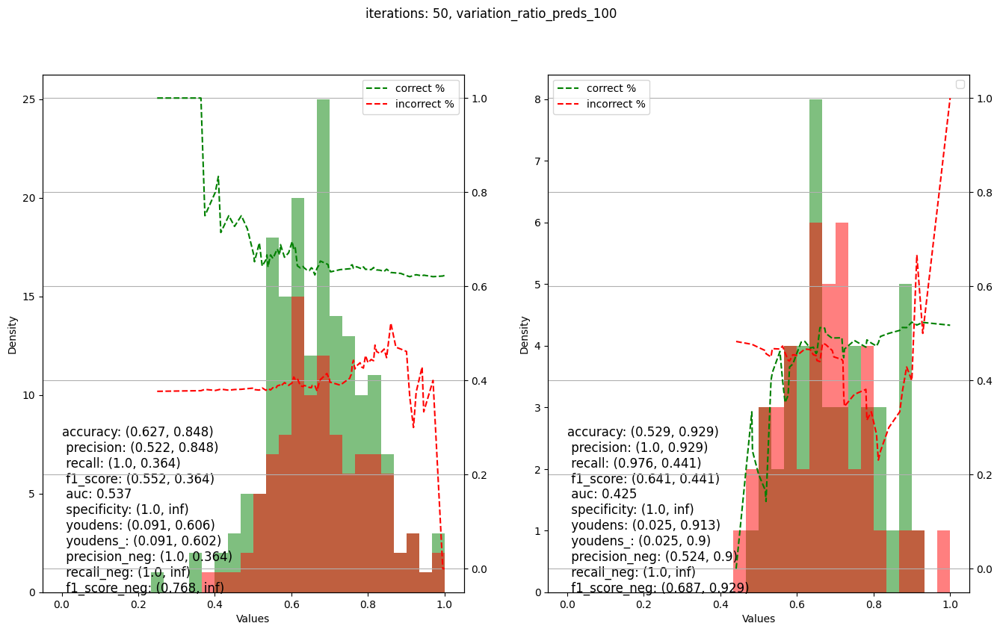

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


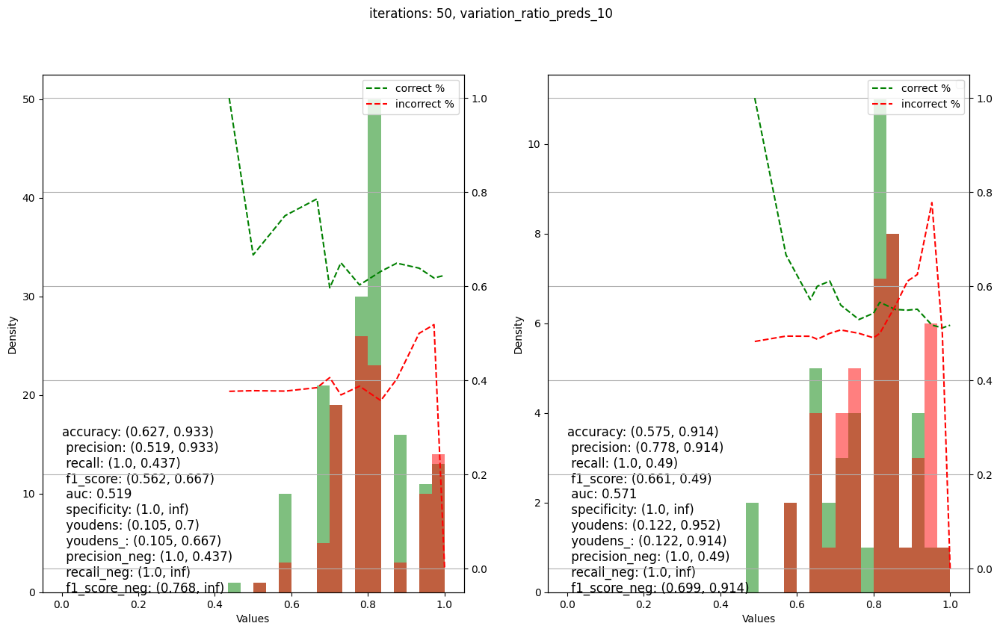

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


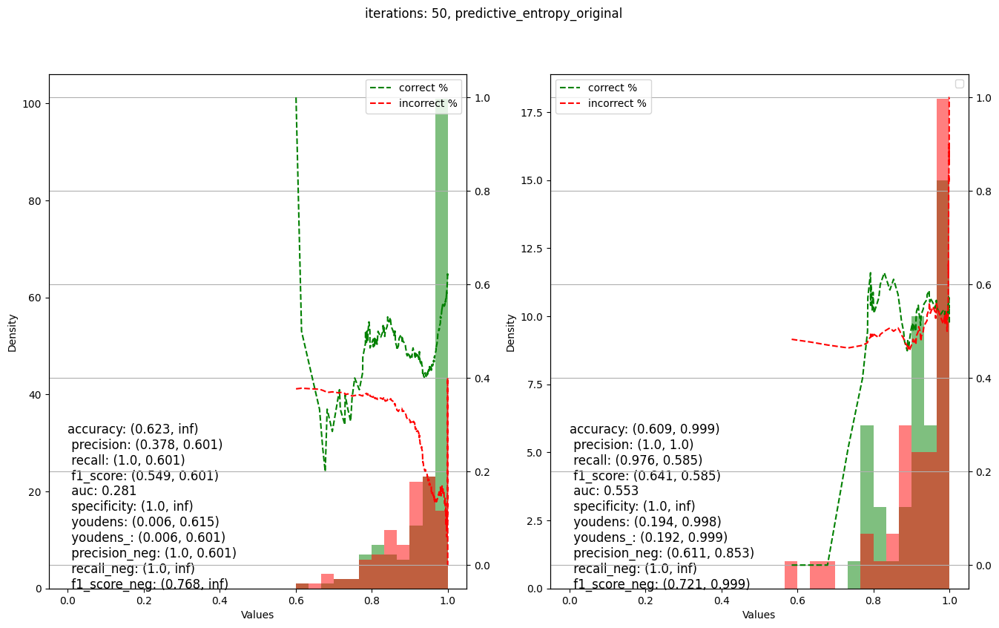

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


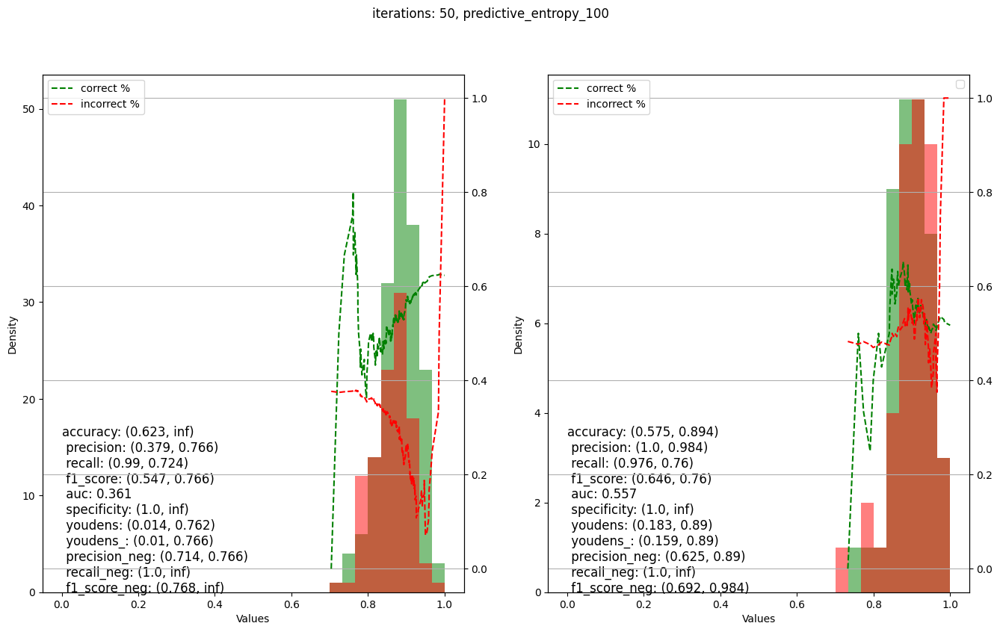

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


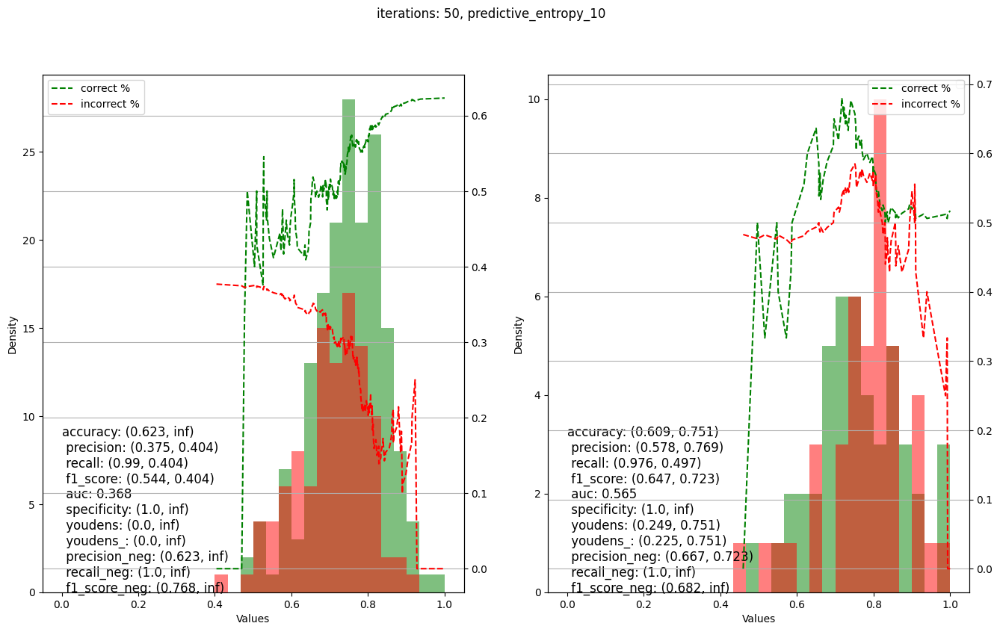

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


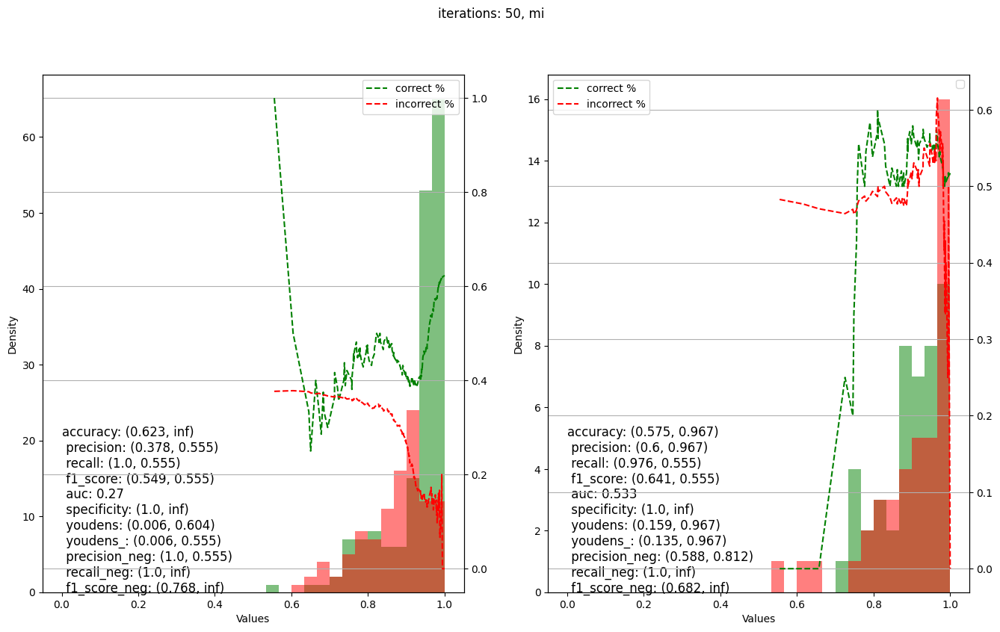

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


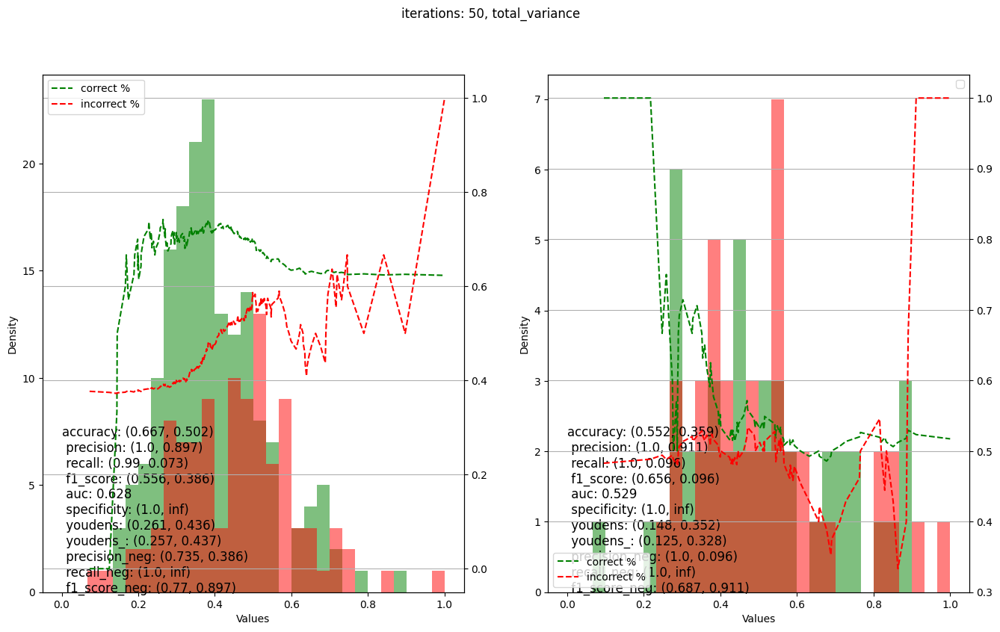

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


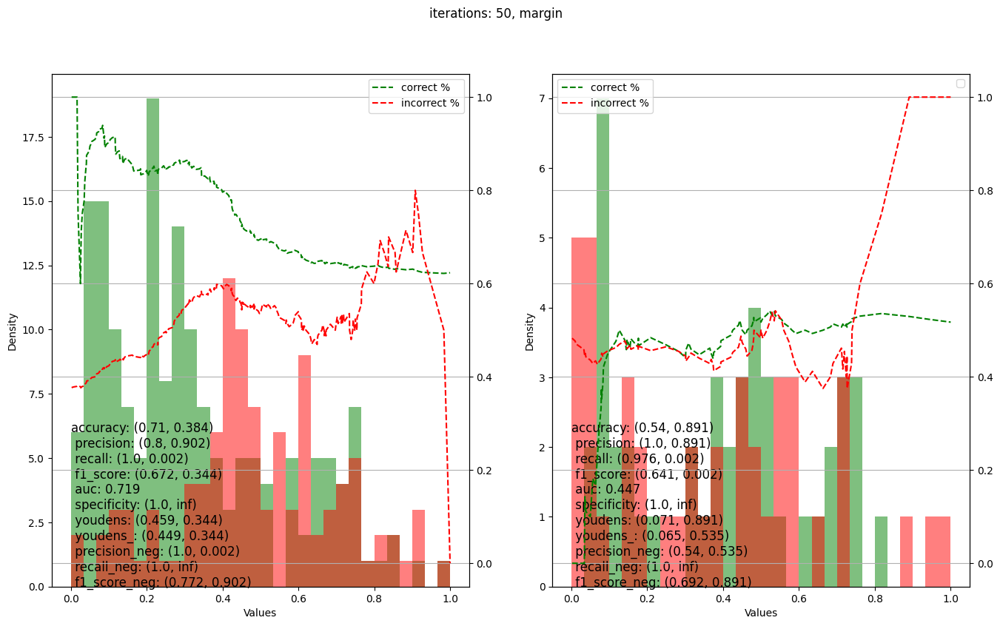

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


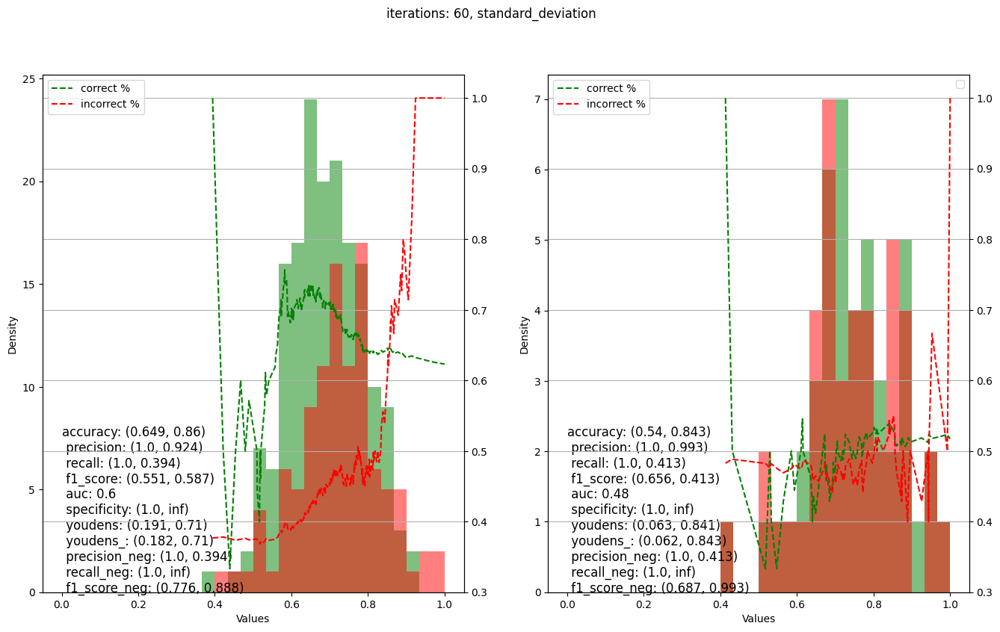

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


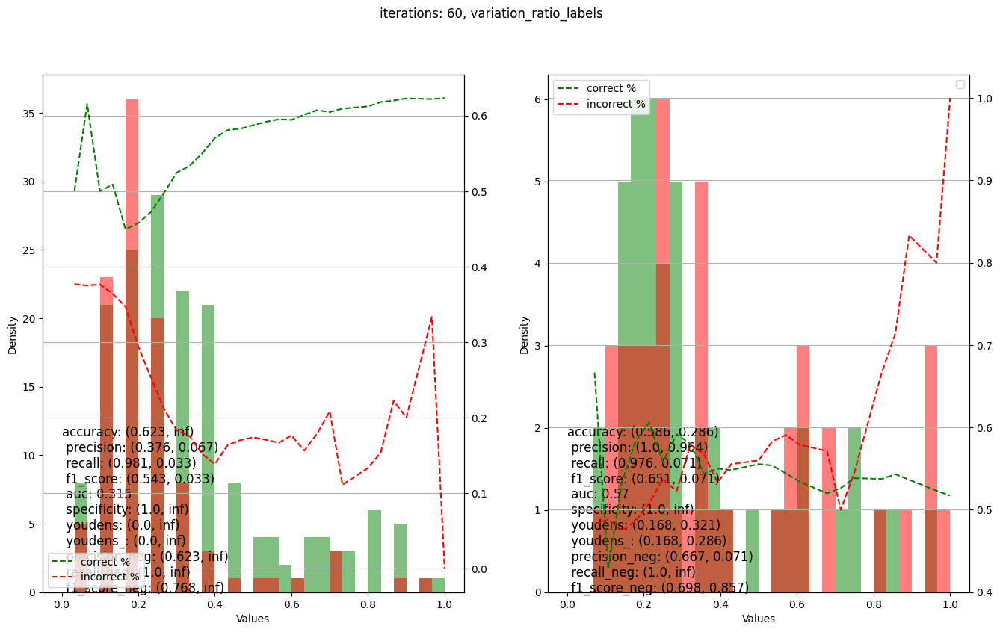

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


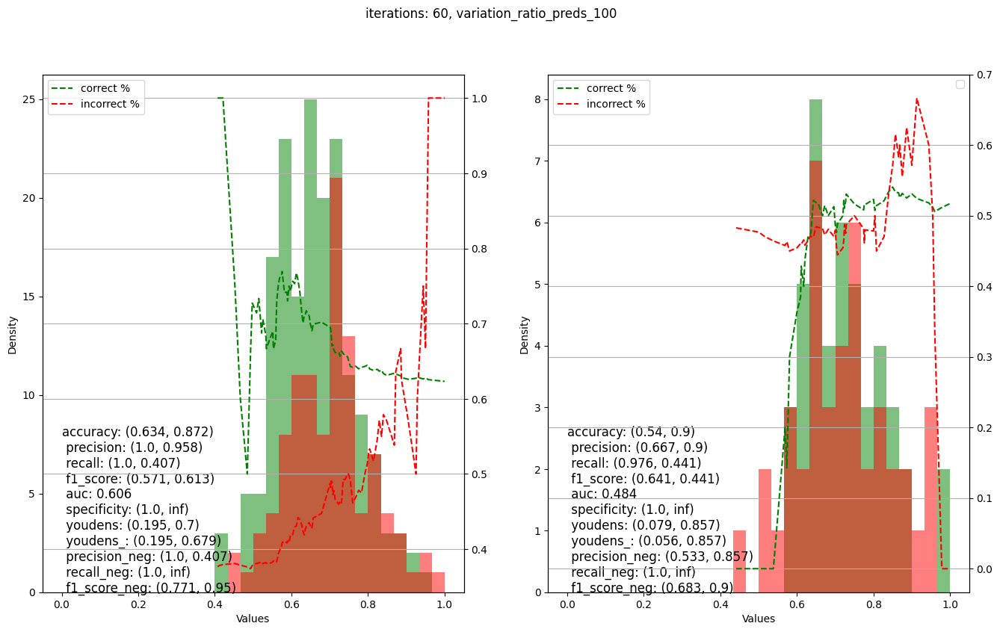

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


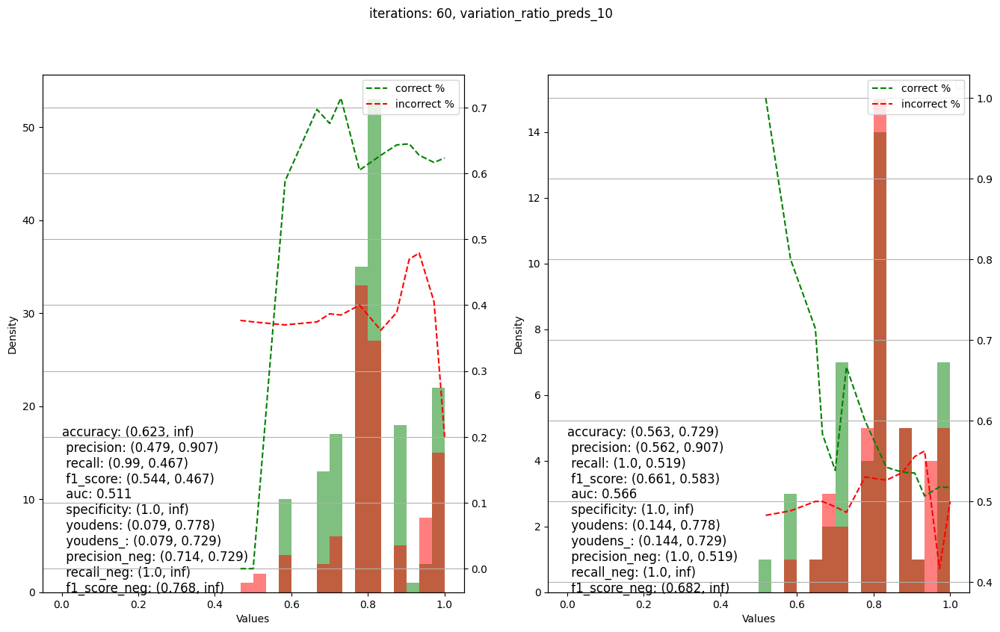

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


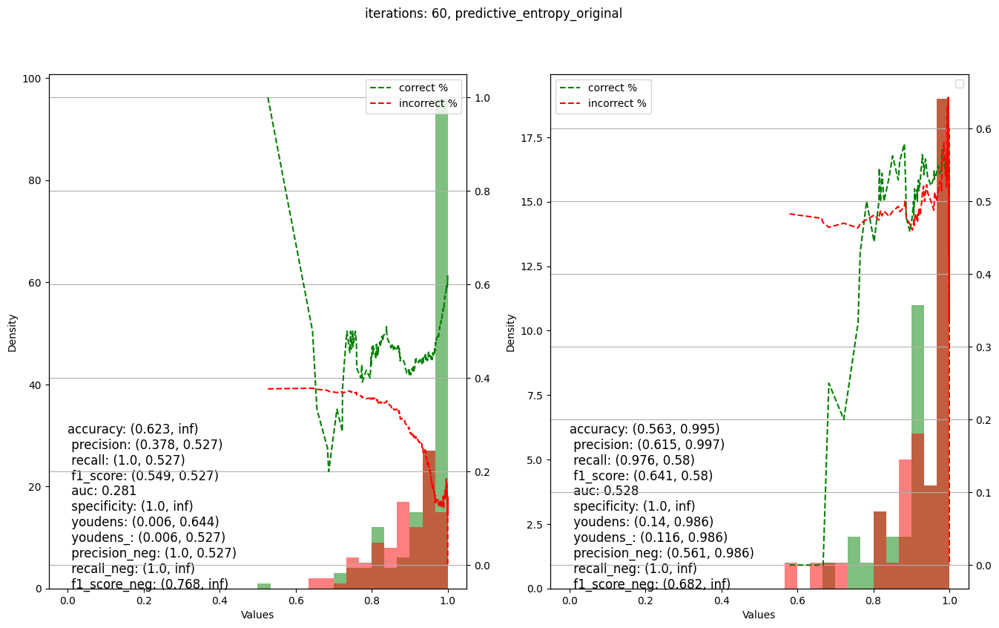

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


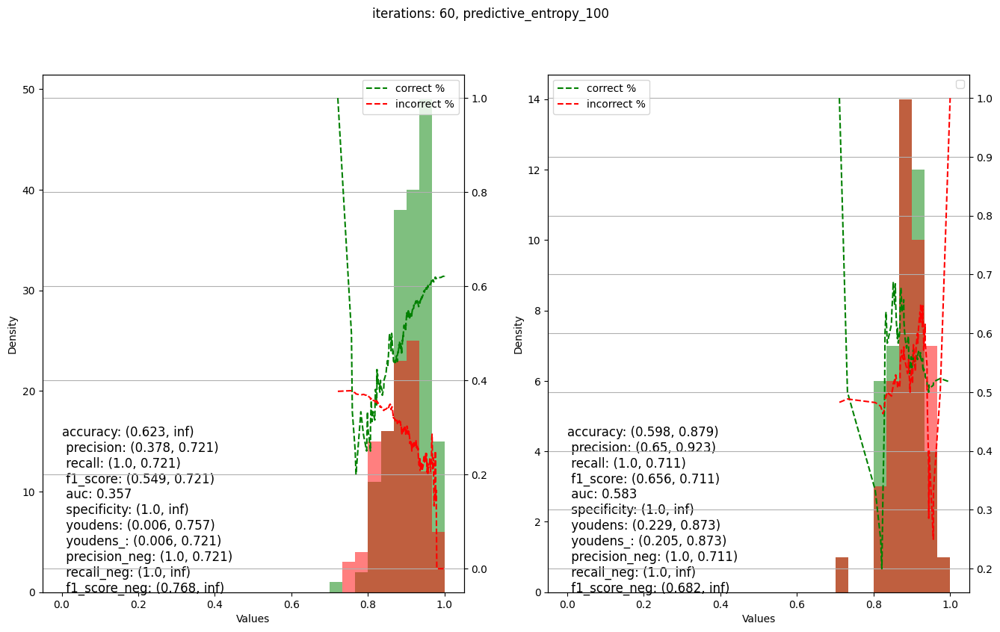

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


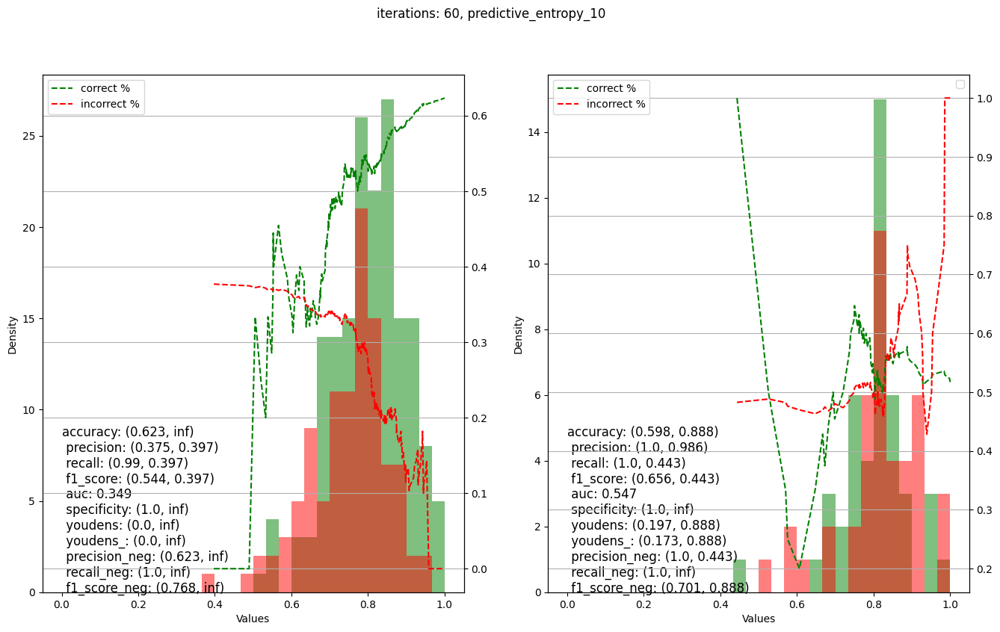

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


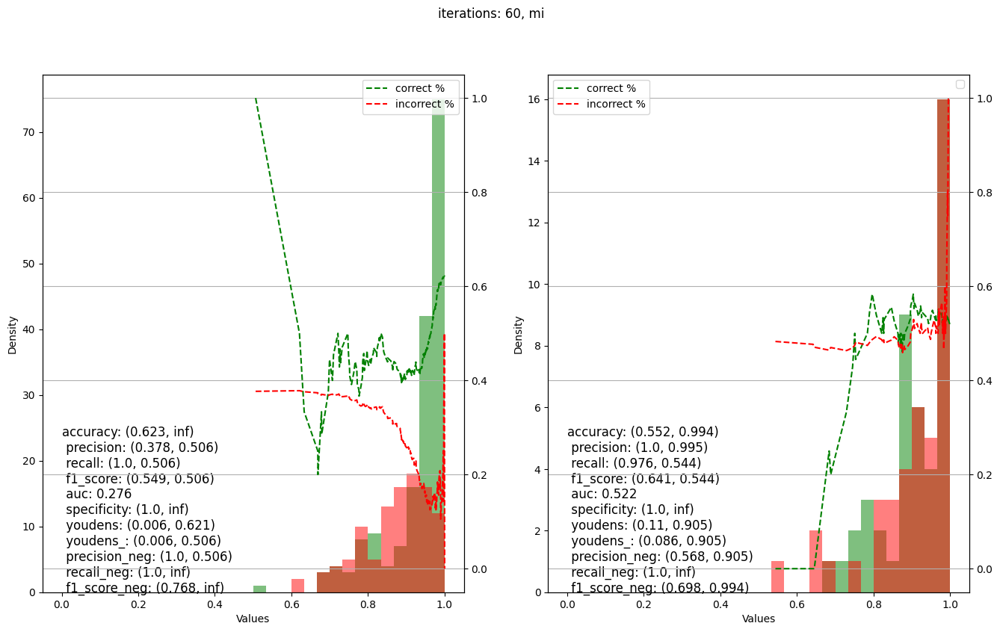

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


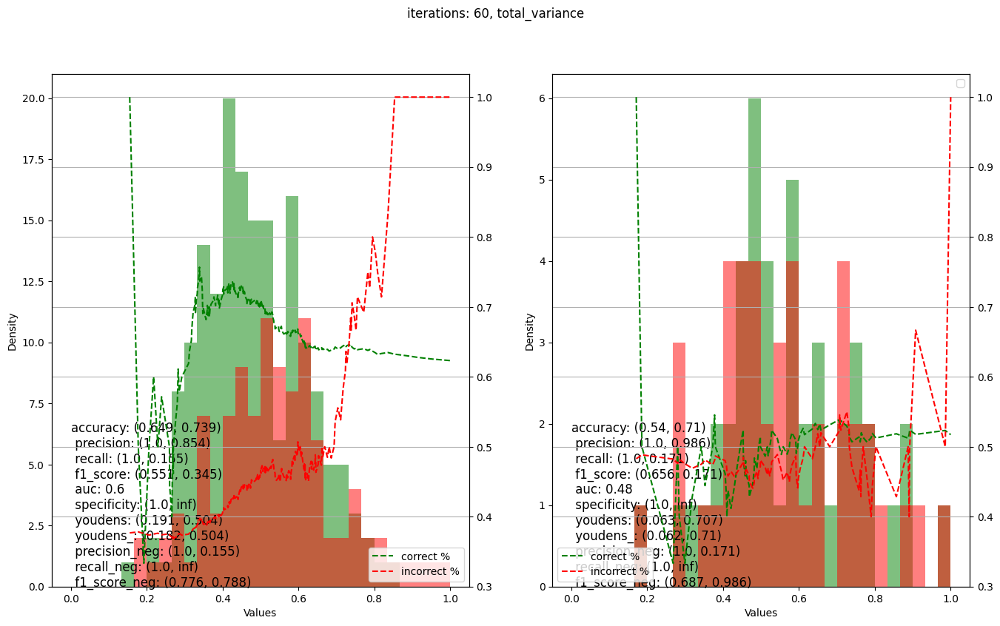

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


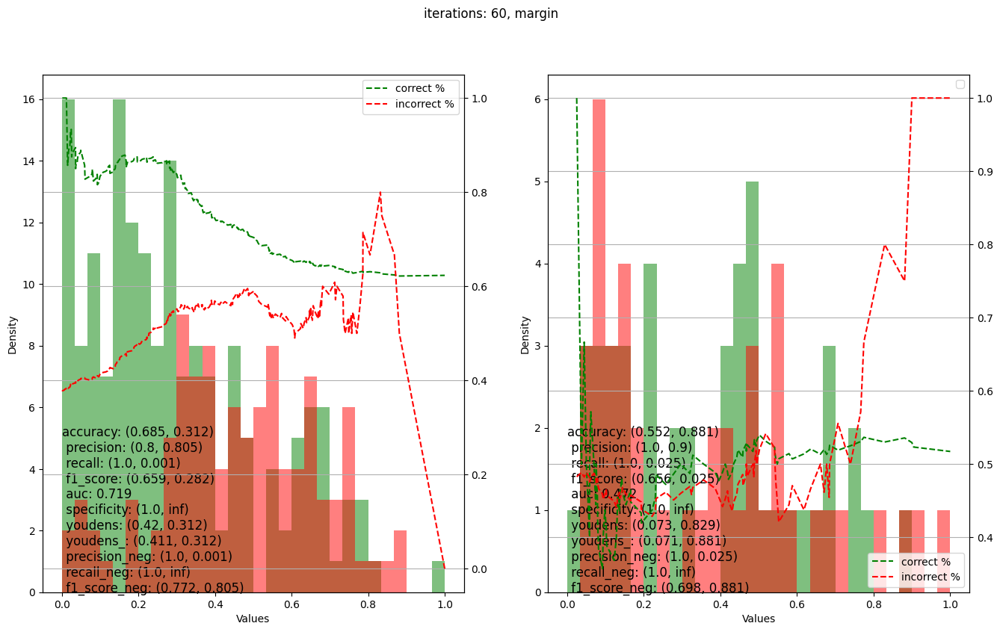

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


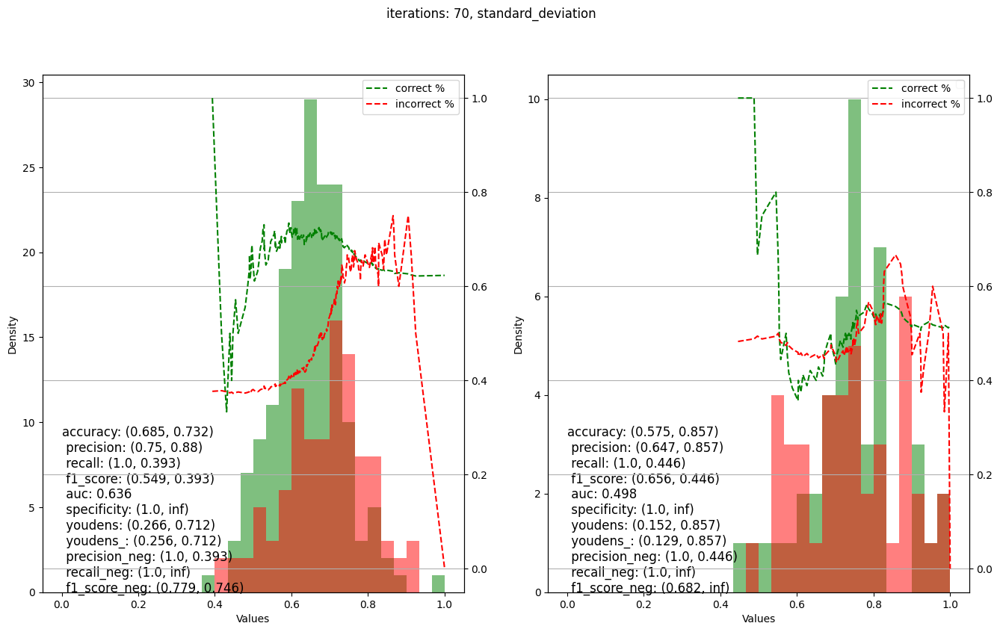

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


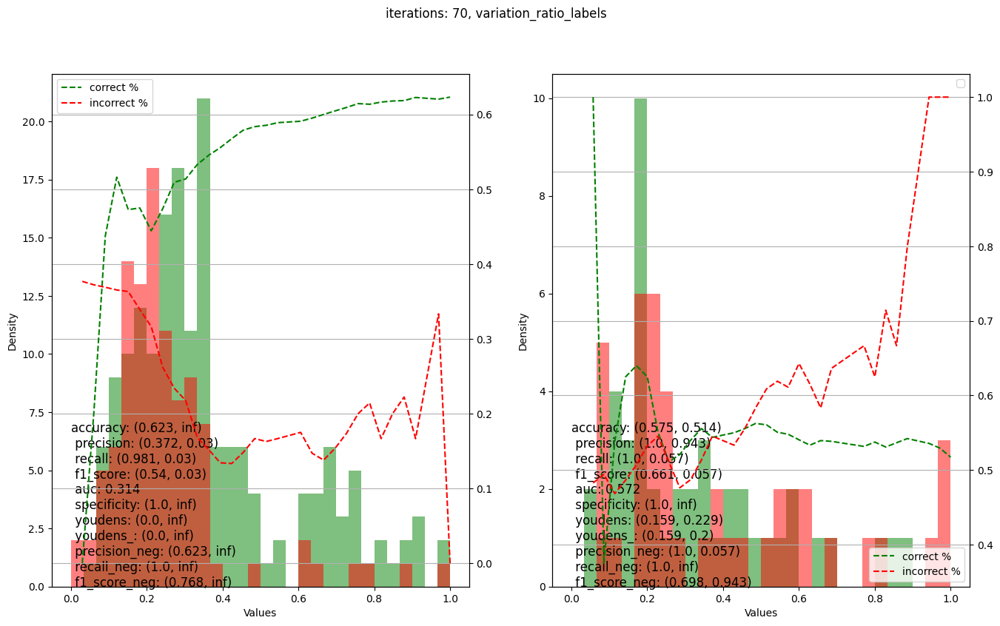

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


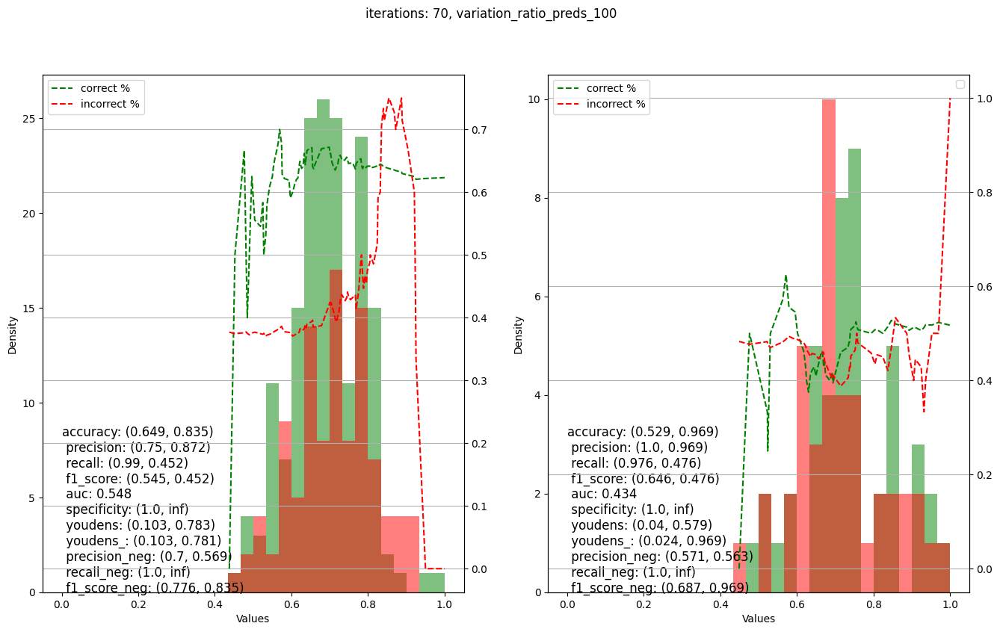

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


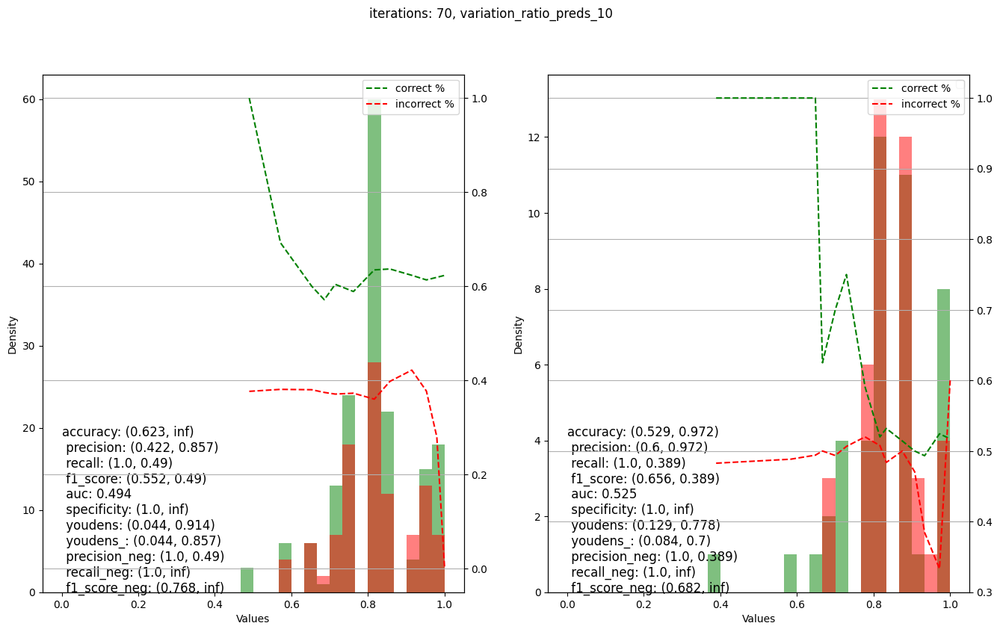

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


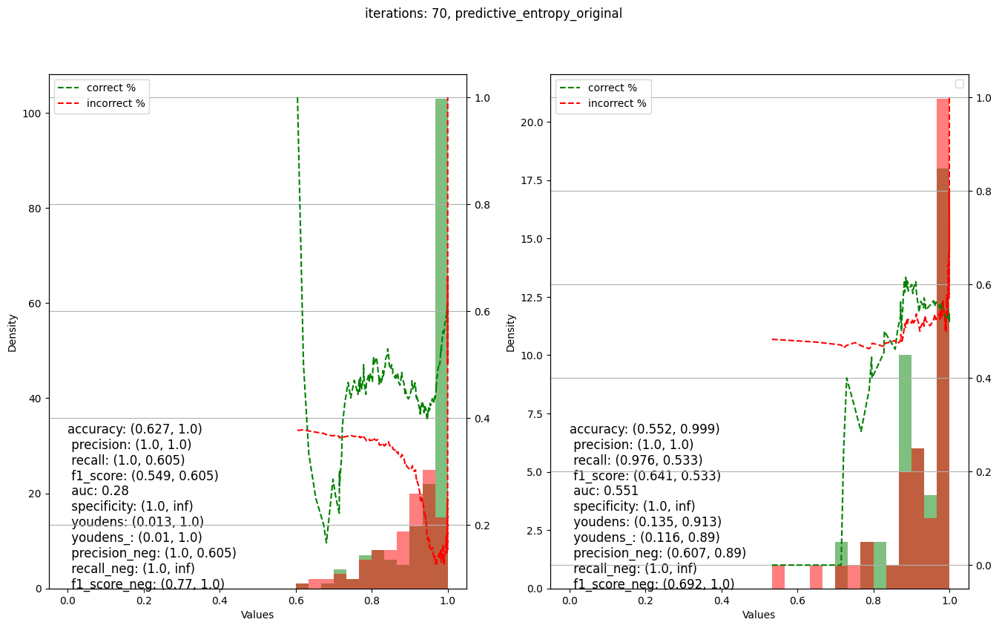

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


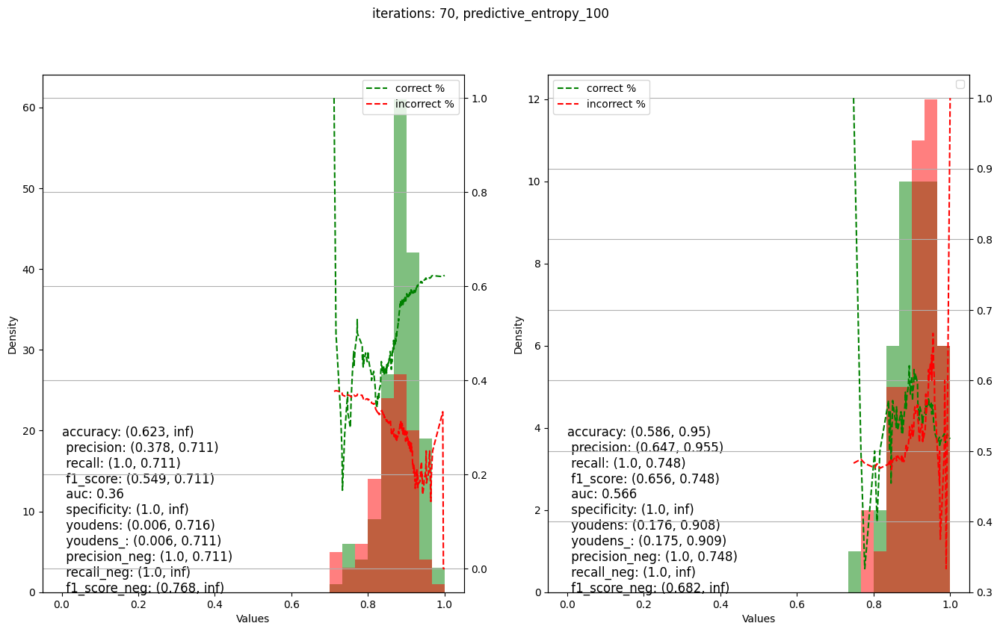

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


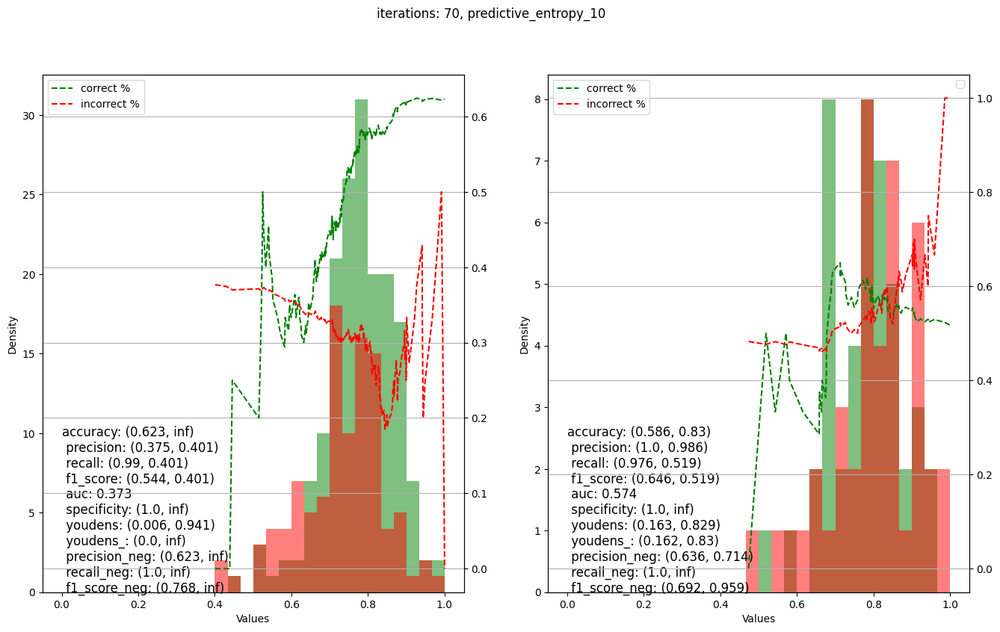

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


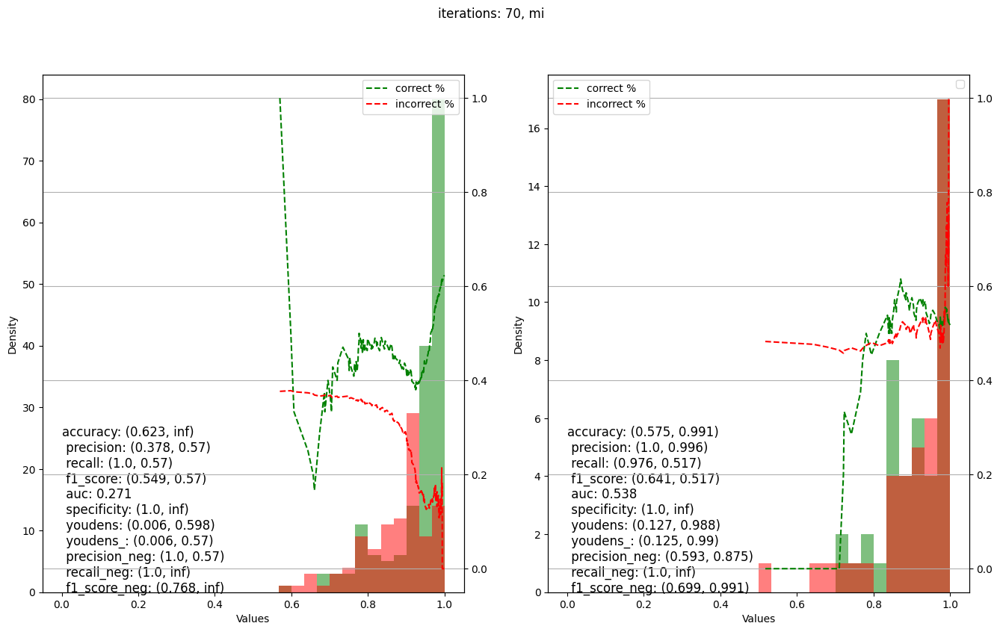

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


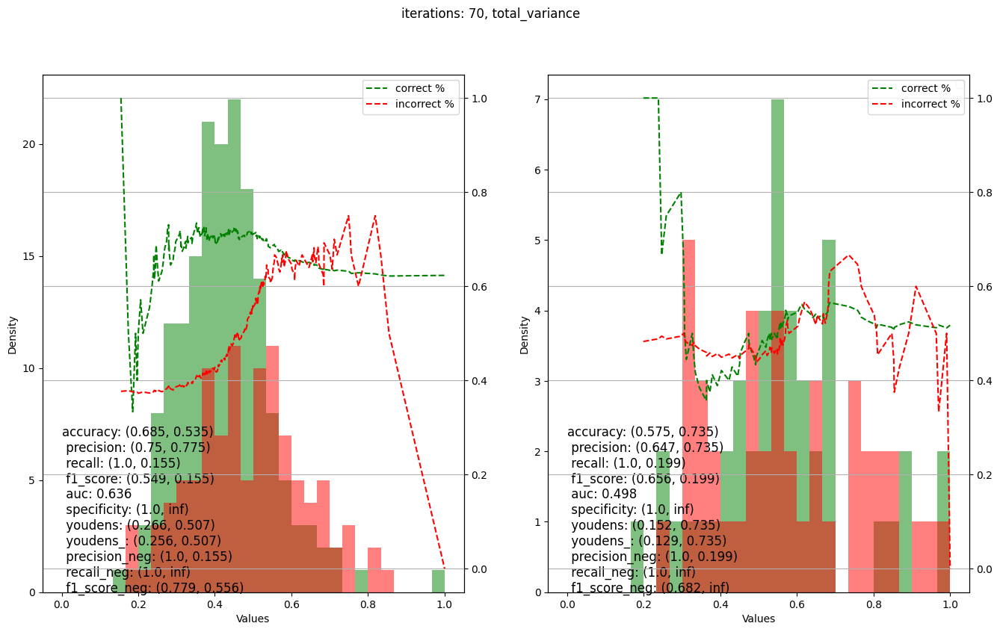

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


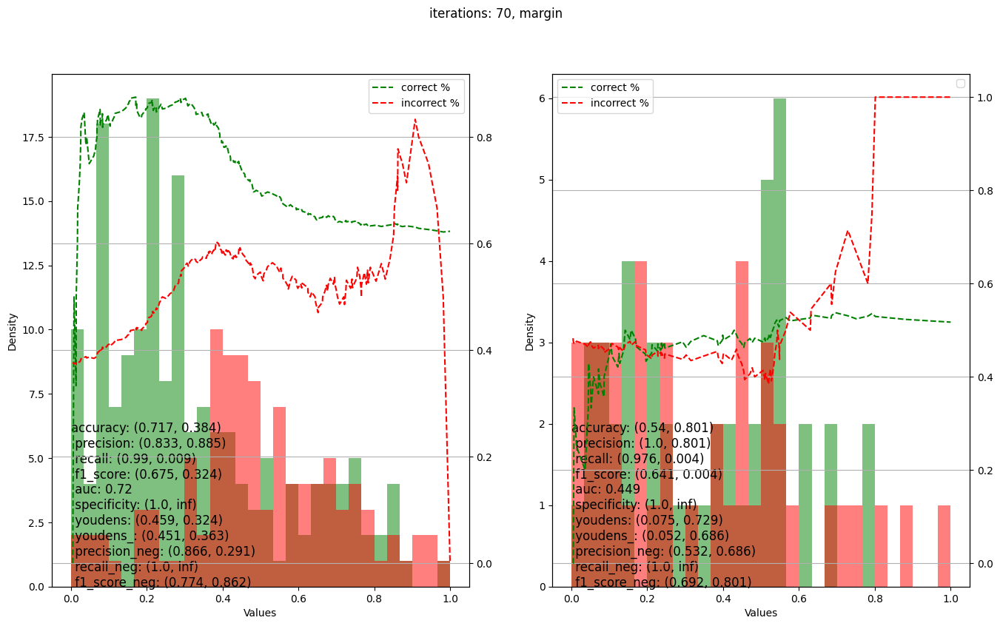

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


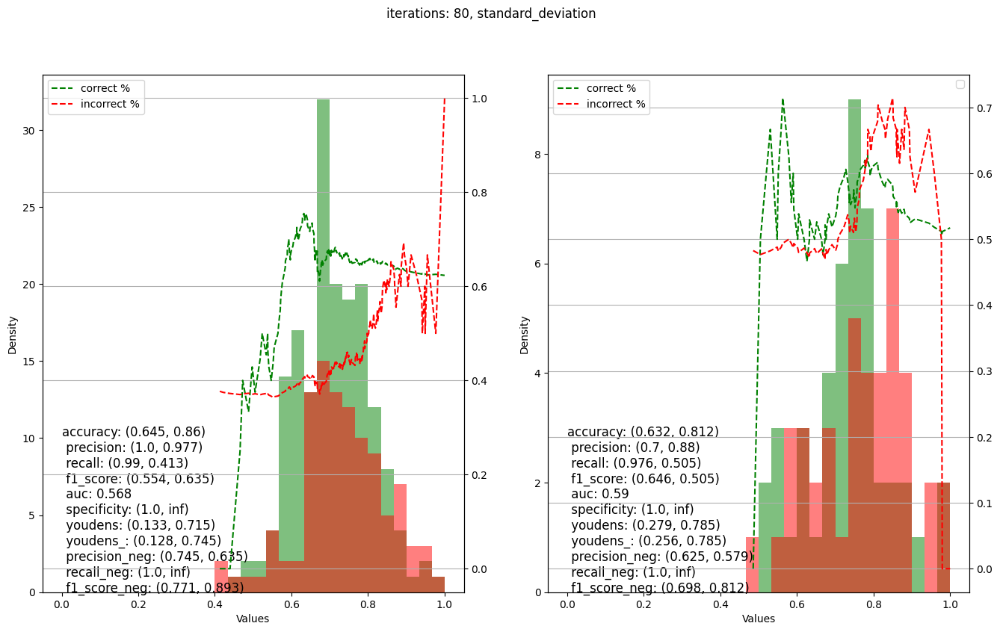

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


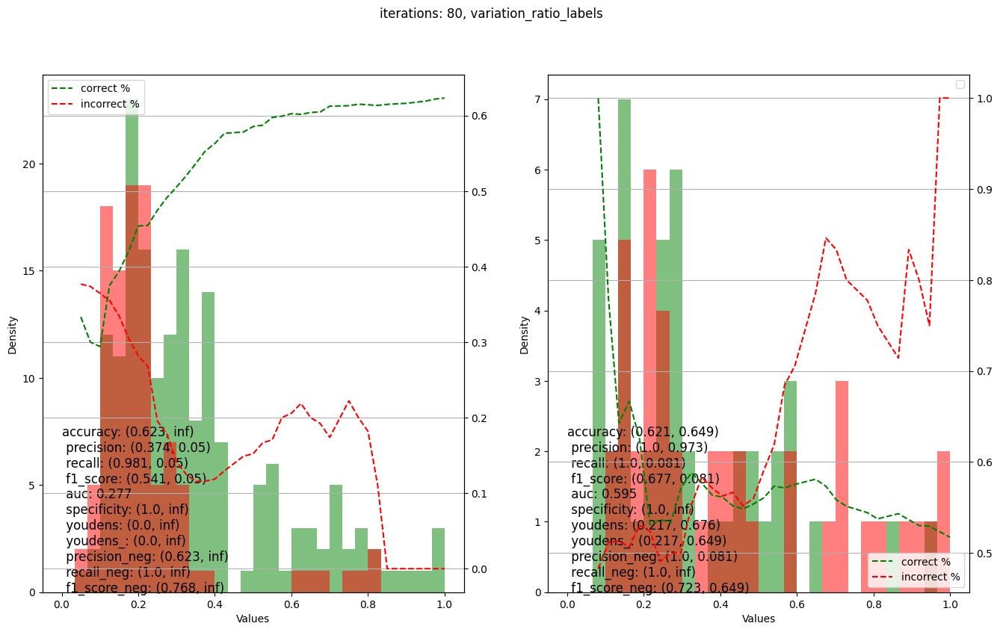

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


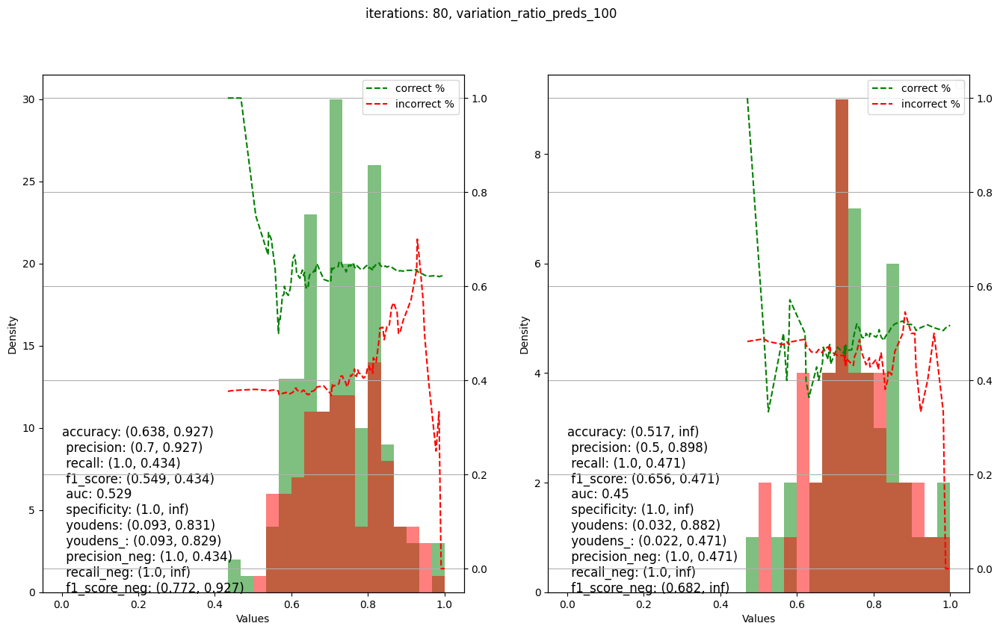

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


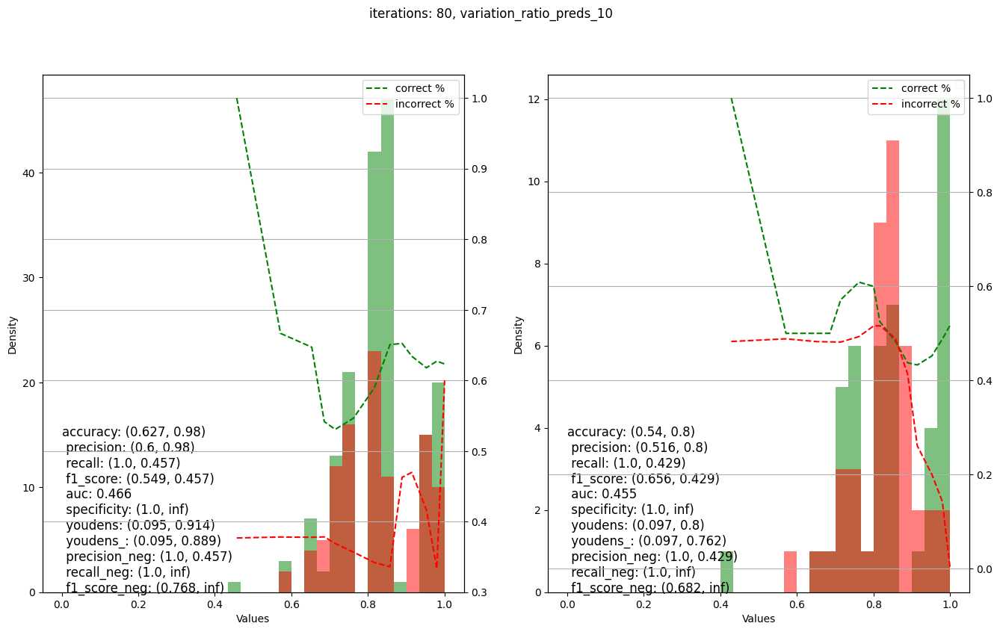

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


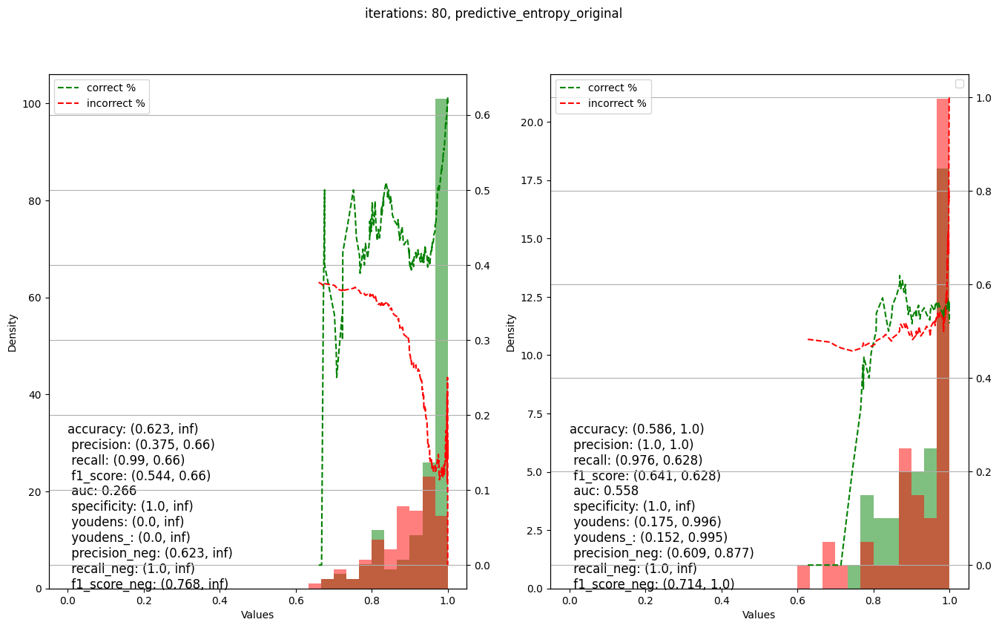

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


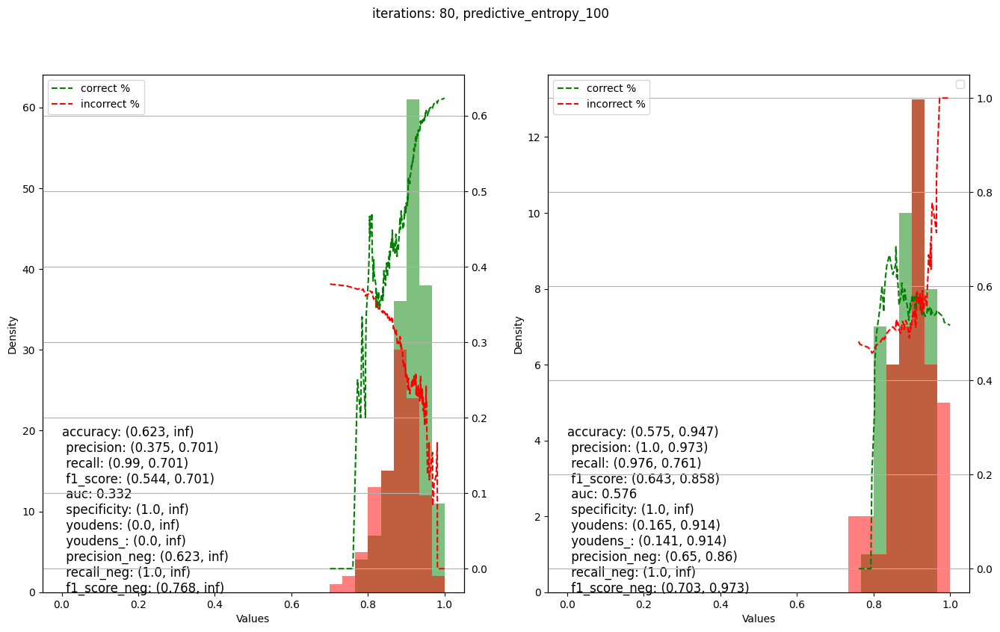

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


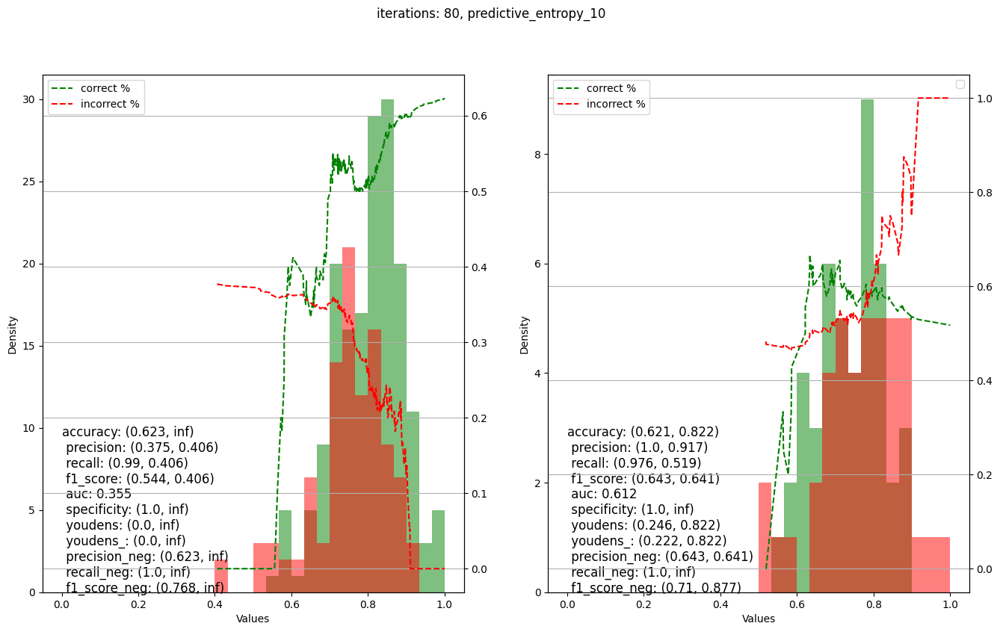

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


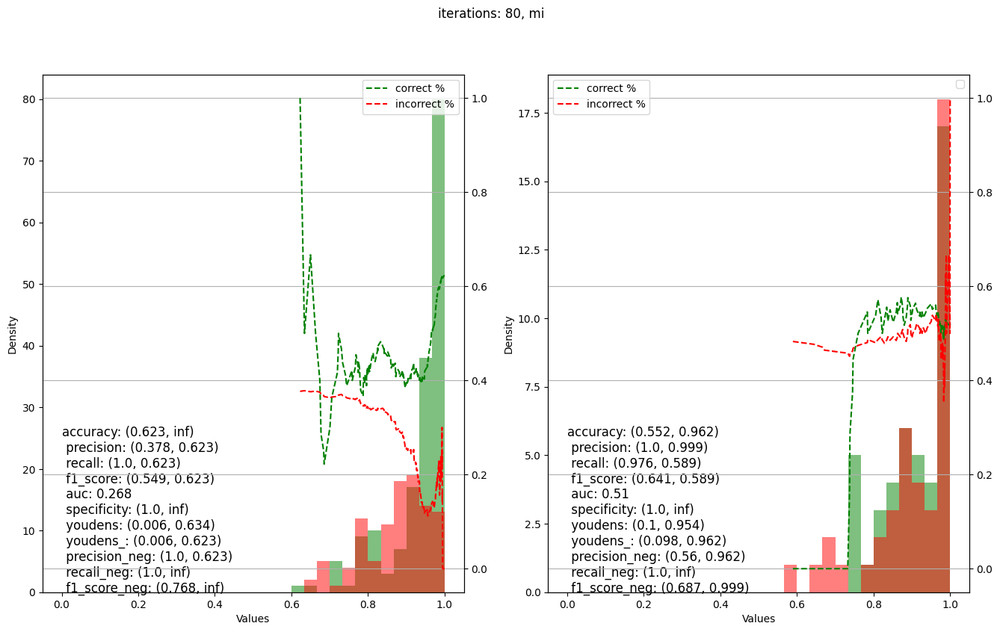

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


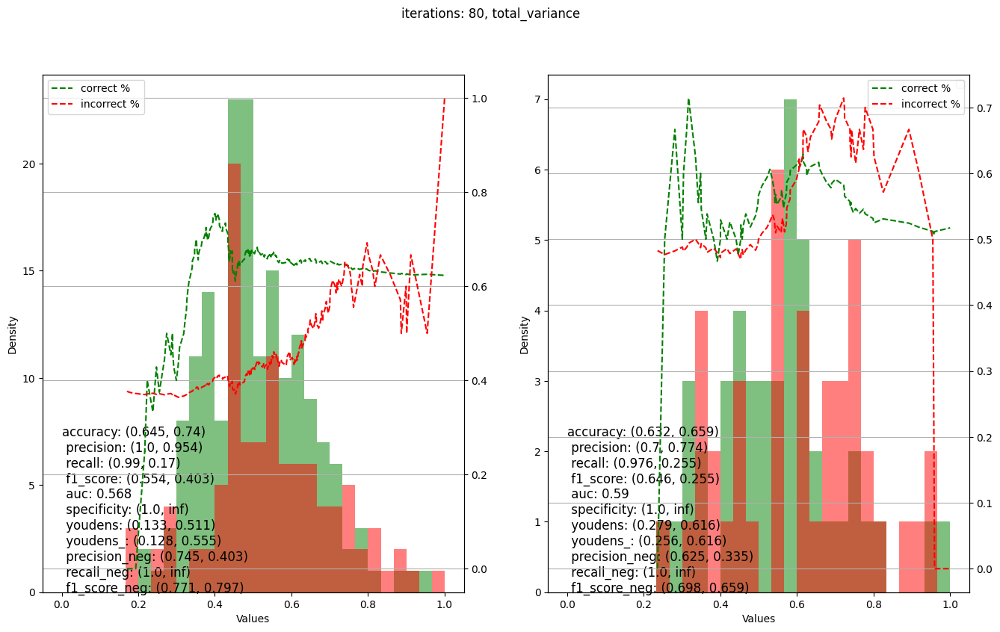

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


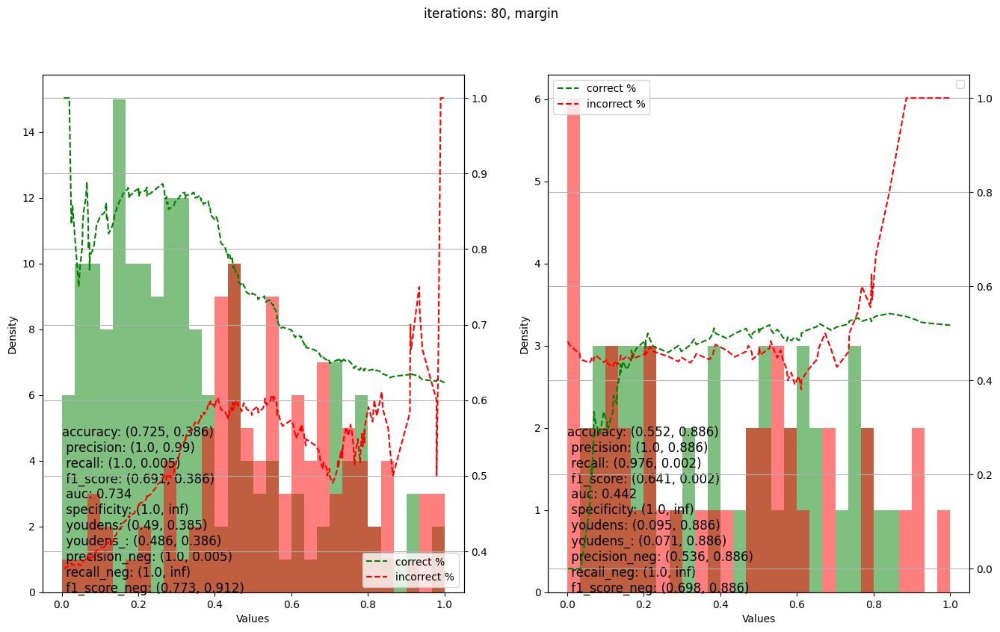

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


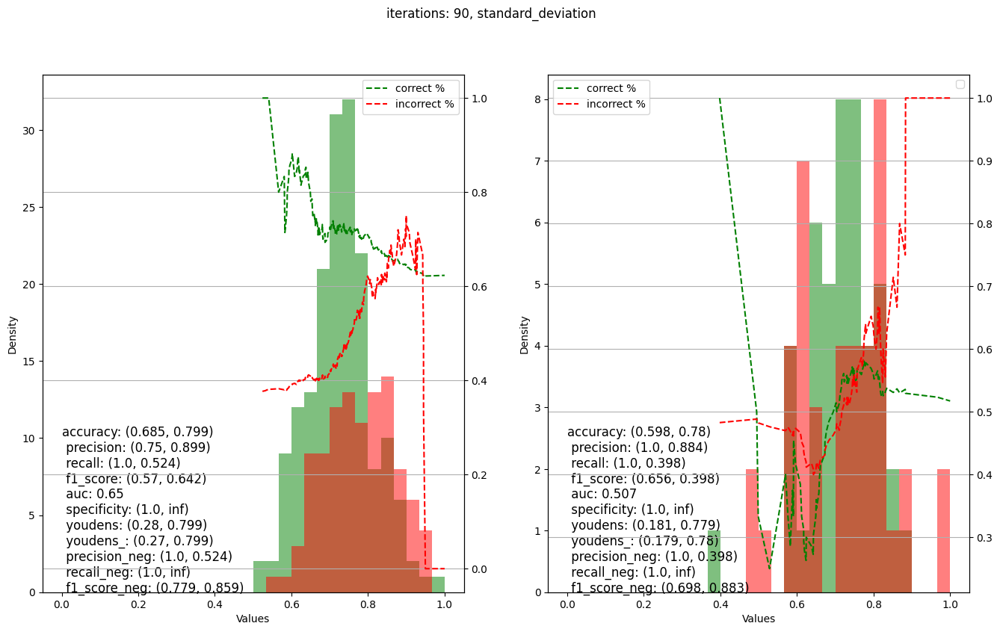

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


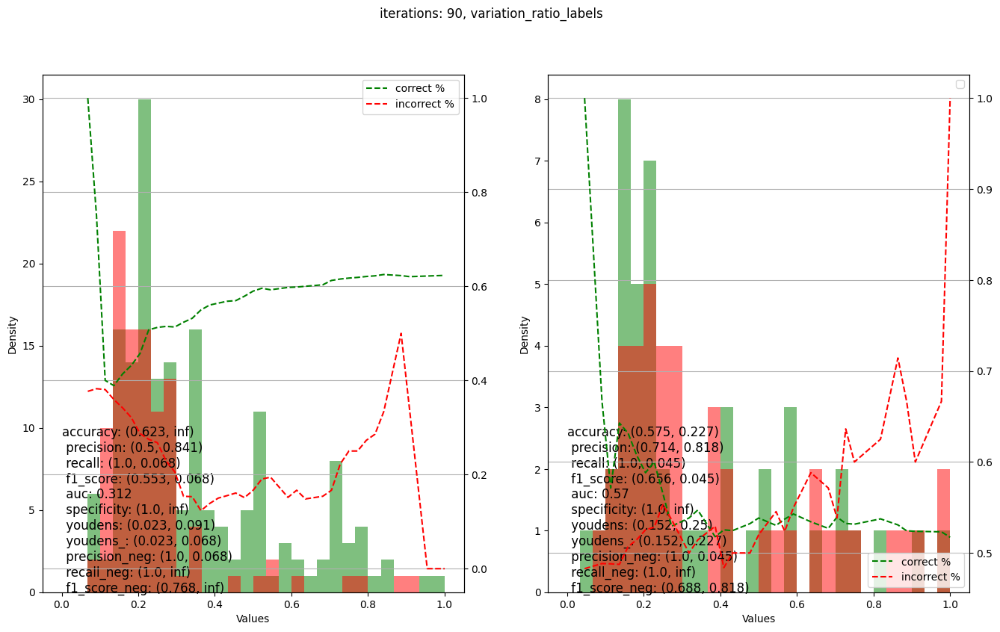

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


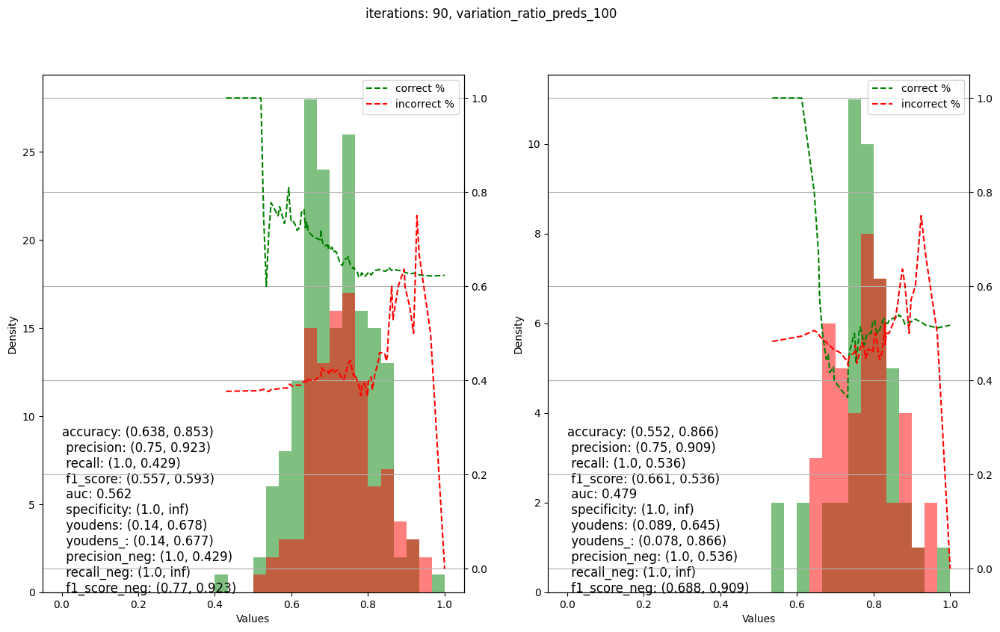

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


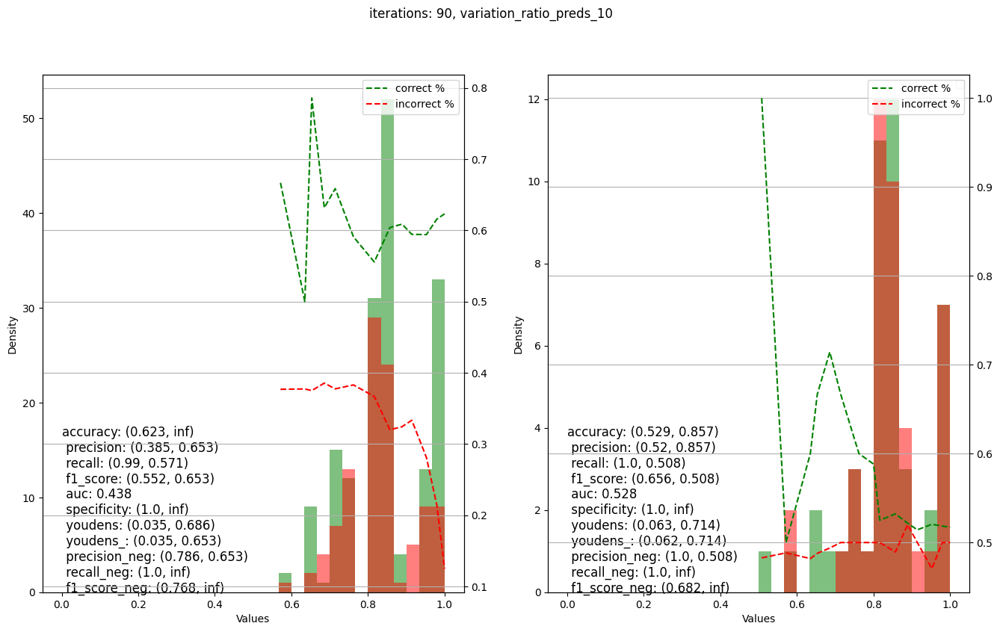

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


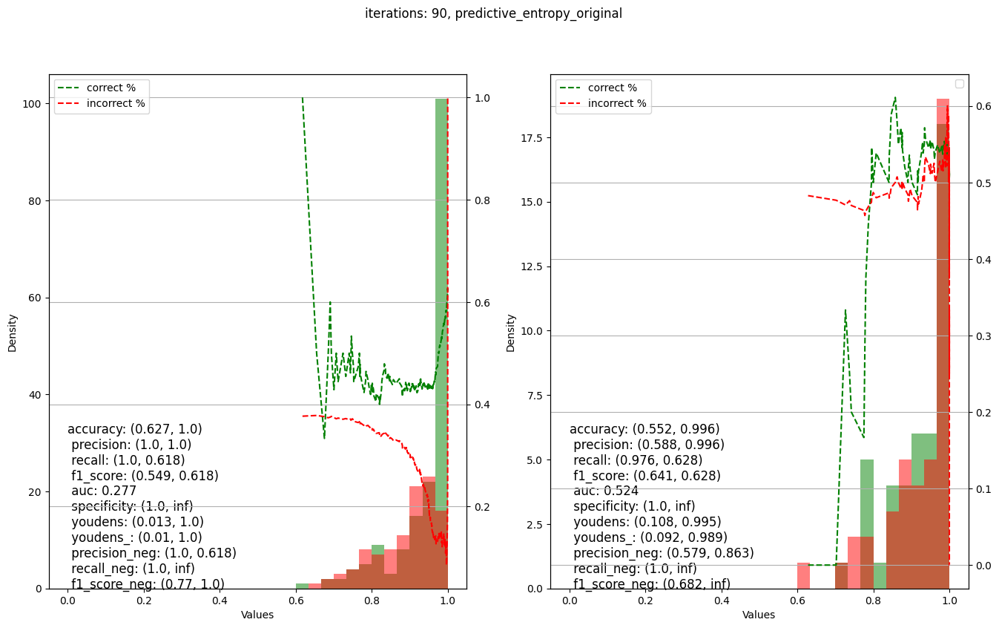

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


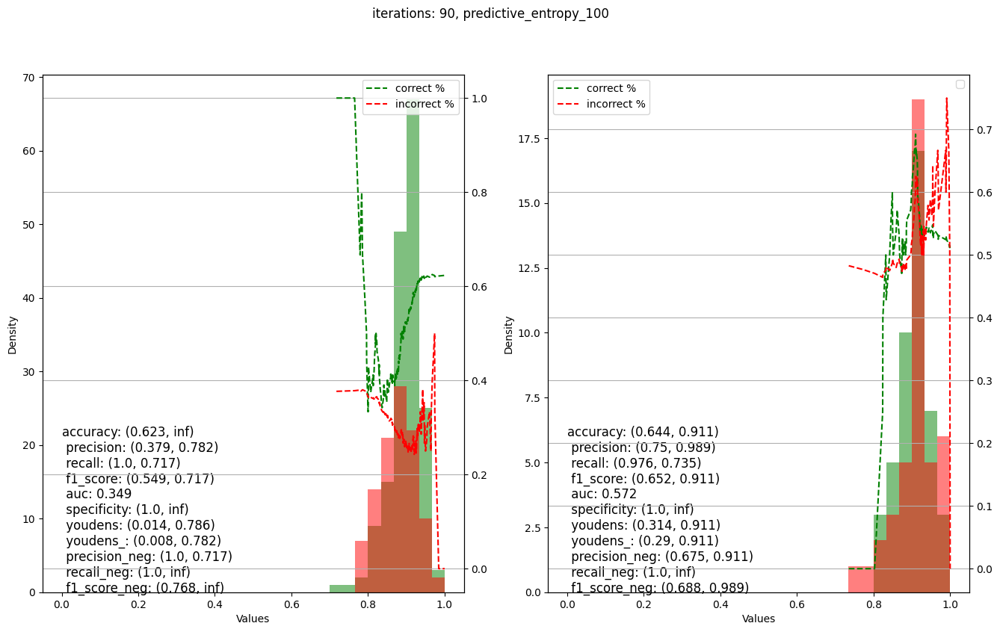

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


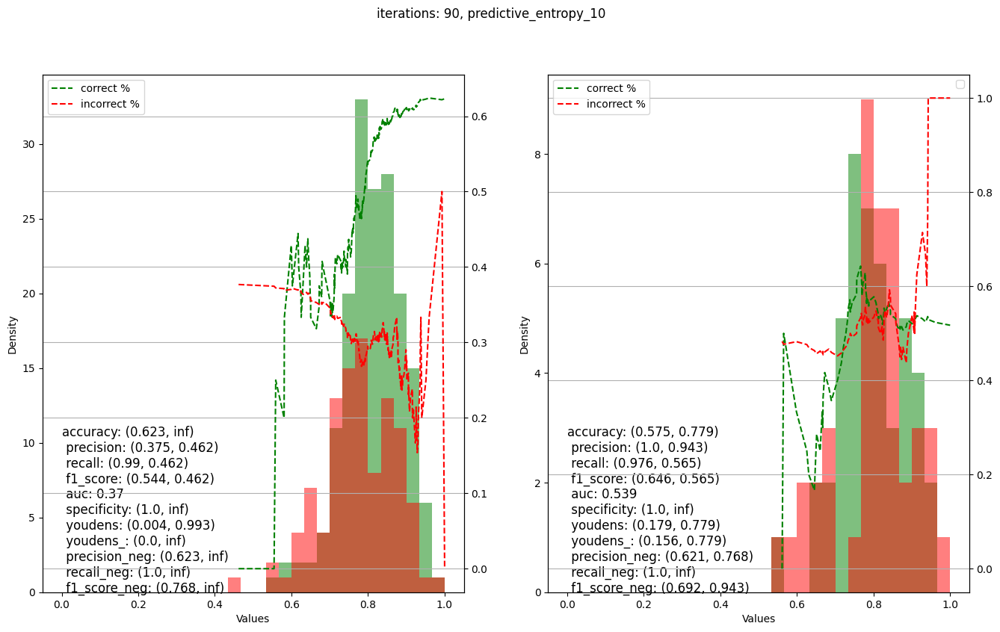

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


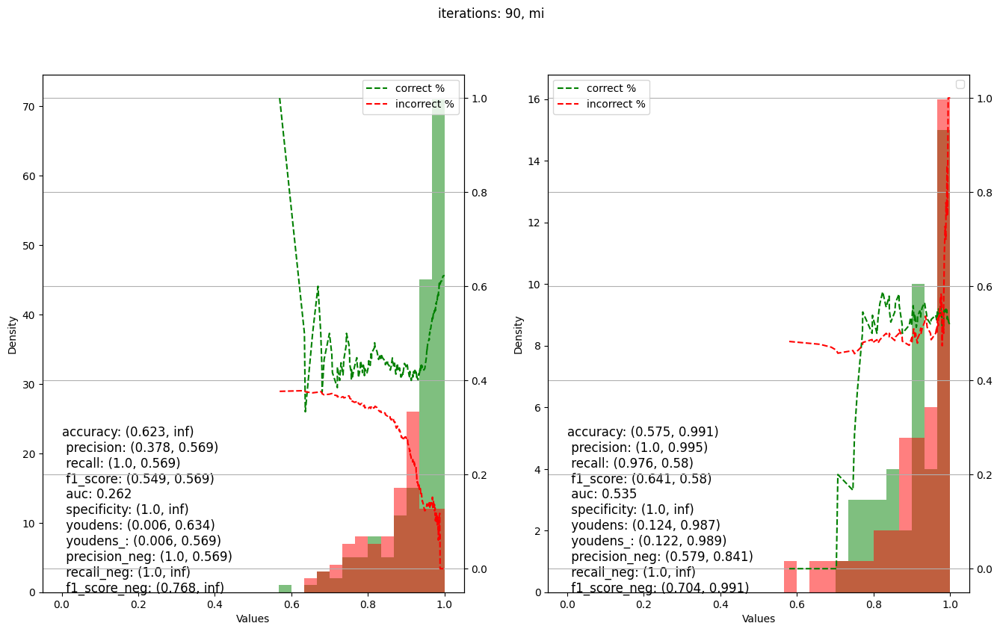

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


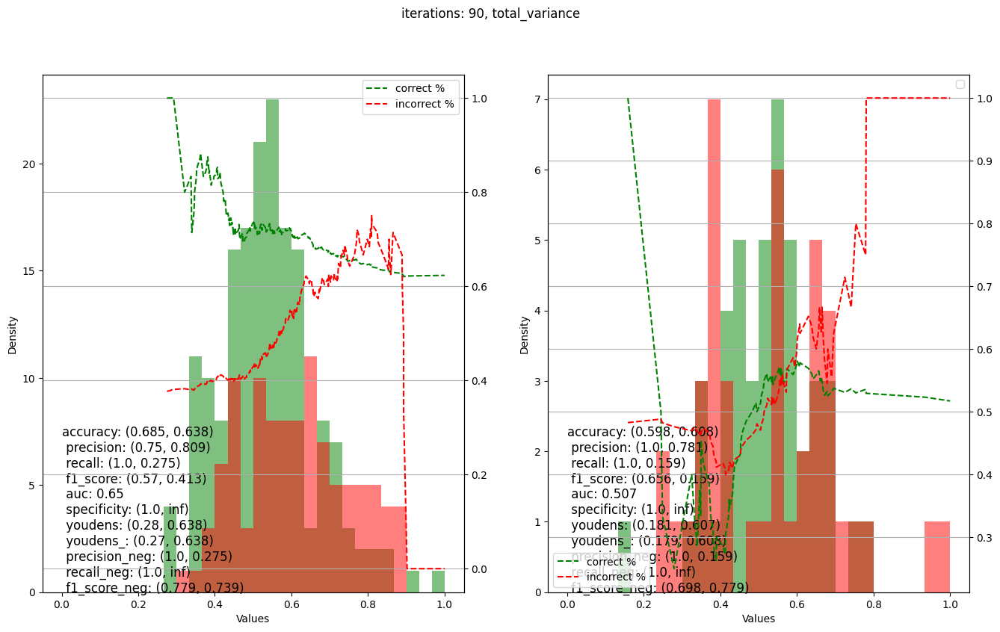

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


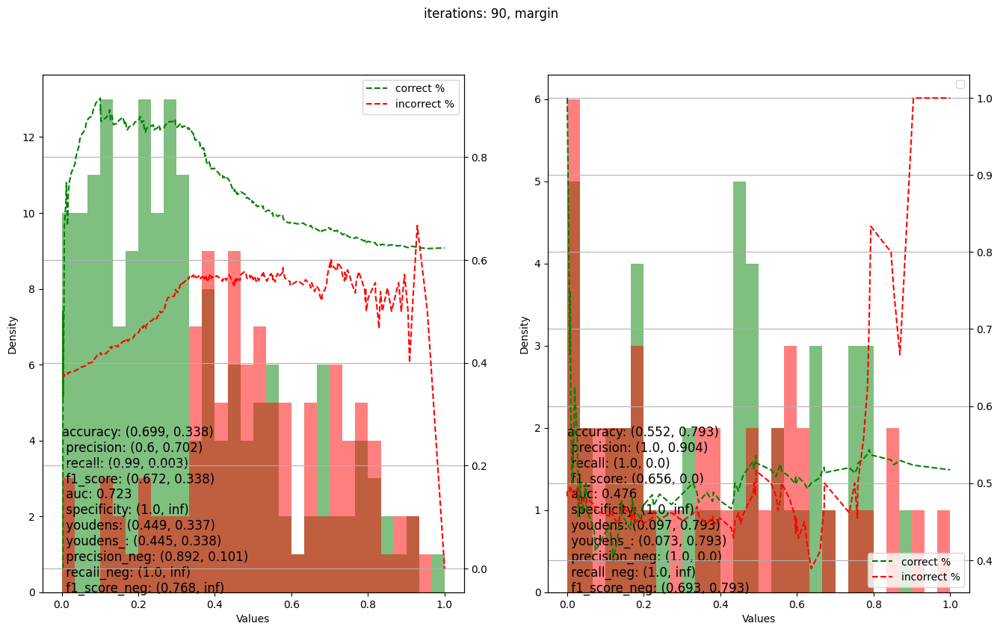

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


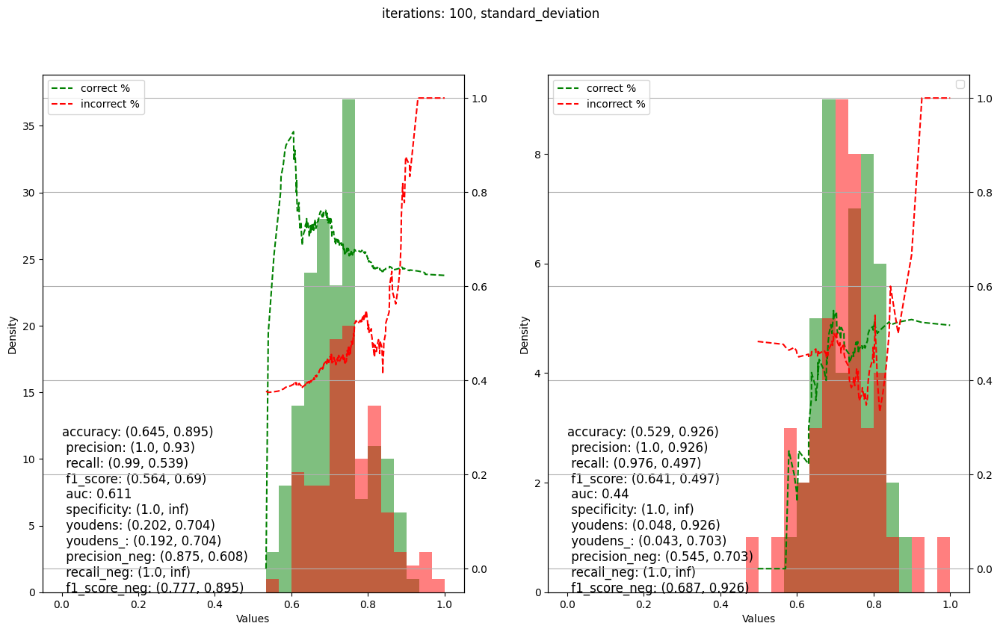

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


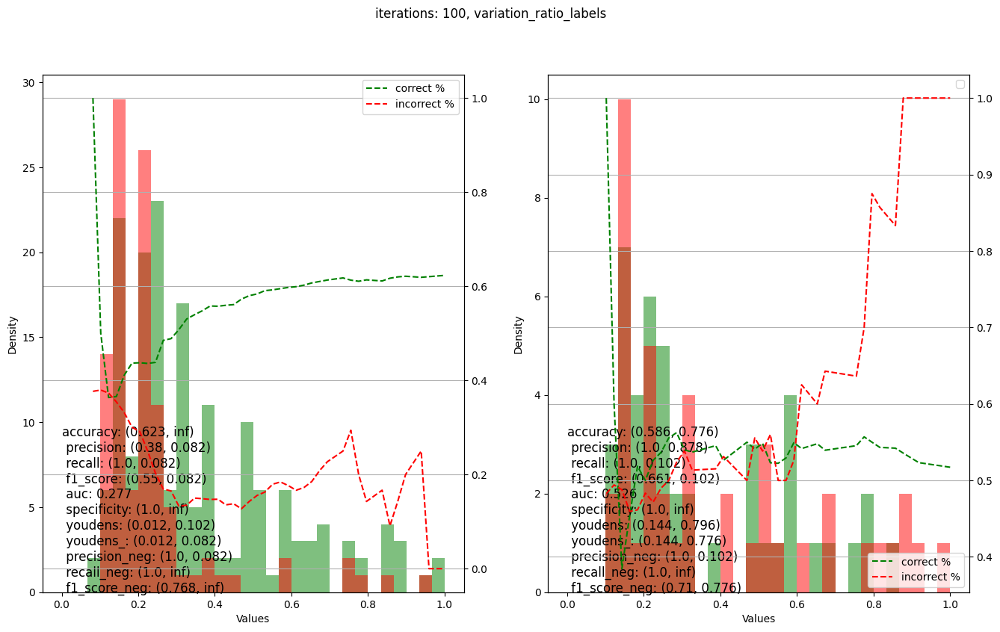

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


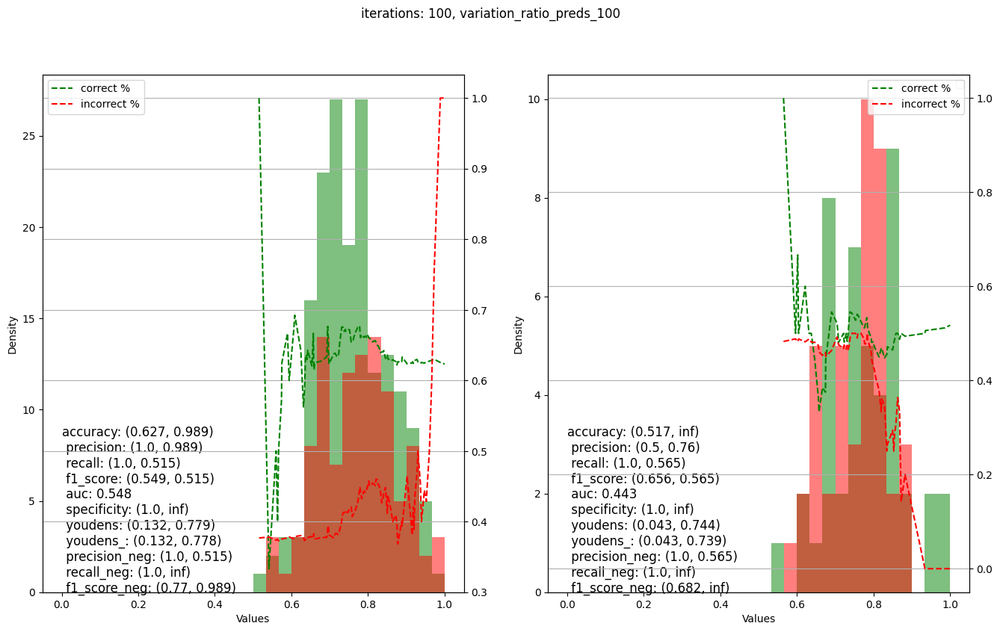

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


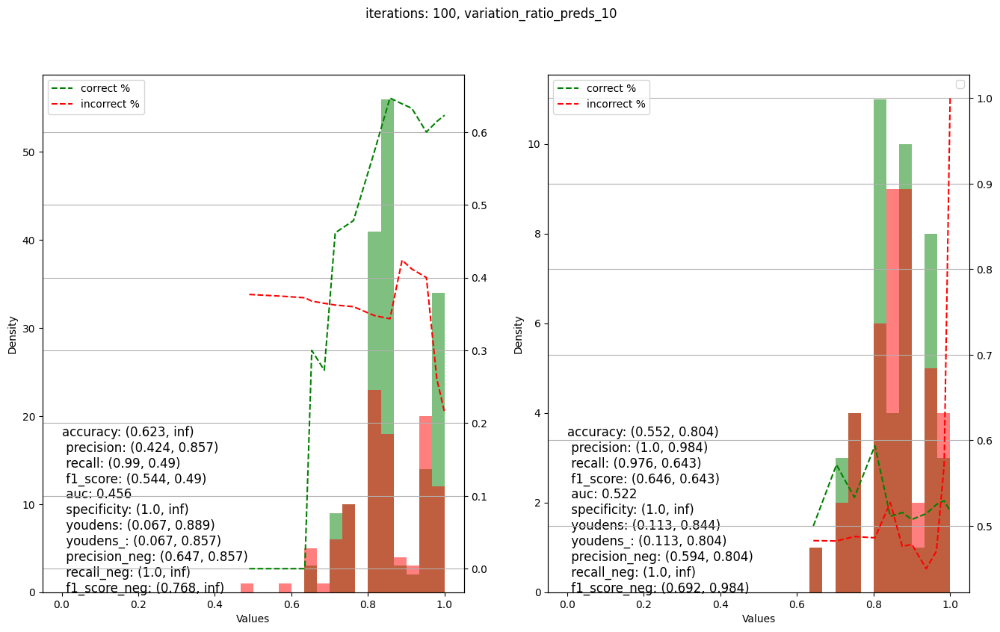

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


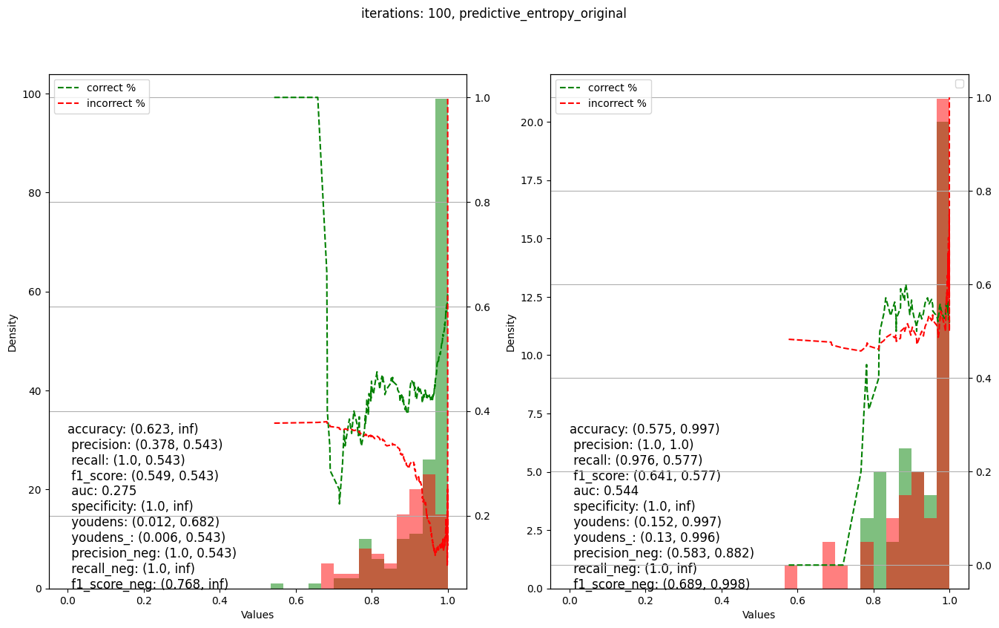

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


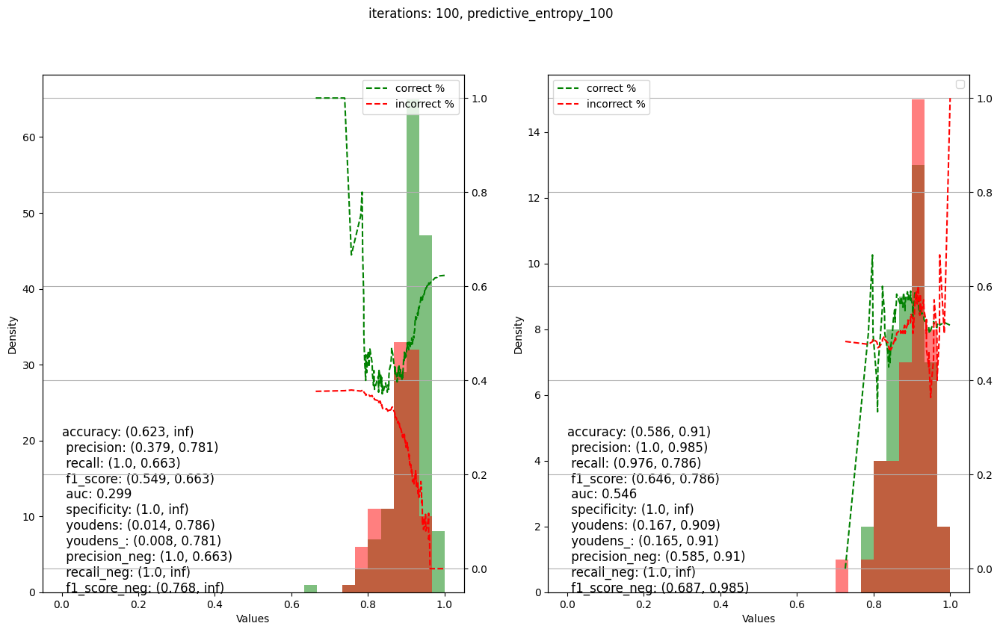

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


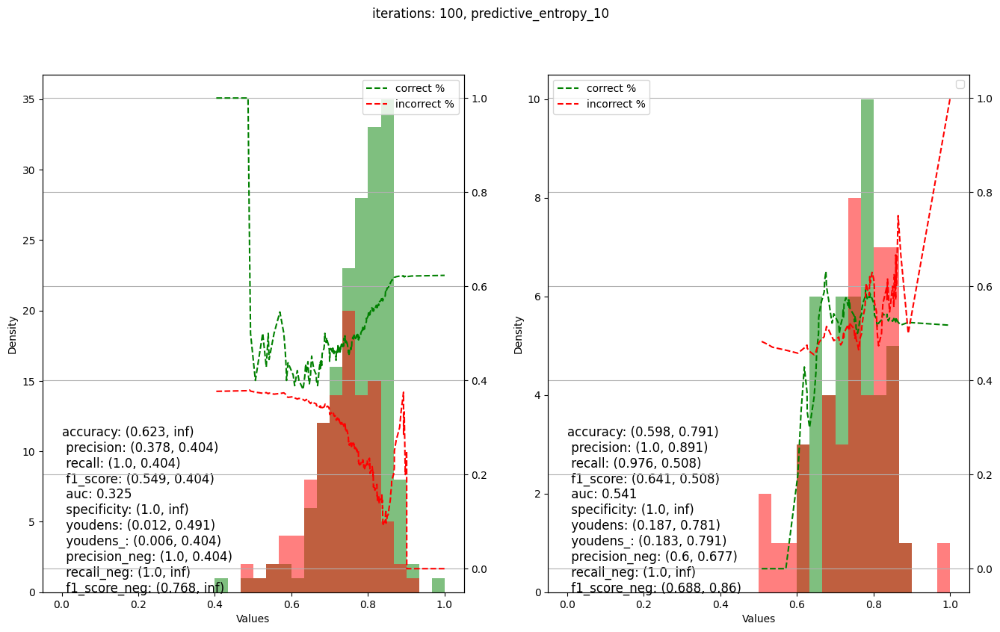

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


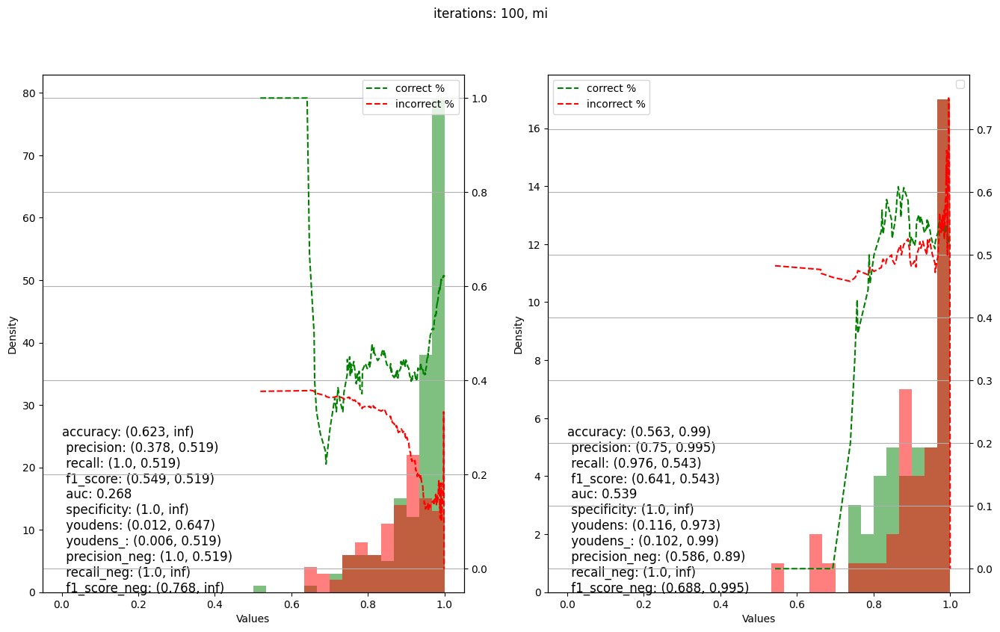

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


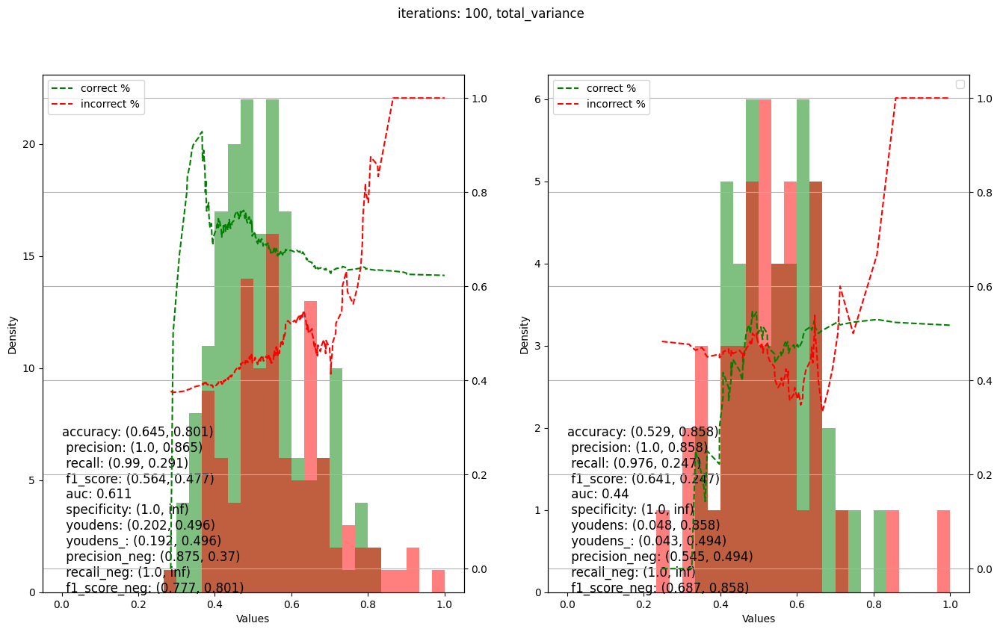

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


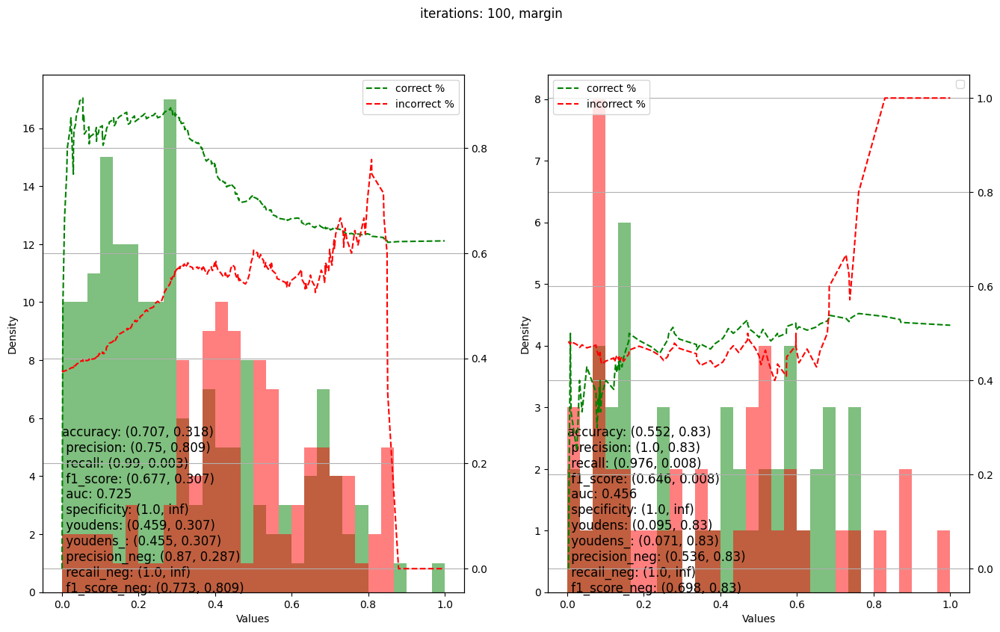

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


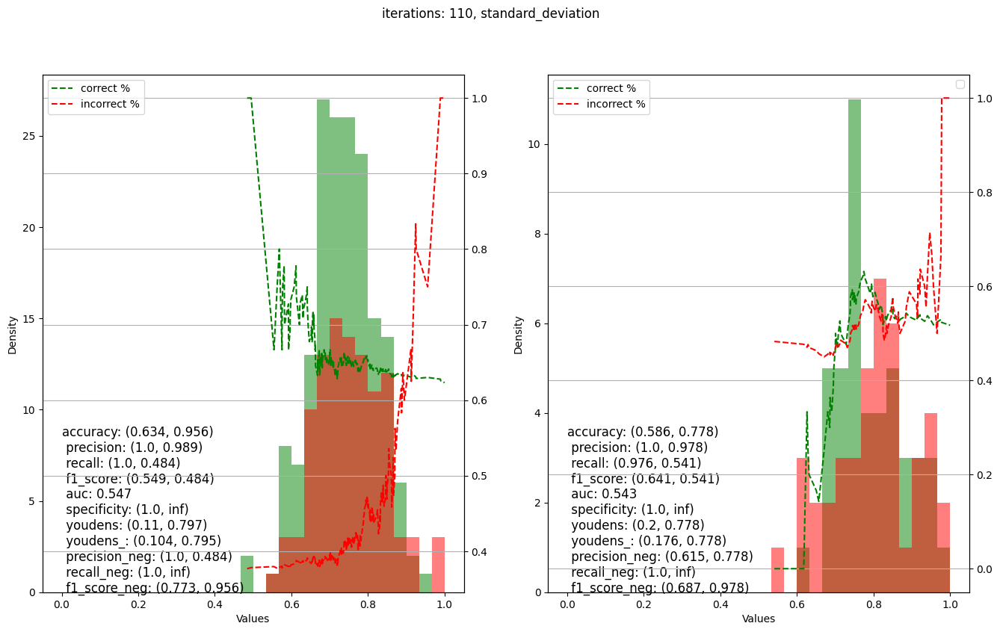

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


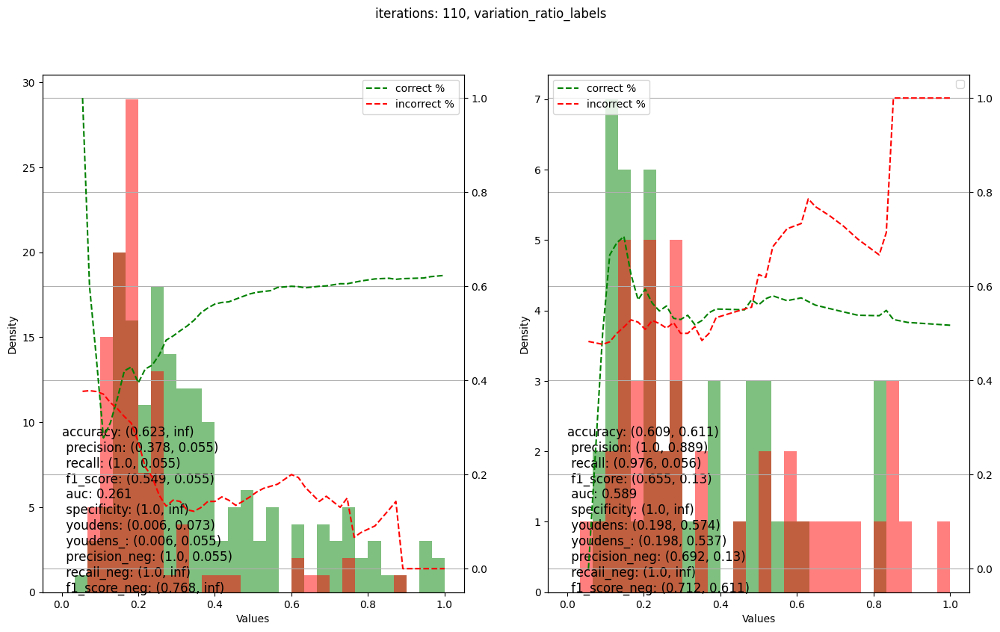

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


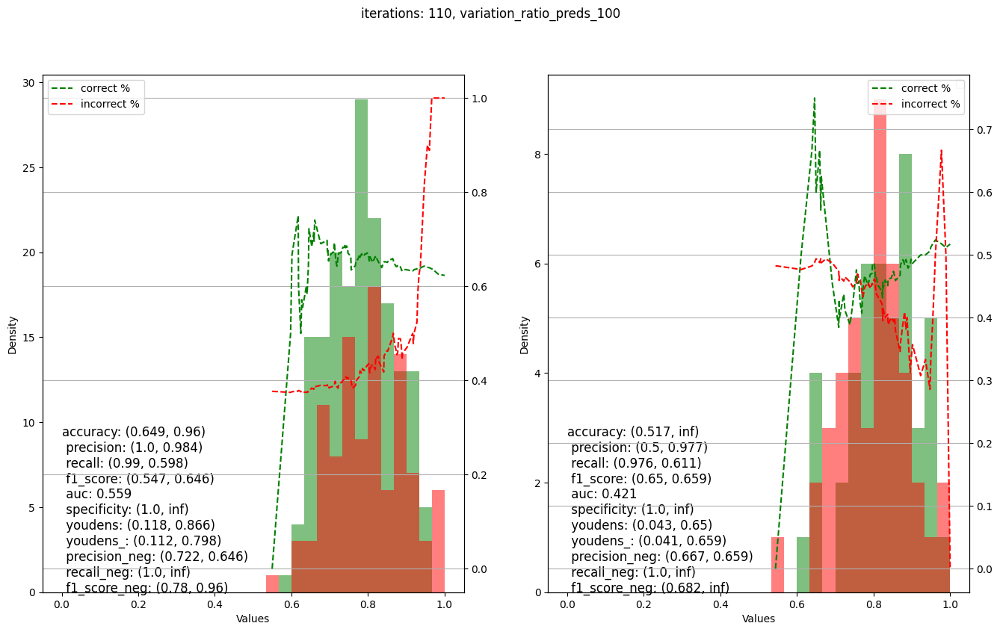

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


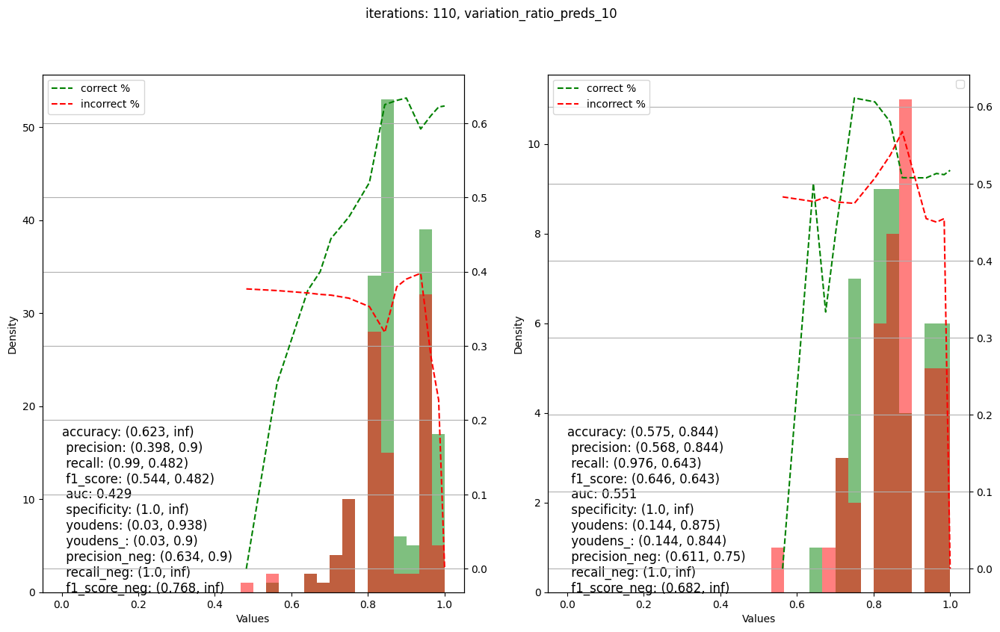

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


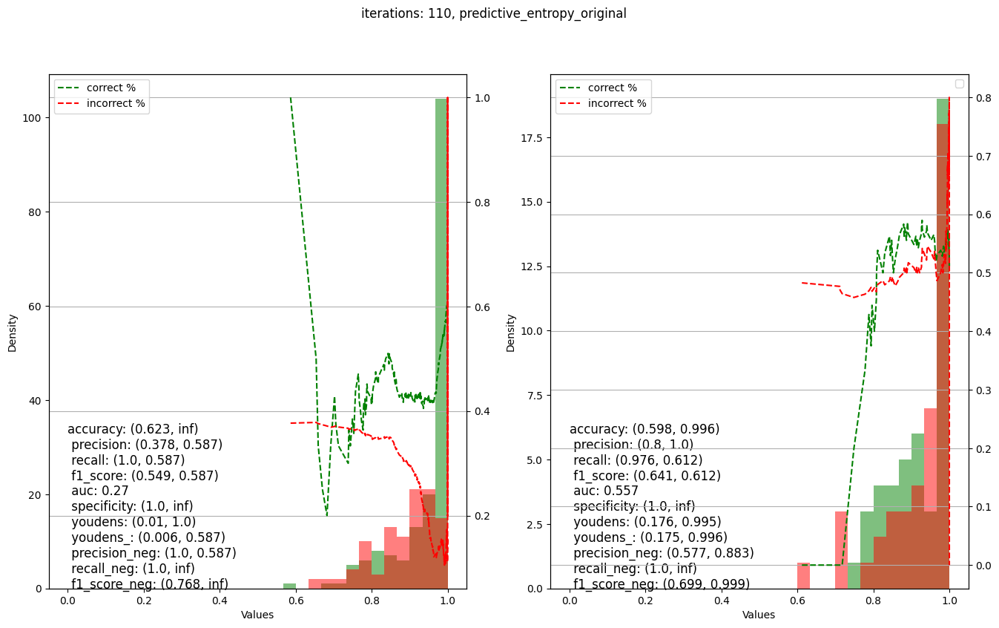

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


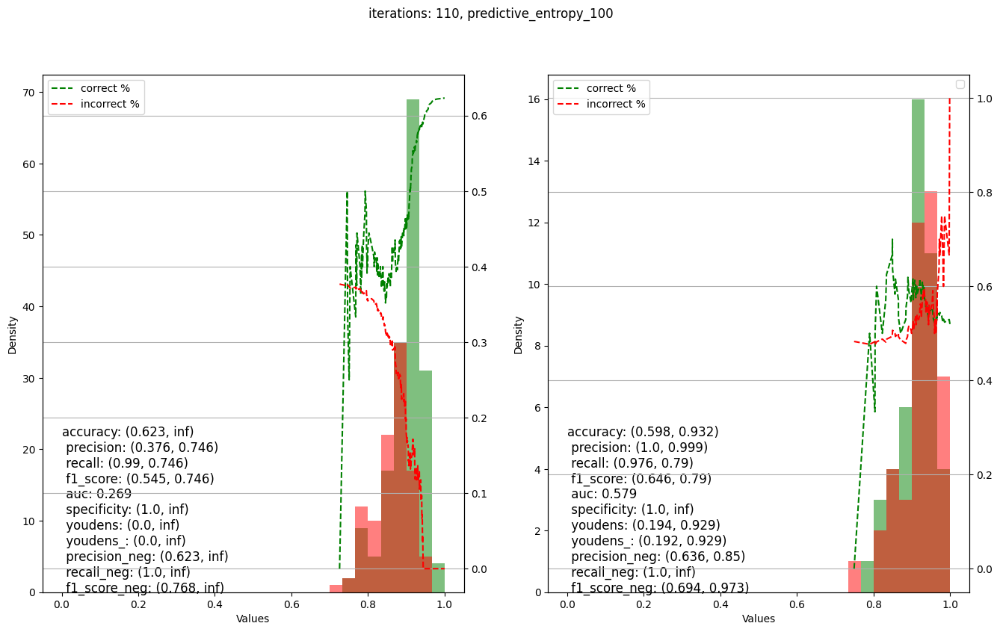

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


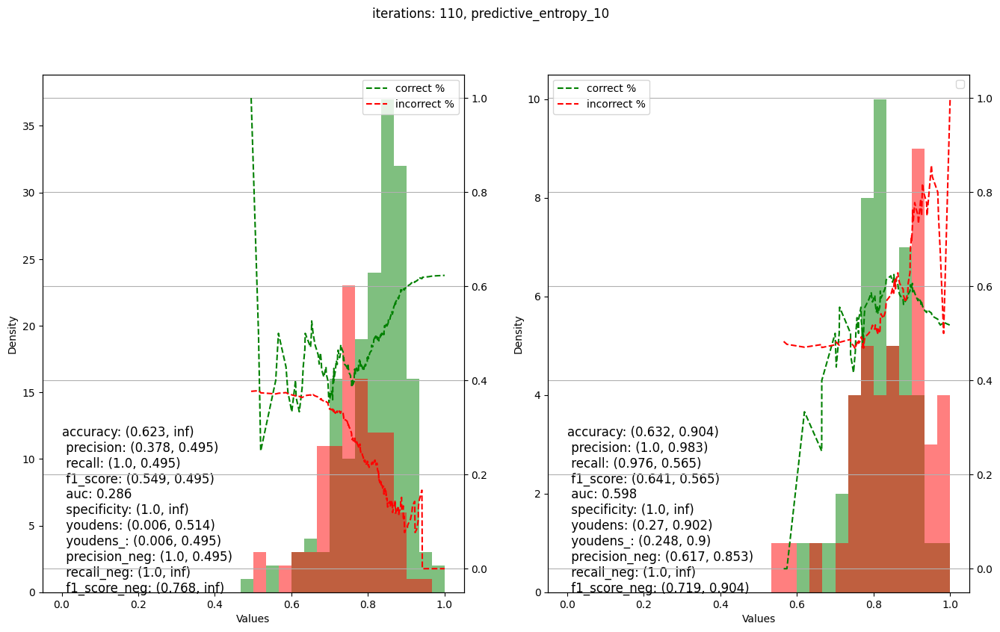

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


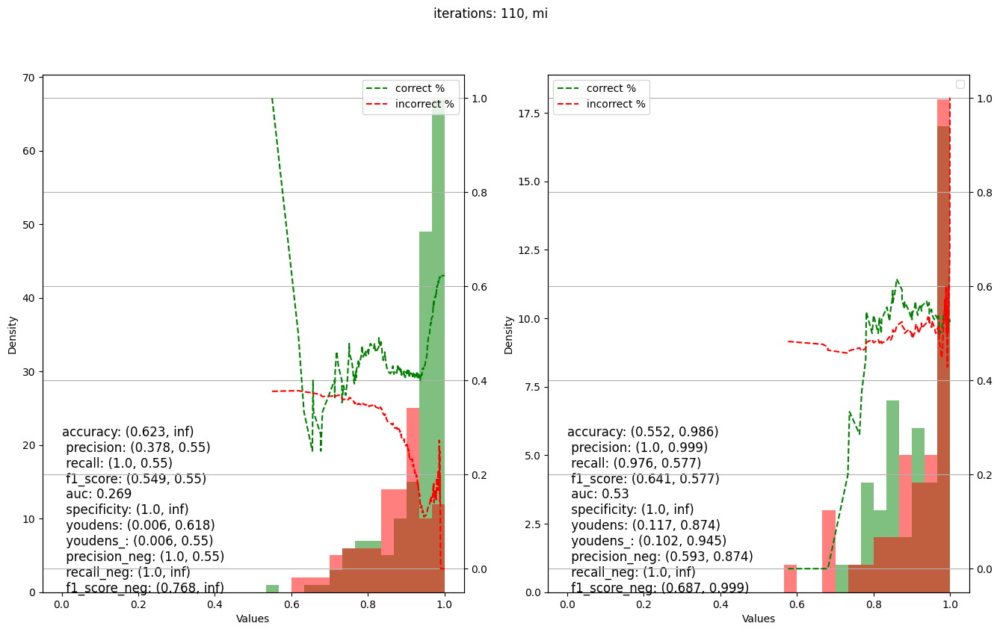

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


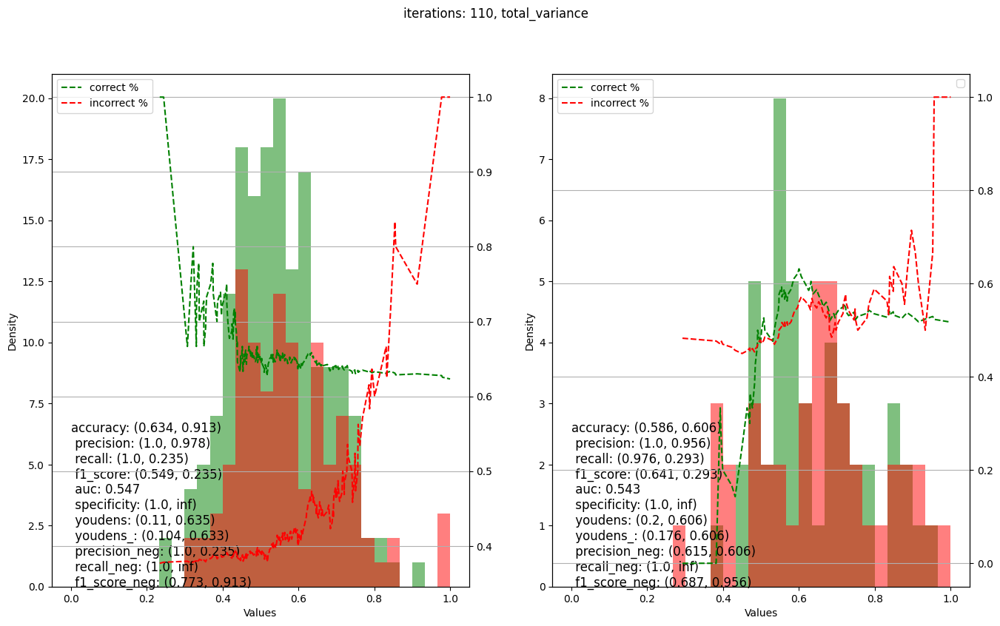

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


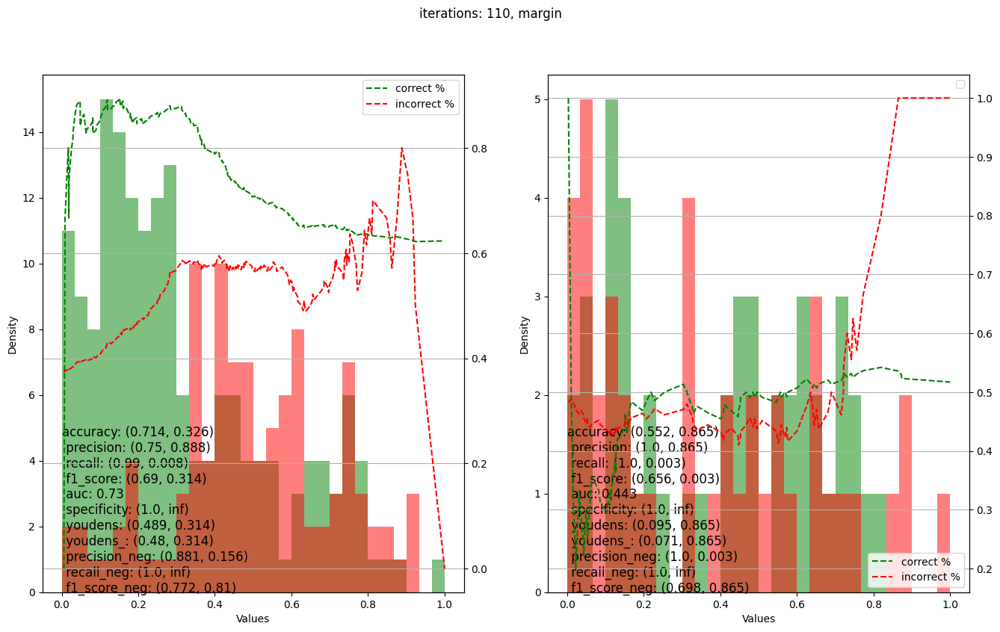

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


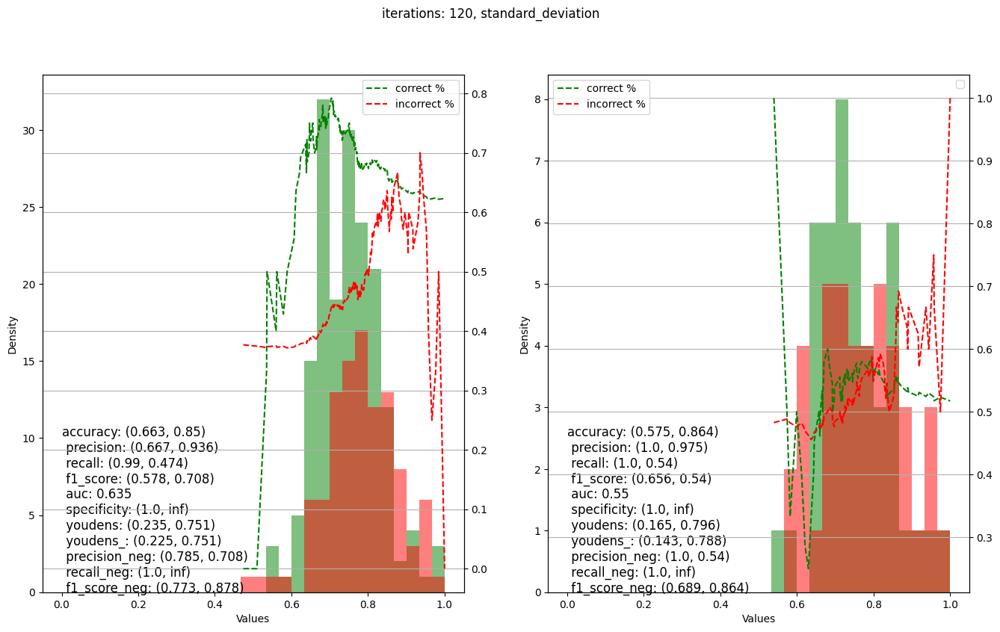

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


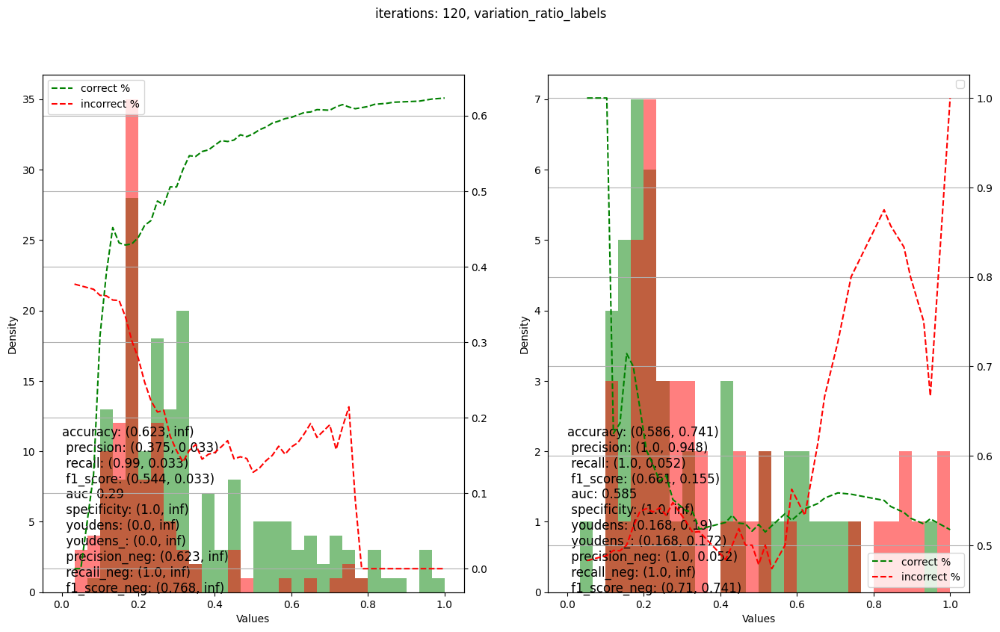

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


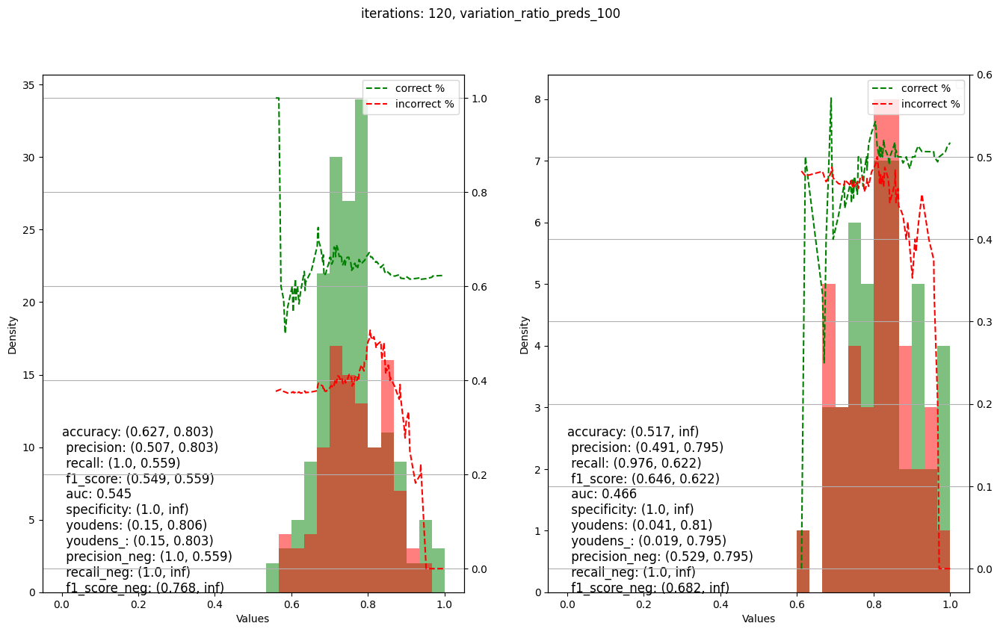

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


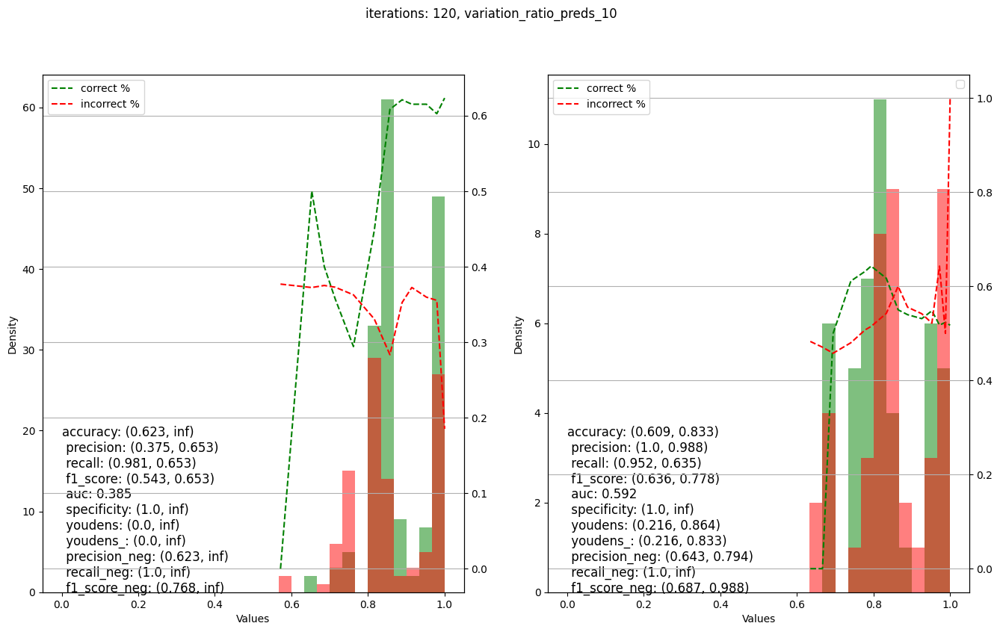

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


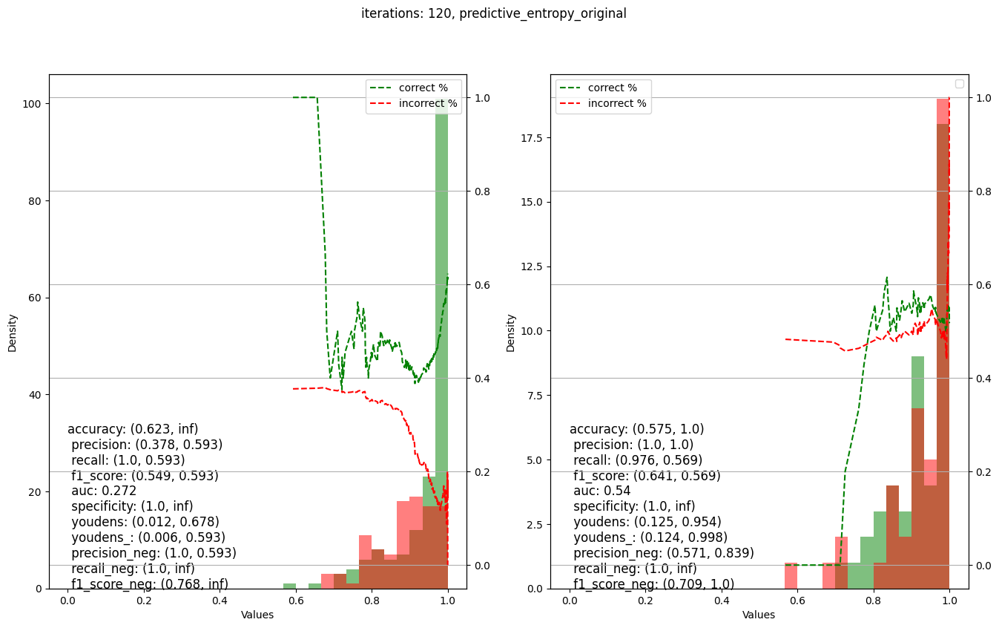

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


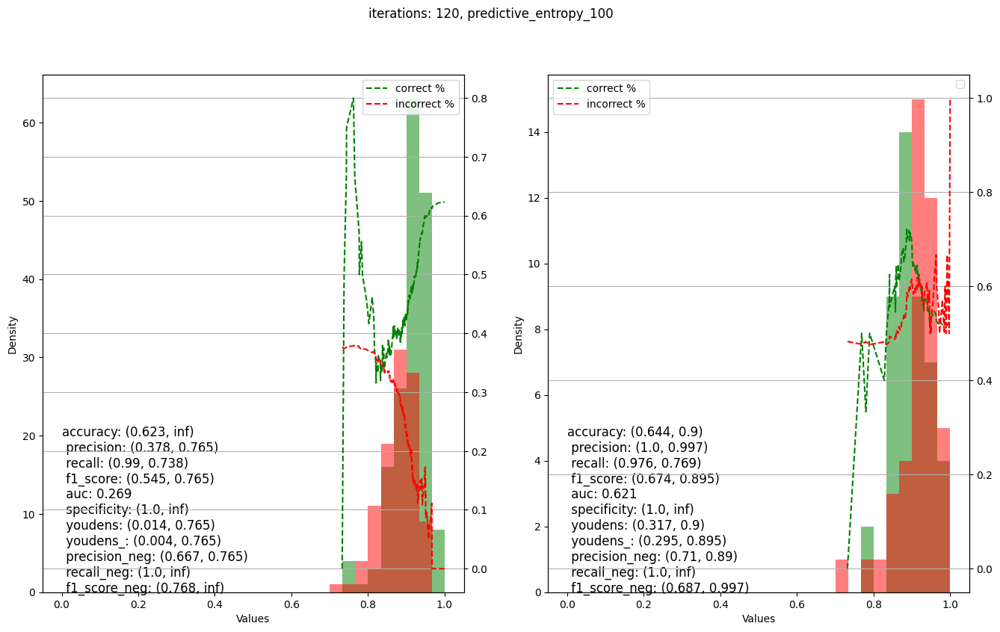

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


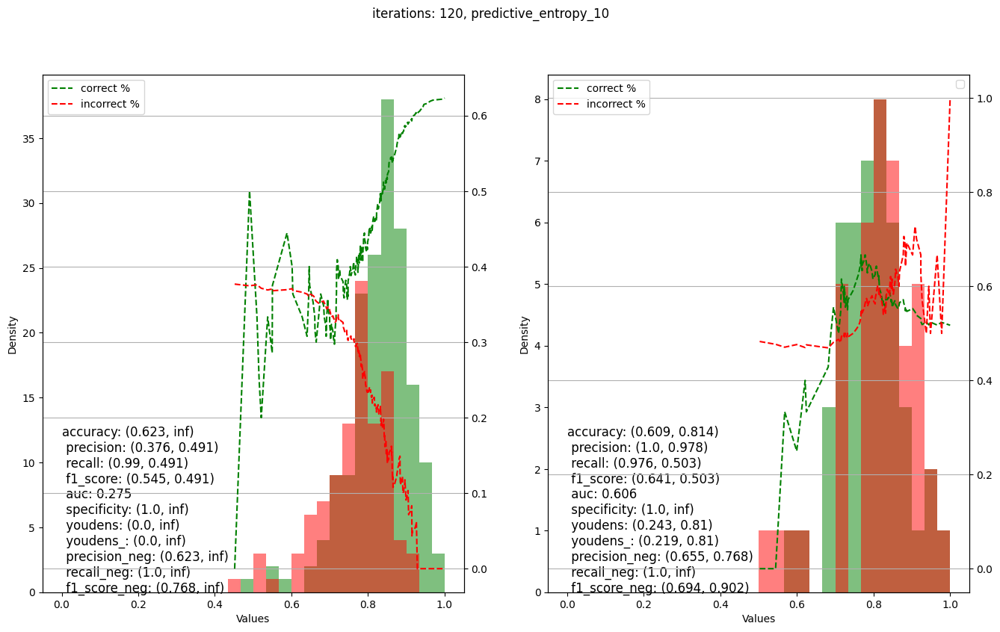

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


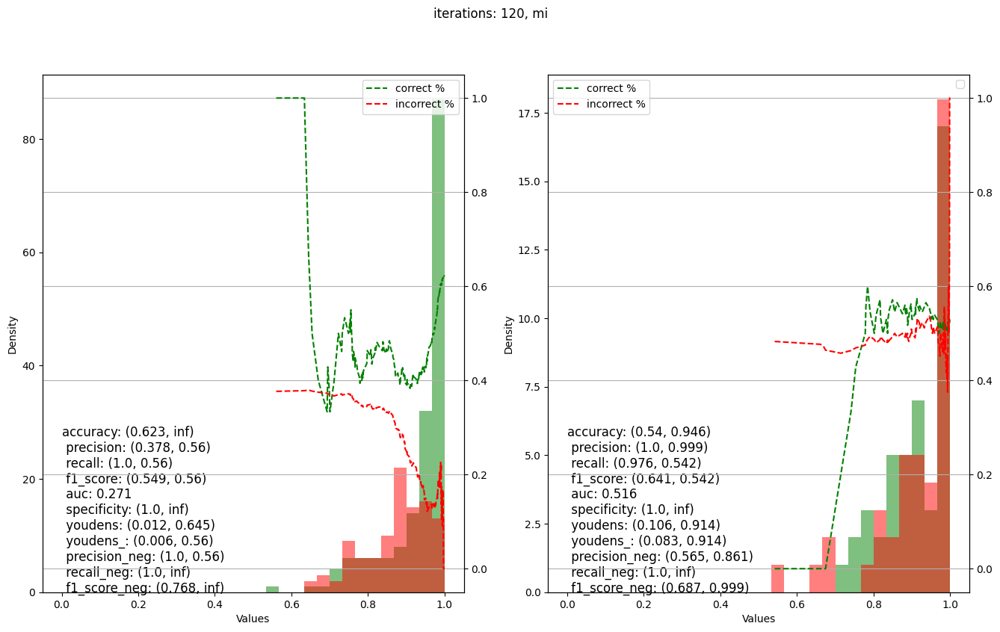

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


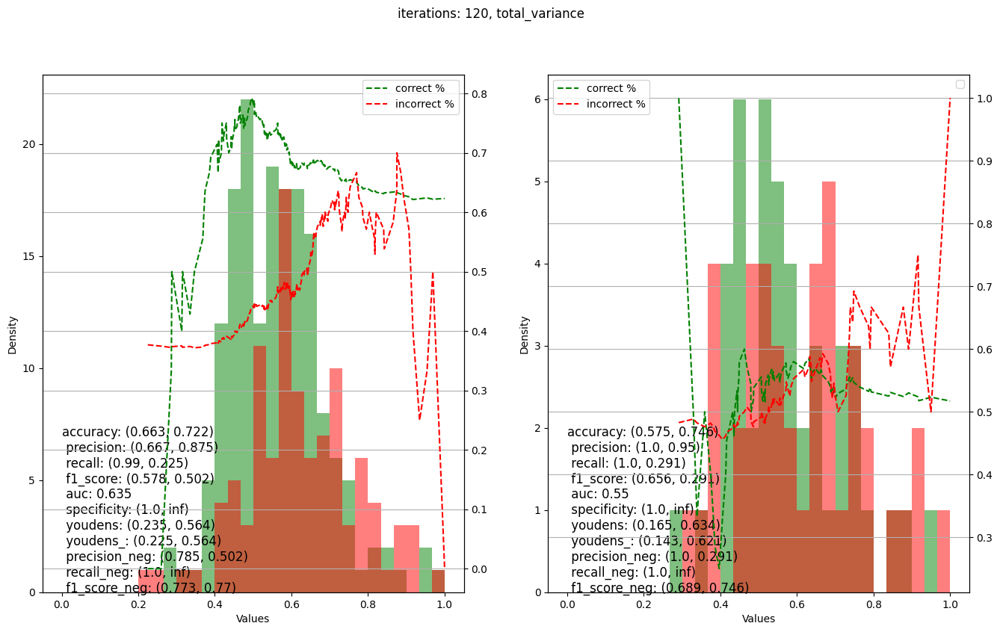

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


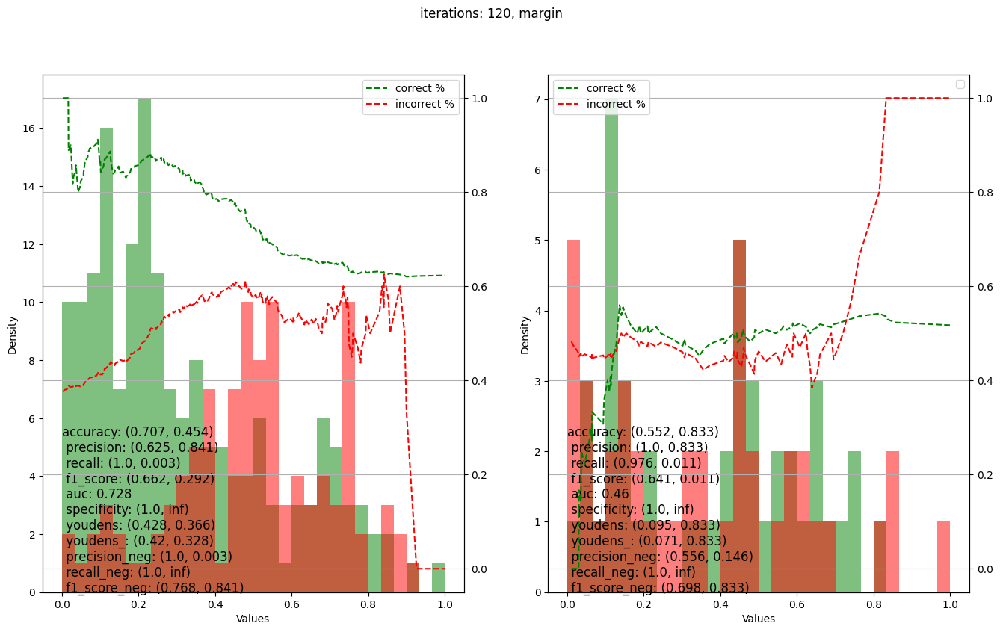

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


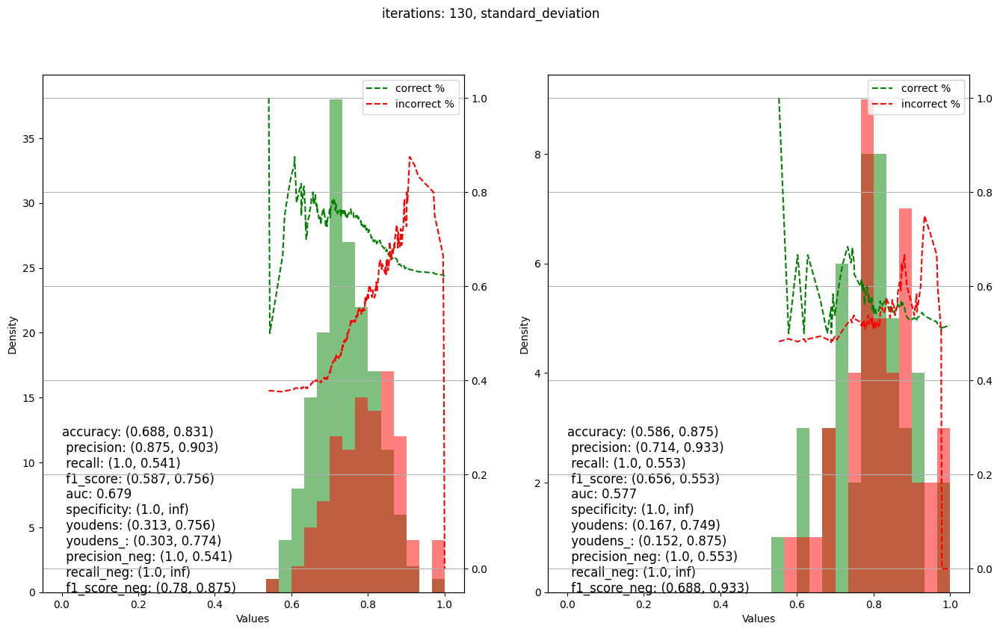

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


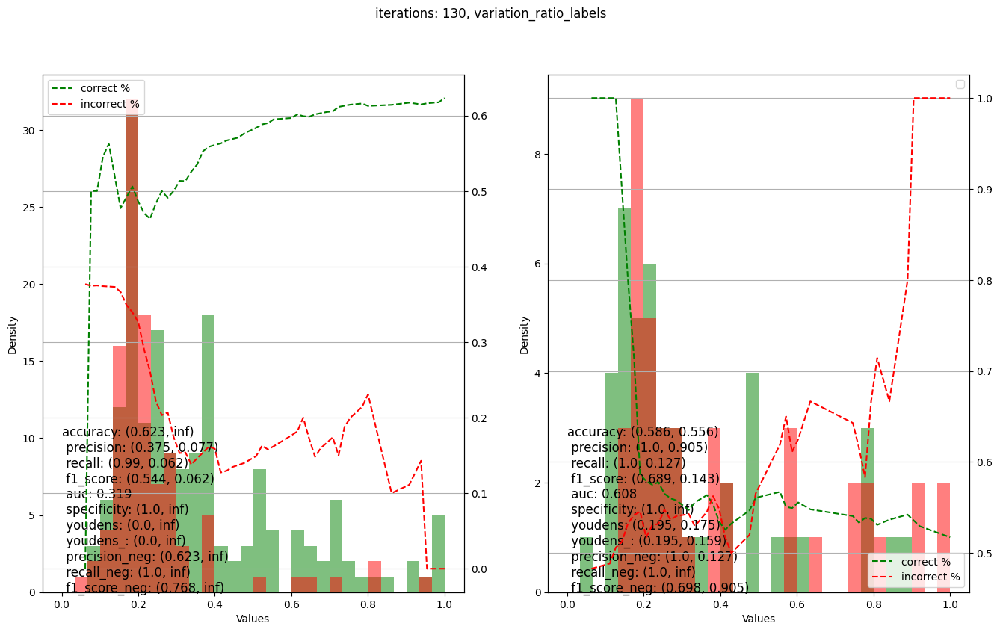

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


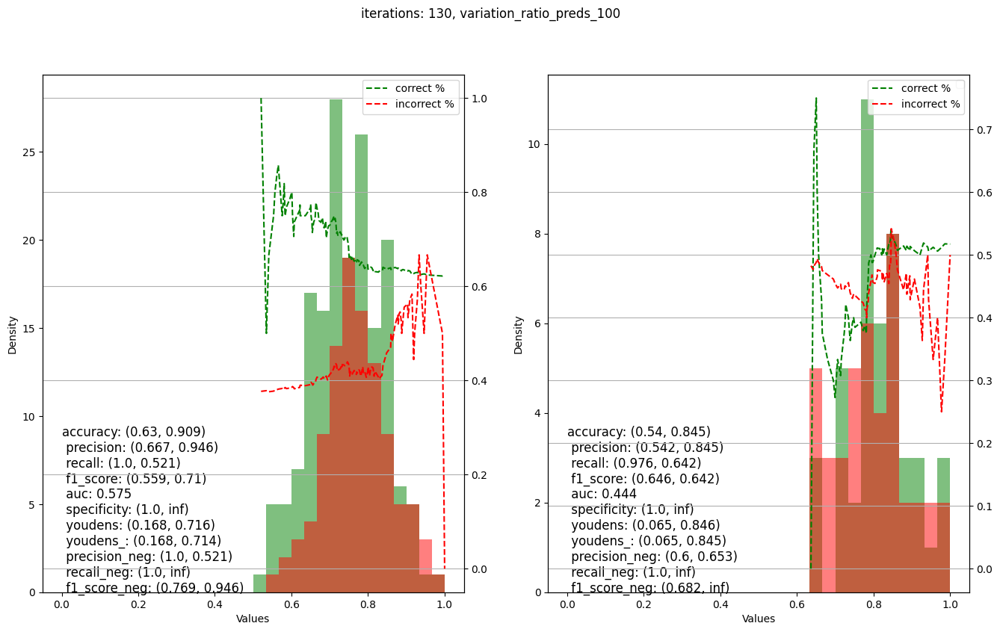

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


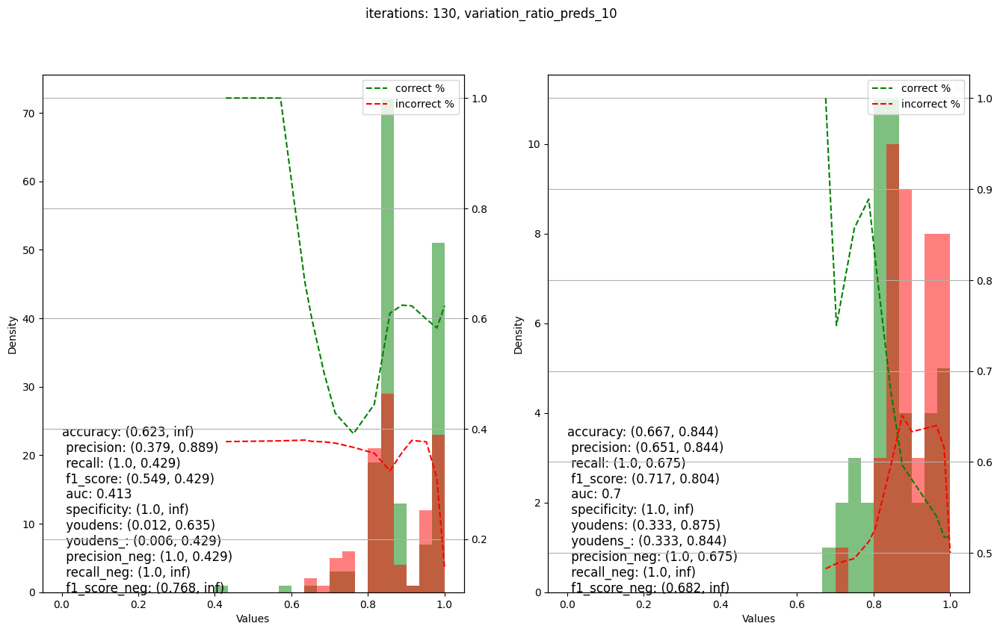

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


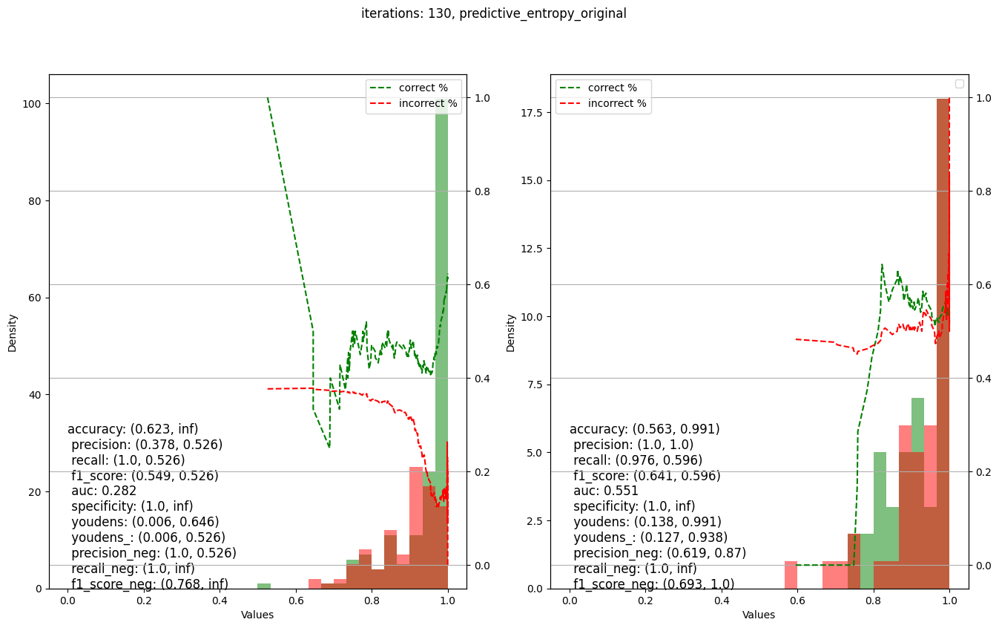

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


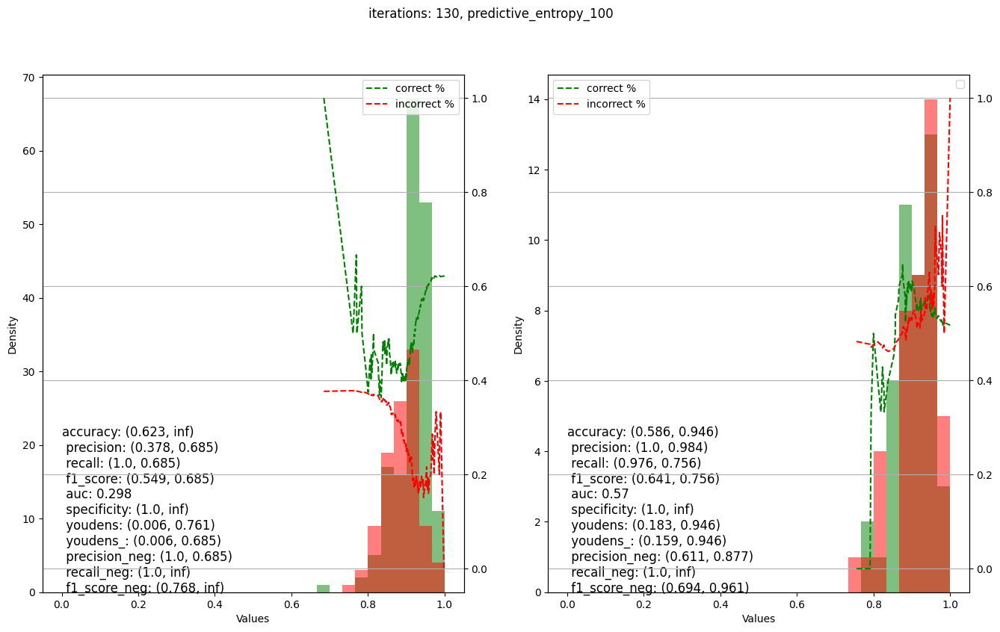

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


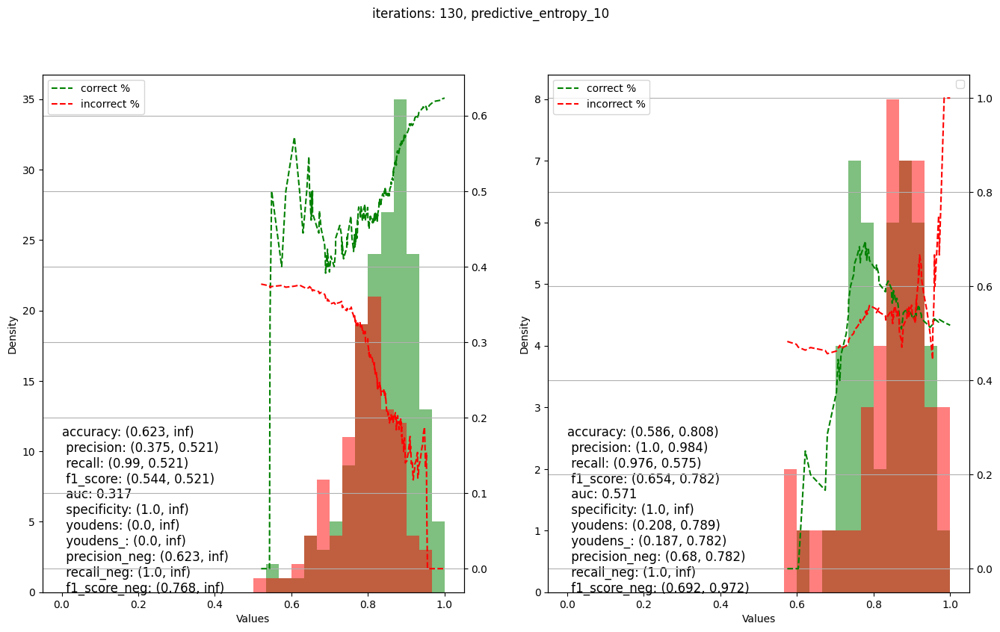

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


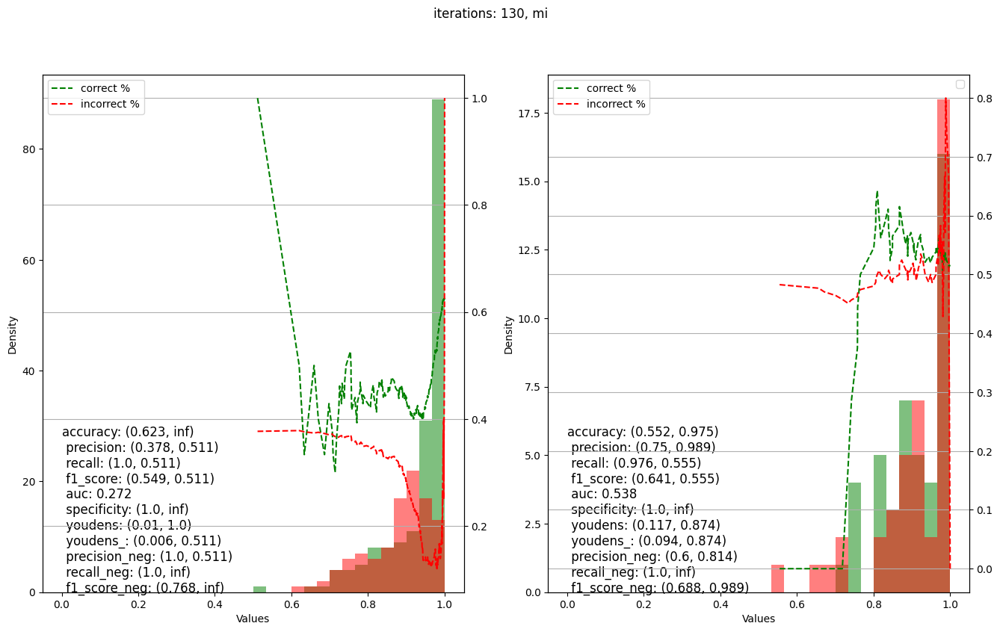

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


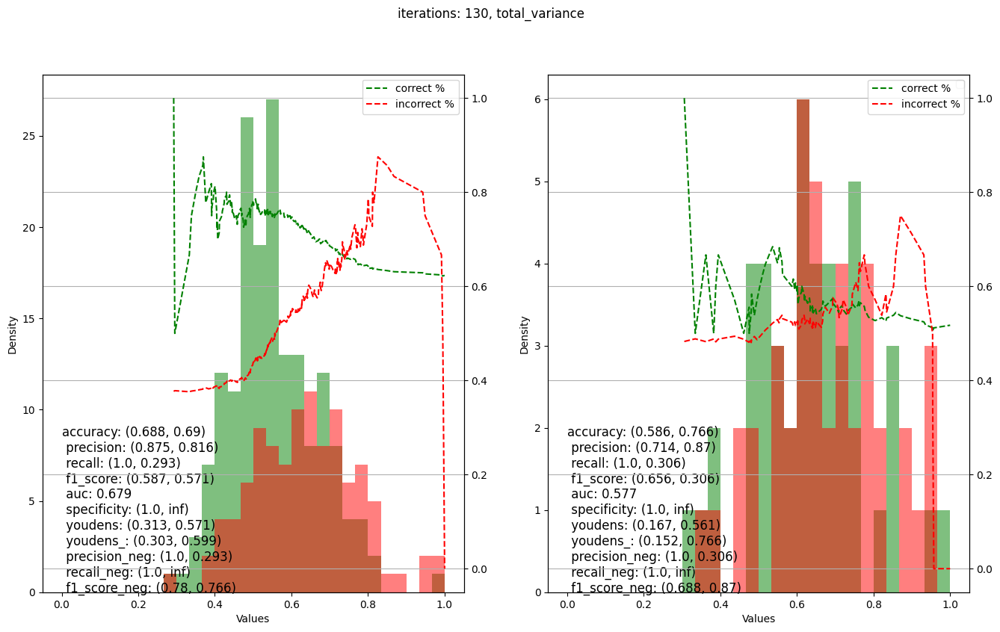

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


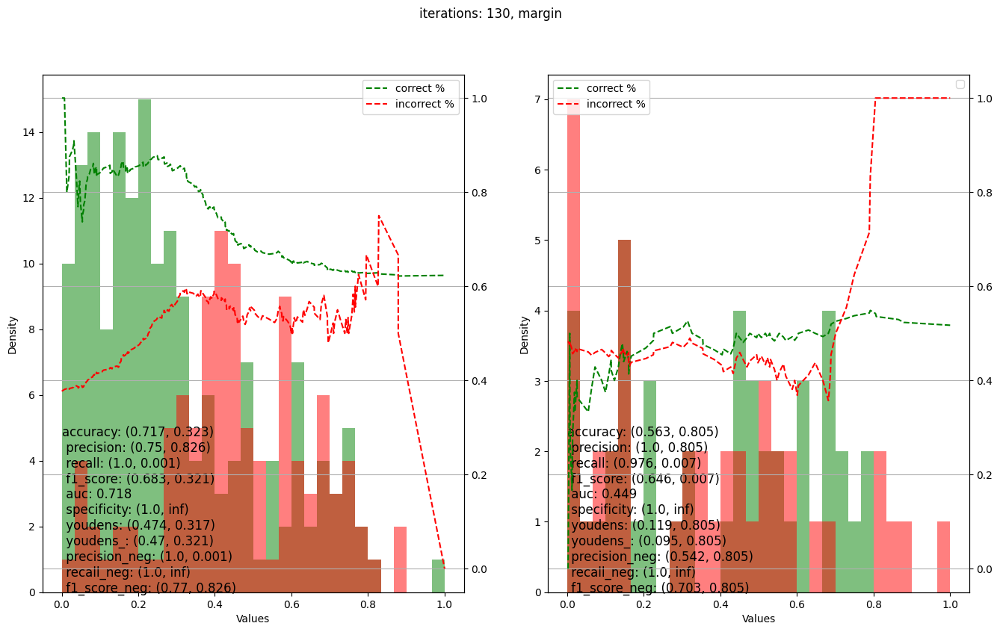

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


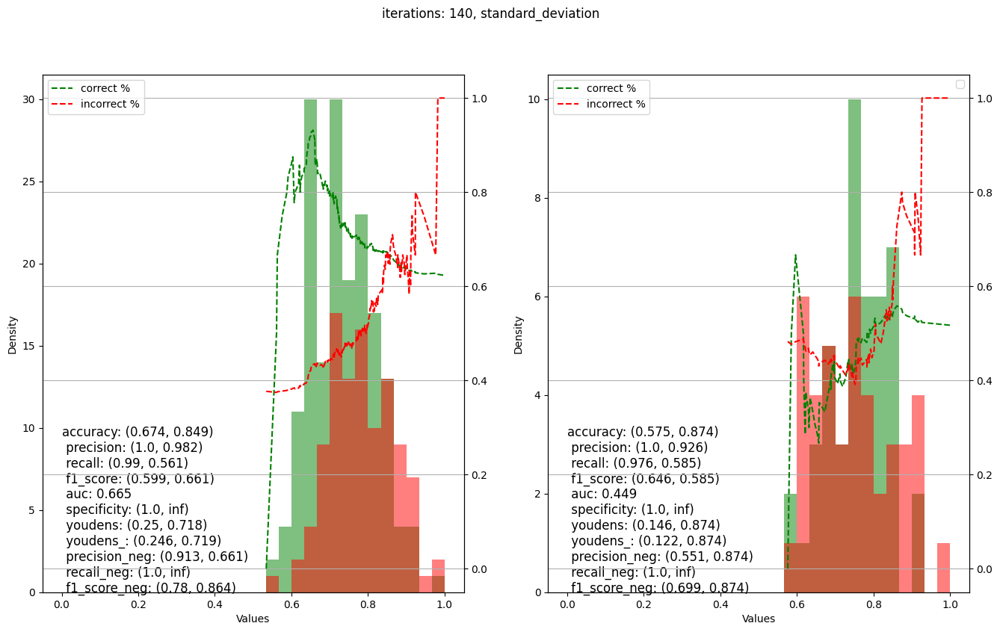

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


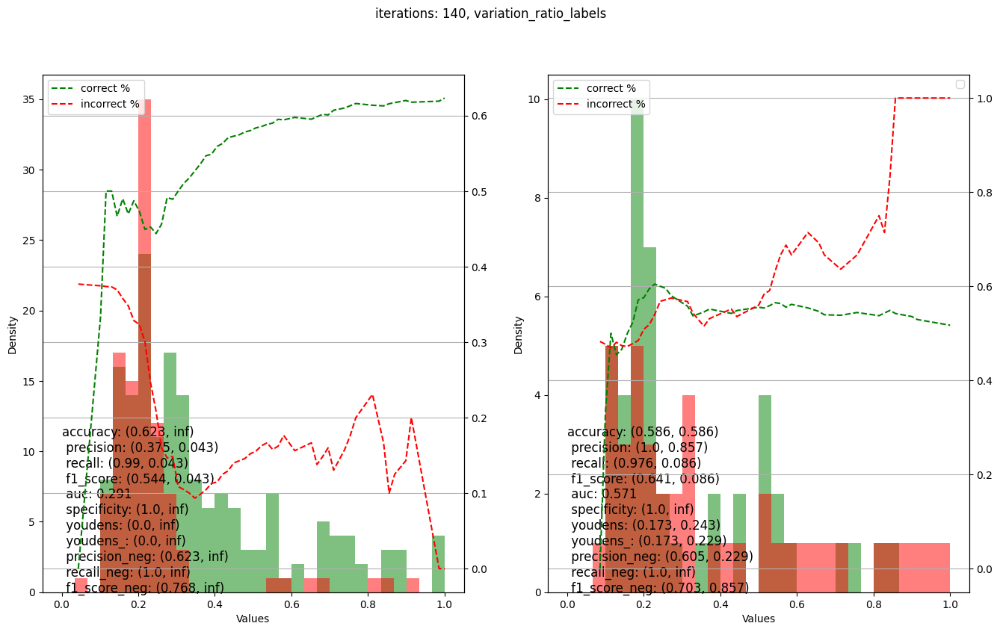

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


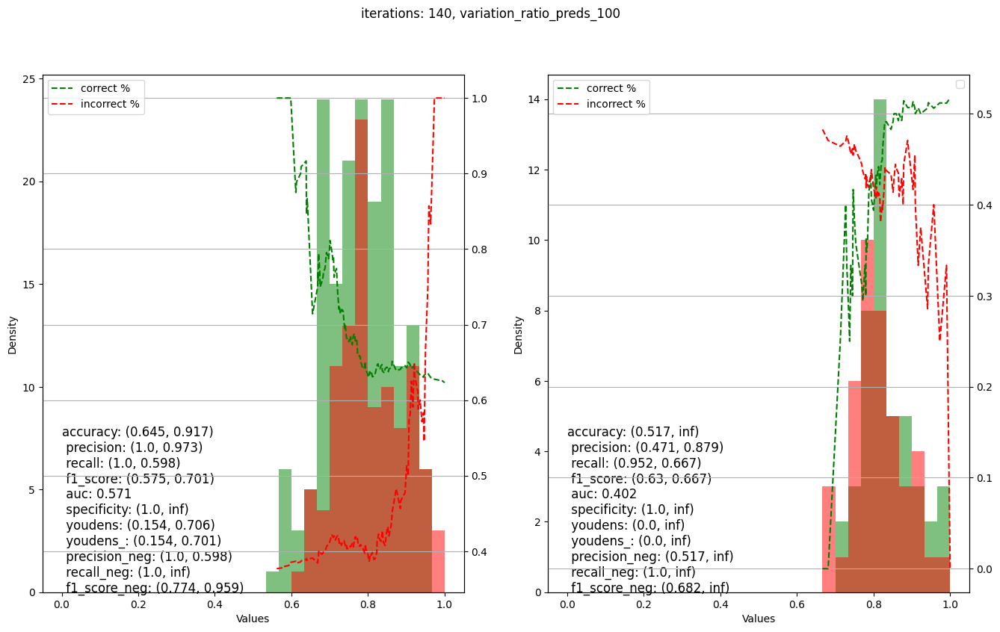

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


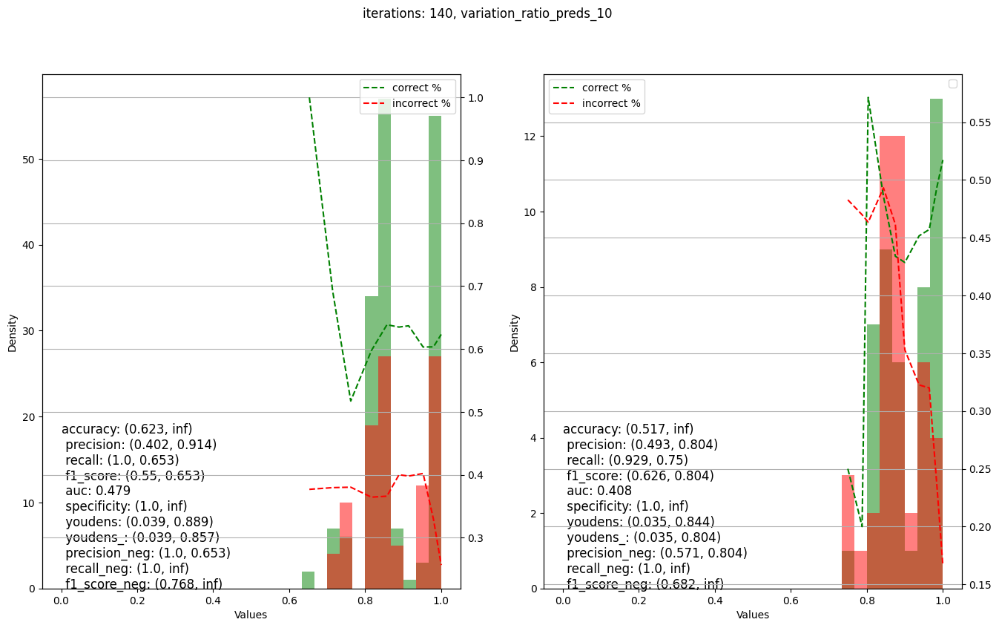

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


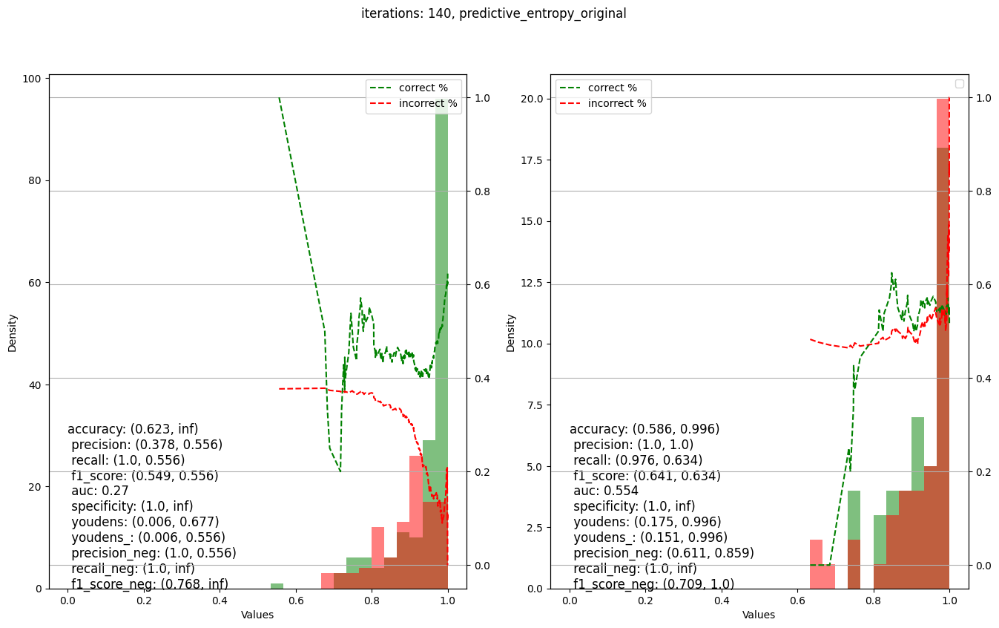

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


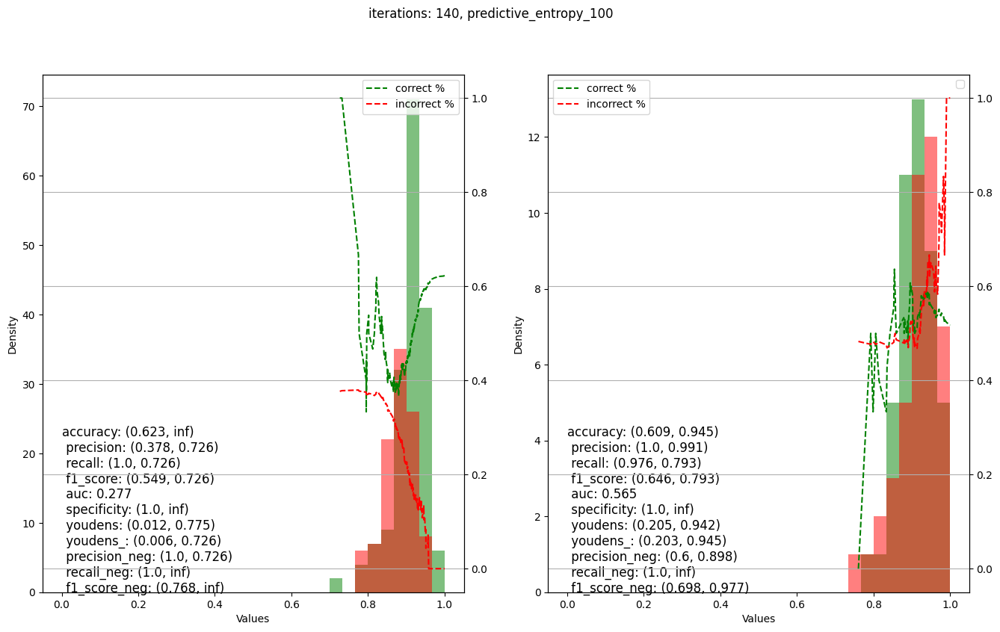

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


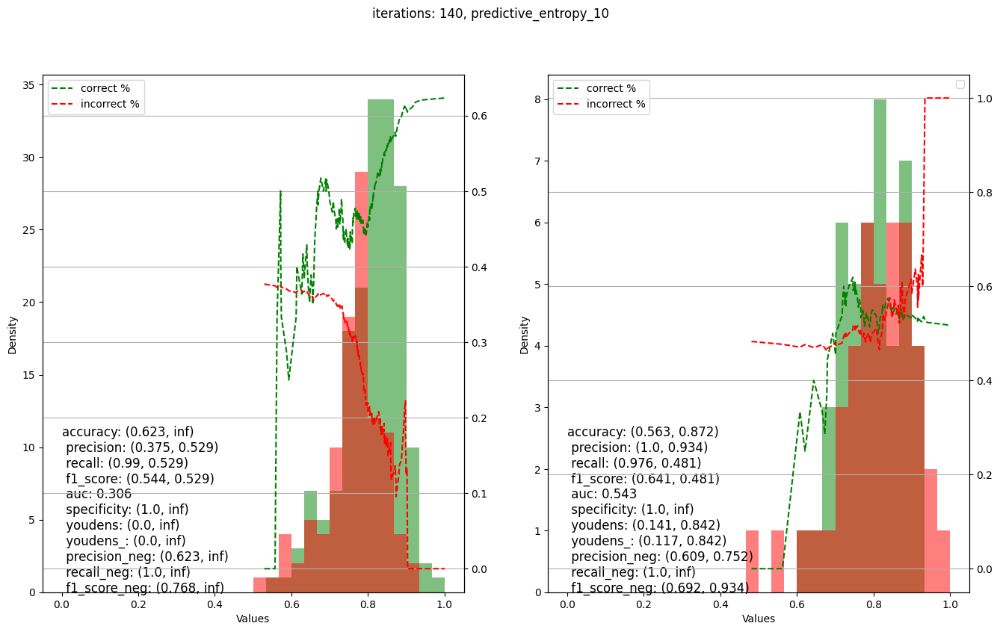

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


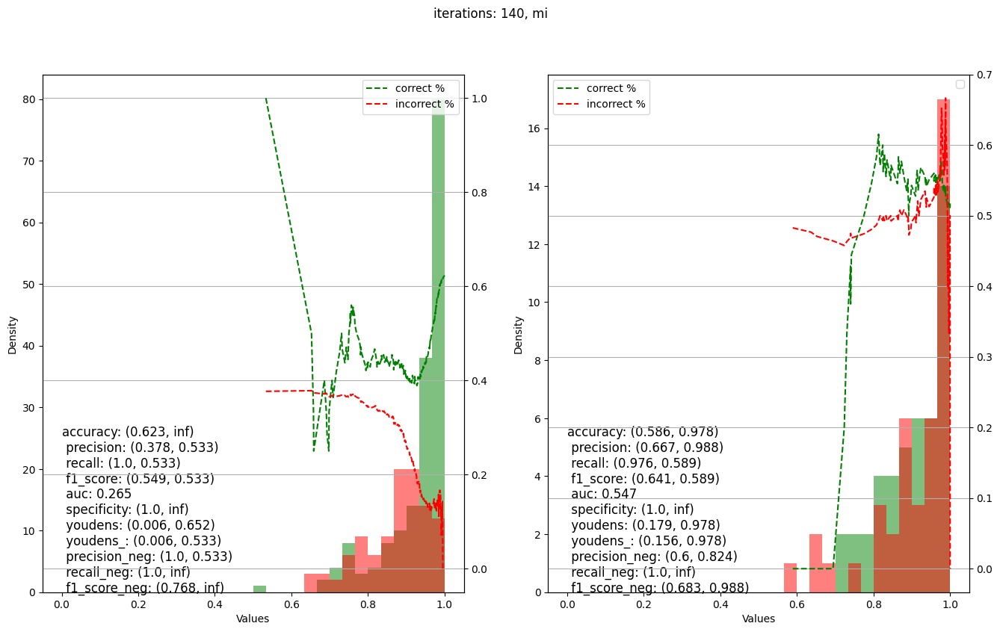

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


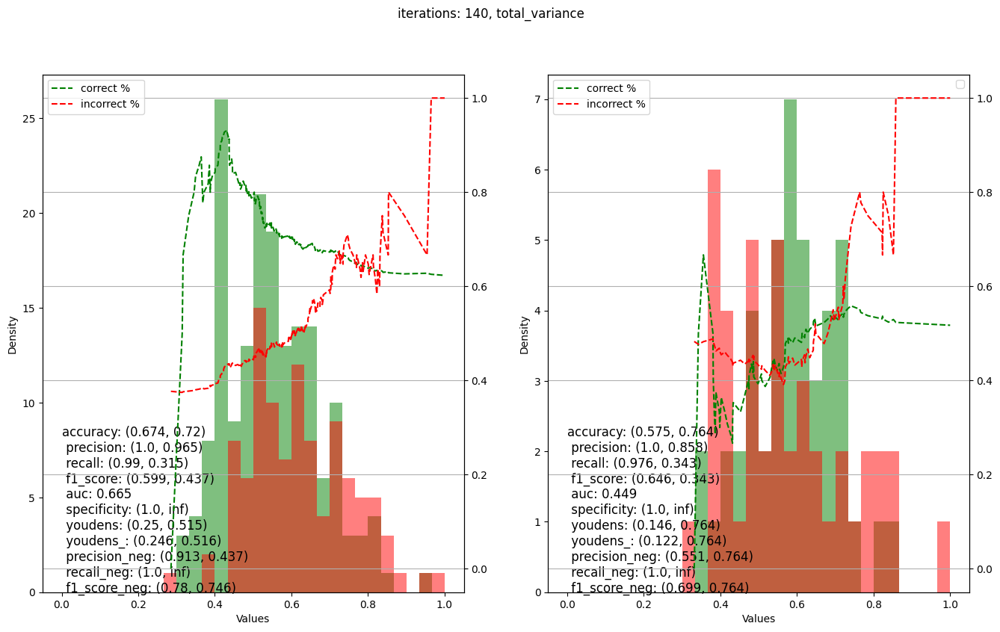

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


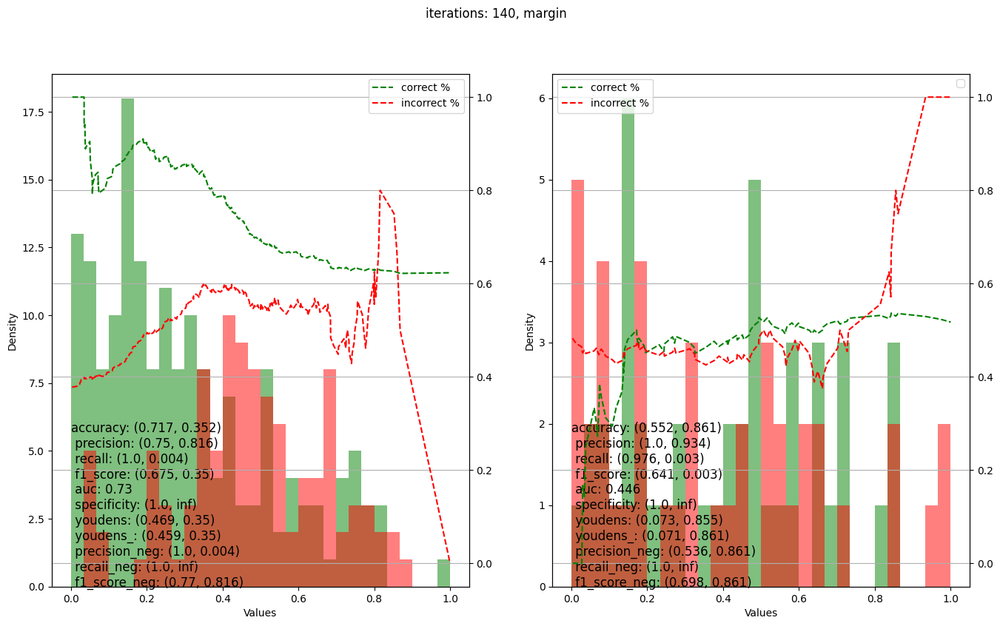

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


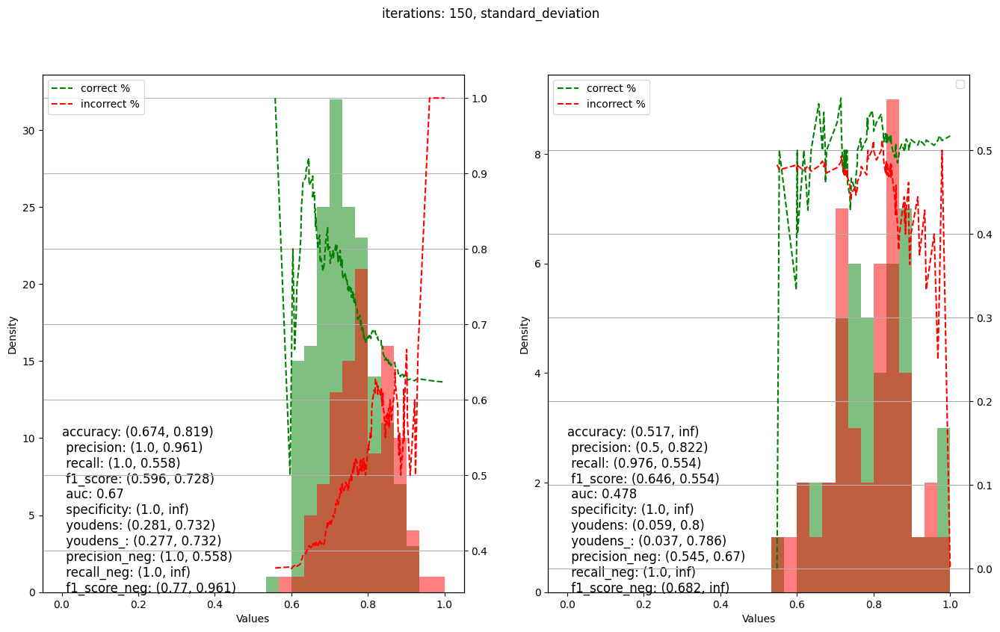

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


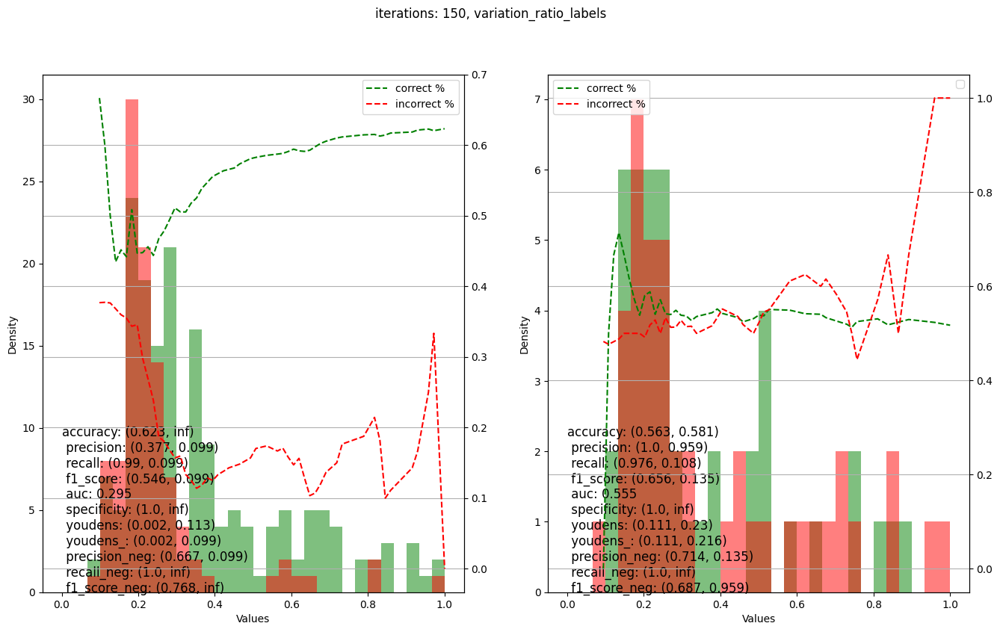

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


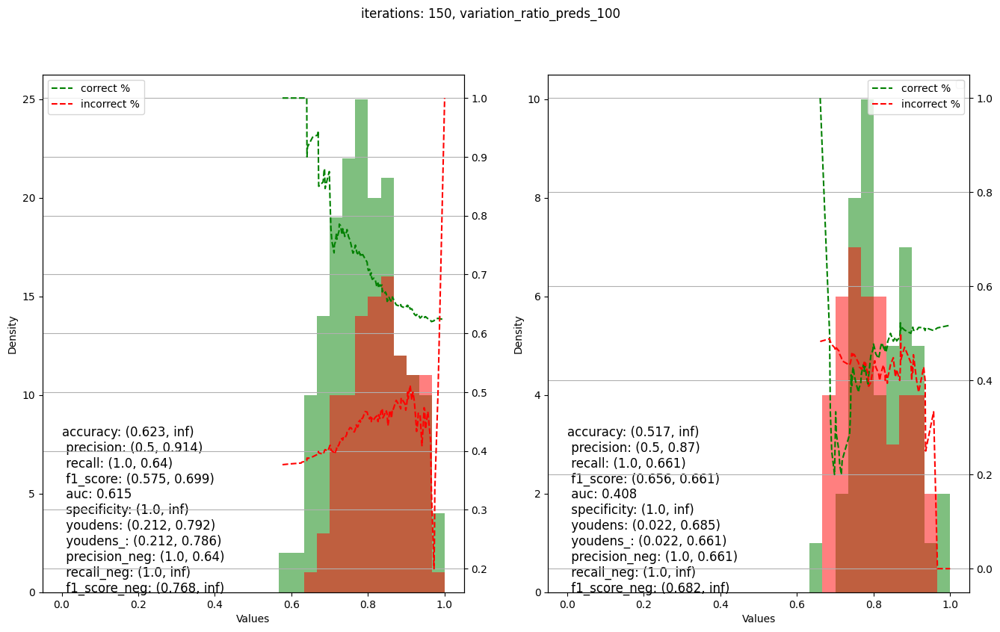

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


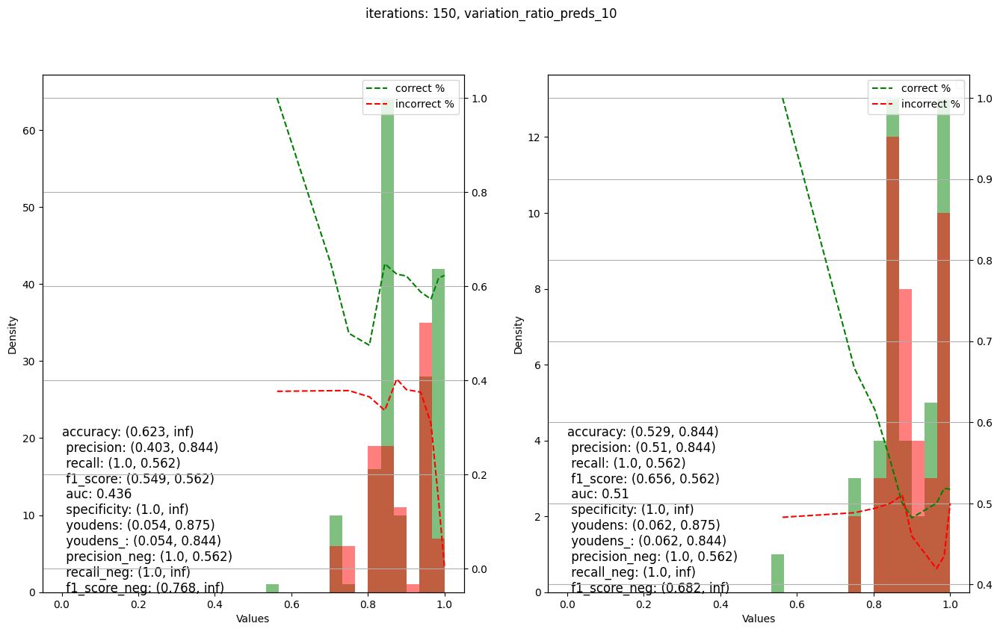

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


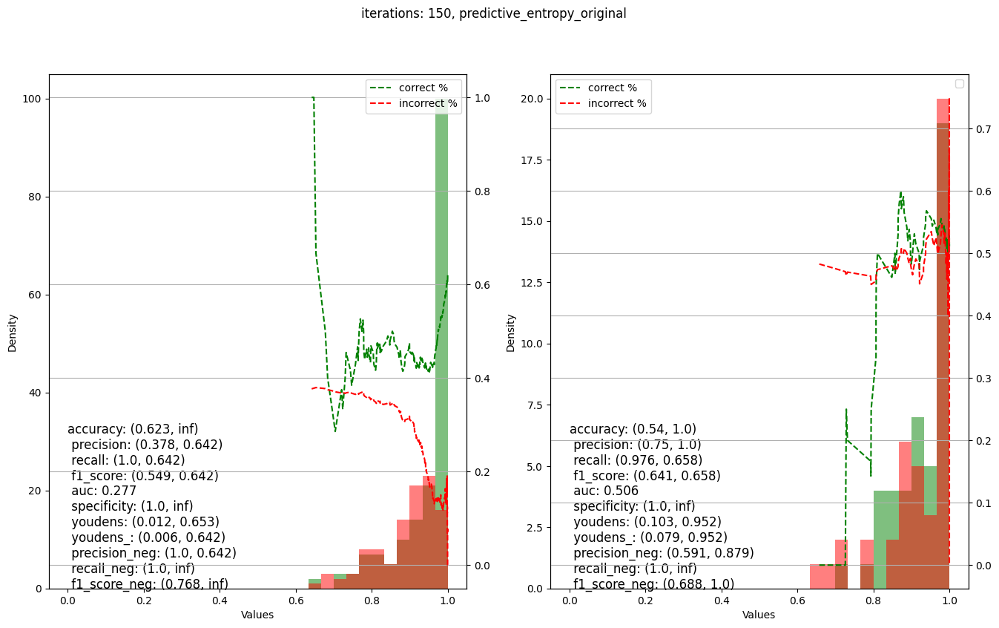

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


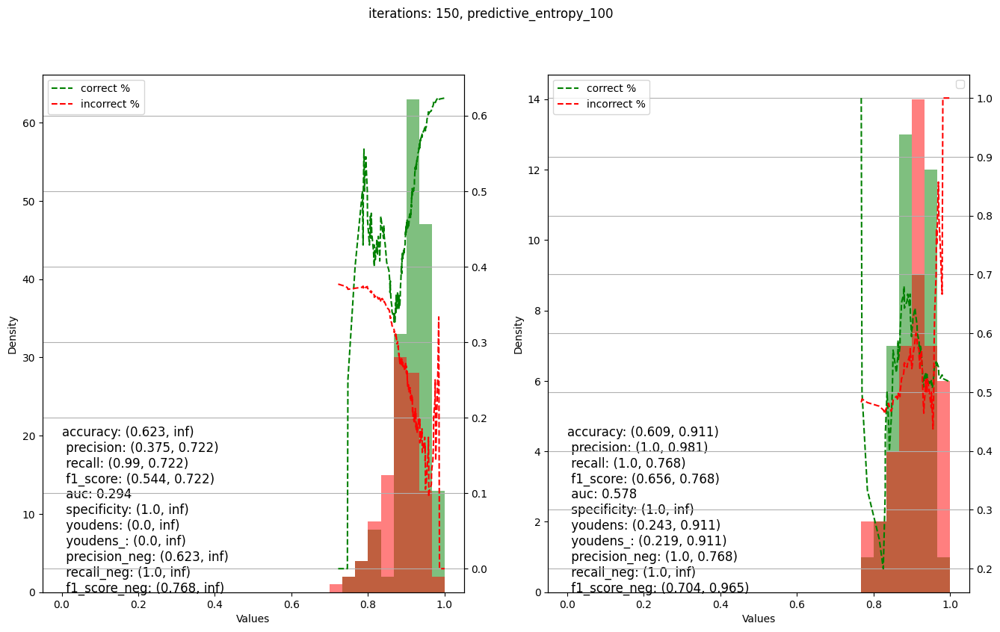

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


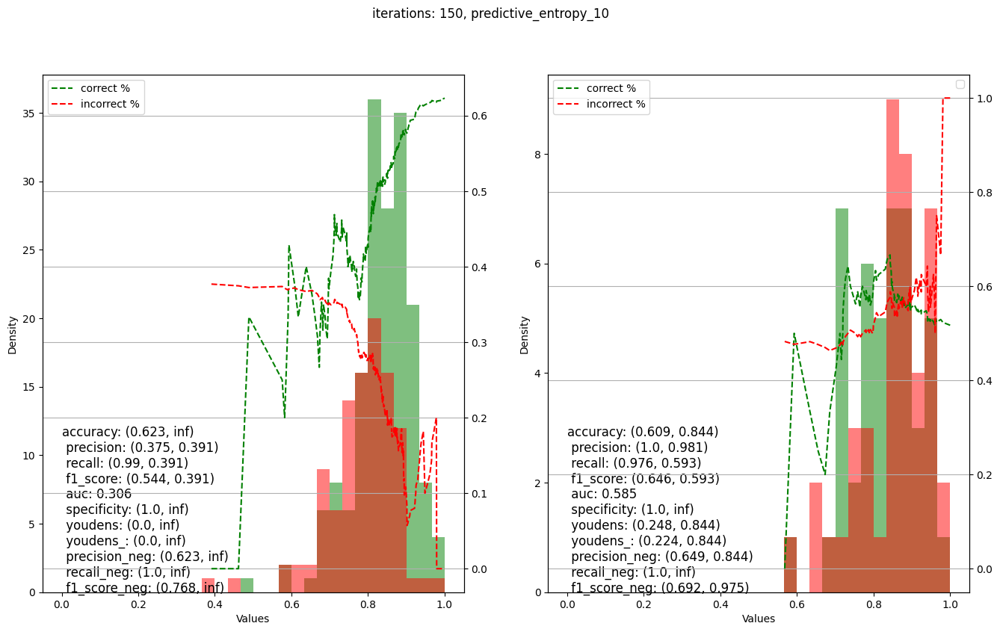

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


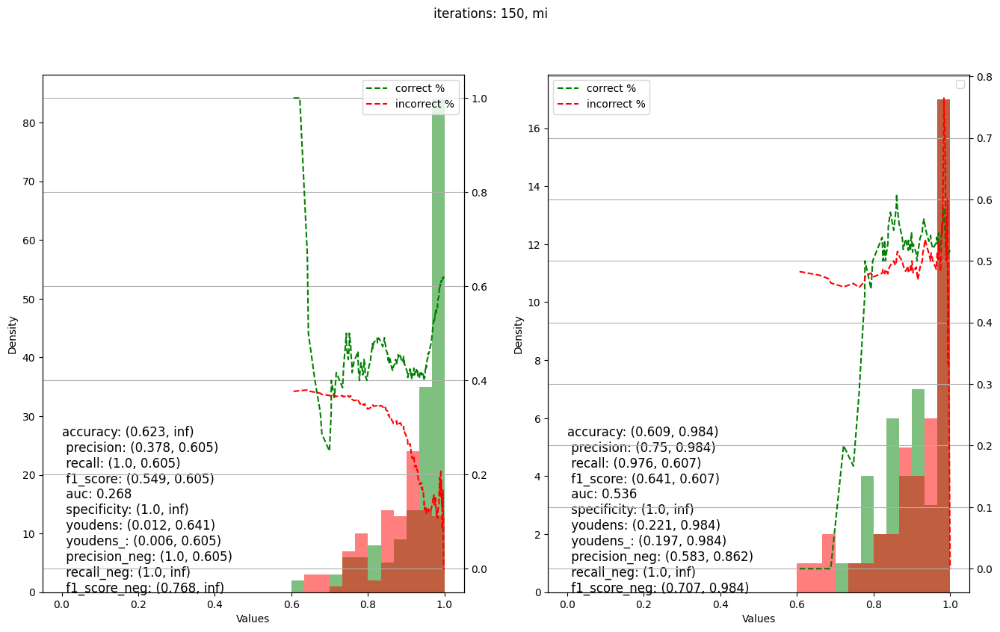

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


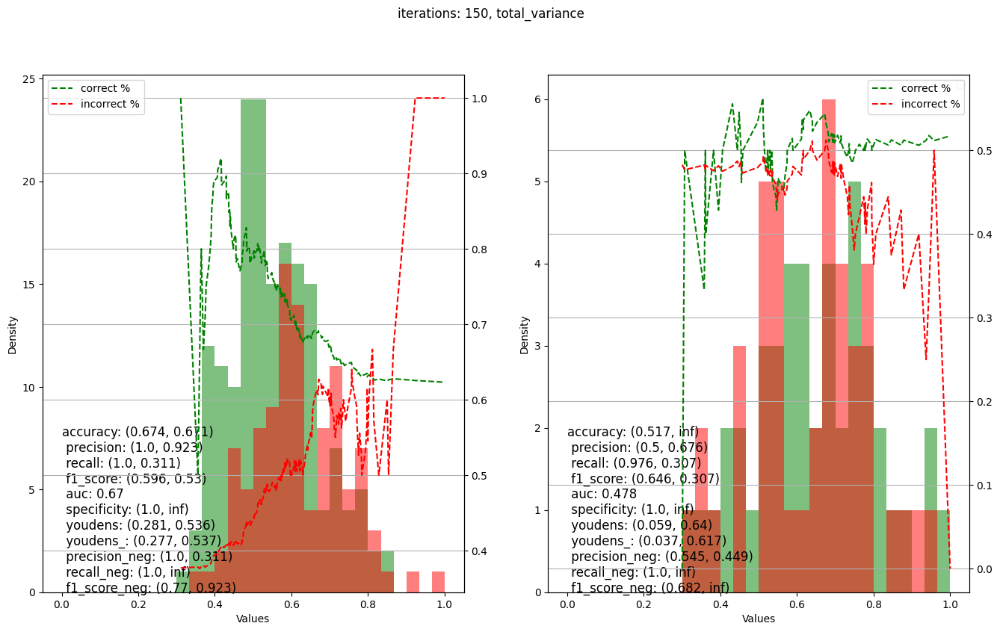

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


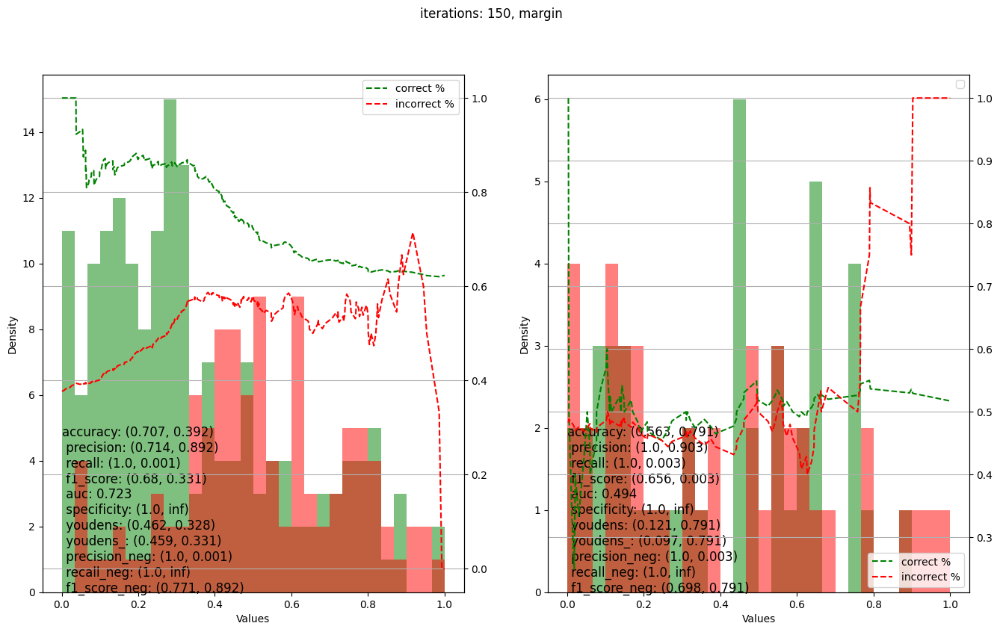

In [15]:
scores = pd.DataFrame(columns=['accuracy', 'precision', 'recall', 'f1_score', 'auc', 'specificity', 'youdens',
                               'youdens_', 'precision_neg', 'recall_neg', 'f1_score_neg', 'j', 'fun', 'accuracy_thrs',
                               'precision_thrs', 'recall_thrs', 'f1_score_thrs', 'auc_thrs', 'specificity_thrs',
                               'youdens_thrs', 'youdens__thrs', 'precision_neg_thrs', 'recall_neg_thrs', 'f1_score_neg_thrs'])
for j in range(10, 160, 10):
    for fun in [standard_deviation, variation_ratio_labels, variation_ratio_preds_100, variation_ratio_preds_10, predictive_entropy_original, predictive_entropy_100, predictive_entropy_10, mi, total_variance, margin]:
        fig, ax = plt.subplots(1,2, figsize=(16, 9))
        # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
        cor = np.apply_along_axis(fun, 1, pred_cor[j])
        mis = np.apply_along_axis(fun, 1, pred_mis[j])
        cor_attikon = np.apply_along_axis(fun, 1, pred_cor_attikon[j])
        mis_attikon = np.apply_along_axis(fun, 1, pred_mis_attikon[j])
        cor, mis = cor/max(cor.max(), mis.max()), mis/max(cor.max(), mis.max())
        cor_attikon, mis_attikon = cor_attikon/max(cor_attikon.max(), mis_attikon.max()), mis_attikon/max(cor_attikon.max(), mis_attikon.max())
        
        ax[0].hist(cor, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
        ax[0].hist(mis, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
        plt.legend()
        a = ax[0].twinx()
        a.plot(np.unique(np.concatenate([cor, mis])), [((cor<=t)*1).sum()/(((cor<=t)*1).sum() + ((mis<=t)*1).sum()) for t in np.unique(np.concatenate([cor, mis]))], 'g--', label="correct %")
        a.plot(np.unique(np.concatenate([cor, mis])), [((mis>=t)*1).sum()/(((cor>=t)*1).sum() + ((mis>=t)*1).sum()) for t in np.unique(np.concatenate([cor, mis]))], 'r--', label="incorrect %")
        a.grid(which='both')
        plt.legend()
        
        # Customize the plot
        ax[0].set_xlabel("Values")
        ax[0].set_ylabel("Density")
        # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
        ax[1].hist(cor_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
        ax[1].hist(mis_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
        plt.legend()
        a = ax[1].twinx()
        a.plot(np.unique(np.concatenate([cor_attikon, mis_attikon])), [((cor_attikon<=t)*1).sum()/(((cor_attikon<=t)*1).sum() + ((mis_attikon<=t)*1).sum()) for t in np.unique(np.concatenate([cor_attikon, mis_attikon]))], 'g--', label="correct %")
        a.plot(np.unique(np.concatenate([cor_attikon, mis_attikon])), [((mis_attikon>=t)*1).sum()/(((cor_attikon>=t)*1).sum() + ((mis_attikon>=t)*1).sum()) for t in np.unique(np.concatenate([cor_attikon, mis_attikon]))], 'r--', label="incorrect %")
        a.grid(which='both')
        plt.legend()
        
        # Customize the plot
        ax[1].set_xlabel("Values")
        ax[1].set_ylabel("Density")
        fig.suptitle(f'iterations: {j}, {fun.__name__}')
        eval_results = evaluate(np.concatenate([np.zeros_like(cor), np.ones_like(mis)]), np.concatenate([cor, mis]))
        ax[0].text(0, 0, ' \n '.join([f"{met}: {val}" for met,val in eval_results.items()]), fontsize=12, color='black')
        

        eval_results['j'] = j
        eval_results['fun'] = fun.__name__
        new_row = pd.concat([pd.DataFrame.from_dict(eval_results).iloc[0], pd.DataFrame.from_dict(eval_results).iloc[1]], axis=0)
        new_row.index = [f'{col}_thrs' if i >= len(eval_results.keys()) else col for i, col in enumerate(new_row.index)]
        new_row = new_row.to_frame().T.drop(['j_thrs', 'fun_thrs'], axis=1)
        
        # Reset the index
        new_row.reset_index(drop=True, inplace=True)
        scores.loc[len(scores)] = new_row.iloc[0]
        
        eval_results = evaluate(np.concatenate([np.zeros_like(cor_attikon), np.ones_like(mis_attikon)]), np.concatenate([cor_attikon, mis_attikon]))
        ax[1].text(0, 0, ' \n '.join([f"{met}: {val}" for met,val in eval_results.items()]), fontsize=12, color='black')
        plt.show()

In [16]:
fun_names = {'variation_ratio_preds_100': 'Variation Ratio',
             'predictive_entropy_100': 'Predictive Entropy', 'mi': 'Mutual Information', 'total_variance': 'Total Variance'}

In [17]:
scores_original = scores.copy()
scores = scores_original[(scores_original.j<=150)&(scores_original.fun!='margin')]

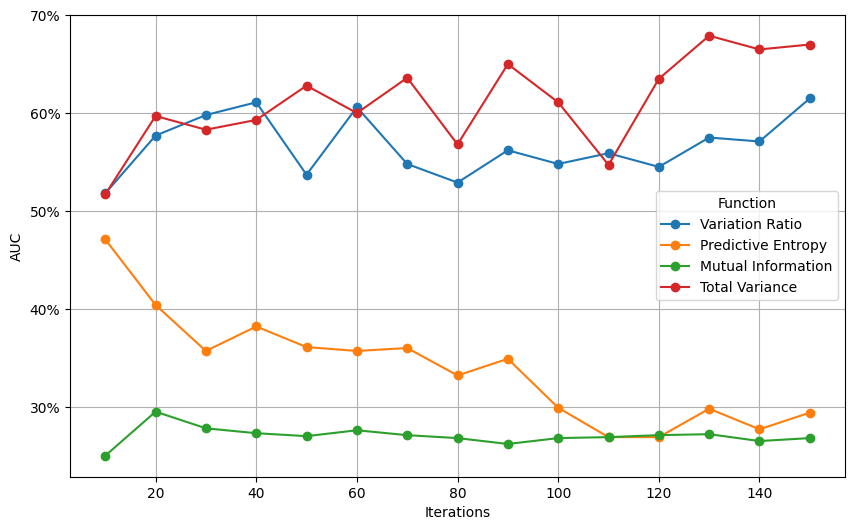

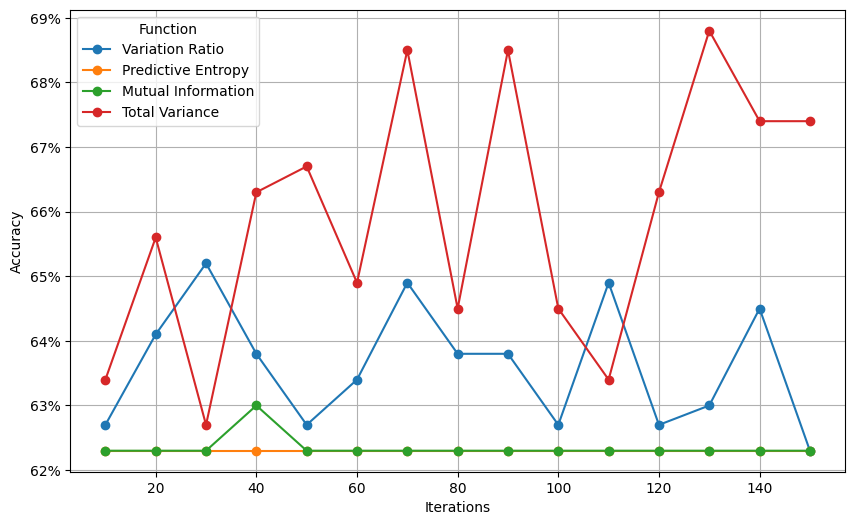

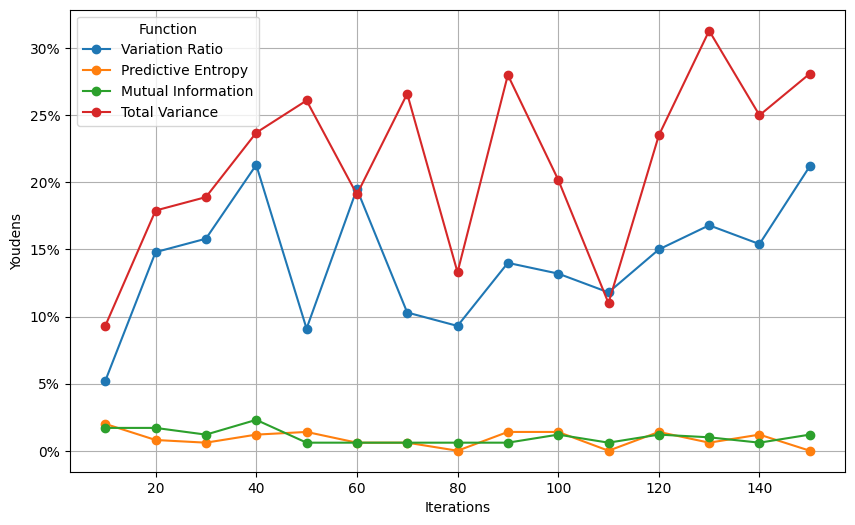

In [18]:
for ev in ['AUC', 'Accuracy', 'Youdens']:
    fig = plt.figure(figsize=(10, 6))
    
    # Loop through each unique category and plot
    for category in ['variation_ratio_preds_100', 'predictive_entropy_100', 'mi', 'total_variance']:
        subset = scores[scores['fun'] == category]
        plt.plot(subset['j'], subset[ev.lower()], marker='o', label=fun_names[category])
    
    plt.xlabel('Iterations')
    plt.ylabel(ev)
    fig.get_axes()[0].yaxis.set_major_formatter(FuncFormatter(lambda x, y: f'{int(x * 100)}%'))
    # plt.title('Multiple functions')
    plt.legend(title='Function')
    plt.grid(True)
    plt.show()

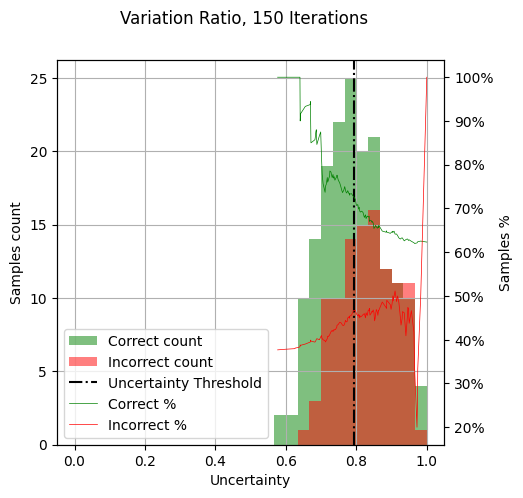

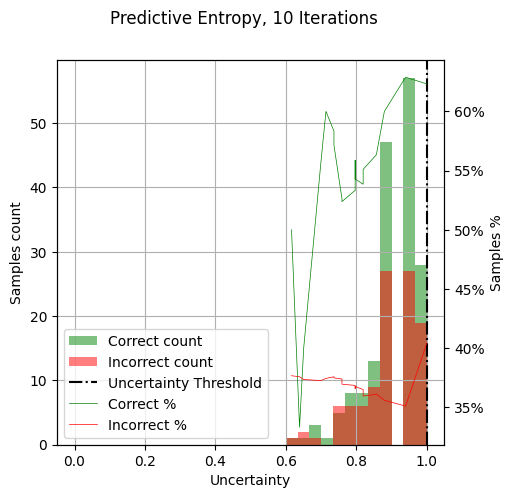

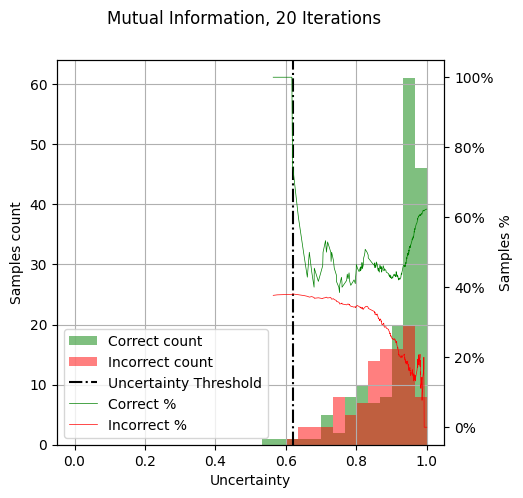

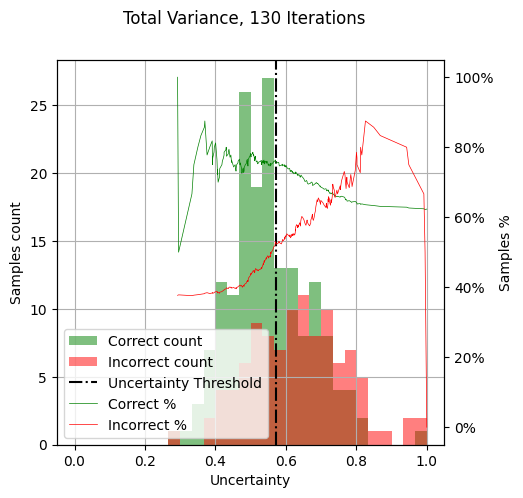

In [19]:
for fun, j in [(variation_ratio_preds_100, 150), (predictive_entropy_100, 10), (mi, 20), (total_variance, 130)]:
    cor = np.apply_along_axis(fun, 1, pred_cor[j])
    mis = np.apply_along_axis(fun, 1, pred_mis[j])
    cor_attikon = np.apply_along_axis(fun, 1, pred_cor_attikon[j])
    mis_attikon = np.apply_along_axis(fun, 1, pred_mis_attikon[j])
    cor, mis = cor/max(cor.max(), mis.max()), mis/max(cor.max(), mis.max())
    cor_attikon, mis_attikon = cor_attikon/max(cor_attikon.max(), mis_attikon.max()), mis_attikon/max(cor_attikon.max(), mis_attikon.max())
    
    fig, ax = plt.subplots(1,1, figsize=(5, 5))
    ax.hist(cor, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="Correct count")
    ax.hist(mis, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="Incorrect count")
    ax.grid(which='both')
    a = ax.twinx()
    a.plot(np.unique(np.concatenate([cor, mis])), [((cor<=t)*1).sum()/(((cor<=t)*1).sum() + ((mis<=t)*1).sum()) for t in np.unique(np.concatenate([cor, mis]))], 'g-', linewidth=0.5, label="Correct %")
    a.plot(np.unique(np.concatenate([cor, mis])), [((mis>=t)*1).sum()/(((cor>=t)*1).sum() + ((mis>=t)*1).sum()) for t in np.unique(np.concatenate([cor, mis]))], 'r-', linewidth=0.5, label="Incorrect %")
    a.yaxis.set_major_formatter(FuncFormatter(lambda x, y: f'{int(x * 100)}%'))
    
    # Customize the plot
    ax.set_xlabel("Uncertainty")
    ax.set_ylabel("Samples count")
    a.set_ylabel("Samples %")
    
    fig.suptitle(f'{fun_names[fun.__name__]}, {j} Iterations')
    eval_results = evaluate(np.concatenate([np.zeros_like(cor), np.ones_like(mis)]), np.concatenate([cor, mis]))
    # eval_results = evaluate(np.concatenate([np.zeros_like(cor_attikon), np.ones_like(mis_attikon)]), np.concatenate([cor_attikon, mis_attikon]))
    ax.axvline(eval_results['youdens'][1], ls='-.', c='black', label='Uncertainty Threshold')
    
    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = a.get_legend_handles_labels()
    handles = handles1 + handles2
    labels = labels1 + labels2
    
    # Create the combined legend
    ax.legend(handles, labels, loc='lower left')
    plt.savefig('samp.svg')
    plt.show()

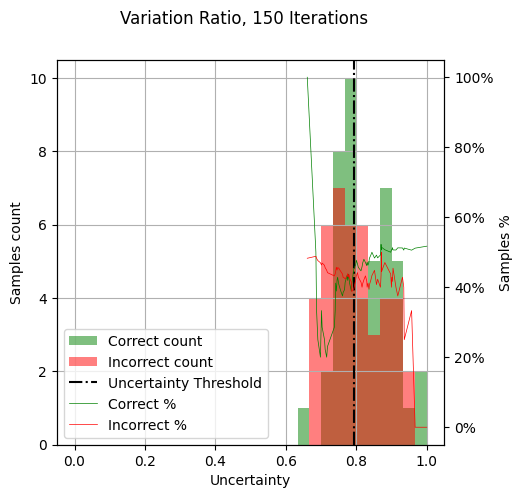

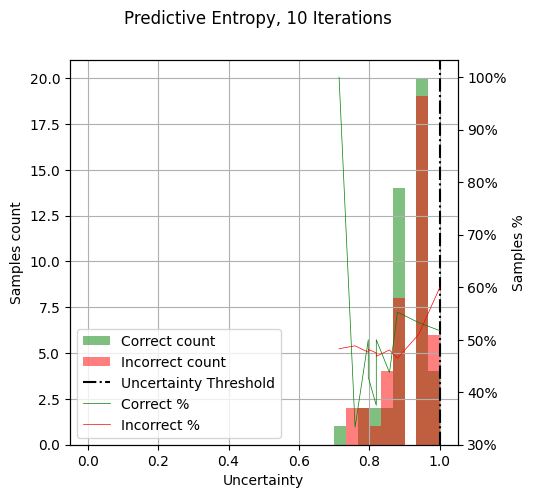

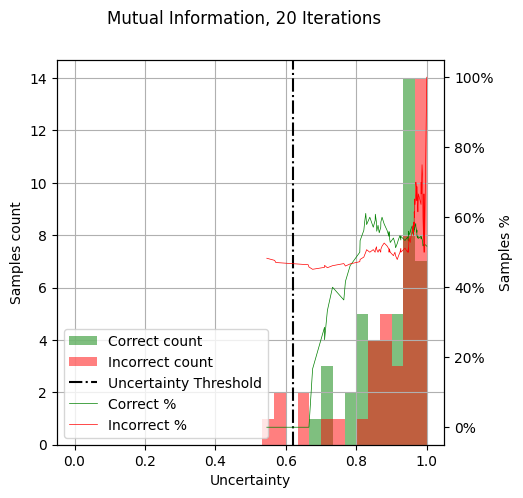

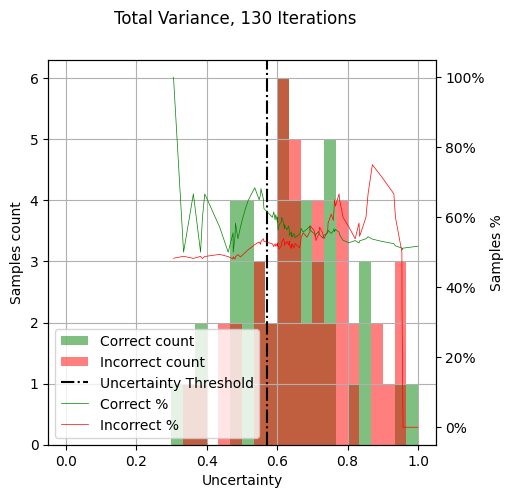

In [30]:
for fun, j in [(variation_ratio_preds_100, 150), (predictive_entropy_100, 10), (mi, 20), (total_variance, 130)]:
    cor = np.apply_along_axis(fun, 1, pred_cor[j])
    mis = np.apply_along_axis(fun, 1, pred_mis[j])
    cor_attikon = np.apply_along_axis(fun, 1, pred_cor_attikon[j])
    mis_attikon = np.apply_along_axis(fun, 1, pred_mis_attikon[j])
    cor, mis = cor/max(cor.max(), mis.max()), mis/max(cor.max(), mis.max())
    cor_attikon, mis_attikon = cor_attikon/max(cor_attikon.max(), mis_attikon.max()), mis_attikon/max(cor_attikon.max(), mis_attikon.max())
    
    fig, ax = plt.subplots(1,1, figsize=(5, 5))
    ax.hist(cor_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="Correct count")
    ax.hist(mis_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="Incorrect count")
    ax.grid(which='both')
    a = ax.twinx()
    a.plot(np.unique(np.concatenate([cor_attikon, mis_attikon])), [((cor_attikon<=t)*1).sum()/(((cor_attikon<=t)*1).sum() + ((mis_attikon<=t)*1).sum()) for t in np.unique(np.concatenate([cor_attikon, mis_attikon]))], 'g-', linewidth=0.5, label="Correct %")
    a.plot(np.unique(np.concatenate([cor_attikon, mis_attikon])), [((mis_attikon>=t)*1).sum()/(((cor_attikon>=t)*1).sum() + ((mis_attikon>=t)*1).sum()) for t in np.unique(np.concatenate([cor_attikon, mis_attikon]))], 'r-', linewidth=0.5, label="Incorrect %")
    a.yaxis.set_major_formatter(FuncFormatter(lambda x, y: f'{int(x * 100)}%'))
    
    # Customize the plot
    ax.set_xlabel("Uncertainty")
    ax.set_ylabel("Samples count")
    a.set_ylabel("Samples %")
    
    fig.suptitle(f'{fun_names[fun.__name__]}, {j} Iterations')
    eval_results = evaluate(np.concatenate([np.zeros_like(cor), np.ones_like(mis)]), np.concatenate([cor, mis]))
    # eval_results = evaluate(np.concatenate([np.zeros_like(cor_attikon), np.ones_like(mis_attikon)]), np.concatenate([cor_attikon, mis_attikon]))
    ax.axvline(eval_results['youdens'][1], ls='-.', c='black', label='Uncertainty Threshold')
    
    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = a.get_legend_handles_labels()
    handles = handles1 + handles2
    labels = labels1 + labels2
    
    # Create the combined legend
    ax.legend(handles, labels, loc='lower left')
    plt.show()

In [17]:
funs = {i.__name__: i for i in [standard_deviation, variation_ratio_labels, variation_ratio_preds_100, variation_ratio_preds_10, predictive_entropy_original, predictive_entropy_100, predictive_entropy_10, mi, total_variance, margin]}

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


accuracy 0.69


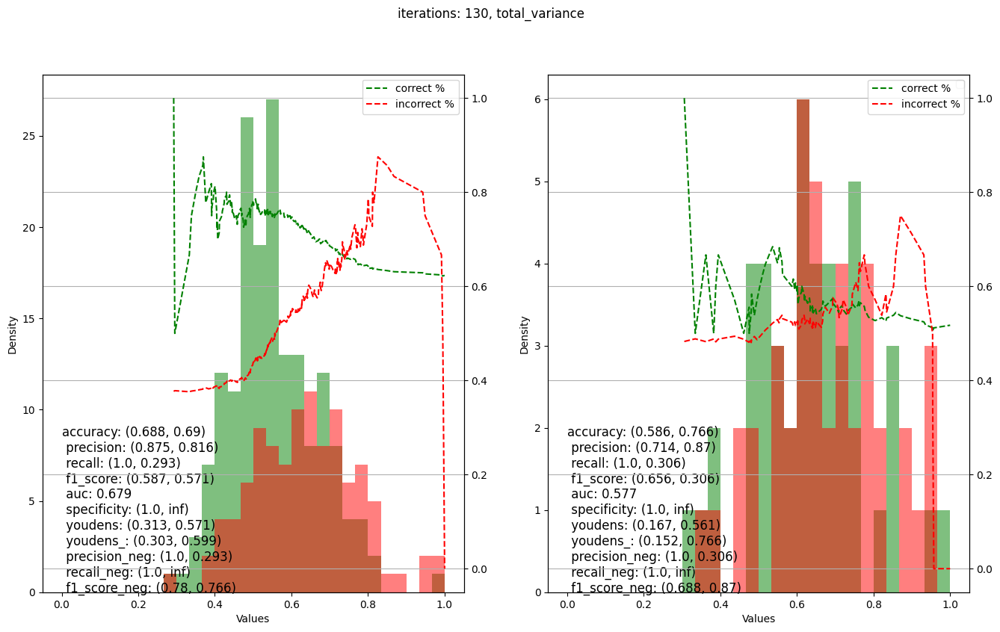

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


precision 0.897


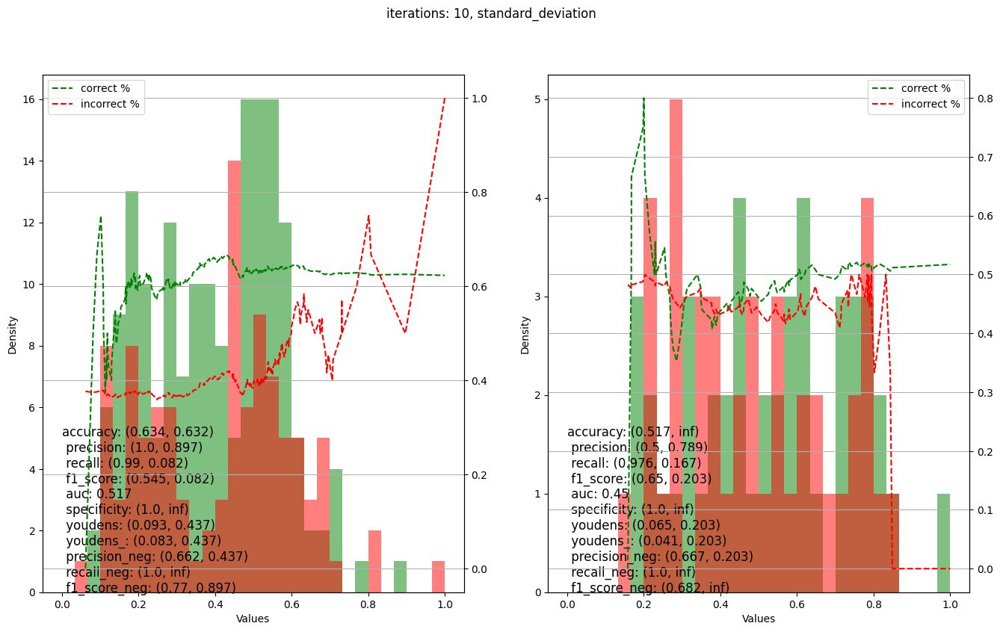

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


recall 0.311


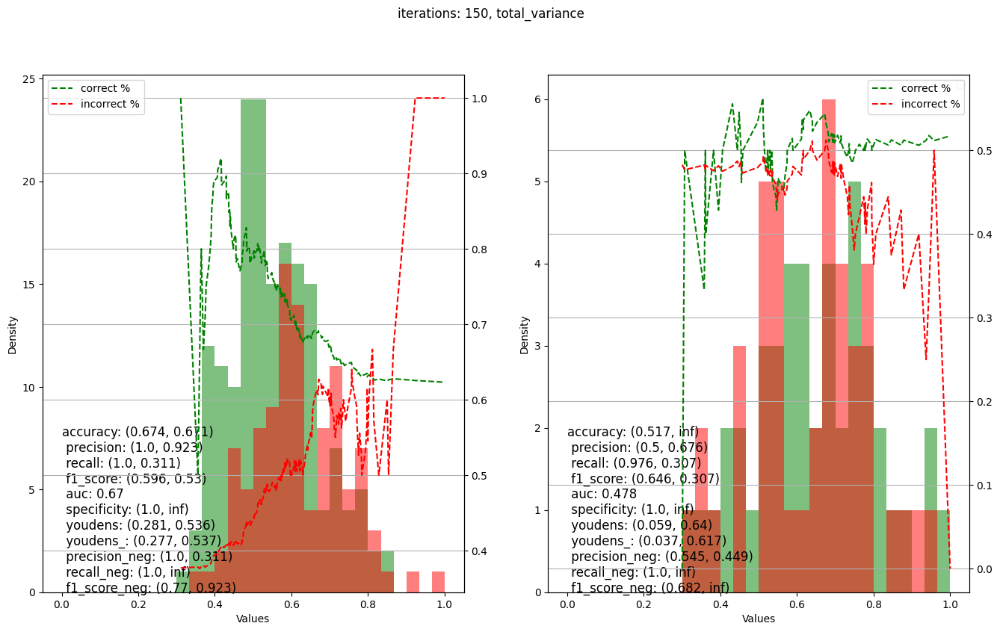

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


f1_score 0.661


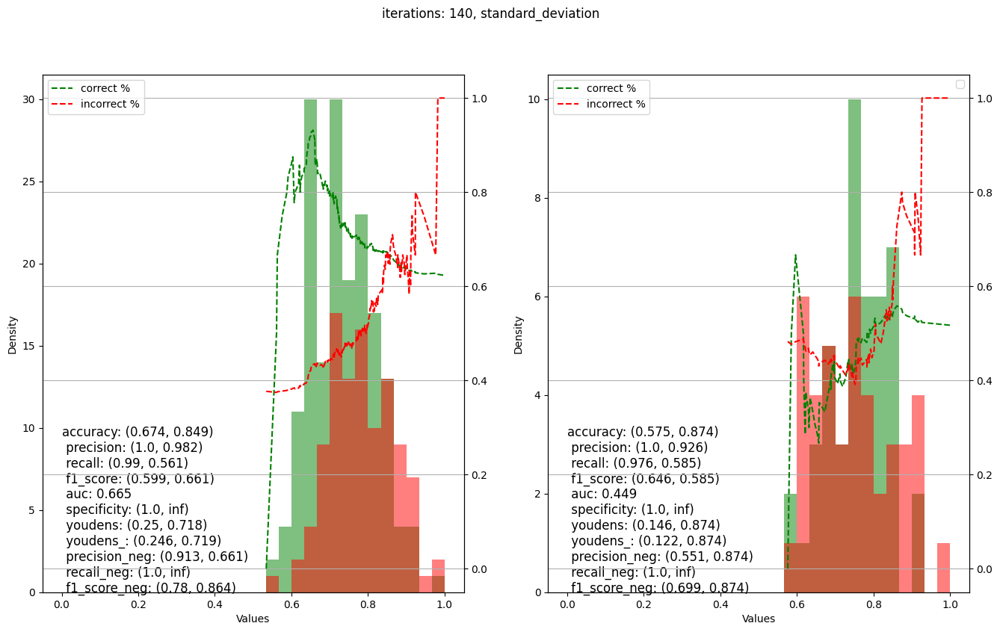

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


auc 0.679


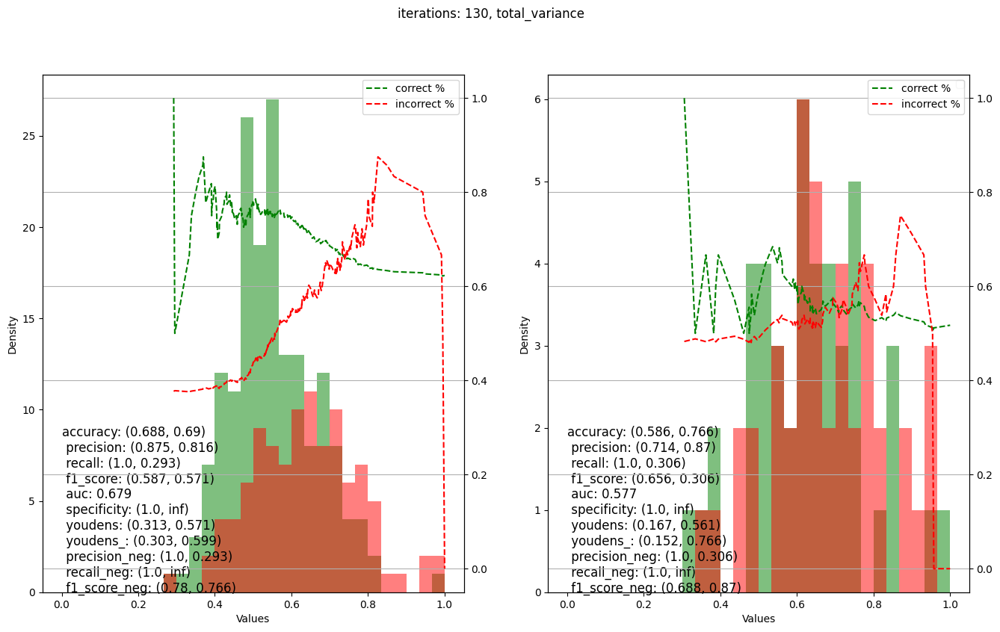

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


specificity inf


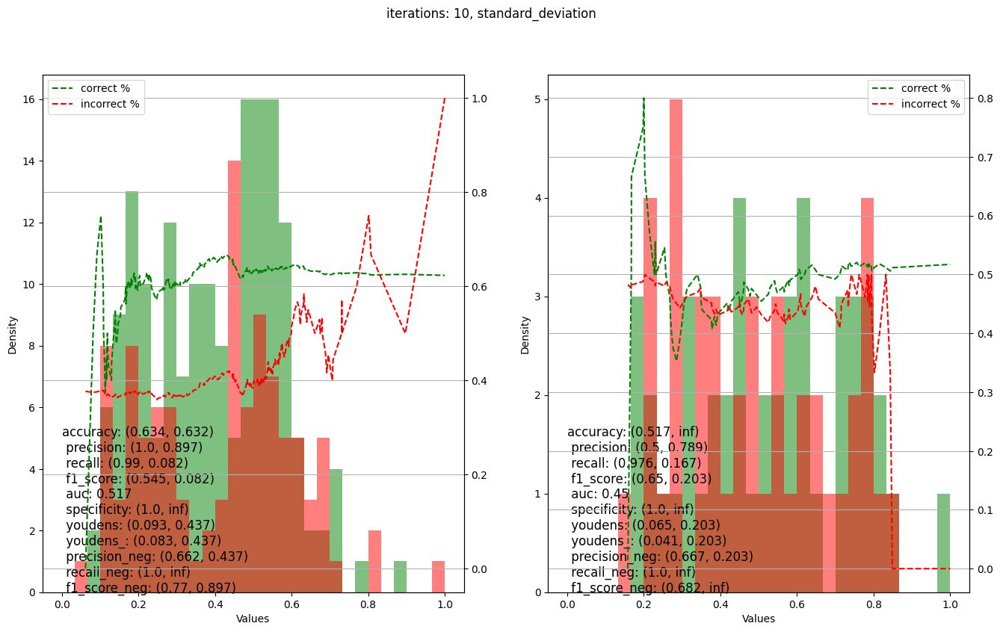

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


youdens 0.756


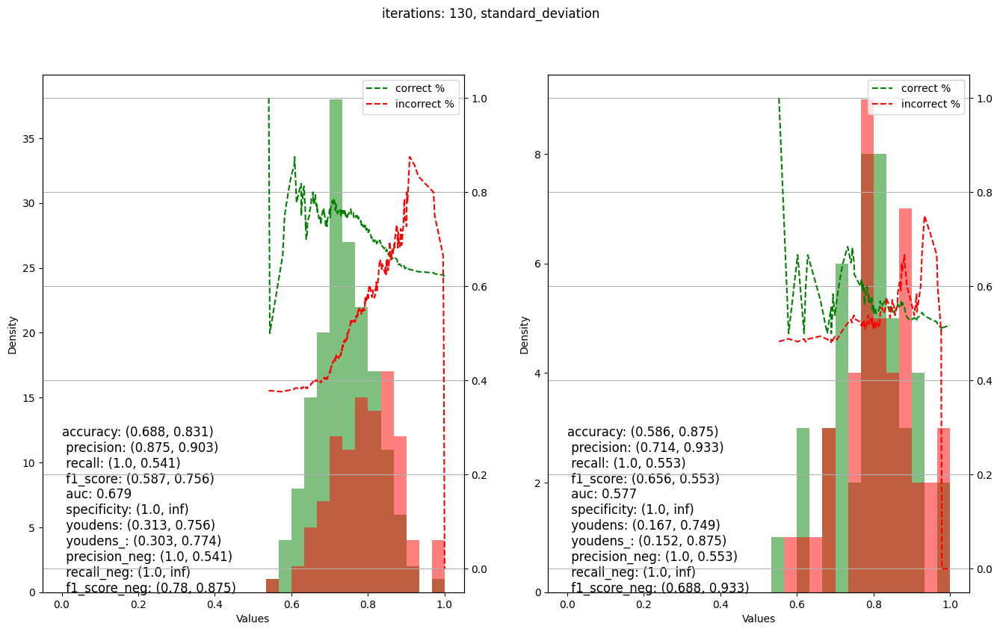

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


youdens_ 0.599


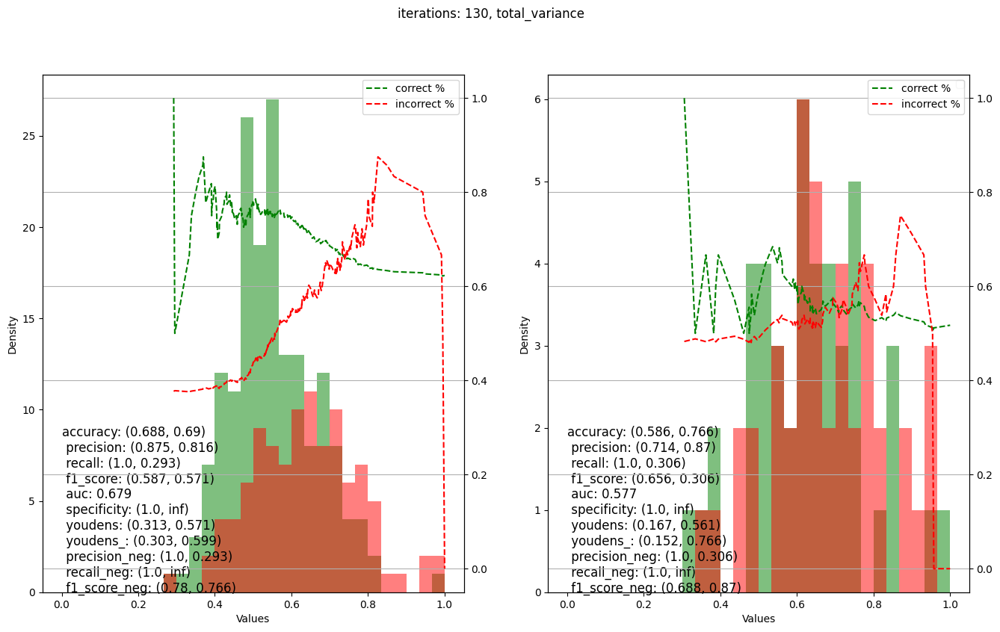

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


precision_neg 0.311


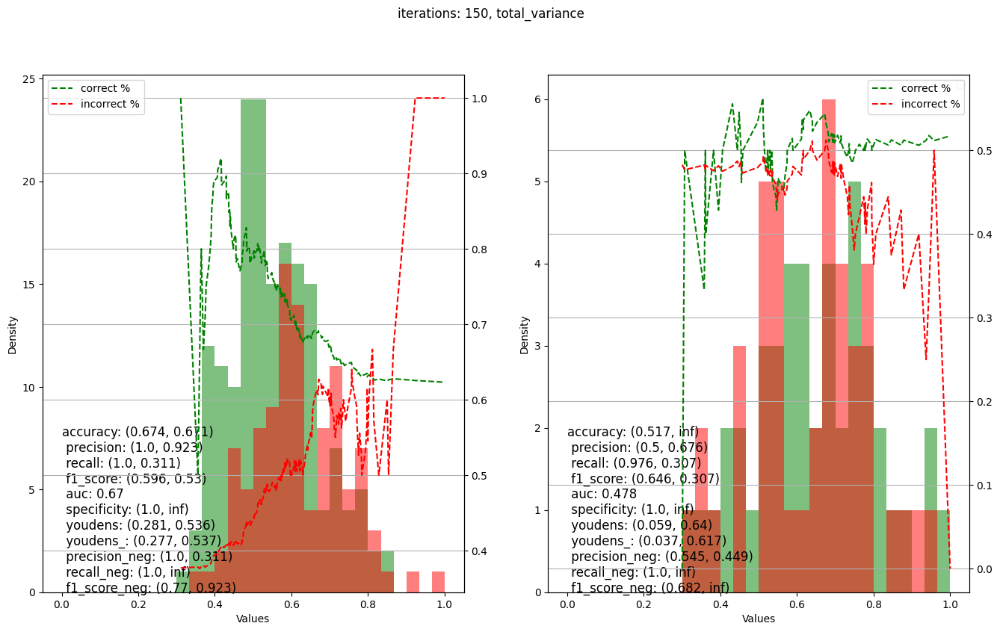

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


recall_neg inf


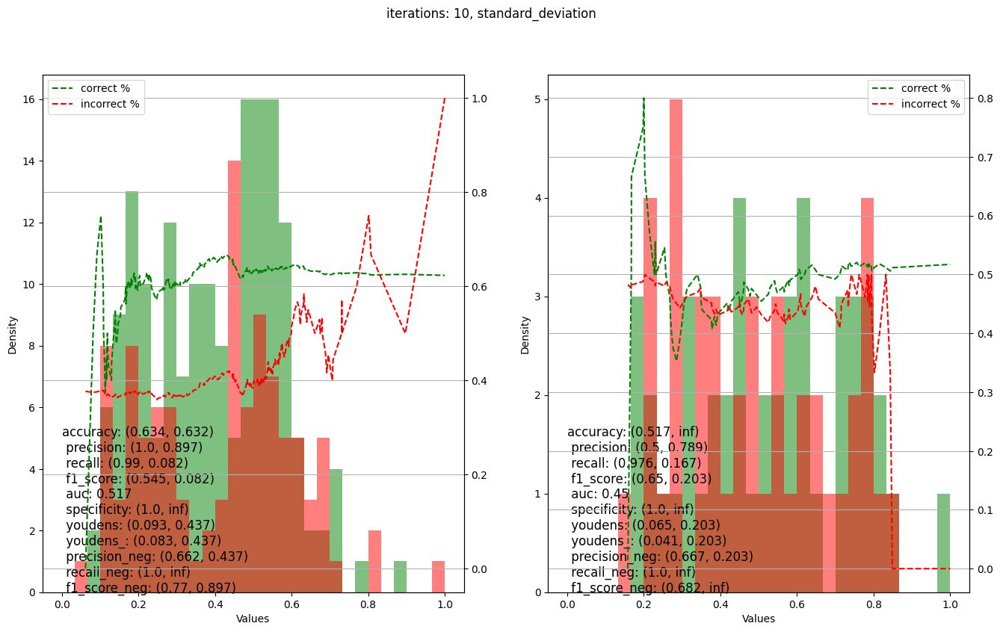

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


f1_score_neg 0.746


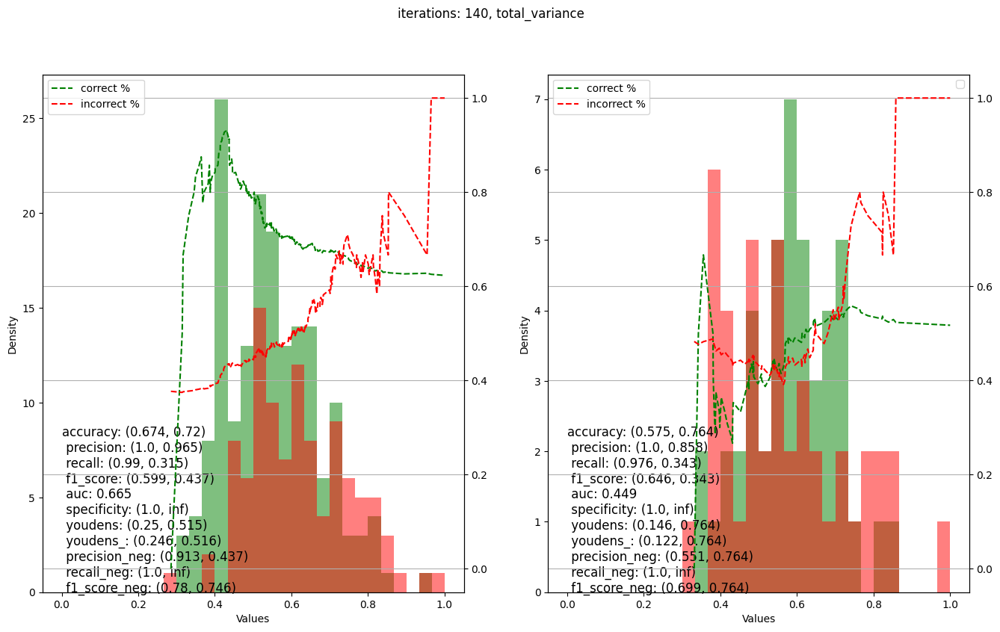

In [28]:
for i in ['accuracy', 'precision', 'recall', 'f1_score', 'auc', 'specificity', 'youdens', 'youdens_',
          'precision_neg', 'recall_neg', 'f1_score_neg']:
    print(i, scores.sort_values(i, ascending=False).iloc[0].loc[f'{i}_thrs'])
    fun = funs[scores.sort_values(i, ascending=False).iloc[0].fun]
    j = scores.sort_values(i, ascending=False).iloc[0].j
    cor = np.apply_along_axis(fun, 1, pred_cor[j])
    mis = np.apply_along_axis(fun, 1, pred_mis[j])
    cor_attikon = np.apply_along_axis(fun, 1, pred_cor_attikon[j])
    mis_attikon = np.apply_along_axis(fun, 1, pred_mis_attikon[j])
    cor, mis = cor/max(cor.max(), mis.max()), mis/max(cor.max(), mis.max())
    cor_attikon, mis_attikon = cor_attikon/max(cor_attikon.max(), mis_attikon.max()), mis_attikon/max(cor_attikon.max(), mis_attikon.max())
    
    fig, ax = plt.subplots(1,2, figsize=(16, 9))
    ax[0].hist(cor, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
    ax[0].hist(mis, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
    plt.legend()
    a = ax[0].twinx()
    a.plot(np.unique(np.concatenate([cor, mis])), [((cor<=t)*1).sum()/(((cor<=t)*1).sum() + ((mis<=t)*1).sum()) for t in np.unique(np.concatenate([cor, mis]))], 'g--', label="correct %")
    a.plot(np.unique(np.concatenate([cor, mis])), [((mis>=t)*1).sum()/(((cor>=t)*1).sum() + ((mis>=t)*1).sum()) for t in np.unique(np.concatenate([cor, mis]))], 'r--', label="incorrect %")
    a.grid(which='both')
    plt.legend()
    
    # Customize the plot
    ax[0].set_xlabel("Values")
    ax[0].set_ylabel("Density")
    # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
    ax[1].hist(cor_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
    ax[1].hist(mis_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
    plt.legend()
    a = ax[1].twinx()
    a.plot(np.unique(np.concatenate([cor_attikon, mis_attikon])), [((cor_attikon<=t)*1).sum()/(((cor_attikon<=t)*1).sum() + ((mis_attikon<=t)*1).sum()) for t in np.unique(np.concatenate([cor_attikon, mis_attikon]))], 'g--', label="correct %")
    a.plot(np.unique(np.concatenate([cor_attikon, mis_attikon])), [((mis_attikon>=t)*1).sum()/(((cor_attikon>=t)*1).sum() + ((mis_attikon>=t)*1).sum()) for t in np.unique(np.concatenate([cor_attikon, mis_attikon]))], 'r--', label="incorrect %")
    a.grid(which='both')
    plt.legend()
    
    # Customize the plot
    ax[1].set_xlabel("Values")
    ax[1].set_ylabel("Density")
    fig.suptitle(f'iterations: {j}, {fun.__name__}')
    eval_results = evaluate(np.concatenate([np.zeros_like(cor), np.ones_like(mis)]), np.concatenate([cor, mis]))
    ax[0].text(0, 0, ' \n '.join([f"{met}: {val}" for met,val in eval_results.items()]), fontsize=12, color='black')
    eval_results = evaluate(np.concatenate([np.zeros_like(cor_attikon), np.ones_like(mis_attikon)]), np.concatenate([cor_attikon, mis_attikon]))
    ax[1].text(0, 0, ' \n '.join([f"{met}: {val}" for met,val in eval_results.items()]), fontsize=12, color='black')
    plt.show()

In [29]:
for i in ['youdens', 'youdens_']:
    print(i, scores.sort_values(i, ascending=False).iloc[0].loc[[i, 'j', 'fun', f'{i}_thrs']])

youdens youdens                      0.313
j                              130
fun             standard_deviation
youdens_thrs                 0.756
Name: 120, dtype: object
youdens_ youdens_                  0.303
j                           130
fun              total_variance
youdens__thrs             0.599
Name: 128, dtype: object


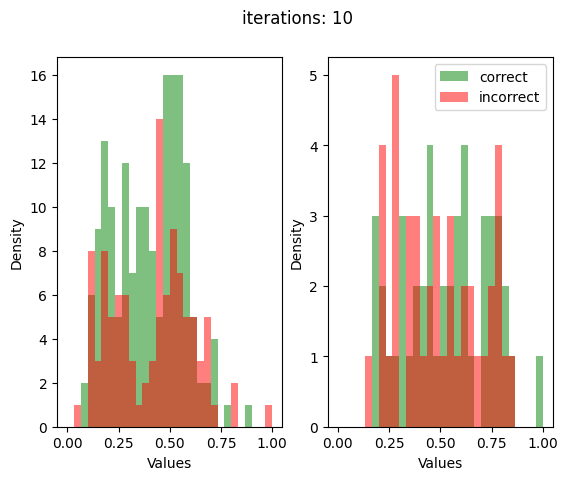

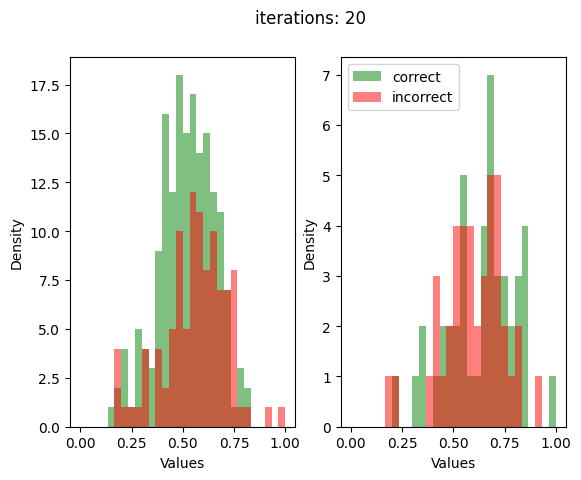

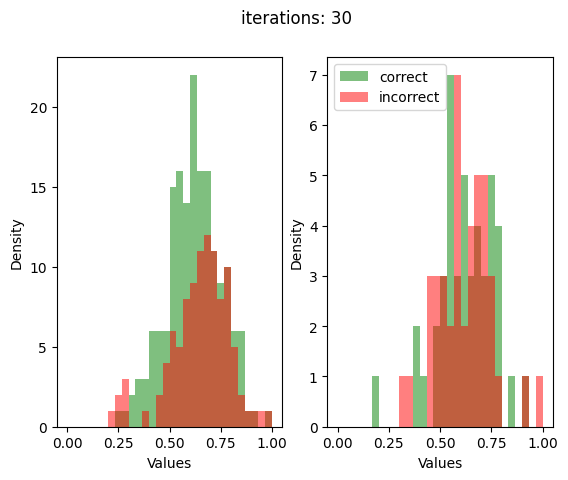

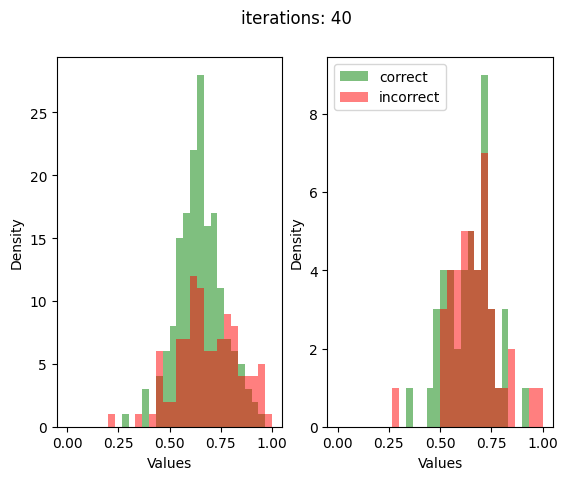

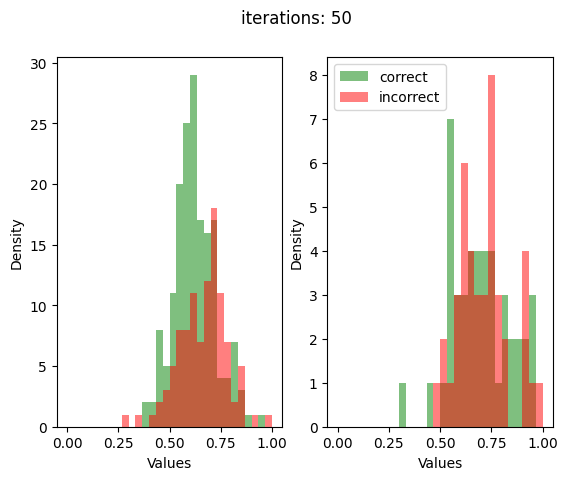

...

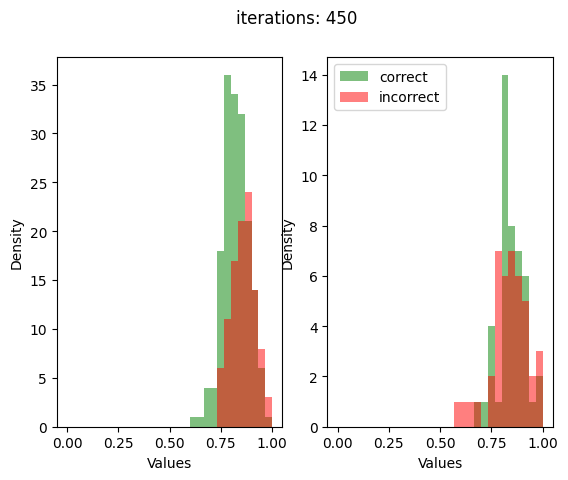

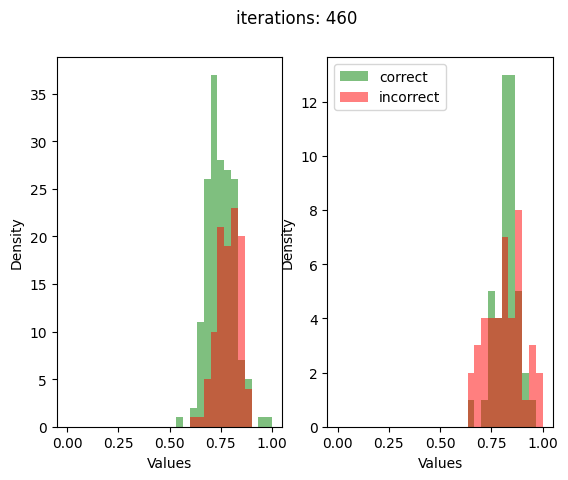

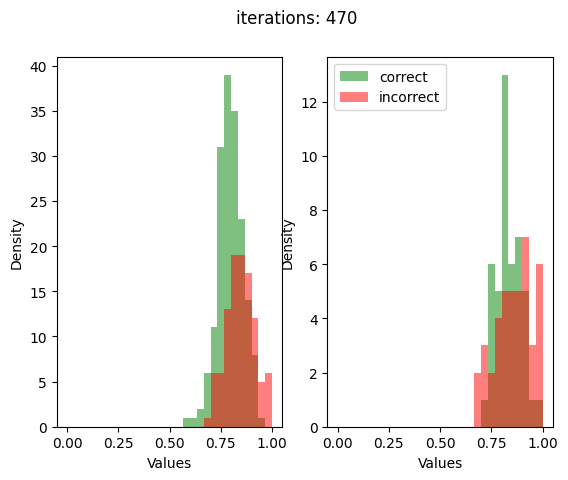

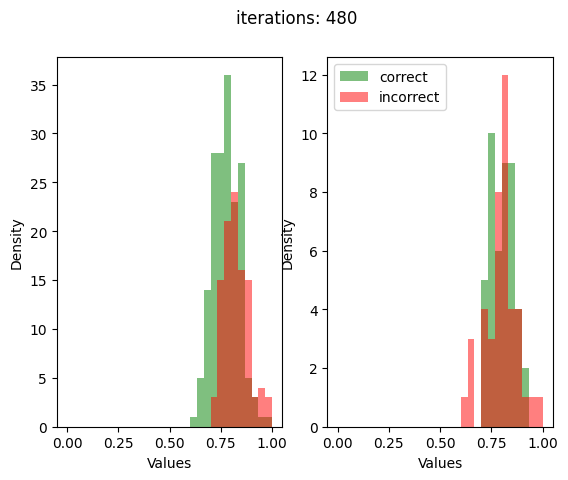

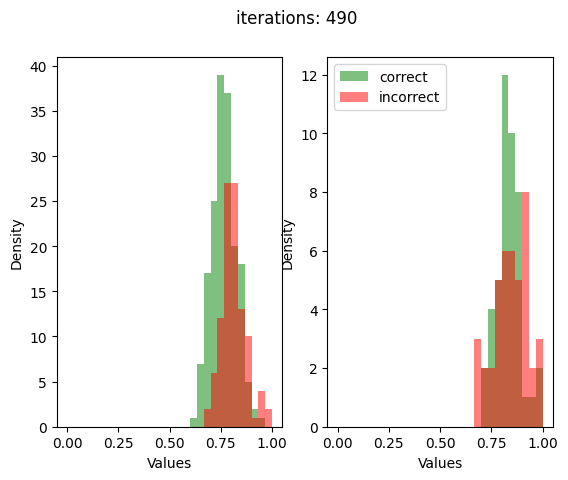

In [12]:
for j in range(10, 500, 10):
    pred = np.zeros((len(X_test) + len(X_attikon), j))
    # model = create_dropout_model(neurons=[1024, 256], dropout_rate=(0.05 + dr*0.05), lr=0.001, kreg=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3), breg=None, model=model, summary=False)
    for i in range(j):
        pred[:,i] = model(np.vstack([X_test, X_attikon]), training=True).numpy()[:, 1]
    
    pred, pred_attikon = pred[:-len(carotid_df)], pred[-len(carotid_df):]
    pred = pred.std(axis=1)/(pred.std(axis=1).max())
    pred_cor = pred[(y_test==y_pred_labels)]
    pred_mis = pred[(y_test!=y_pred_labels)]
    
    pred_attikon = pred_attikon.std(axis=1)/(pred_attikon.std(axis=1).max())
    pred_cor_attikon = pred_attikon[(carotid_df.risk.values==y_pred_labels_attikon)]
    pred_mis_attikon = pred_attikon[(carotid_df.risk.values!=y_pred_labels_attikon)]
    
    fig, ax = plt.subplots(1,2)
    # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
    ax[0].hist(pred_cor, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
    ax[0].hist(pred_mis, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
    
    # Customize the plot
    ax[0].set_xlabel("Values")
    ax[0].set_ylabel("Density")
    # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
    ax[1].hist(pred_cor_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
    ax[1].hist(pred_mis_attikon, density=False, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
    
    # Customize the plot
    ax[1].set_xlabel("Values")
    ax[1].set_ylabel("Density")
    fig.suptitle(f'iterations: {j}')
    plt.legend()
    plt.show()

  0%|                                                                                                                                                                    | 0/12 [00:00<?, ?it/s]

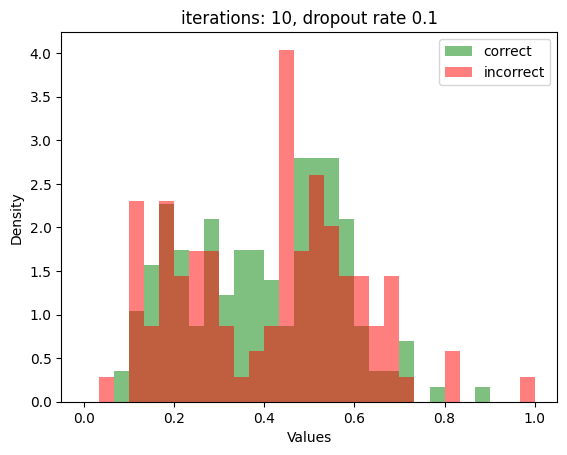

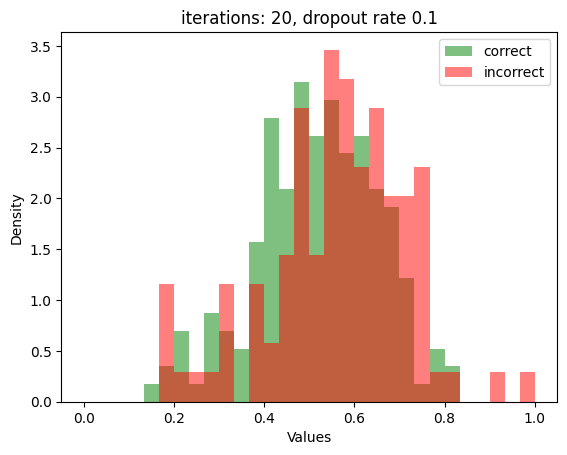

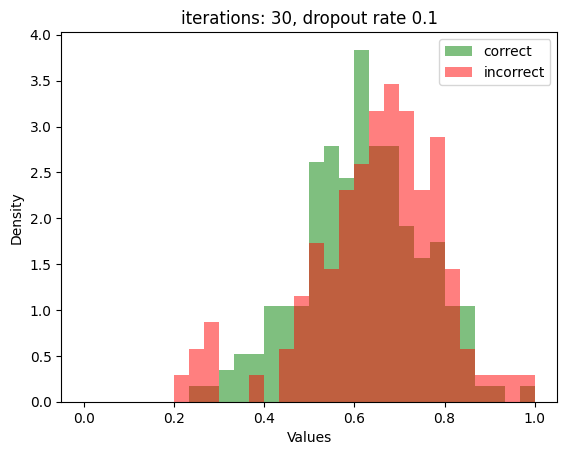

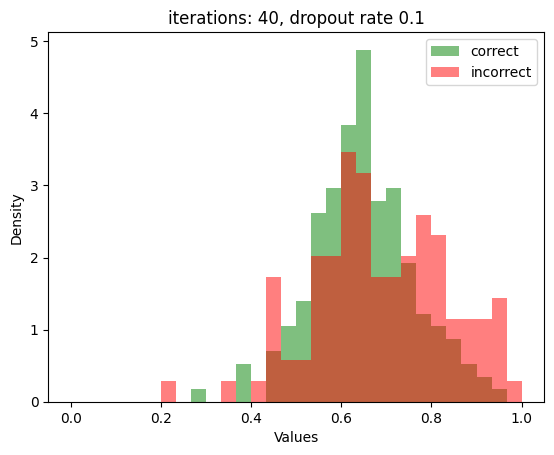

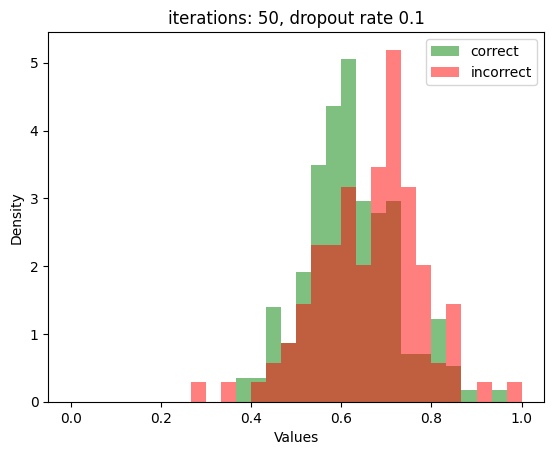

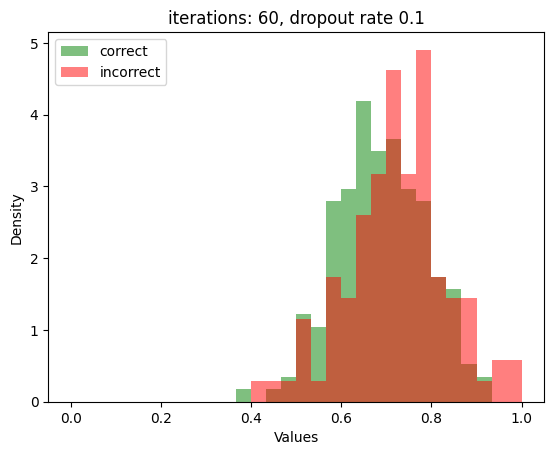

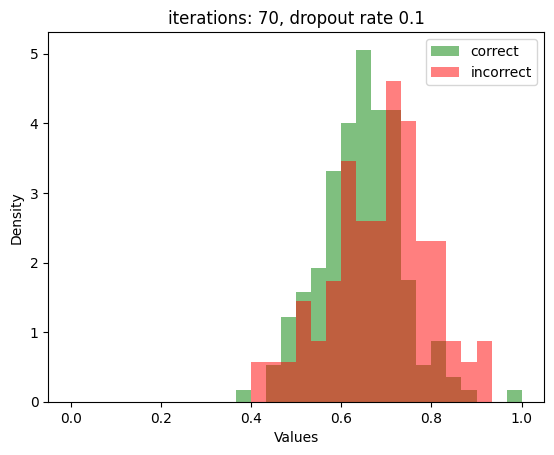

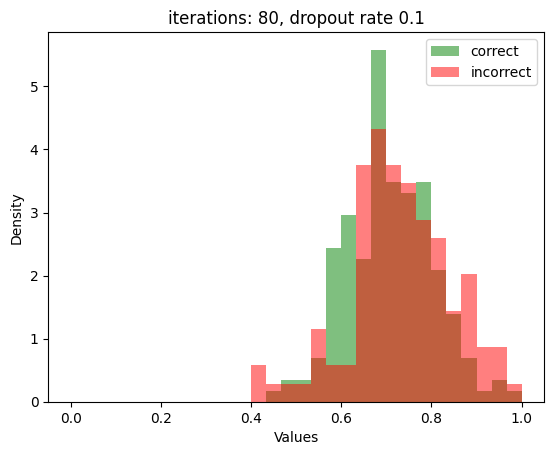

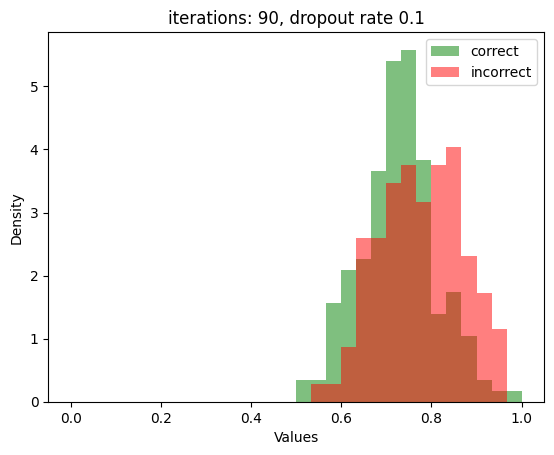

  8%|█████████████                                                                                                                                               | 1/12 [00:10<01:56, 10.57s/it]

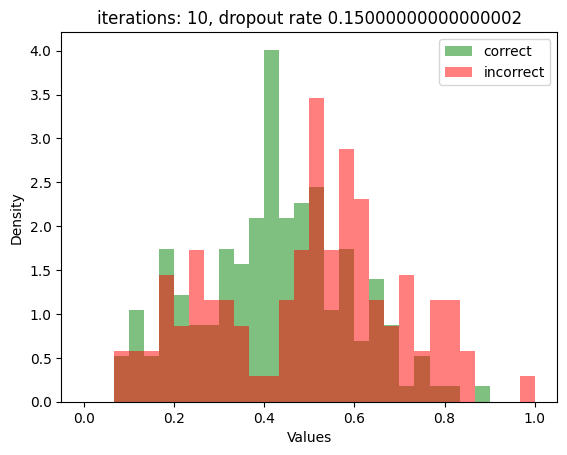

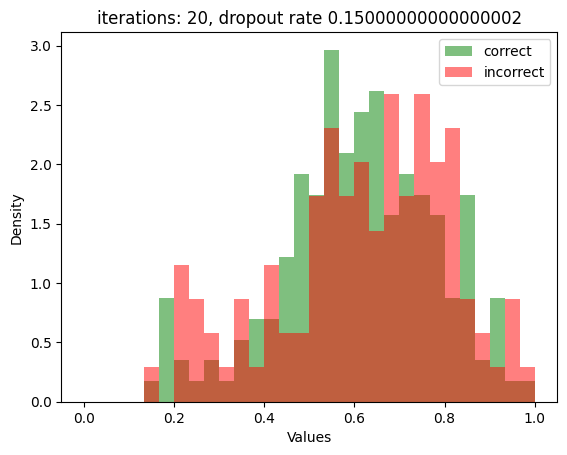

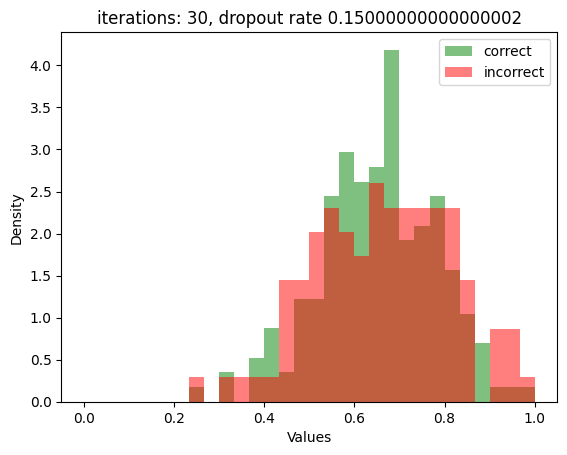

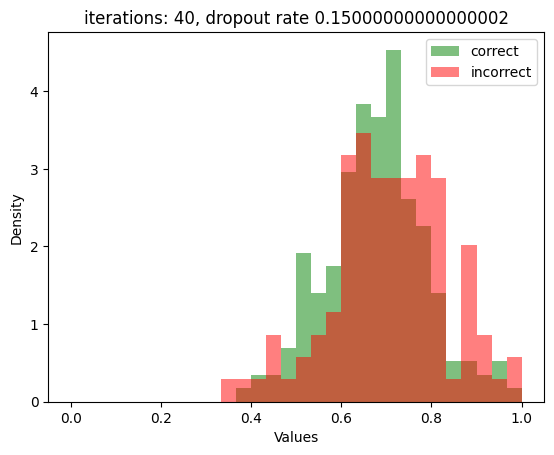

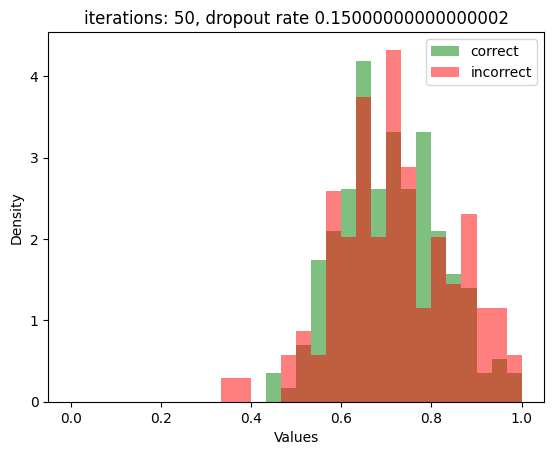

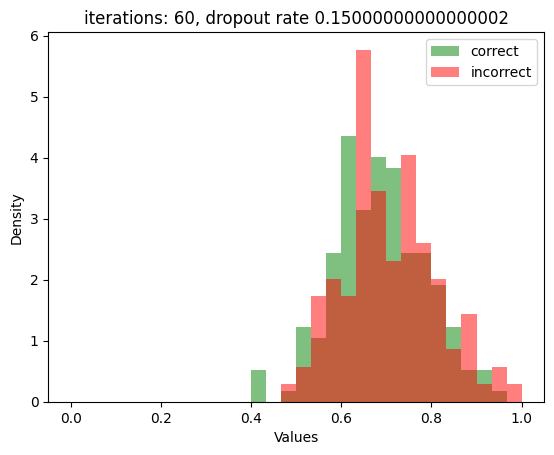

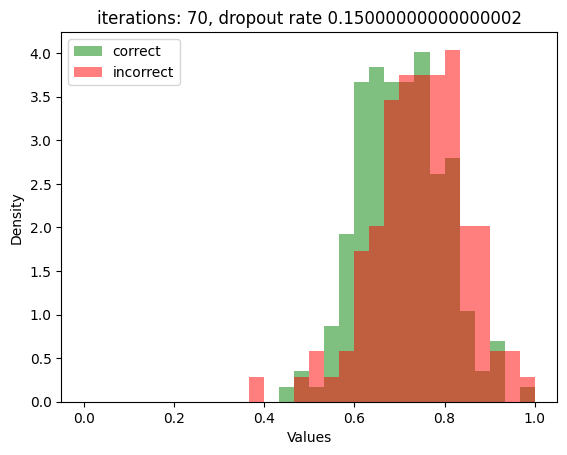

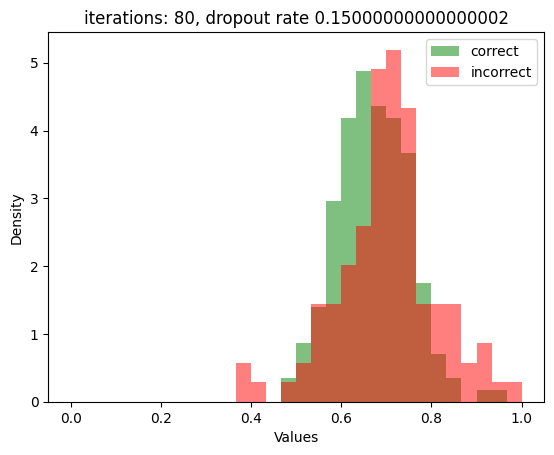

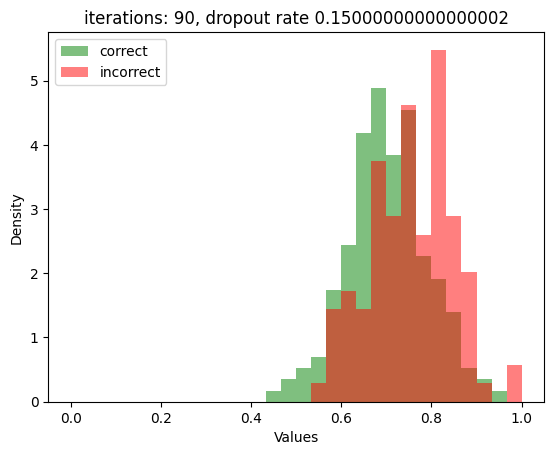

 17%|██████████████████████████                                                                                                                                  | 2/12 [00:20<01:42, 10.29s/it]

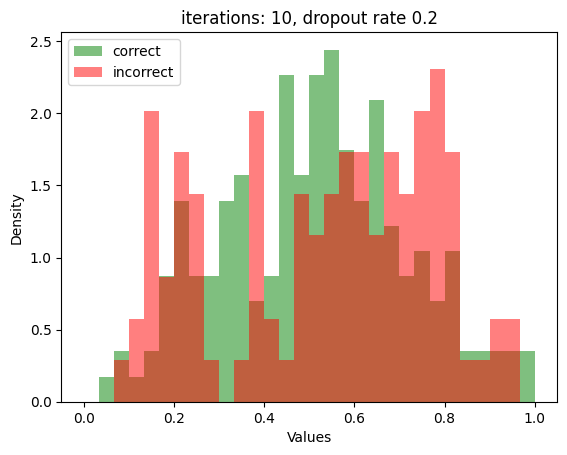

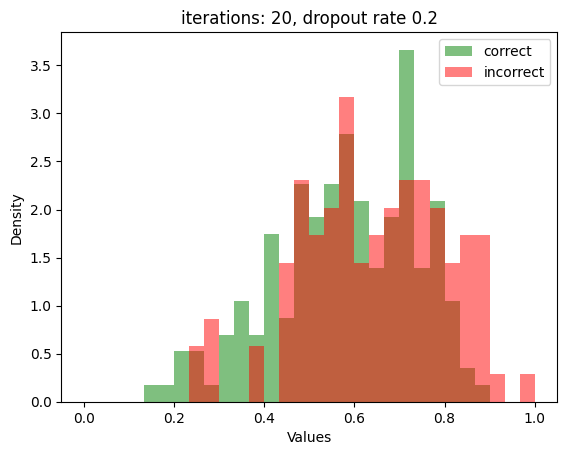

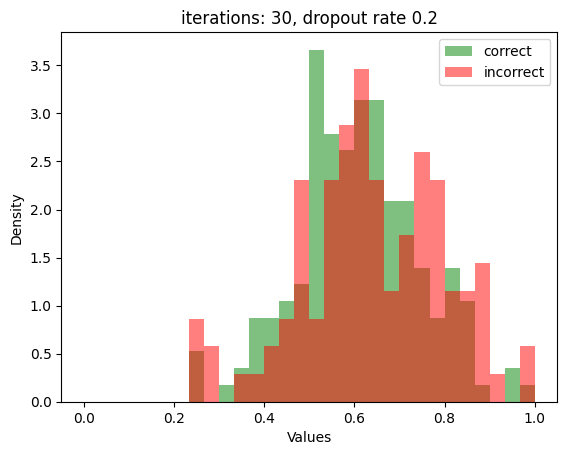

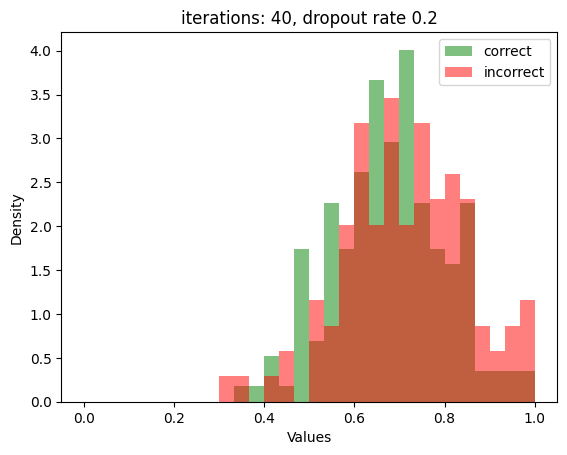

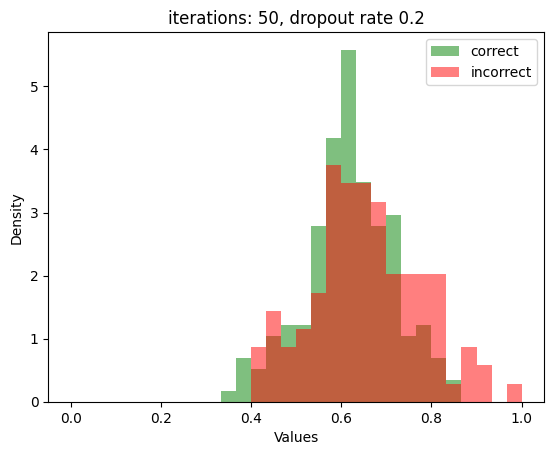

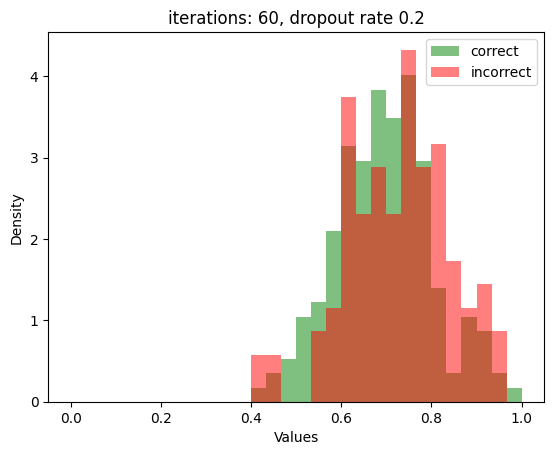

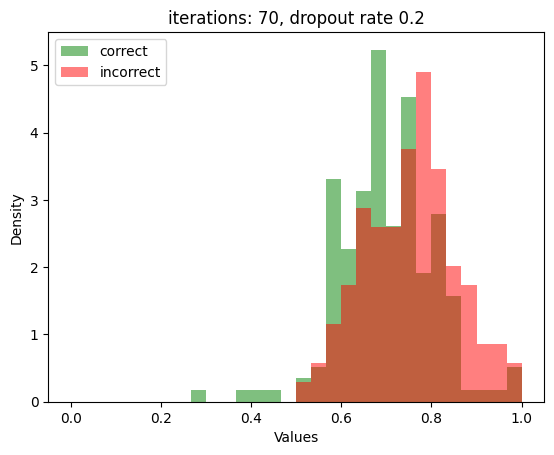

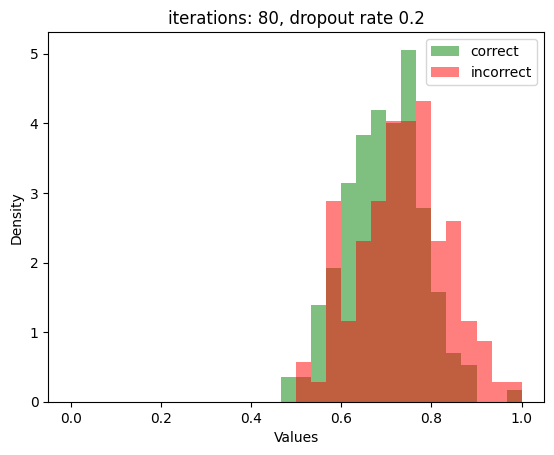

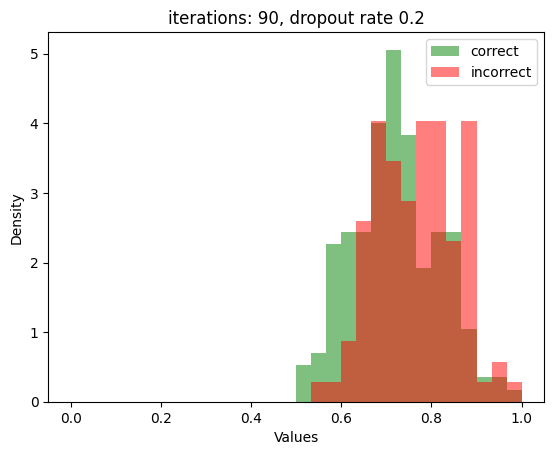

 25%|███████████████████████████████████████                                                                                                                     | 3/12 [00:31<01:34, 10.48s/it]

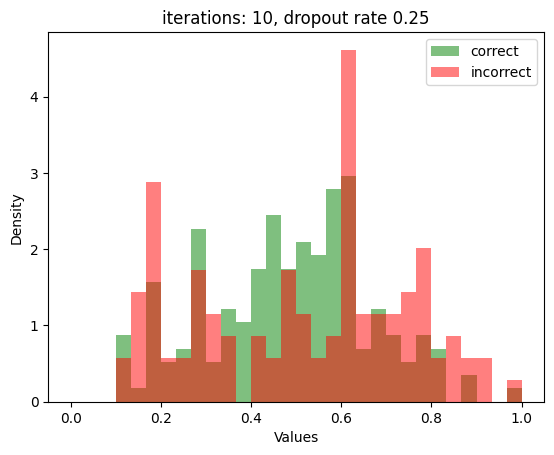

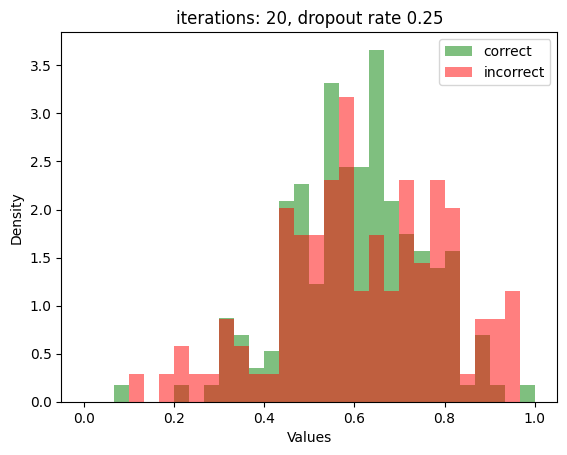

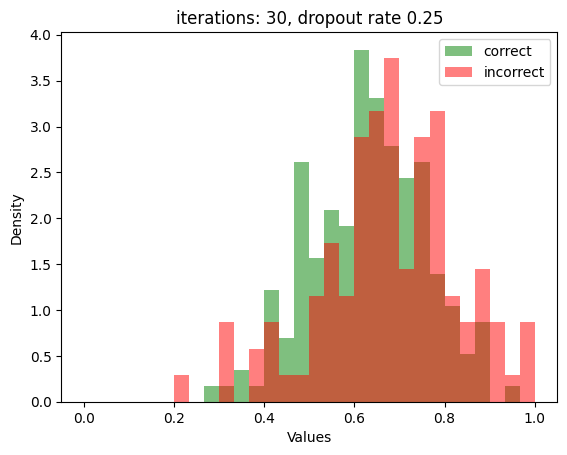

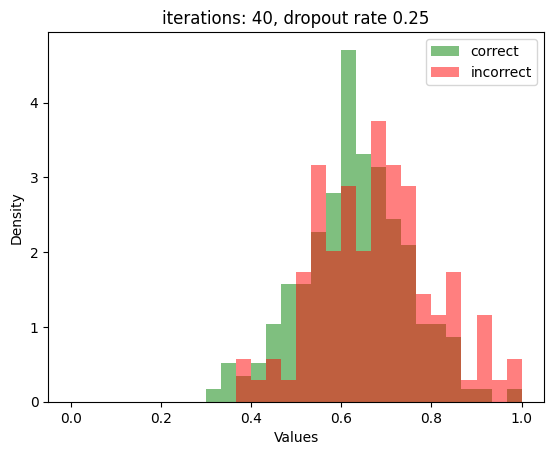

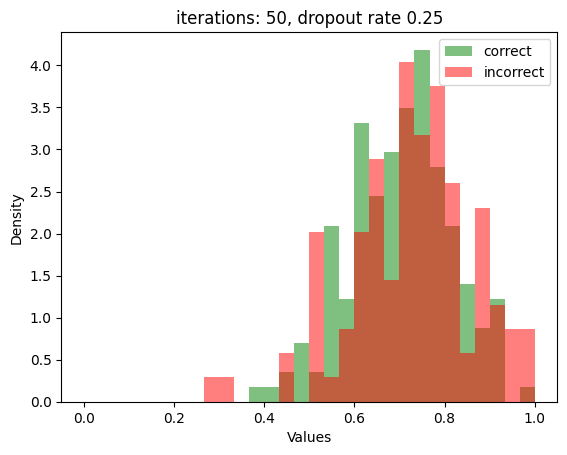

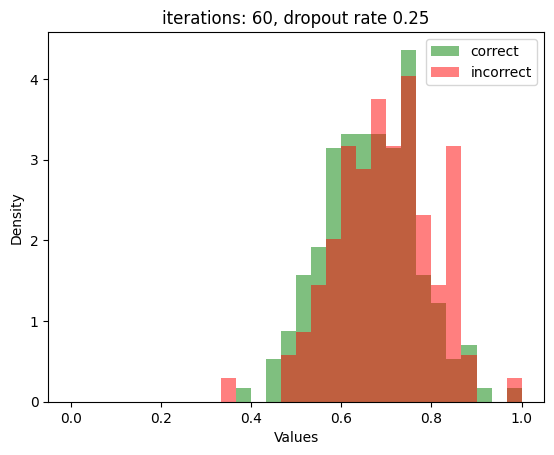

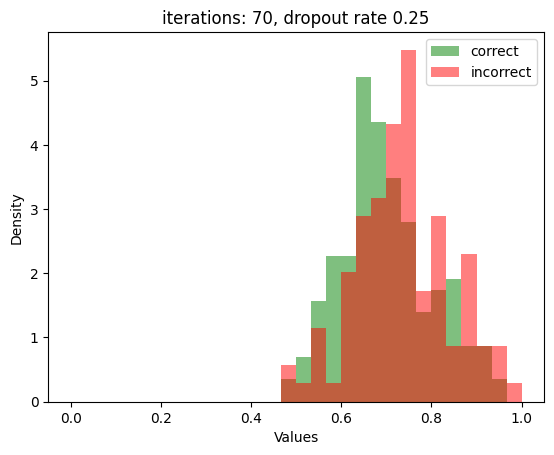

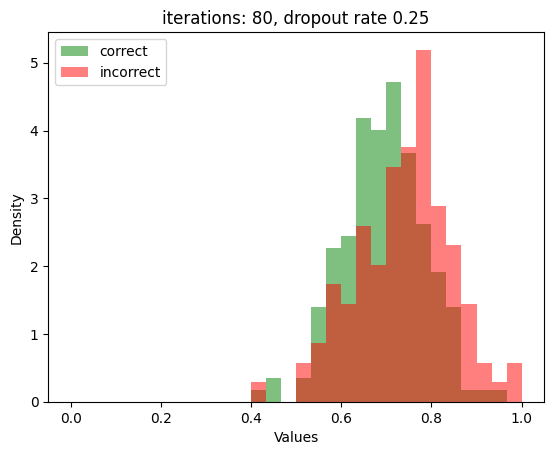

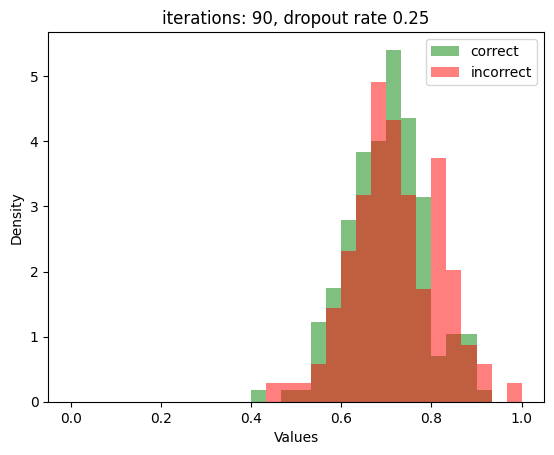

 33%|████████████████████████████████████████████████████                                                                                                        | 4/12 [00:41<01:22, 10.27s/it]

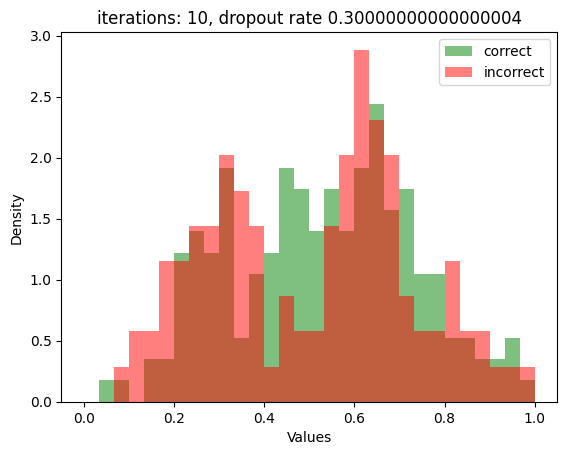

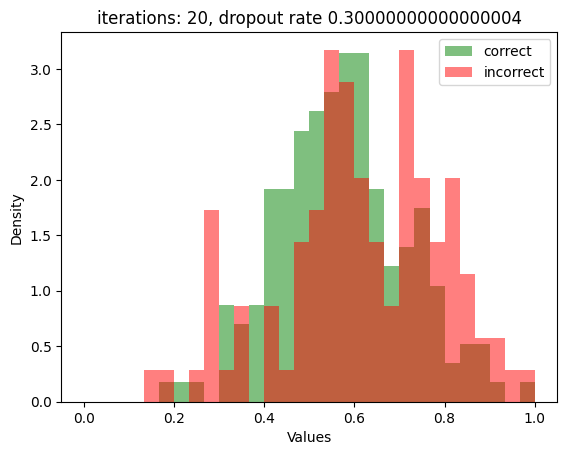

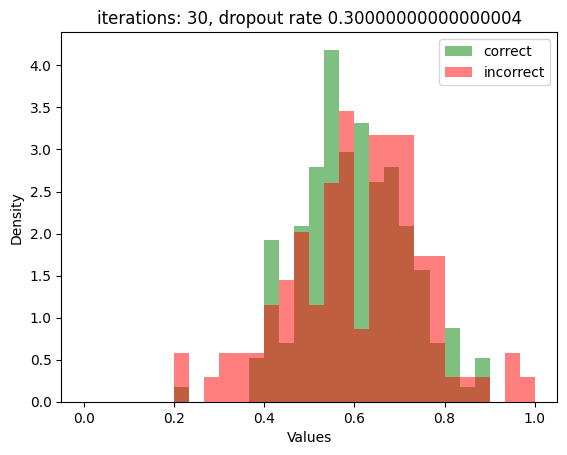

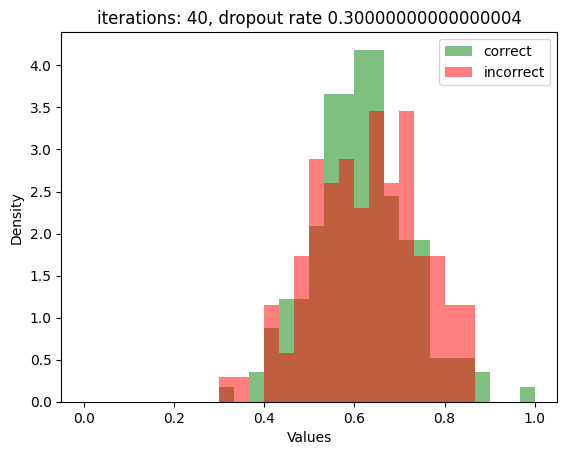

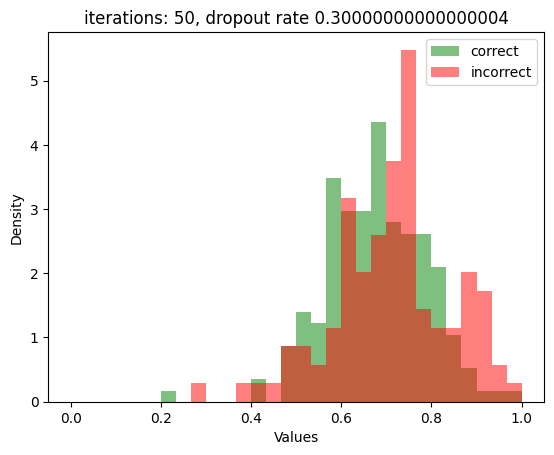

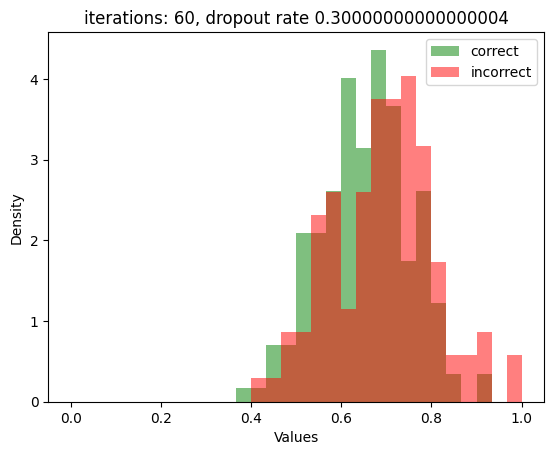

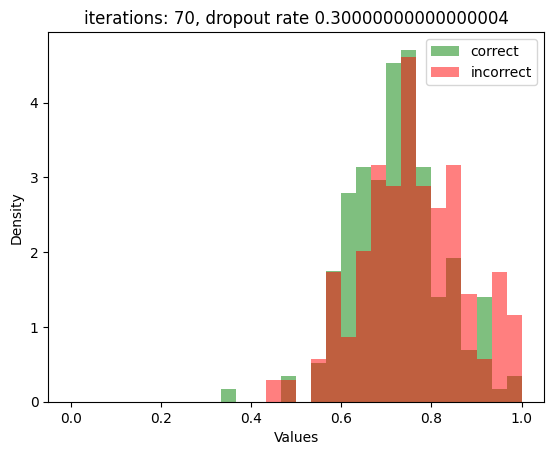

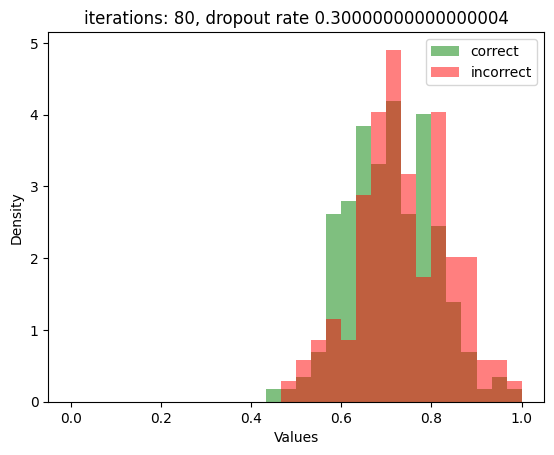

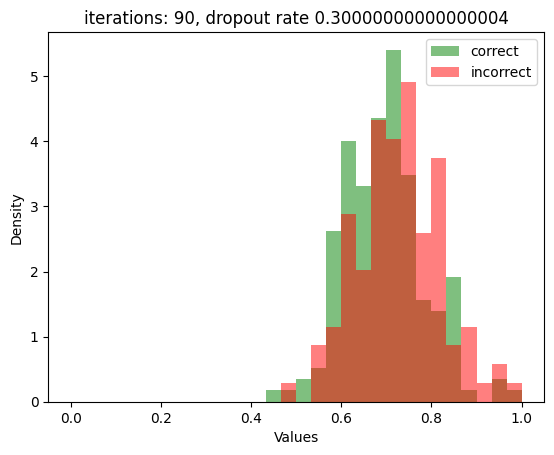

 42%|█████████████████████████████████████████████████████████████████                                                                                           | 5/12 [00:51<01:12, 10.42s/it]

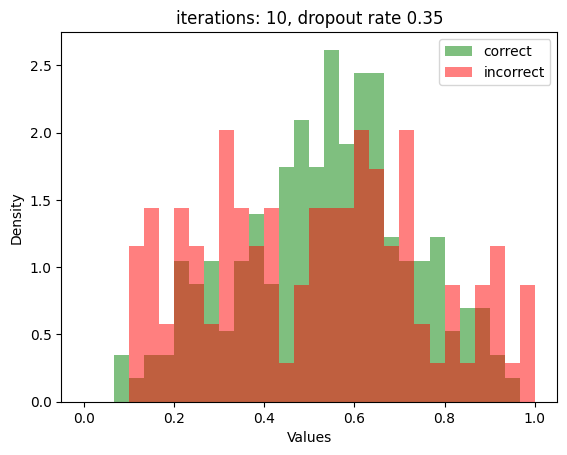

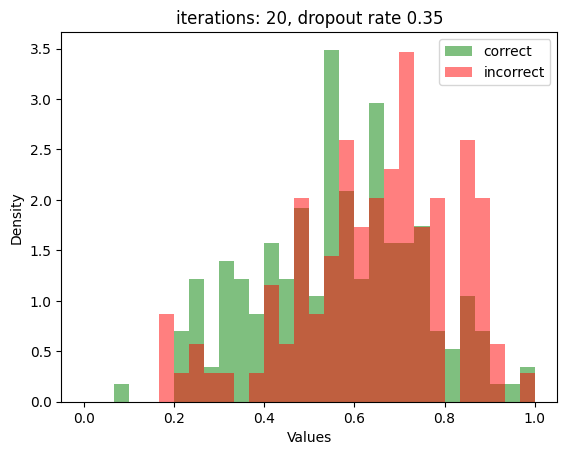

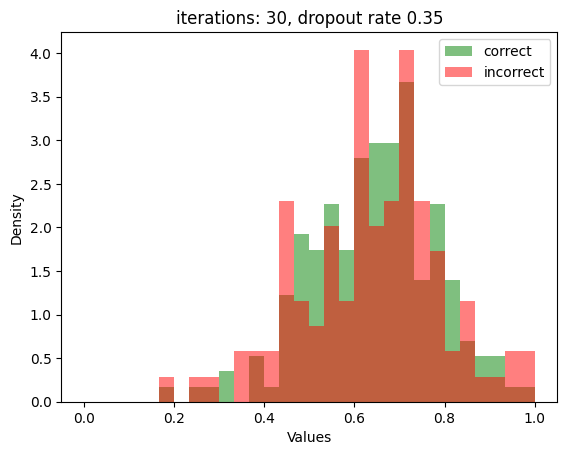

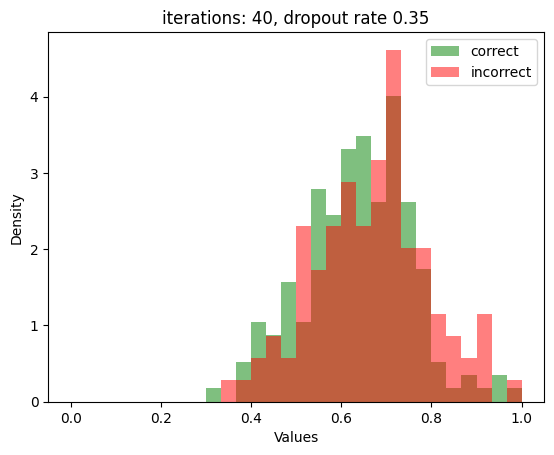

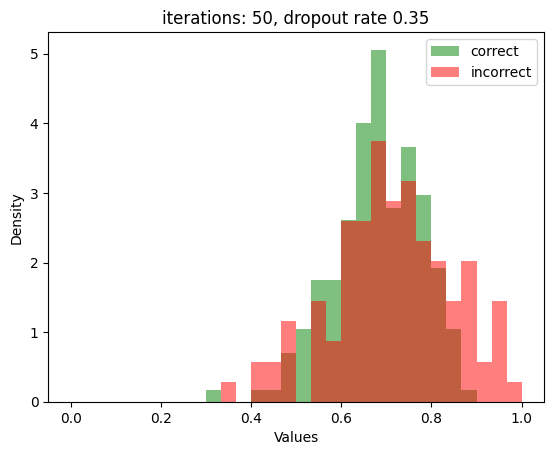

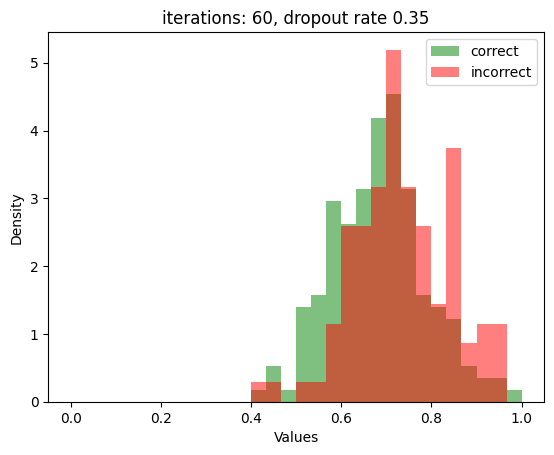

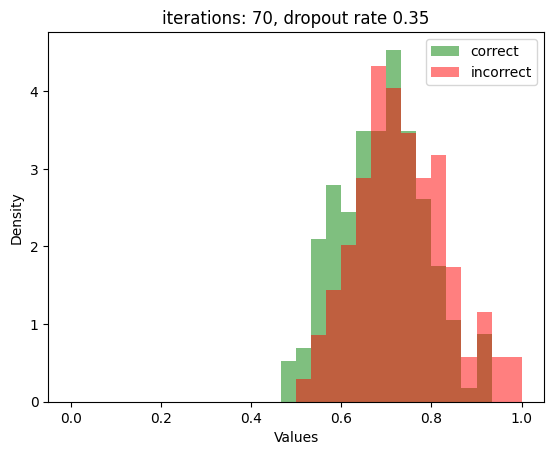

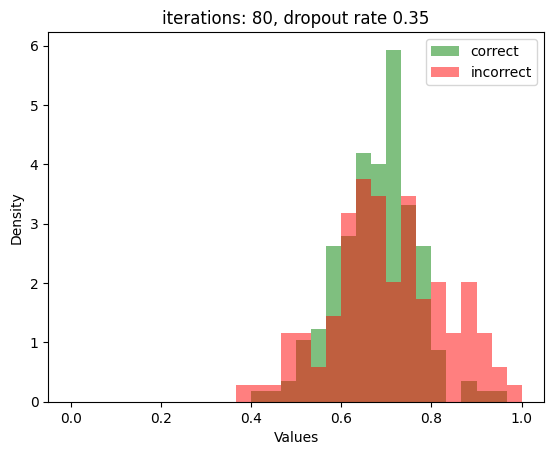

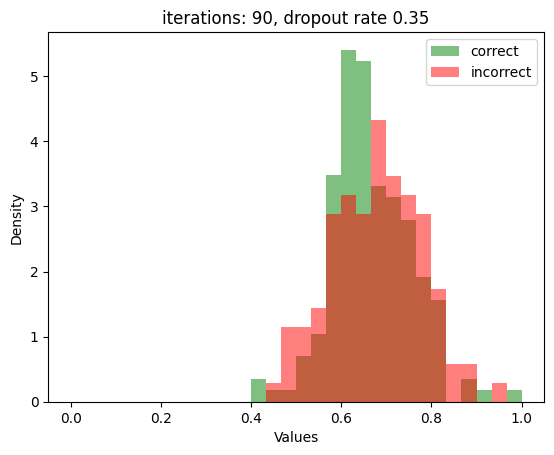

 50%|██████████████████████████████████████████████████████████████████████████████                                                                              | 6/12 [01:01<01:01, 10.26s/it]

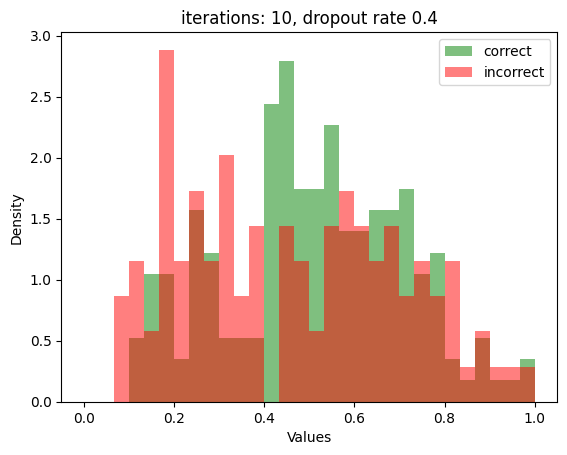

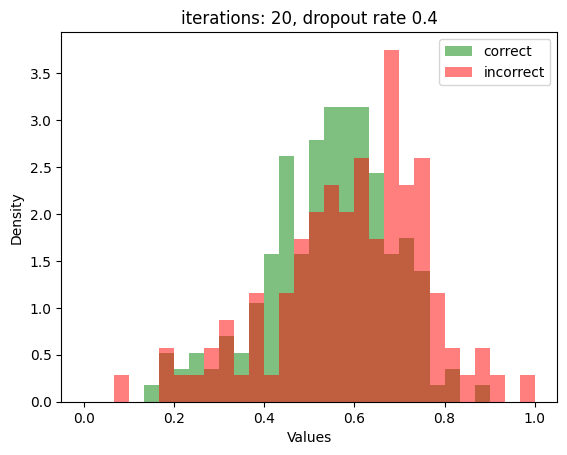

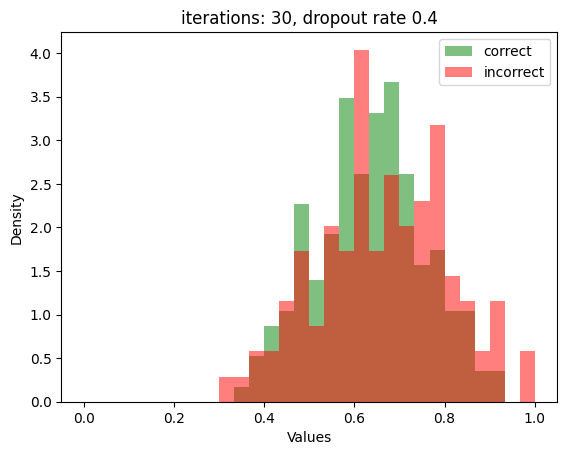

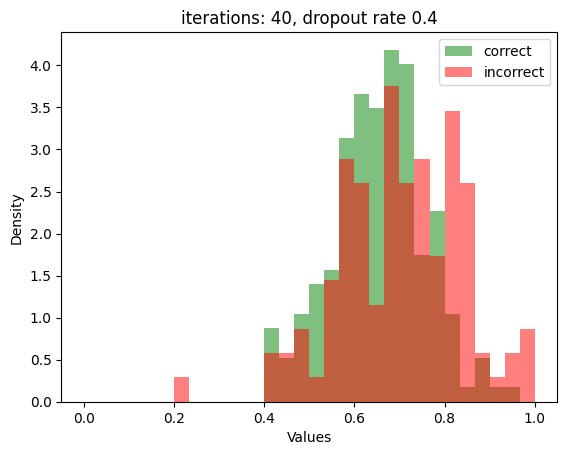

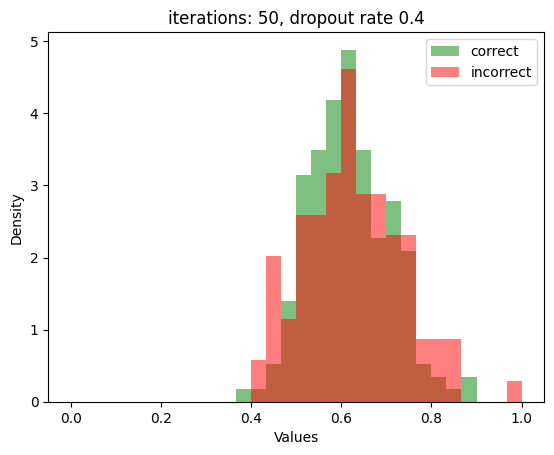

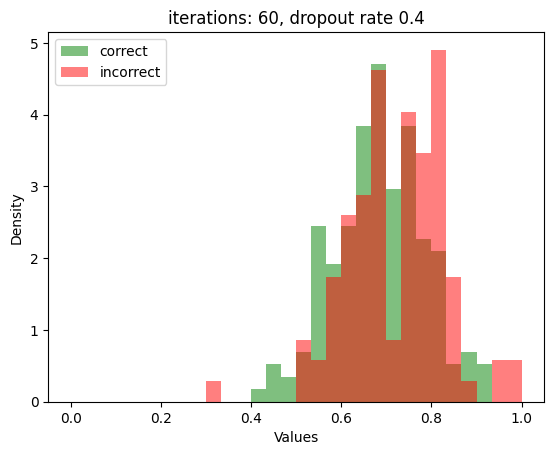

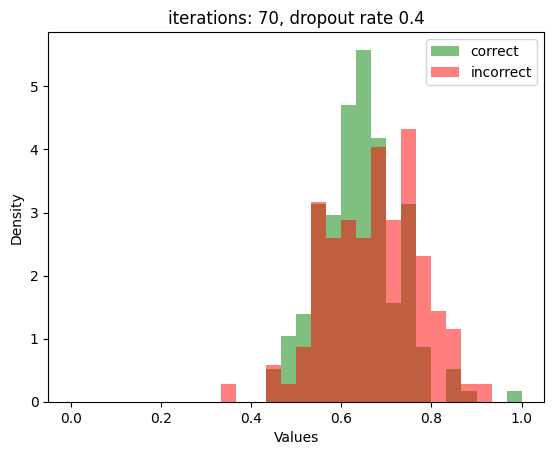

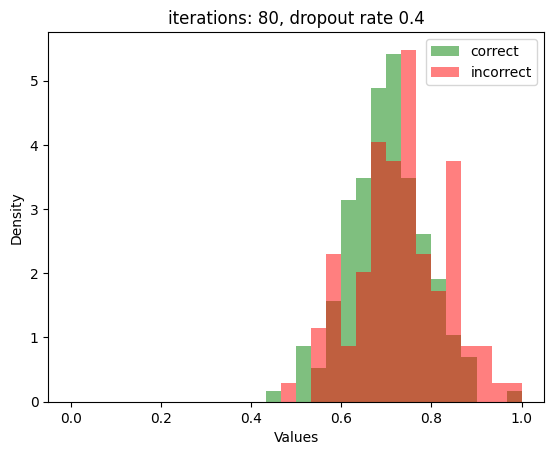

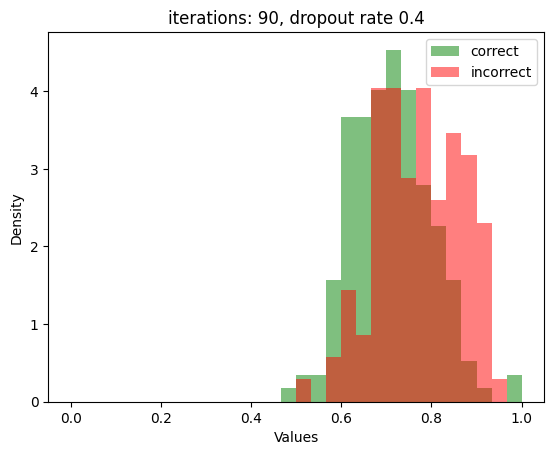

 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                 | 7/12 [01:12<00:51, 10.32s/it]

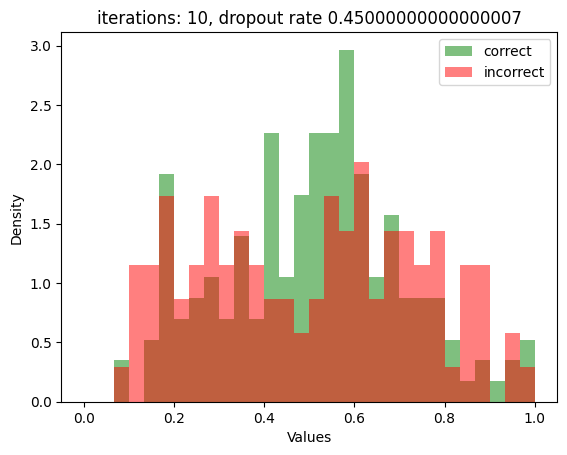

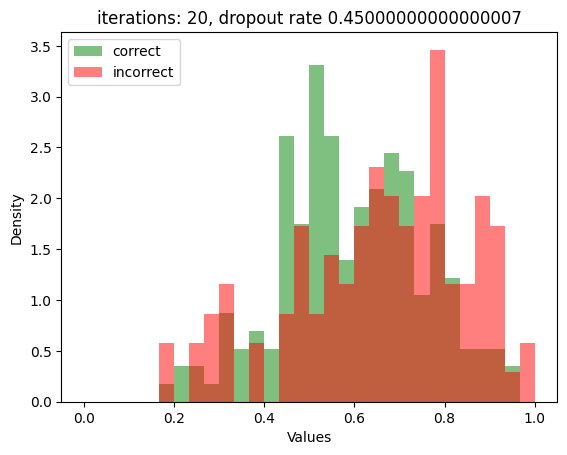

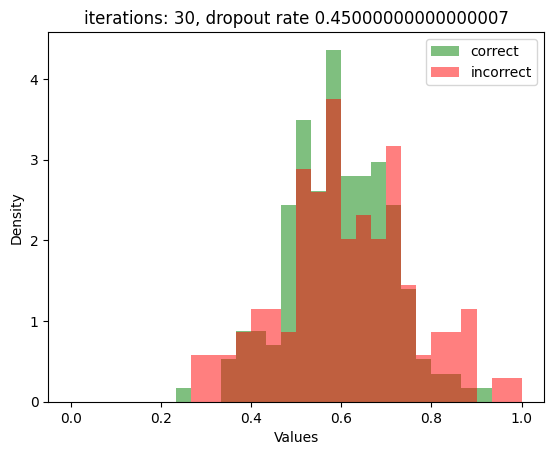

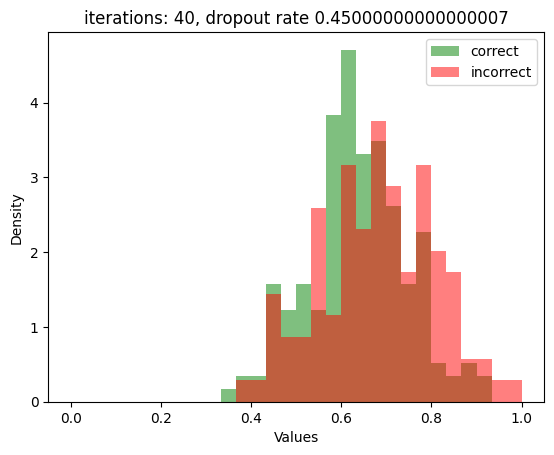

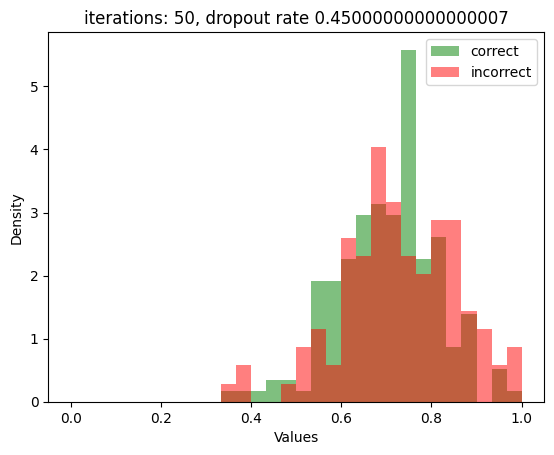

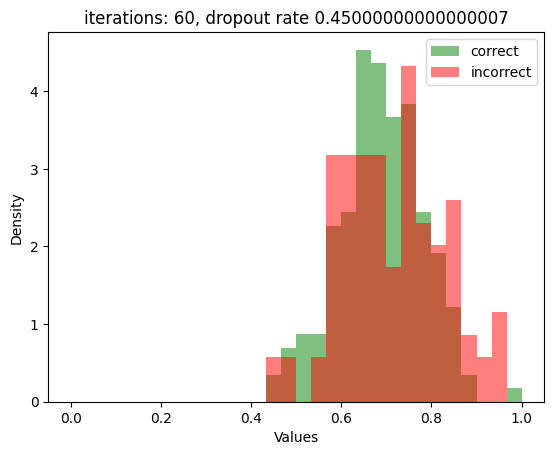

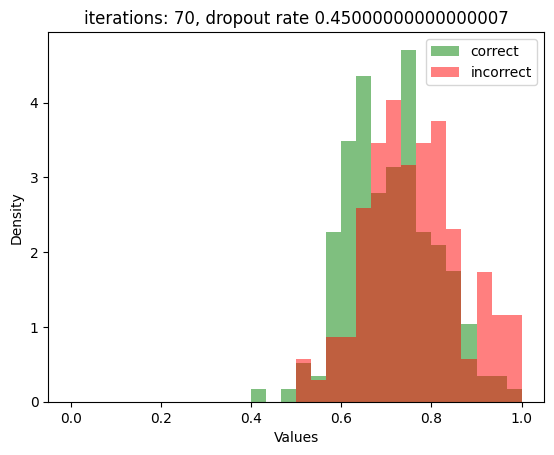

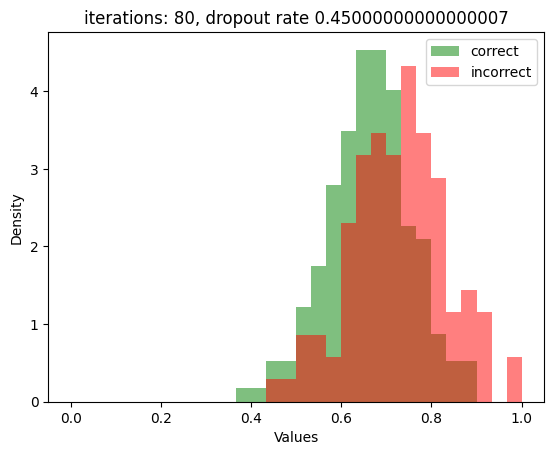

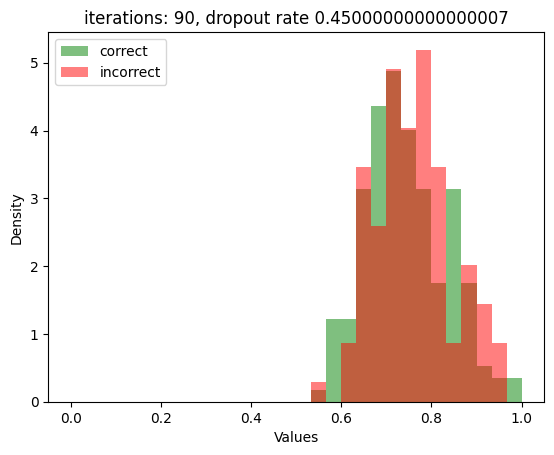

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 8/12 [01:22<00:40, 10.22s/it]

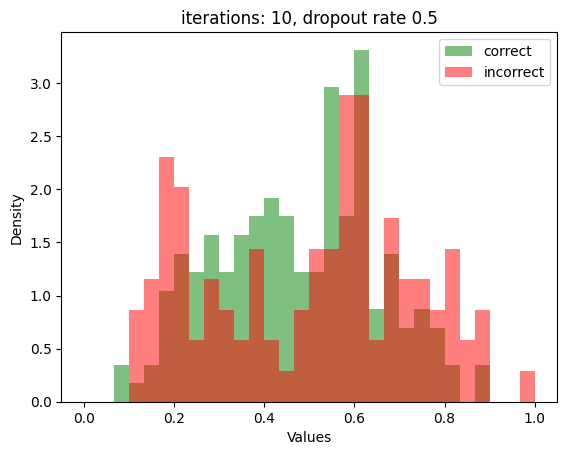

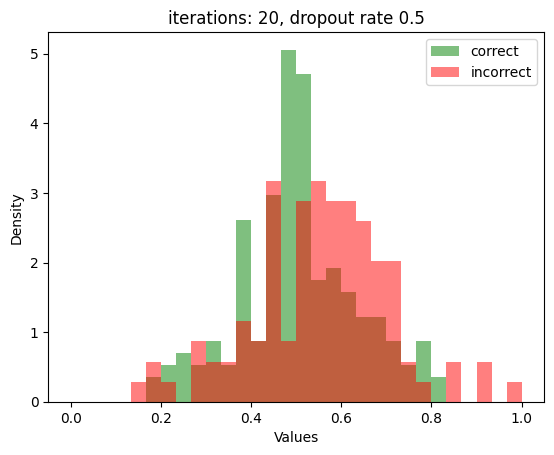

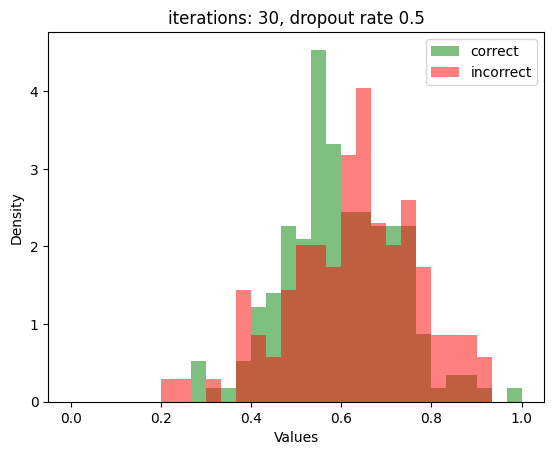

In [ ]:
for dr in tqdm(range(12)):
    for j in range(10, 100, 10):
        pred = np.zeros((276, j))
        # model = create_dropout_model(neurons=[1024, 256], dropout_rate=(0.05 + dr*0.05), lr=0.001, kreg=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3), breg=None, model=model, summary=False)
        for i in range(j):
            pred[:,i] = model(X_test, training=True).numpy()[:, 1]
        
        pred = pred.std(axis=1)/(pred.std(axis=1).max())
        pred_cor = pred[(y_test==y_pred_labels)]
        pred_mis = pred[(y_test!=y_pred_labels)]
        plt.figure()
        # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
        plt.hist(pred_cor, density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
        plt.hist(pred_mis, density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
        
        # Customize the plot
        plt.xlabel("Values")
        plt.ylabel("Density")
        plt.title(f'iterations: {j}, dropout rate {(0.1 + dr*0.05)}')
        plt.legend()
        plt.show()

In [9]:
# dropout 0.05
# even more (3,2) regularization, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 0s 3ms/step
Confusion Matrix:
[[161  41]
 [ 39  35]]
Accuracy:  0.7101449275362319
Sensitivity:  0.47297297297297297
Specificity:  0.7970297029702971
Balanced accuracy:  0.635001337971635
ROC AUC:  0.6564757827134066
F1 Score:  0.4666666666666667
AUC under Precision-Recall Curve: 0.4569


In [18]:
y_misclassified = y_test[(y_test!=y_pred_labels)]
y_cor_classified = y_test[(y_test==y_pred_labels)]
X_misclassified = X_test[(y_test!=y_pred_labels)]
X_cor_classified = X_test[(y_test==y_pred_labels)]

  0%|                                                                                                                                                                    | 0/12 [00:00<?, ?it/s]

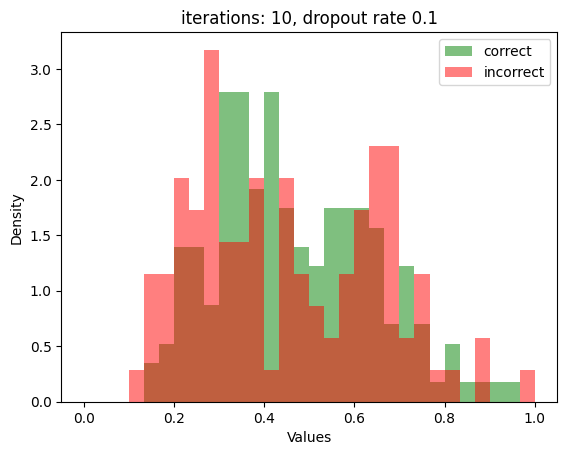

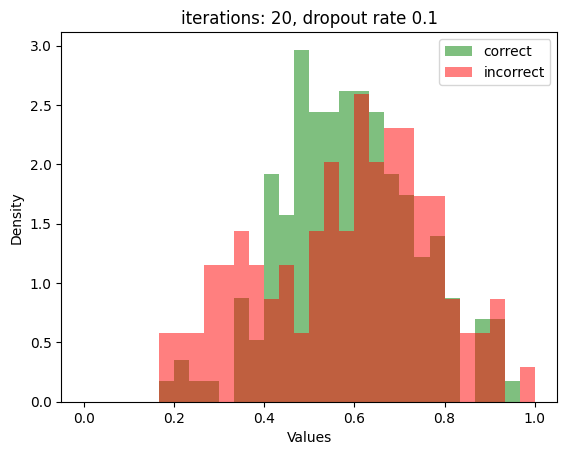

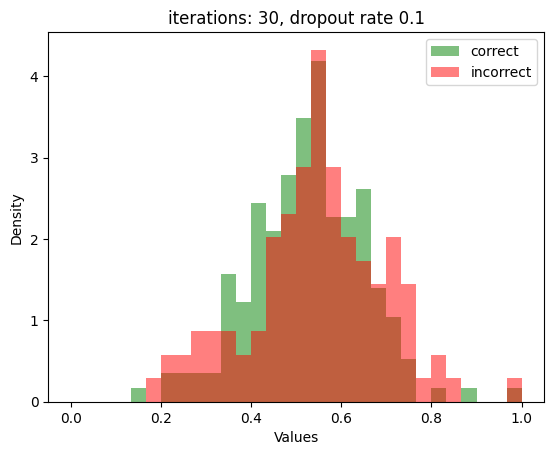

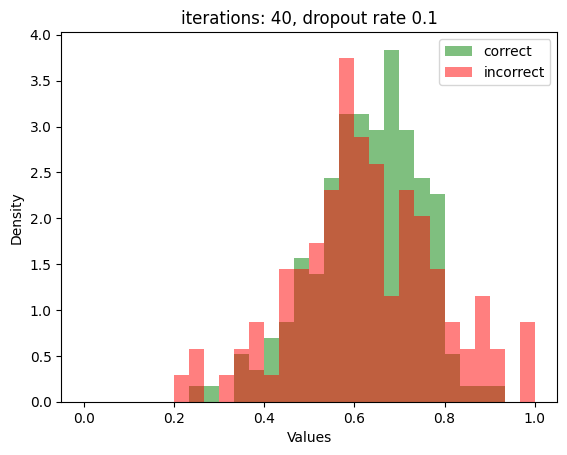

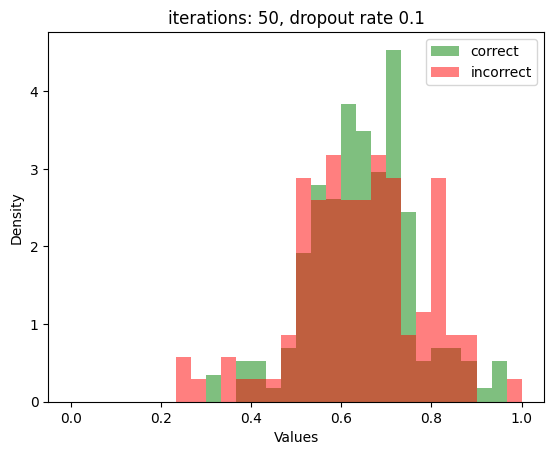

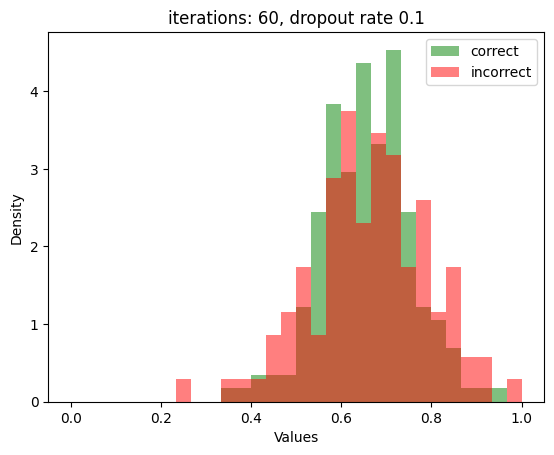

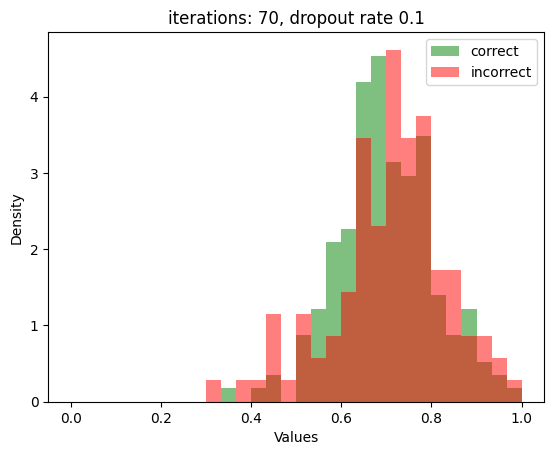

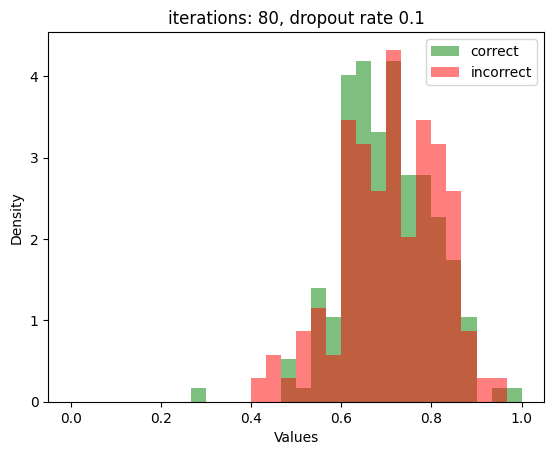

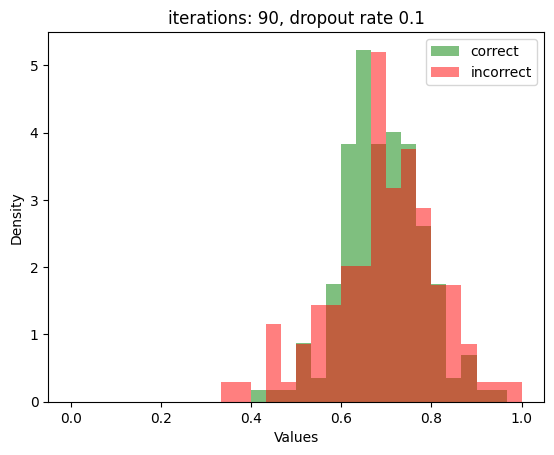

  8%|█████████████                                                                                                                                               | 1/12 [00:14<02:39, 14.53s/it]

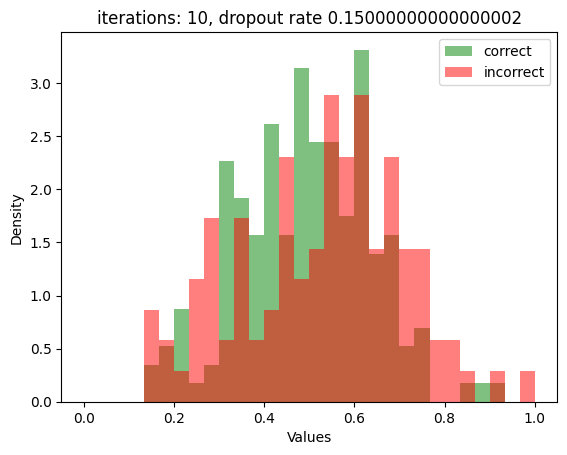

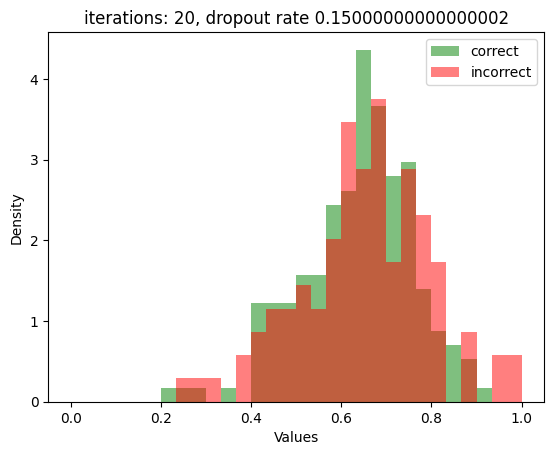

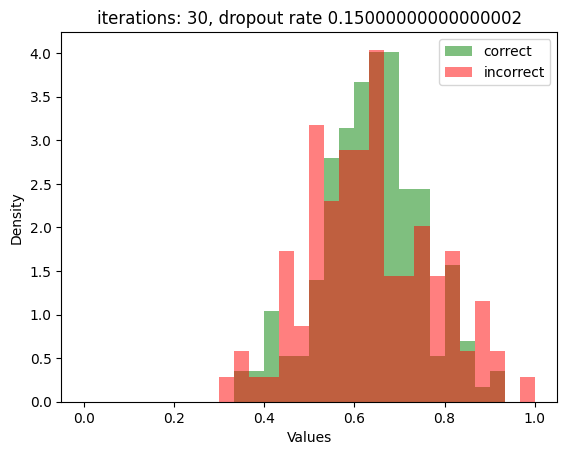

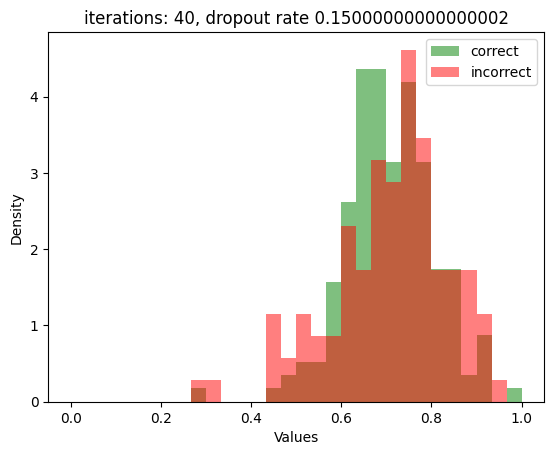

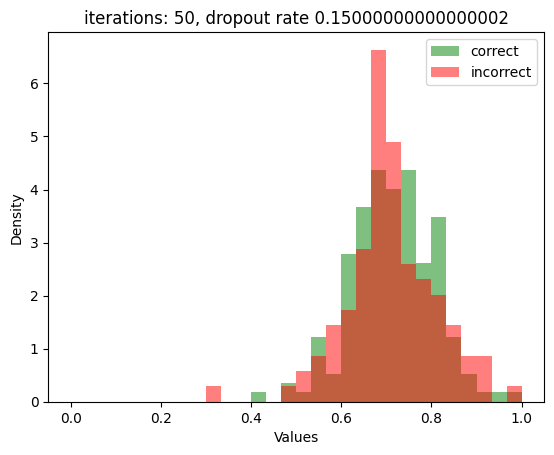

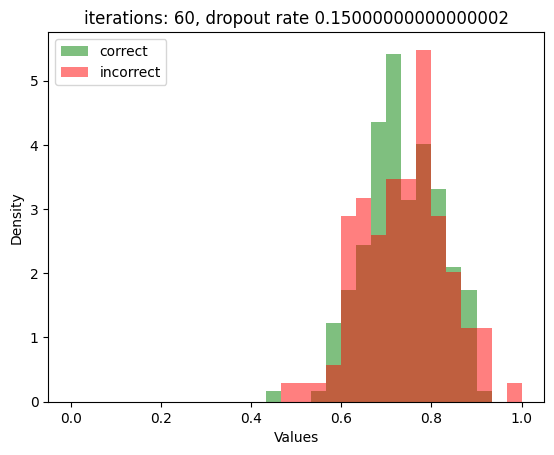

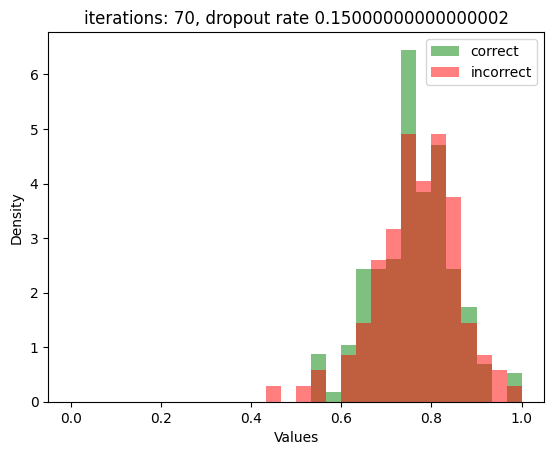

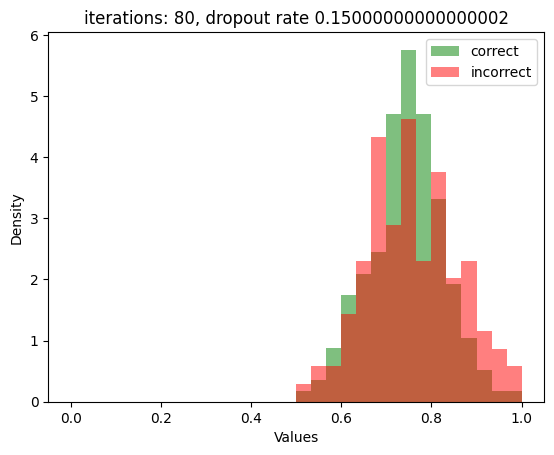

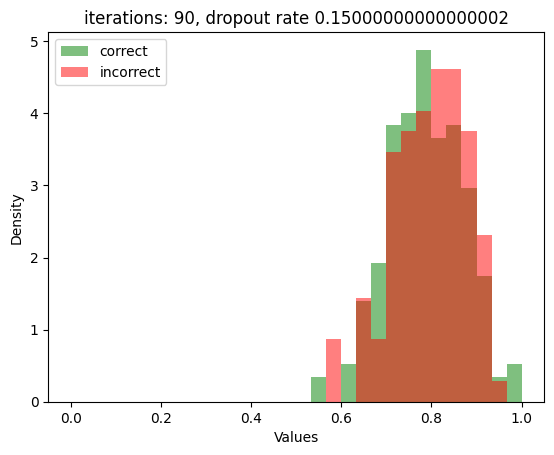

 17%|██████████████████████████                                                                                                                                  | 2/12 [00:28<02:22, 14.22s/it]

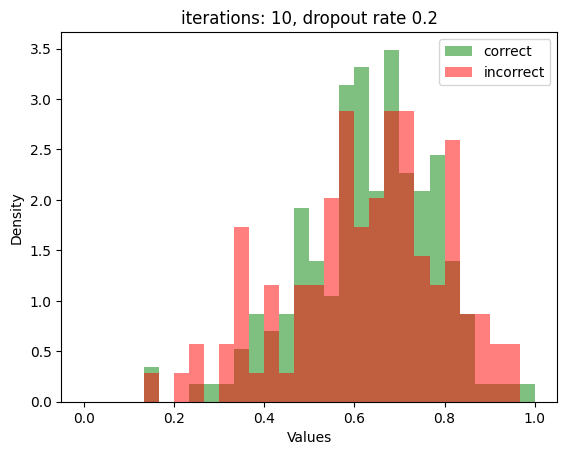

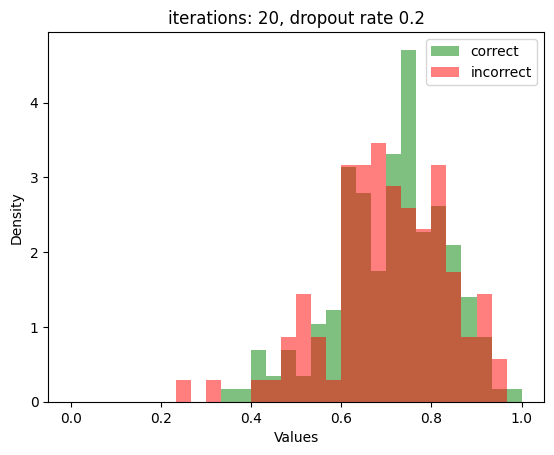

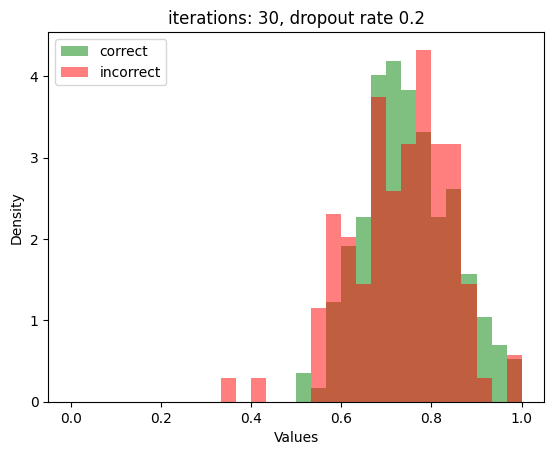

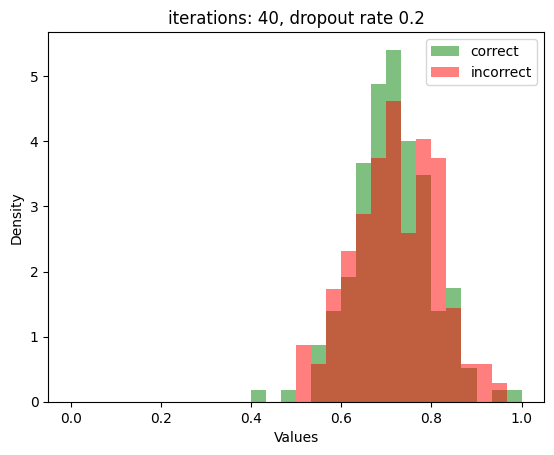

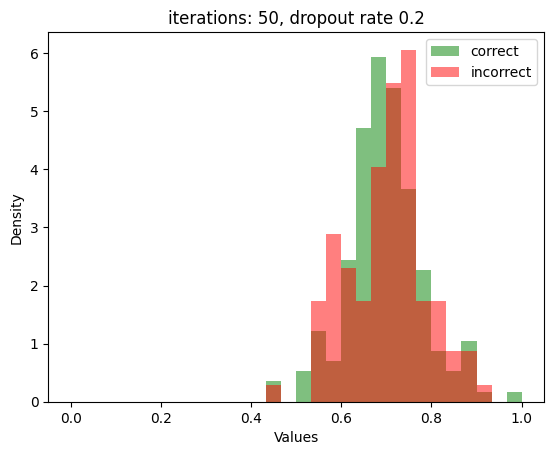

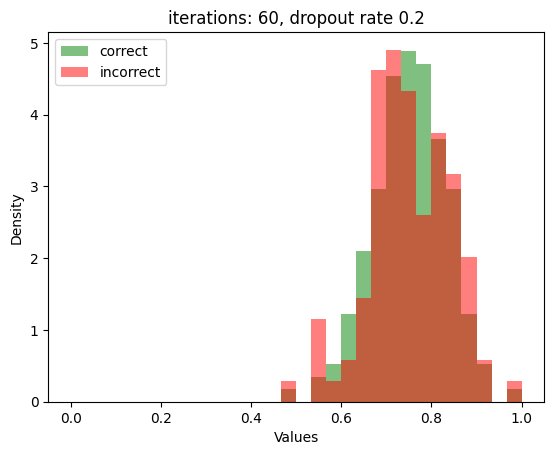

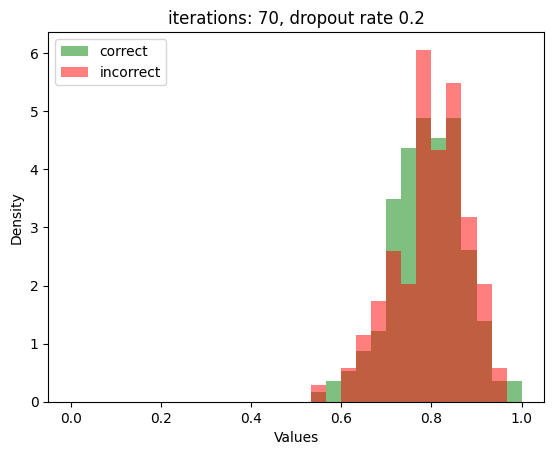

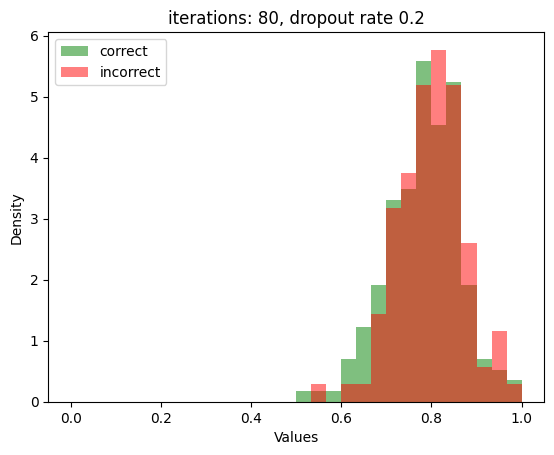

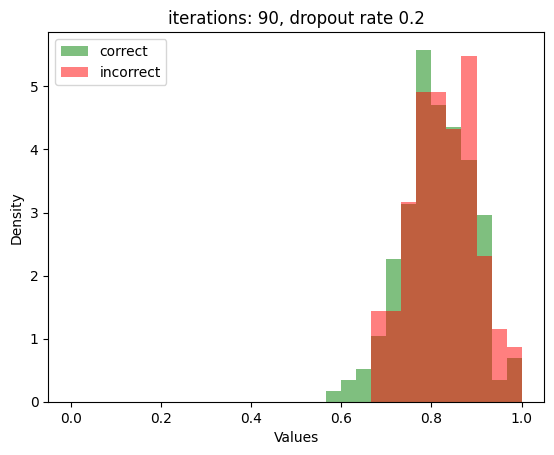

 25%|███████████████████████████████████████                                                                                                                     | 3/12 [00:43<02:09, 14.39s/it]

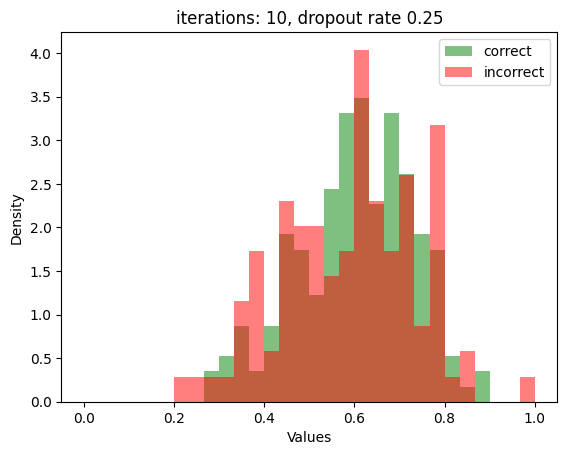

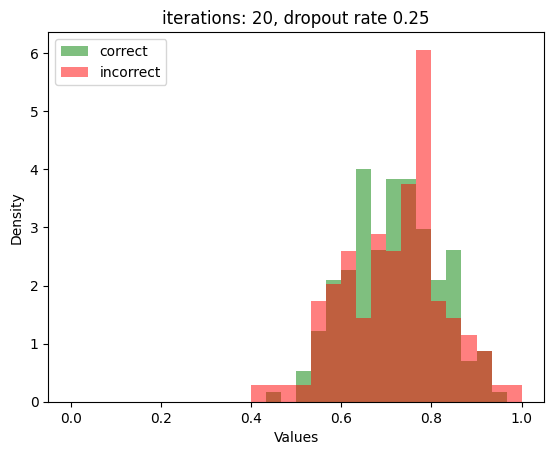

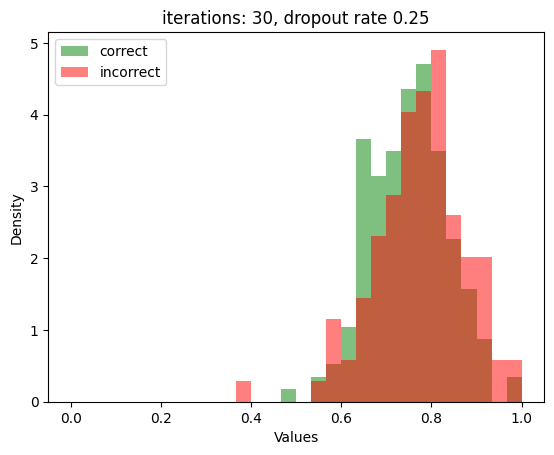

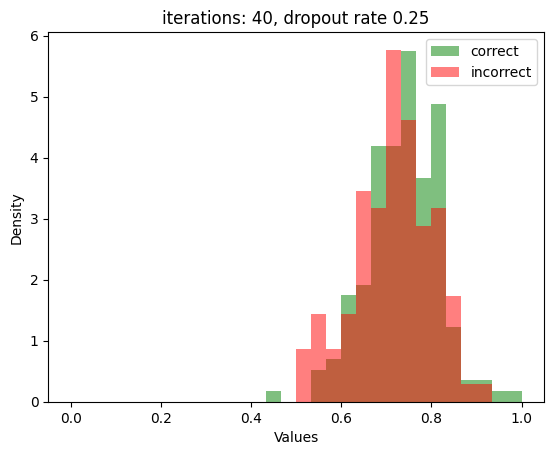

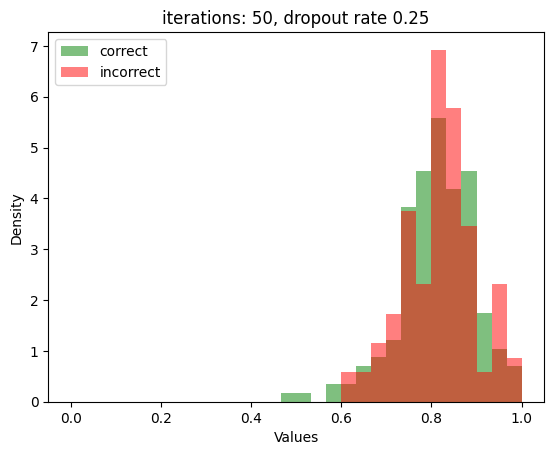

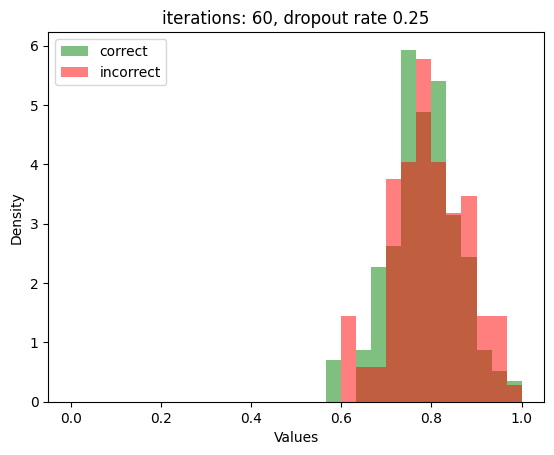

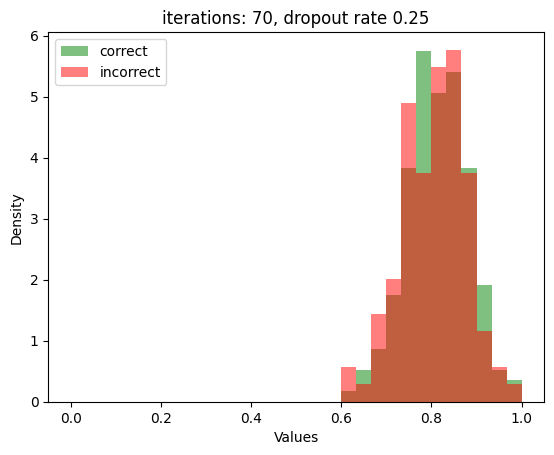

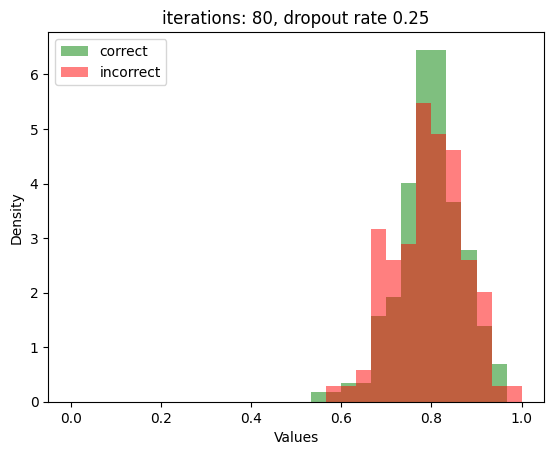

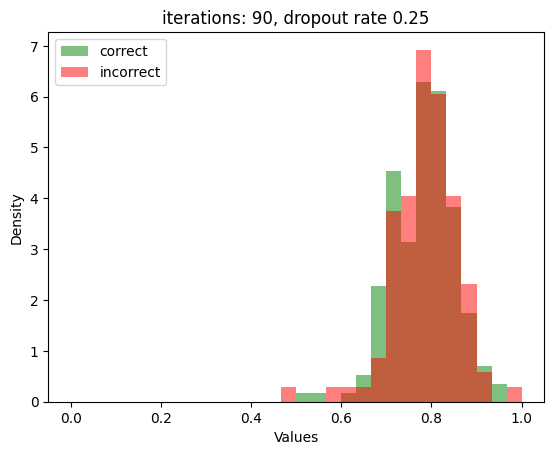

 33%|████████████████████████████████████████████████████                                                                                                        | 4/12 [00:57<01:53, 14.23s/it]

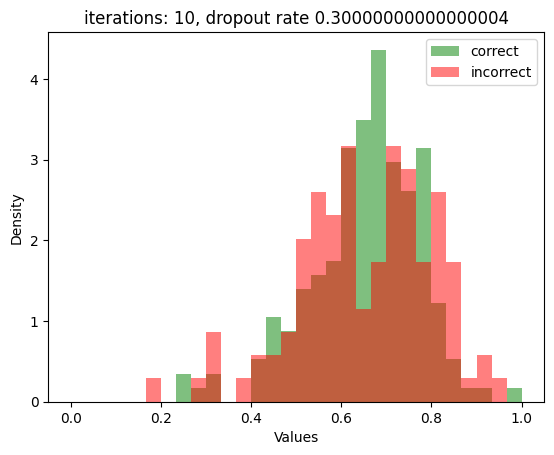

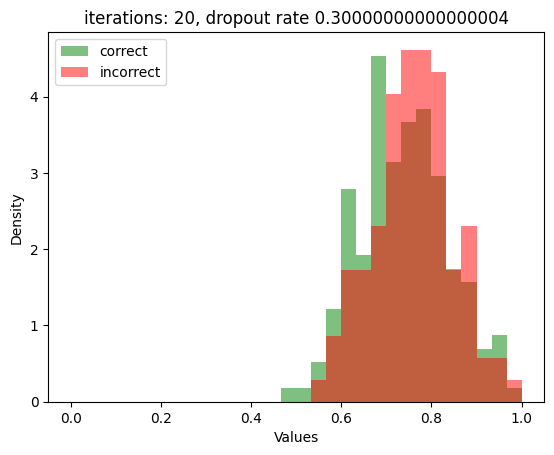

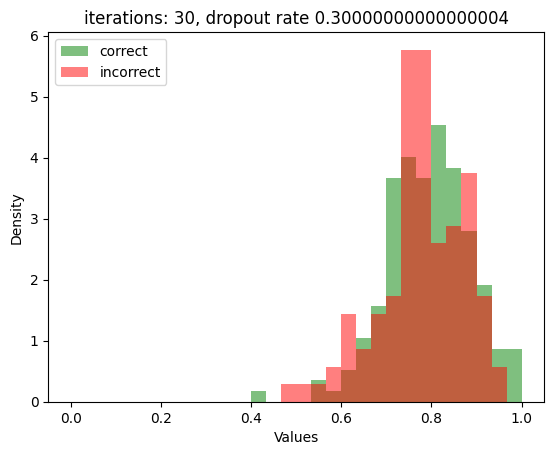

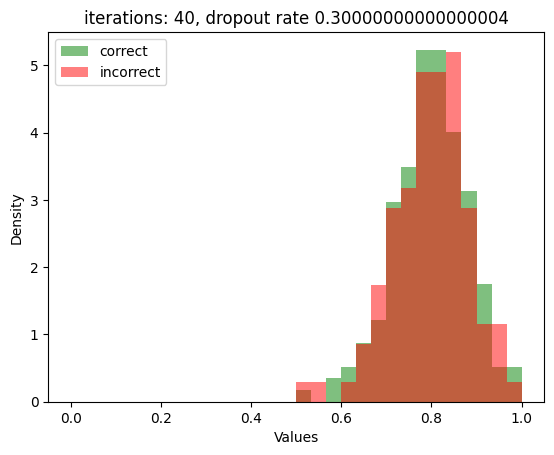

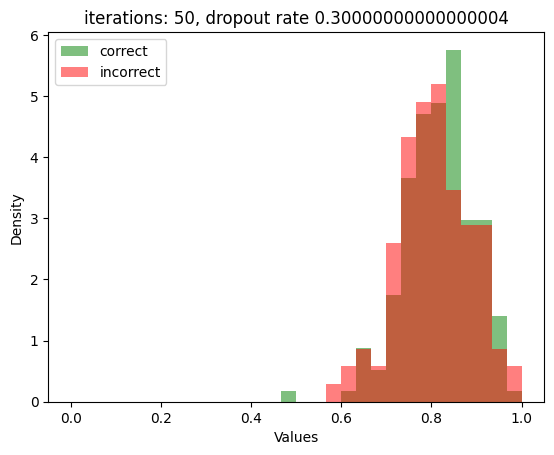

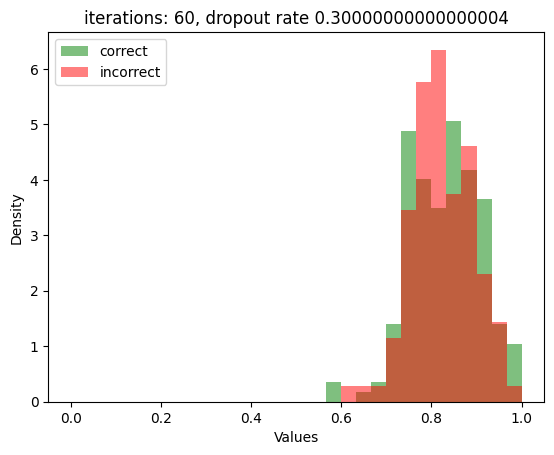

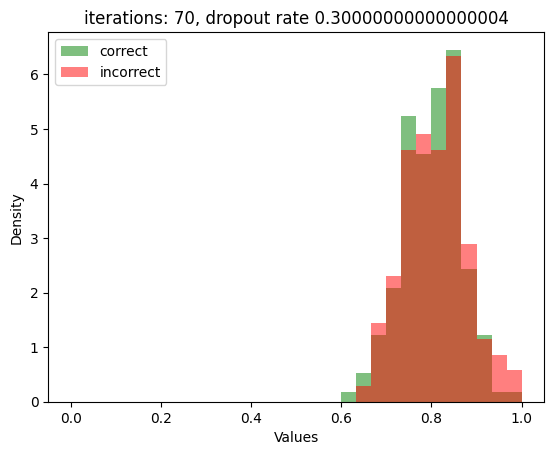

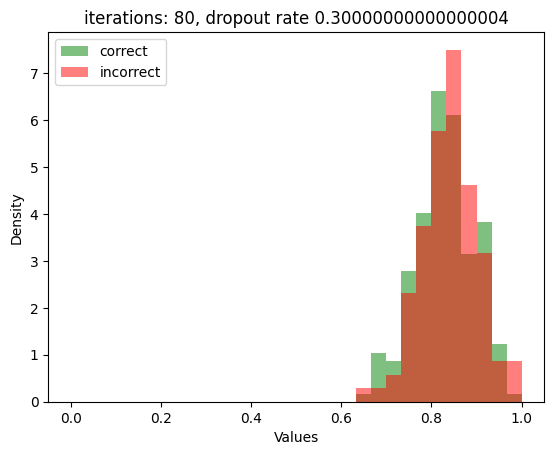

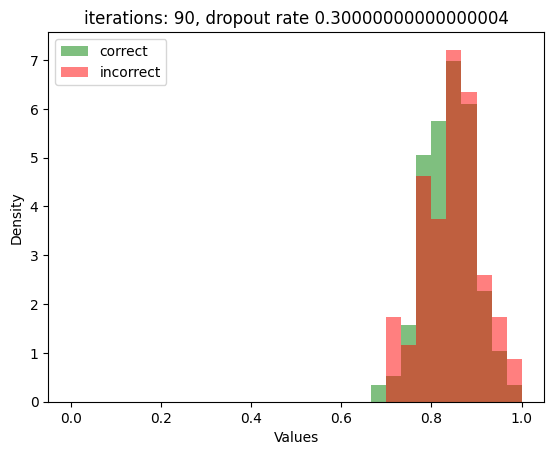

 42%|█████████████████████████████████████████████████████████████████                                                                                           | 5/12 [01:11<01:40, 14.37s/it]

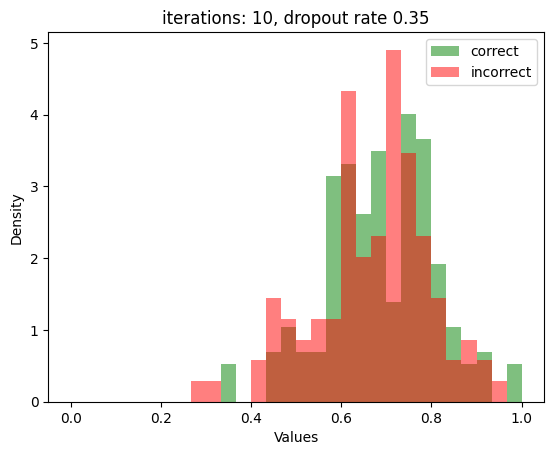

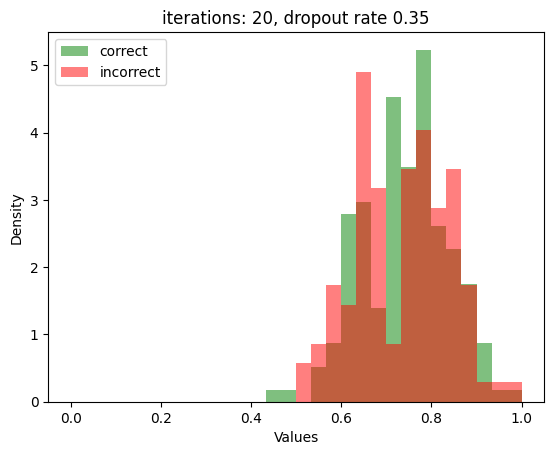

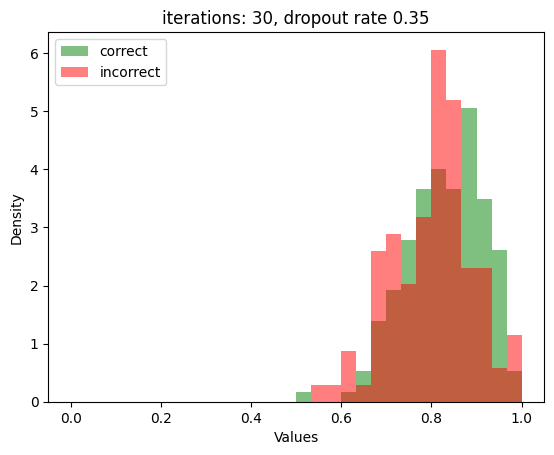

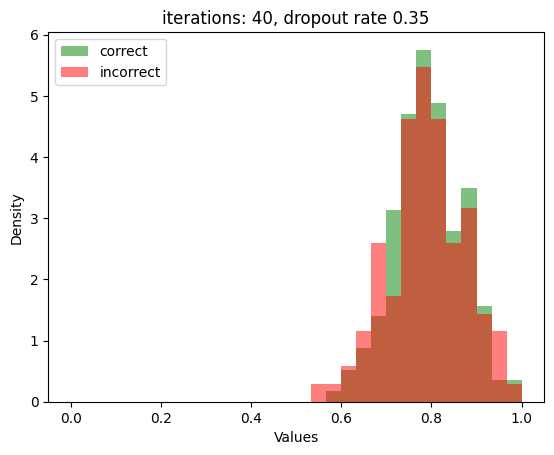

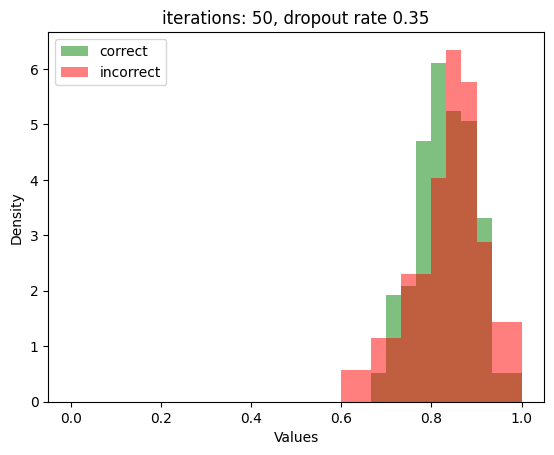

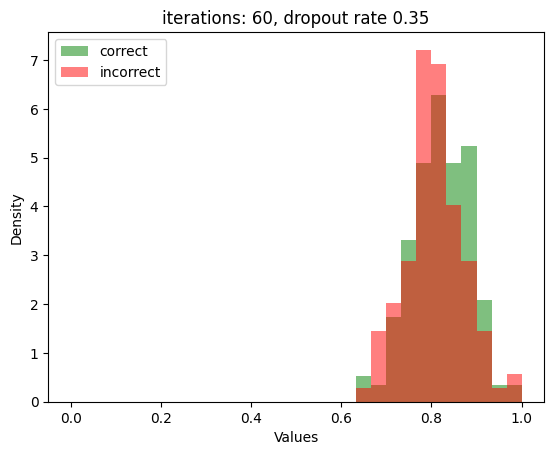

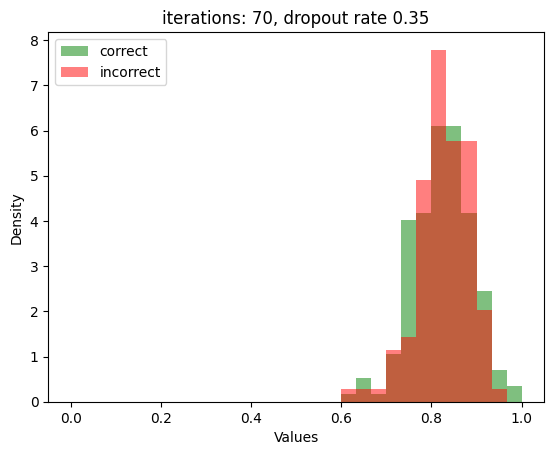

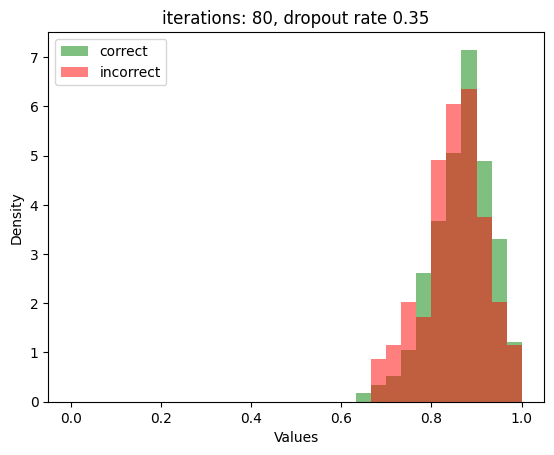

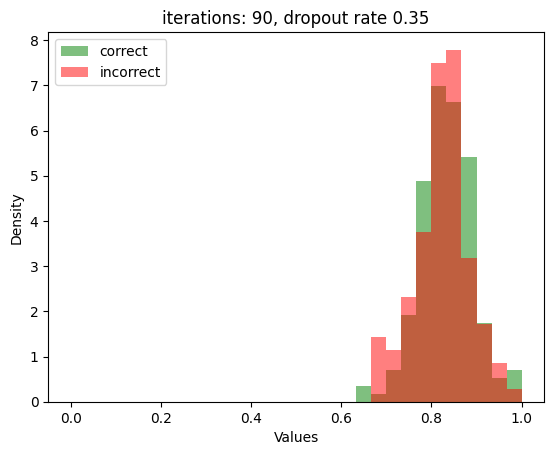

 50%|██████████████████████████████████████████████████████████████████████████████                                                                              | 6/12 [01:26<01:27, 14.57s/it]

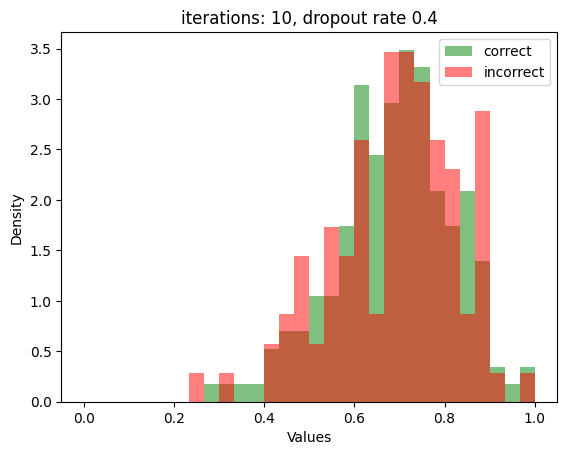

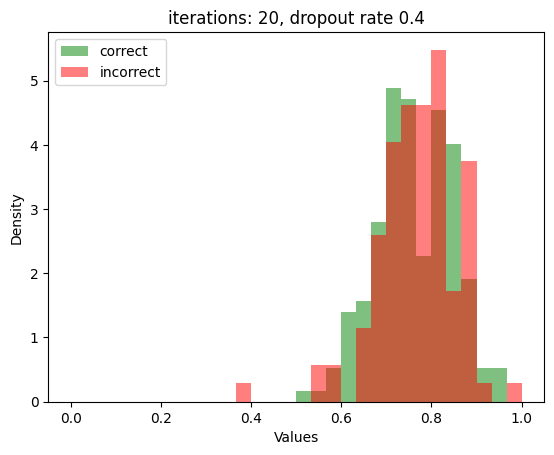

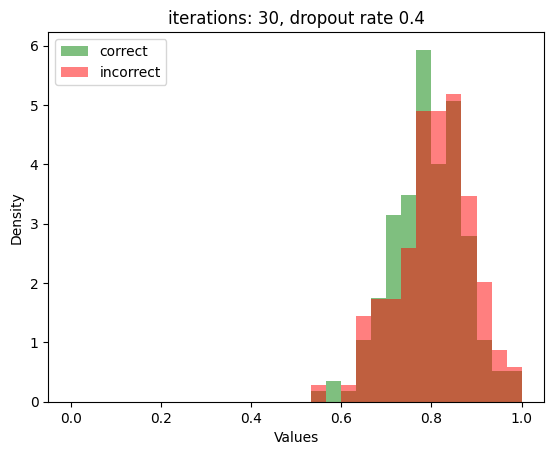

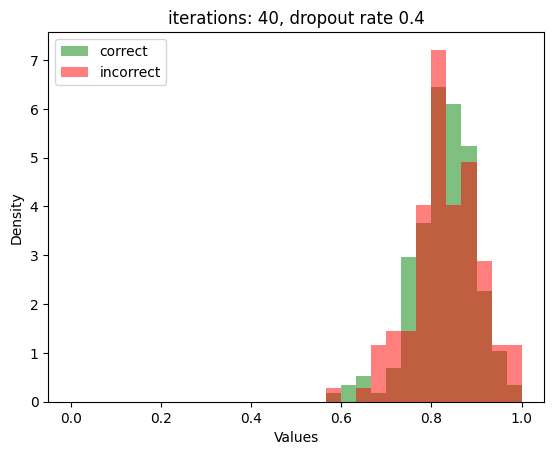

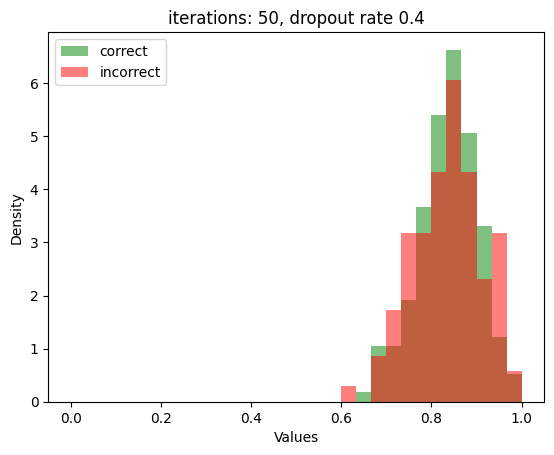

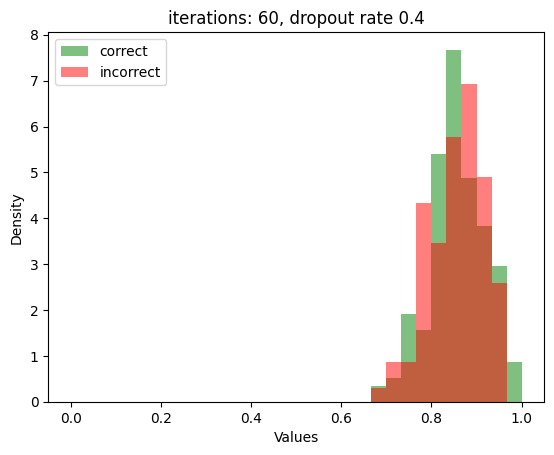

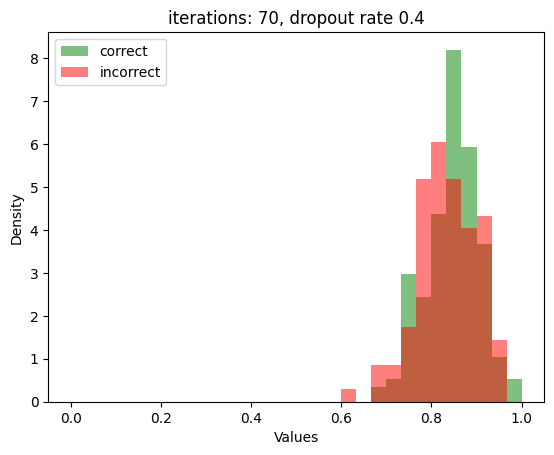

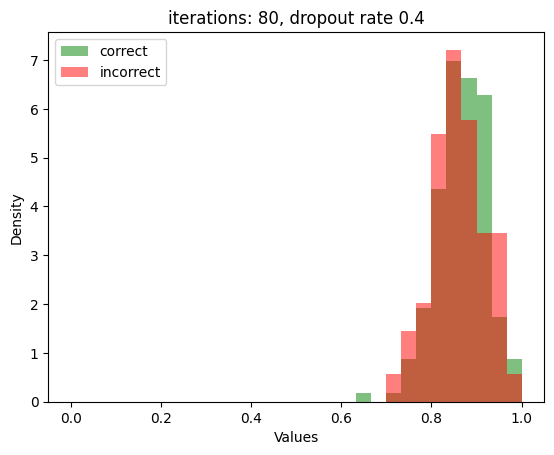

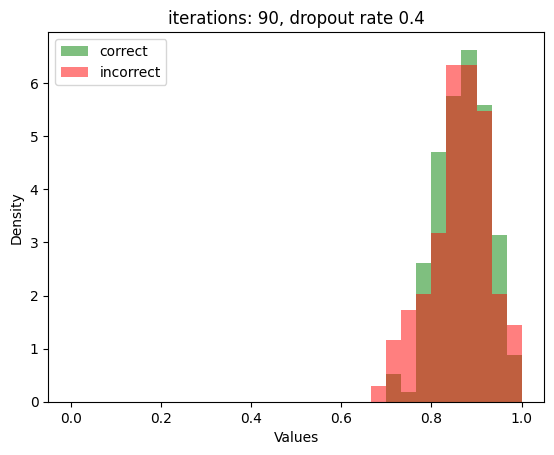

 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                 | 7/12 [01:40<01:11, 14.40s/it]

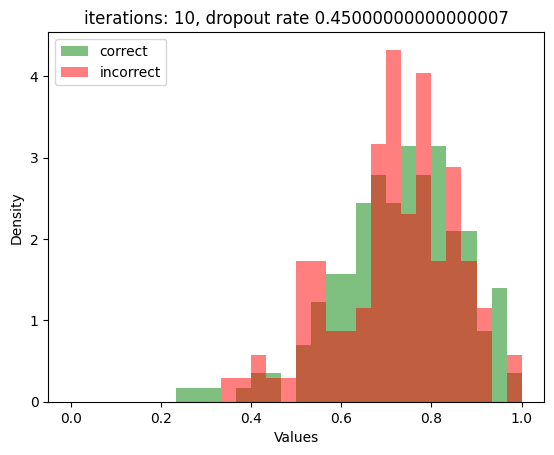

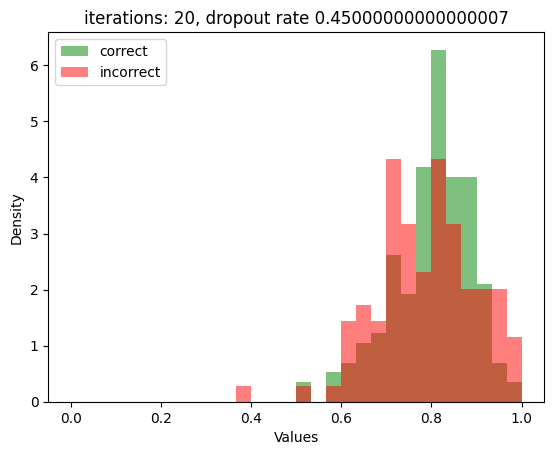

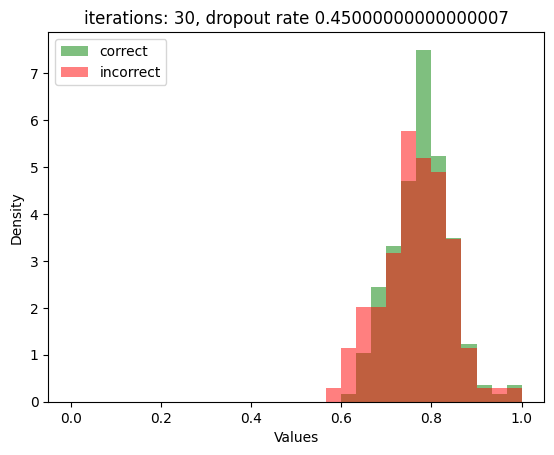

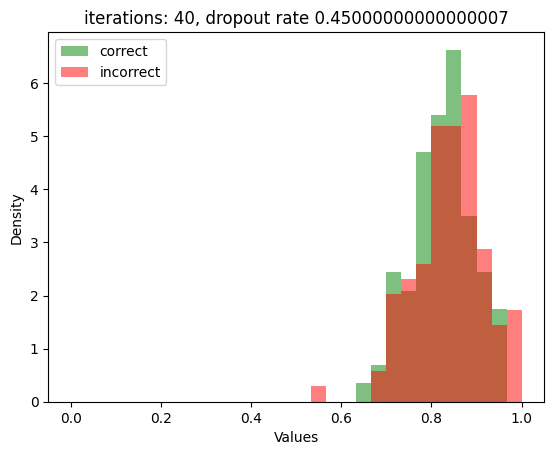

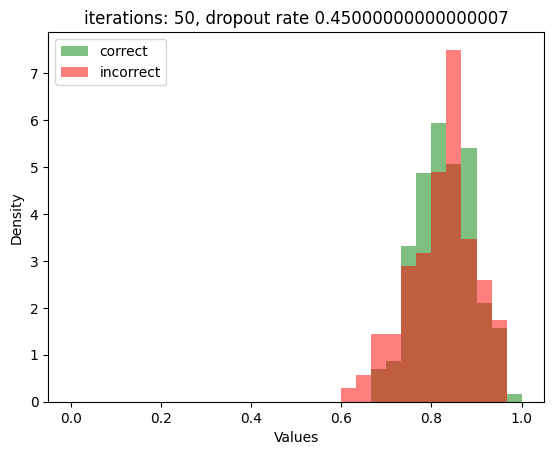

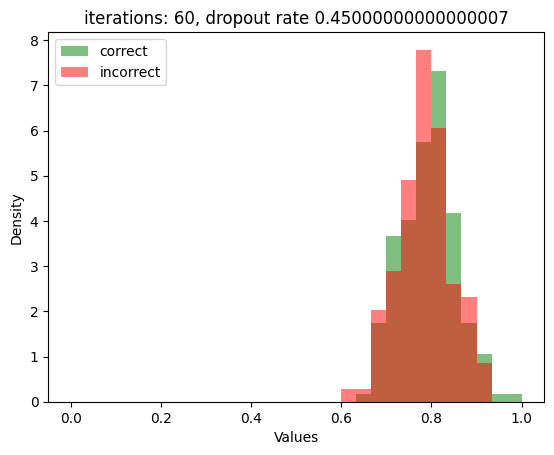

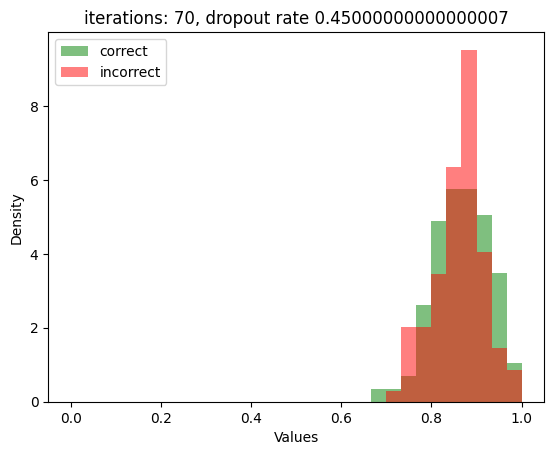

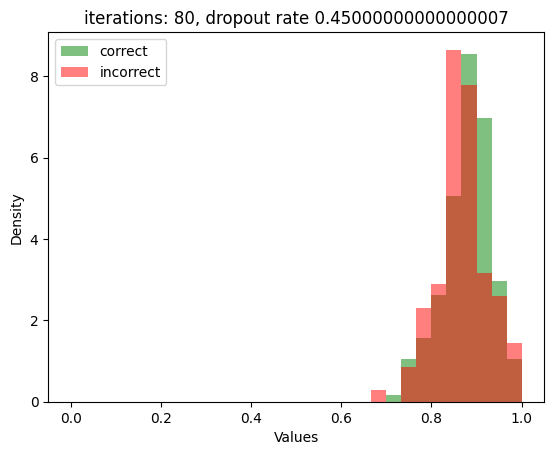

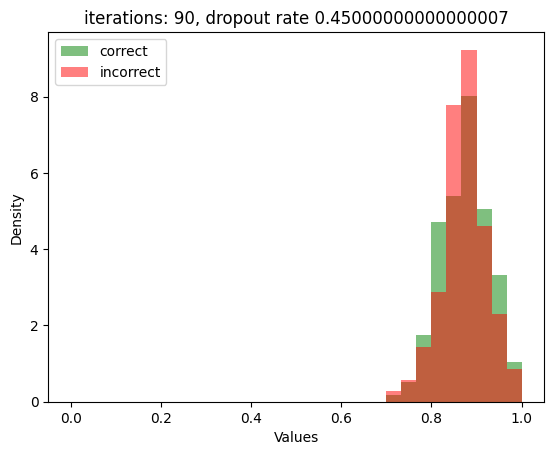

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 8/12 [01:55<00:58, 14.57s/it]

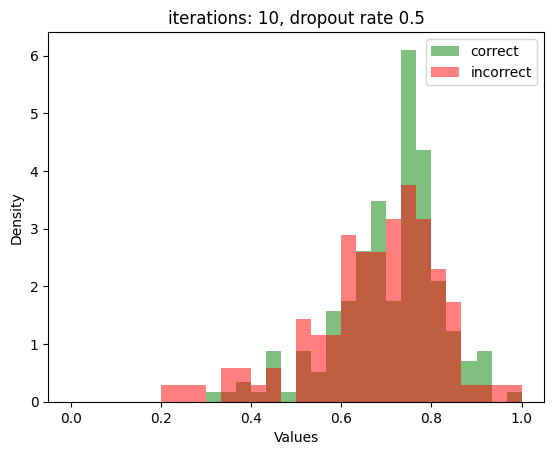

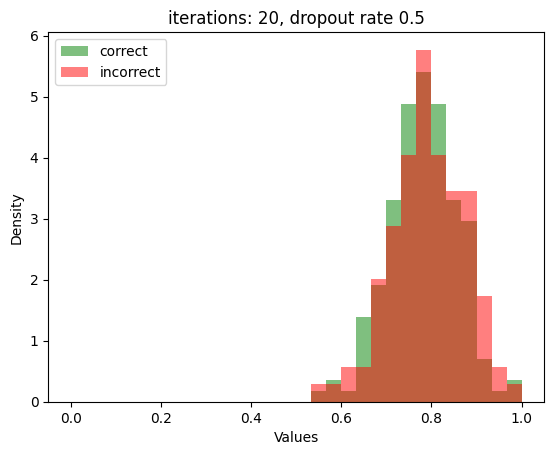

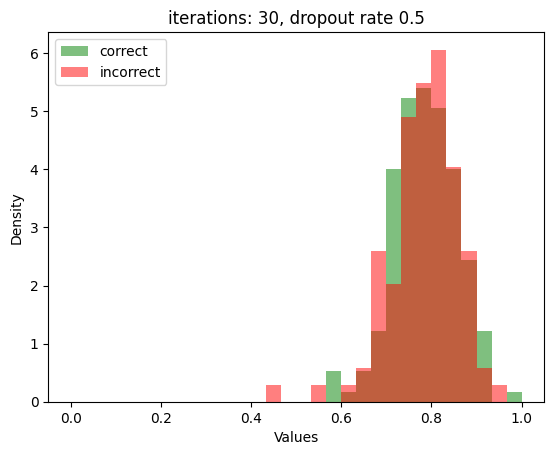

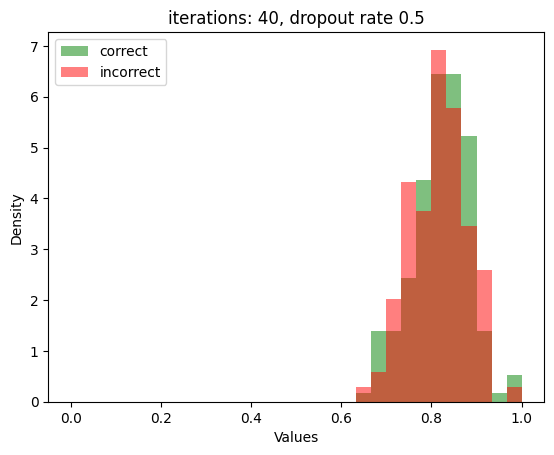

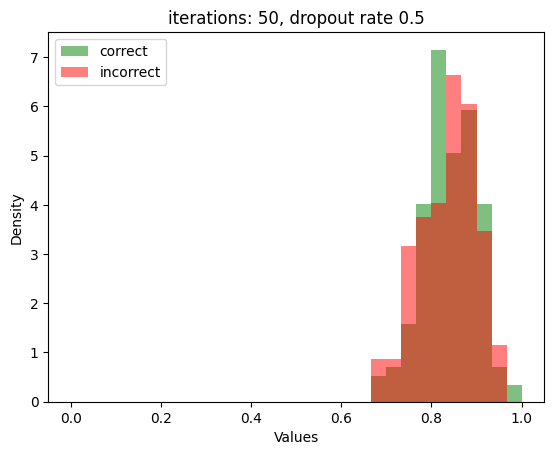

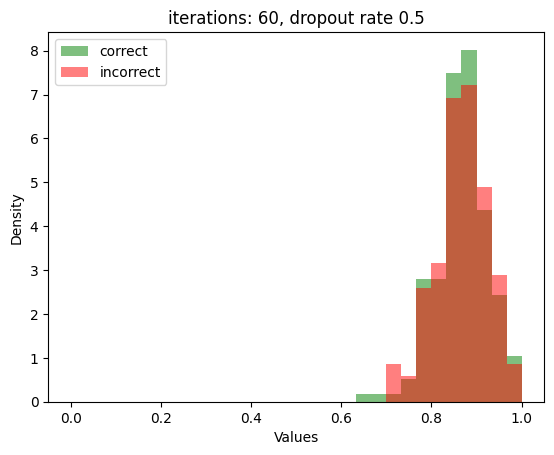

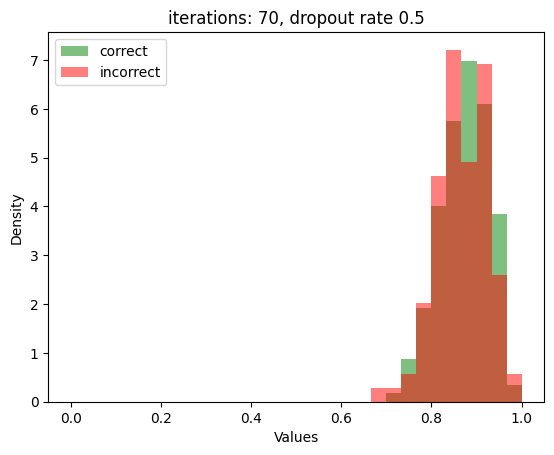

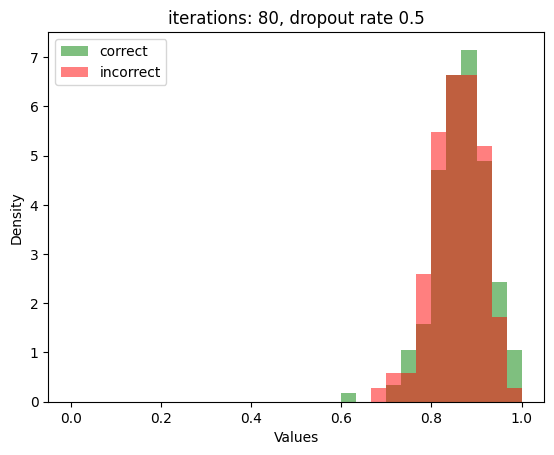

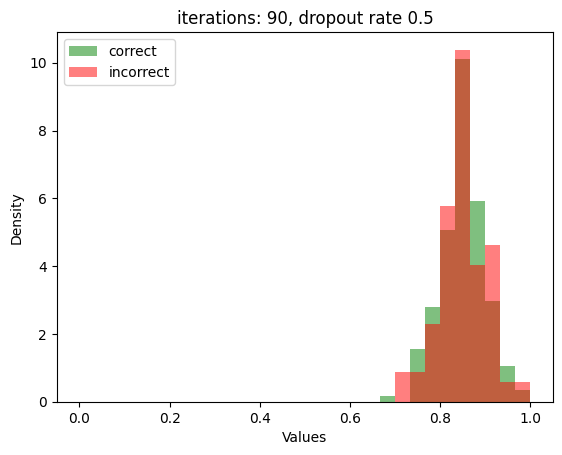

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 9/12 [02:09<00:43, 14.40s/it]

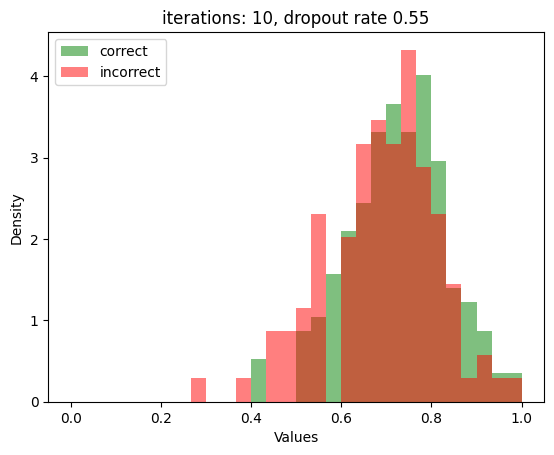

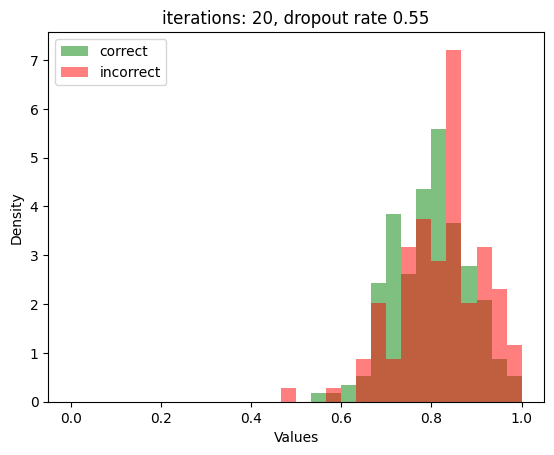

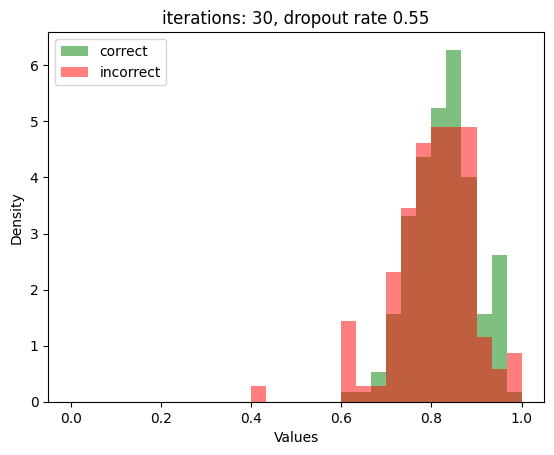

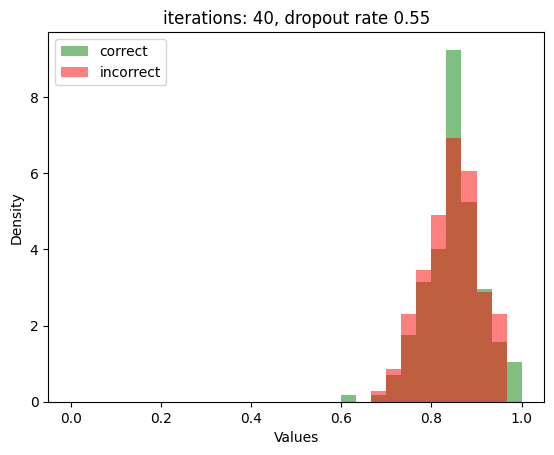

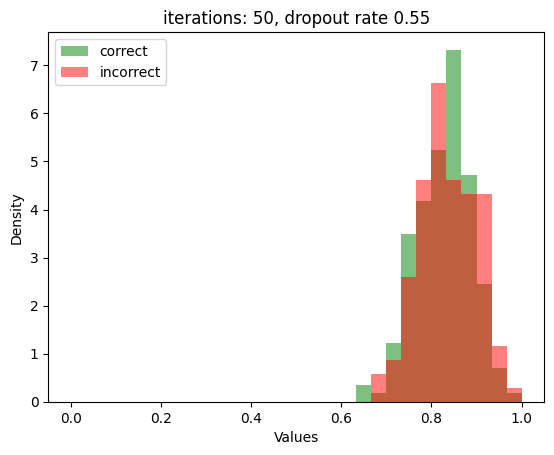

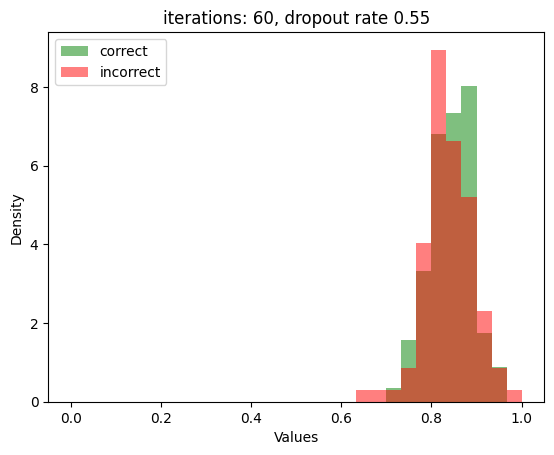

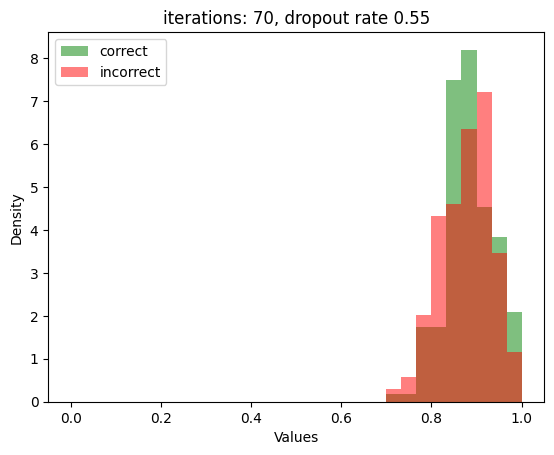

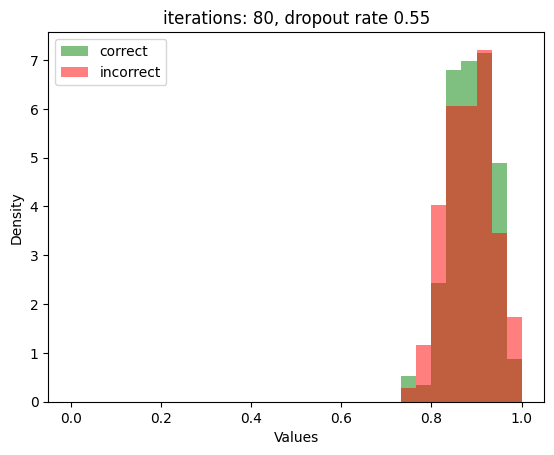

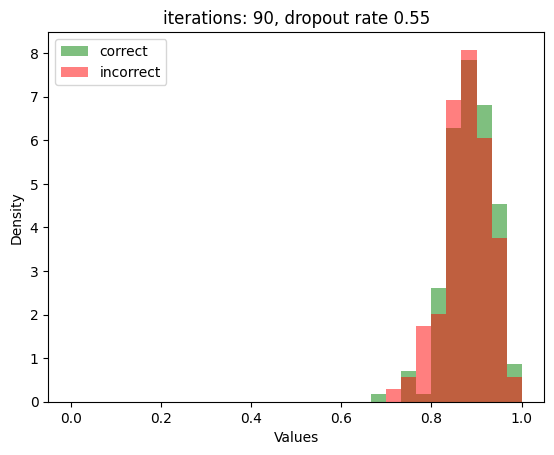

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 10/12 [02:24<00:28, 14.47s/it]

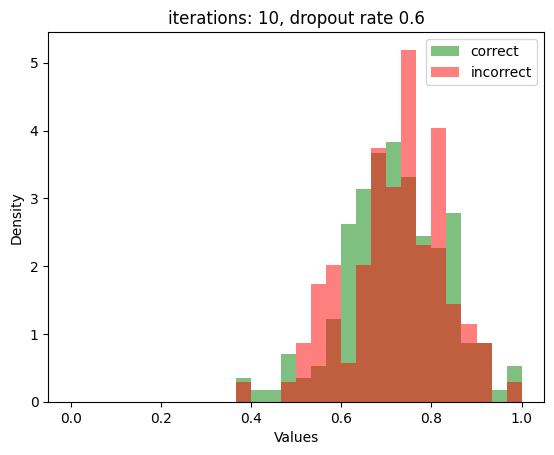

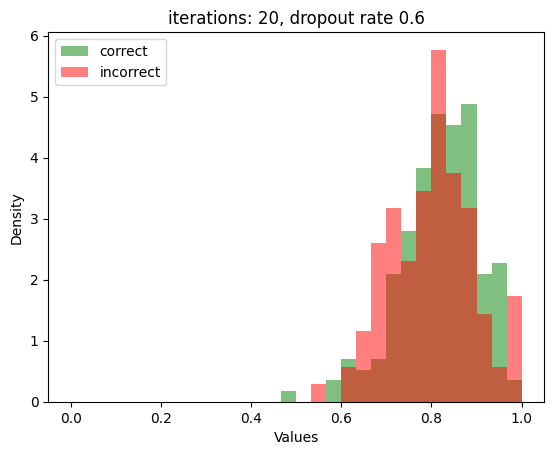

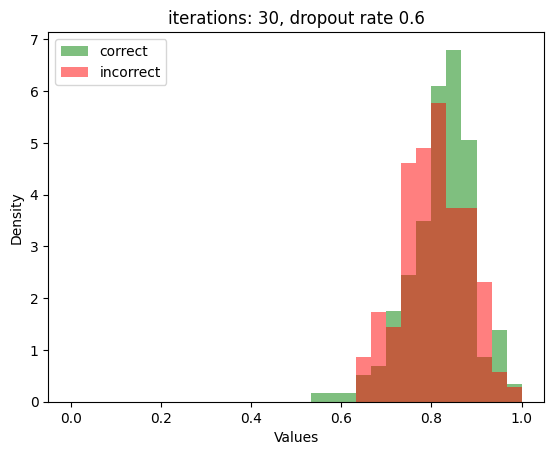

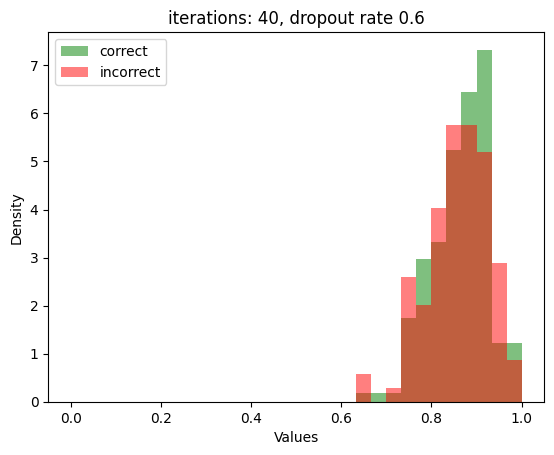

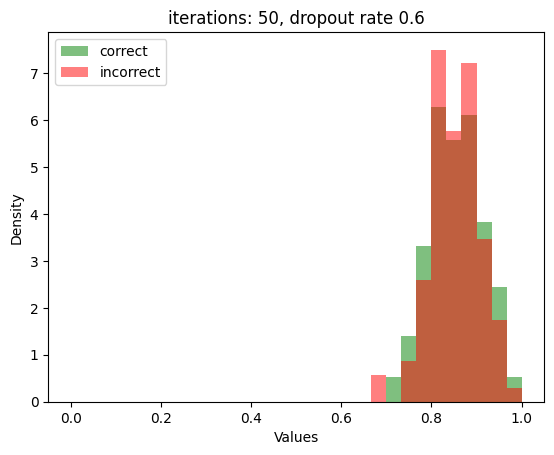

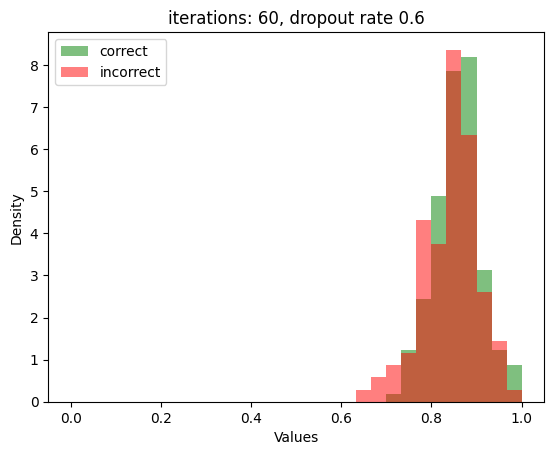

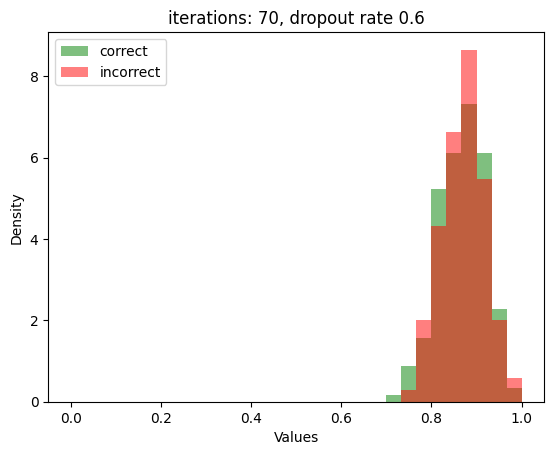

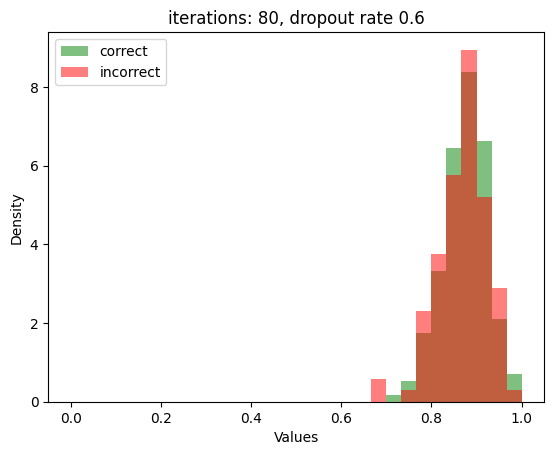

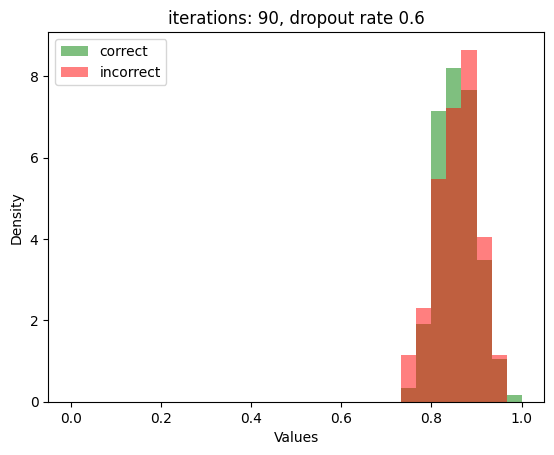

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 11/12 [02:39<00:14, 14.55s/it]

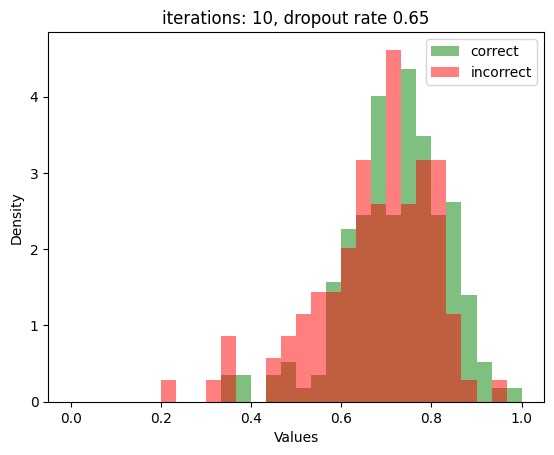

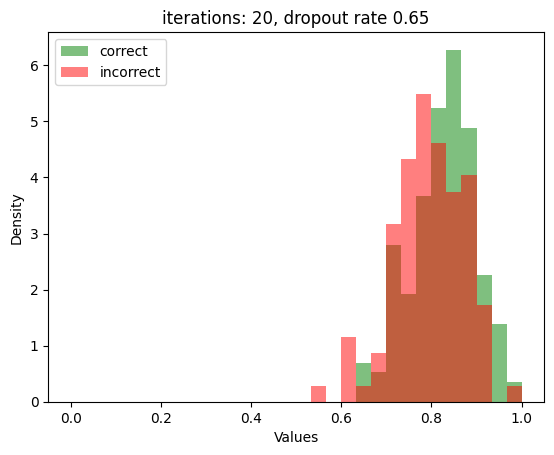

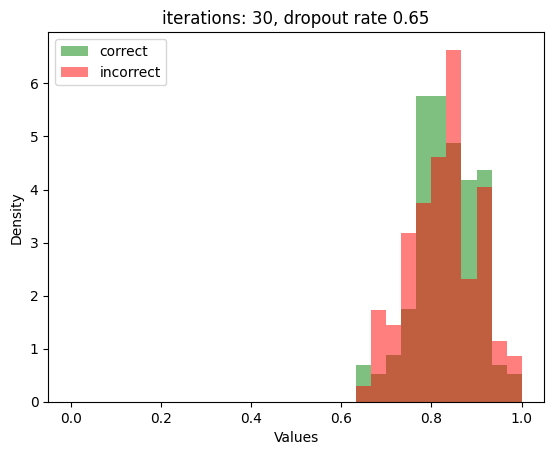

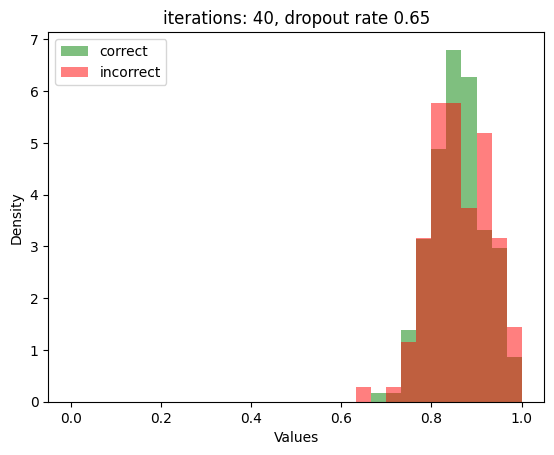

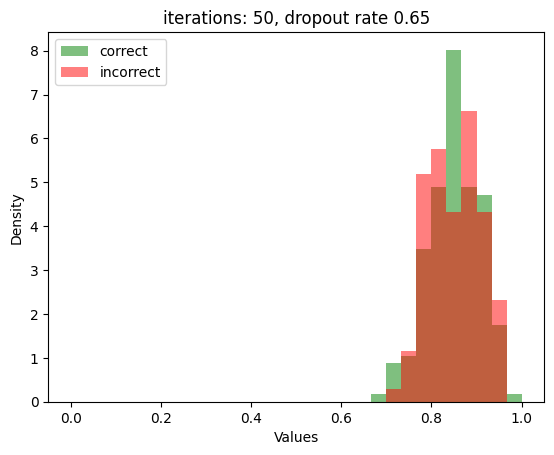

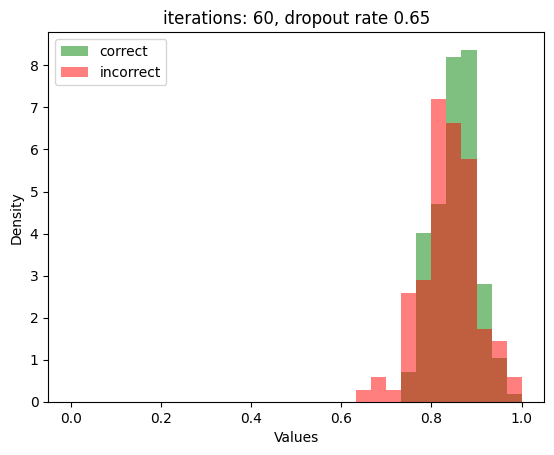

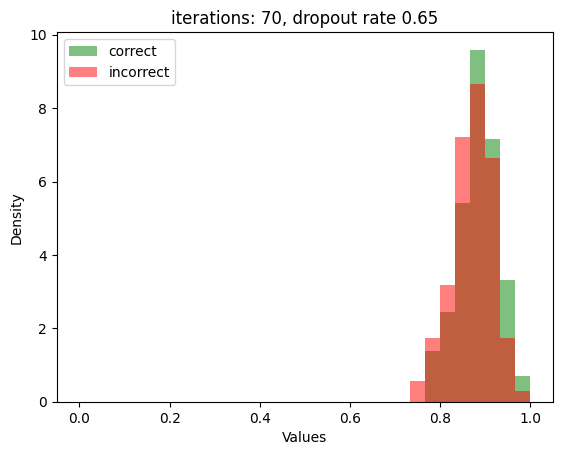

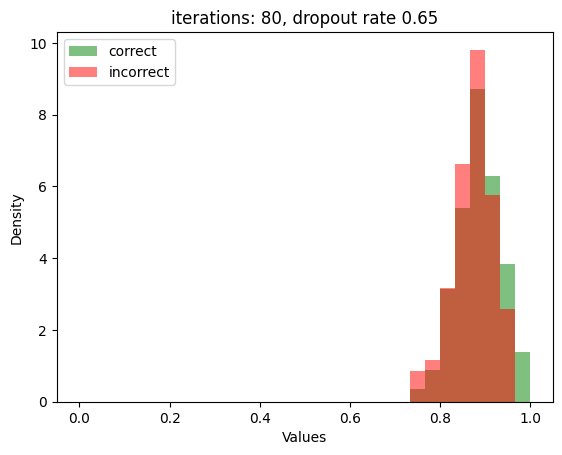

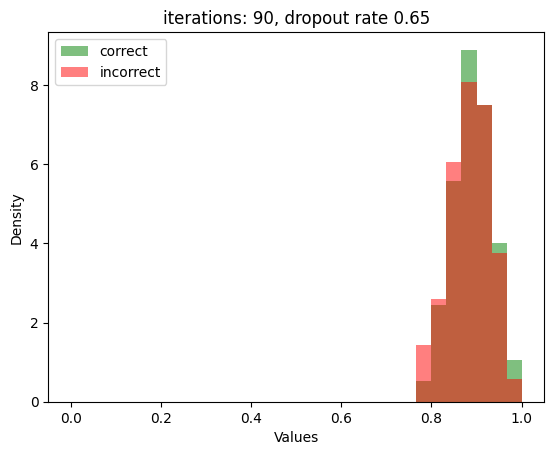

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [02:52<00:00, 14.41s/it]


In [12]:
for dr in tqdm(range(12)):
    for j in range(10, 100, 10):
        pred = np.zeros((276, j))
        model = create_dropout_model(neurons=[1024, 256], dropout_rate=(0.05 + dr*0.05), lr=0.001, kreg=tf.keras.regularizers.L1L2(l1=1e-3, l2=1e-3), breg=None, model=model, summary=False)
        for i in range(j):
            pred[:,i] = model(X_test, training=True).numpy()[:, 1]
        
        pred = pred.std(axis=1)/(pred.std(axis=1).max())
        pred_cor = pred[(y_test==y_pred_labels)]
        pred_mis = pred[(y_test!=y_pred_labels)]
        plt.figure()
        # plt.hist([pred_cor, pred_mis], density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color=['g', 'r'], label=["correct", "incorrect"])
        plt.hist(pred_cor, density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='g', label="correct")
        plt.hist(pred_mis, density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), color='r', label="incorrect")
        
        # Customize the plot
        plt.xlabel("Values")
        plt.ylabel("Density")
        plt.title(f'iterations: {j}, dropout rate {(0.1 + dr*0.05)}')
        plt.legend()
        plt.show()

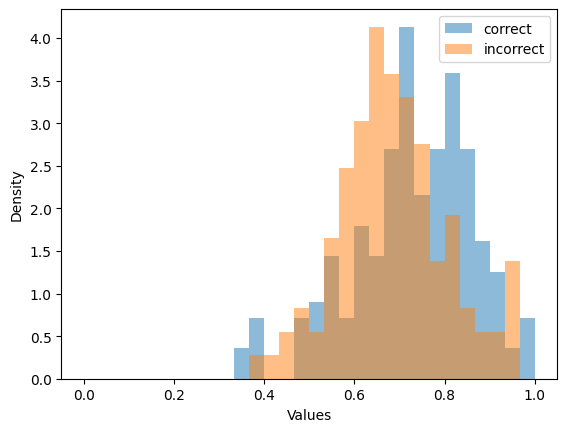

In [40]:
plt.hist(pred_cor, density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), label="correct")
plt.hist(pred_mis, density=True, alpha=0.5, stacked=True, bins=30, range=(0, 1), label="incorrect")

# Customize the plot
plt.xlabel("Values")
plt.ylabel("Density")
plt.legend()
plt.show()

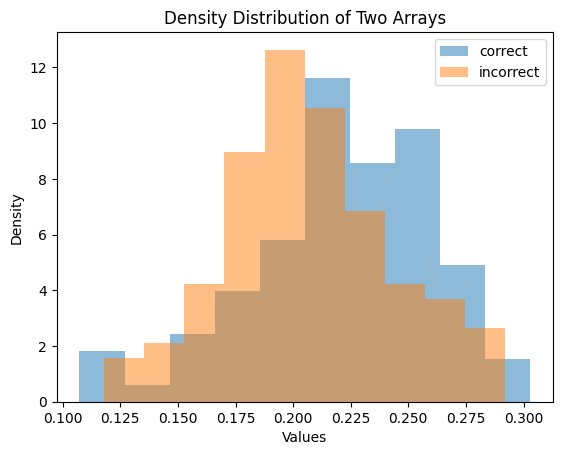

In [17]:
plt.hist(np.apply_along_axis(np.std, 1, pred_cor), density=True, label="correct", alpha=0.5)
plt.hist(np.apply_along_axis(np.std, 1, pred_mis), density=True, label="incorrect", alpha=0.5)

# Customize the plot
plt.xlabel("Values")
plt.ylabel("Density")
plt.title("Density Distribution of Two Arrays")
plt.legend()
plt.show()

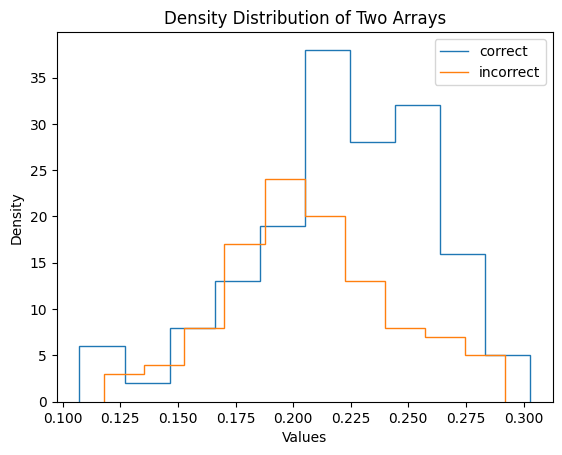

In [16]:
counts, bins = np.histogram(pred_cor.std(axis=1))
plt.stairs(counts, bins, label="correct")
counts, bins = np.histogram(pred_mis.std(axis=1))
plt.stairs(counts, bins, label="incorrect")

# Customize the plot
plt.xlabel("Values")
plt.ylabel("Density")
plt.title("Density Distribution of Two Arrays")
plt.legend()
plt.show()

In [15]:
temp1=[]
for j in tqdm(range(10, 150, 10)):
    pred = np.zeros((276, j))
    for i in range(j):
        pred[:,i] = model(X_test, training=True).numpy()[:, 1]
    temp1.append((j, roc_auc_score(y_test, pred.mean(axis=1))))
sorted(temp1, key=lambda x: x[1], reverse=True)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:15<00:00,  1.08s/it]


[(70, 0.6933837429111532),
 (120, 0.6931001890359169),
 (30, 0.6901701323251417),
 (140, 0.6891304347826086),
 (130, 0.687523629489603),
 (80, 0.6860113421550095),
 (90, 0.6840264650283554),
 (60, 0.6831758034026465),
 (100, 0.6817580340264651),
 (40, 0.6808128544423441),
 (50, 0.6804347826086957),
 (110, 0.679773156899811),
 (20, 0.6766540642722116),
 (10, 0.6655954631379962)]

In [12]:
temp1=[]
for j, _ in tqdm(sorted(temp, key=lambda x: x[1], reverse=True)):
    pred = np.zeros((276, j))
    for i in range(j):
        pred[:,i] = model(X_test, training=True).numpy()[:, 1]
    temp1.append((j, roc_auc_score(y_test, pred.mean(axis=1))))

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [02:43<00:00,  3.63s/it]


In [9]:
m = create_uncertainty_model(model)
class_weights = {i: j for i, j in enumerate(class_weight.compute_class_weight(class_weight="balanced", classes=np.unique(y_train), y=y_train))}
history = m.fit(X_train, y_train, epochs=300, validation_data=(X_valid, y_valid),
                class_weight=class_weights,
                callbacks=[tf.keras.callbacks.EarlyStopping(monitor='auc',
                                                            mode='max',
                                                            patience=100,
                                                            verbose=1,
                                                            restore_best_weights=True)]
                    )


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 2048)]               0         []                            
                                                                                                  
 dense (Dense)               (None, 512)                  1049088   ['input_1[0][0]']             
                                                                                                  
 dense_1 (Dense)             (None, 2)                    1026      ['dense[0][0]']               
                                                                                                  
 tf.nn.softmax (TFOpLambda)  (None, 2)                    0         ['dense_1[0][0]']             
                                                                                              

In [10]:
# even more (3,3) regularization, 512
# class weight

y_pred = m.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred)
acc = [balanced_accuracy_score(y_test, (y_pred > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred)

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 0s 4ms/step
Confusion Matrix:
[[113  89]
 [ 20  54]]
Accuracy:  0.605072463768116
Sensitivity:  0.7297297297297297
Specificity:  0.5594059405940595
Balanced accuracy:  0.6445678351618946
ROC AUC:  0.6780171260369281
F1 Score:  0.4976958525345622
AUC under Precision-Recall Curve: 0.4452


In [9]:
# densenet
# even more (3,2) regularization, 1024
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 8s 378ms/step
Confusion Matrix:
[[104  98]
 [ 29  45]]
Accuracy:  0.5398550724637681
Sensitivity:  0.6081081081081081
Specificity:  0.5148514851485149
Balanced accuracy:  0.5614797966283115
ROC AUC:  0.5642895370618143
F1 Score:  0.4147465437788018
AUC under Precision-Recall Curve: 0.3232


In [9]:
# densenet
# even more (3,3) regularization, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 8s 379ms/step
Confusion Matrix:
[[ 72 130]
 [ 10  64]]
Accuracy:  0.4927536231884058
Sensitivity:  0.8648648648648649
Specificity:  0.3564356435643564
Balanced accuracy:  0.6106502542146106
ROC AUC:  0.6535322451164036
F1 Score:  0.47761194029850745
AUC under Precision-Recall Curve: 0.4117


In [9]:
# fine tune
# even more (3,2) regularization, dropout, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 23s 2s/step
Confusion Matrix:
[[150  52]
 [ 39  35]]
Accuracy:  0.6702898550724637
Sensitivity:  0.47297297297297297
Specificity:  0.7425742574257426
Balanced accuracy:  0.6077736151993578
ROC AUC:  0.6077736151993577
F1 Score:  0.43478260869565216
AUC under Precision-Recall Curve: 0.3823


In [9]:
# even more (3,2) regularization, 512, 256
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 5s 213ms/step
Confusion Matrix:
[[110  92]
 [ 25  49]]
Accuracy:  0.5760869565217391
Sensitivity:  0.6621621621621622
Specificity:  0.5445544554455446
Balanced accuracy:  0.6033583088038534
ROC AUC:  0.635202033716885
F1 Score:  0.4558139534883721
AUC under Precision-Recall Curve: 0.4311


In [9]:
# even more (3,2) regularization, 1024, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 5s 214ms/step
Confusion Matrix:
[[157  45]
 [ 40  34]]
Accuracy:  0.6920289855072463
Sensitivity:  0.4594594594594595
Specificity:  0.7772277227722773
Balanced accuracy:  0.6183435911158683
ROC AUC:  0.6474444741771476
F1 Score:  0.4444444444444444
AUC under Precision-Recall Curve: 0.4441


In [10]:
# even more (3,3) regularization, 512
# class weight

y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 2s 212ms/step
Confusion Matrix:
[[119  83]
 [ 22  52]]
Accuracy:  0.6195652173913043
Sensitivity:  0.7027027027027027
Specificity:  0.5891089108910891
Balanced accuracy:  0.6459058067968959
ROC AUC:  0.6719293550976719
F1 Score:  0.49760765550239233
AUC under Precision-Recall Curve: 0.4511


In [15]:
# even more regularization
# class weight
y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 2s 212ms/step
Confusion Matrix:
[[ 86 116]
 [ 12  62]]
Accuracy:  0.5362318840579711
Sensitivity:  0.8378378378378378
Specificity:  0.42574257425742573
Balanced accuracy:  0.6317902060476318
ROC AUC:  0.6643029167781643
F1 Score:  0.49206349206349204
AUC under Precision-Recall Curve: 0.4511


In [9]:
# more regularization
# class weight
y_pred = model.predict(X_test)

_, _, thresholds = roc_curve(y_test, y_pred[:, 1])
acc = [balanced_accuracy_score(y_test, (y_pred[:, 1] > thrs) * 1) for thrs in thresholds]

thr = max(zip(acc, thresholds), key=lambda x: x[0])[1]

y_pred_labels = (y_pred[:,1] > thr) * 1

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)
recall = recall_score(y_test, y_pred_labels)
specificity = recall_score(y_test, y_pred_labels, pos_label=0)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("Sensitivity: ", recall)
print("Specificity: ", specificity)
print("Balanced accuracy: ", balanced_accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

precision, recall, thresholds = precision_recall_curve(y_test, y_pred[:, 1])

# Calculate trapezoidal approximation for AUC under PR curve
auc_prc = auc(recall, precision)

print(f"AUC under Precision-Recall Curve: {auc_prc:.4f}")

9/9 [==============================] - 4s 214ms/step
Confusion Matrix:
[[ 97 105]
 [ 17  57]]
Accuracy:  0.5579710144927537
Sensitivity:  0.7702702702702703
Specificity:  0.4801980198019802
Balanced accuracy:  0.6252341450361252
ROC AUC:  0.6582151458389083
F1 Score:  0.4830508474576271
AUC under Precision-Recall Curve: 0.4535


In [8]:
#regularization
#class weight
y_pred = model.predict(X_test)
y_pred_labels = np.argmax(y_pred, axis=1)

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

9/9 [==============================] - 5s 214ms/step
Confusion Matrix:
[[202   0]
 [ 74   0]]
Accuracy:  0.7318840579710145
ROC AUC:  0.6017527428418518
F1 Score:  0.0


In [8]:
#class weight
y_pred = model.predict(X_test)
y_pred_labels = np.argmax(y_pred, axis=1)

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

9/9 [==============================] - 5s 213ms/step
Confusion Matrix:
[[202   0]
 [ 74   0]]
Accuracy:  0.7318840579710145
ROC AUC:  0.5944607974310945
F1 Score:  0.0


In [8]:
#initial
y_pred = model.predict(X_test)
y_pred_labels = np.argmax(y_pred, axis=1)

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred_labels)
roc_auc = roc_auc_score(y_test, y_pred[:, 1])
f1 = f1_score(y_test, y_pred_labels)
confusion = confusion_matrix(y_test, y_pred_labels)

print("Confusion Matrix:")
print(confusion)

print("Accuracy: ", accuracy)
print("ROC AUC: ", roc_auc)
print("F1 Score: ", f1)

9/9 [==============================] - 4s 213ms/step
Confusion Matrix:
[[200   2]
 [ 68   6]]
Accuracy:  0.7463768115942029
ROC AUC:  0.5917848541610918
F1 Score:  0.14634146341463414
